In [13]:
import torch
from torch import distributions as dists


def put(a):
    if type(a[0]) != dict:
        a[0][a[1].long()] = a[2]
        return a[0]
    else:
        a[0][a[1].item()] = a[2]
        return a[0]


def get(a):
    if type(a[0]) != dict:
        return a[0][a[1].long()]
    else:
        return a[0][a[1].item()]


def make_map(a):
    keys, vals = a[::2], a[1::2]
    keys = list(map(lambda x: x.item(), keys))
    return dict(zip(keys, vals))


def make_vector(a):
    try:
        return torch.stack(a)
    except:
        return a


funcprimitives = {
    '/': lambda a: a[0] / a[1],
    '*': lambda a: a[0] * a[1],
    '+': lambda a: a[0] + a[1],
    '-': lambda a: a[0] - a[1],
    '==': lambda a: a[0] == a[1],
    '=': lambda a: a[0] == a[1],
    '>': lambda a: a[0] > a[1],
    '<': lambda a: a[0] < a[1],
    '>=': lambda a: a[0] >= a[1],
    '<=': lambda a: a[0] <= a[1],
    'or': lambda a: a[0] or a[1],
    'and': lambda a: a[0] and a[1],
    'sqrt': lambda a: torch.sqrt(a[0]),
    'vector': make_vector,
    'get': get,
    'put': put,
    'first': lambda a: a[0][0],
    'second': lambda a: a[0][1],
    'last': lambda a: a[0][-1],
    'rest': lambda a: a[0][1:],
    'append': lambda a: torch.tensor(list(a[0]) + [a[1]]),
    'hash-map': make_map,
    'mat-transpose': lambda a: a[0].T,
    'mat-tanh': lambda a: a[0].tanh(),
    'mat-mul': lambda a: torch.matmul(a[0], a[1]),
    'mat-add': lambda a: a[0] + a[1],
    'mat-repmat': lambda a: a[0].repeat((int(a[1].item()), int(a[2].item())))
}


class Dist:

    def __init__(self, dist, name, params_count, *p):
        self.dist = dist
        self.name = name
        self.params_count = params_count
        self.params = []
        for i in range(params_count):
            self.params.append(p[i])

    def __str__(self):
        return str([self.name] + self.params)

    def sample(self):
        return self.dist.sample()

    def log_probability(self, c):
        return self.dist.log_prob(c)


class Normal(Dist):

    def __init__(self, a):
        dist = dists.Normal(a[0], a[1])
        super().__init__(dist, "normal", 2, a[0], a[1])


class Beta(Dist):

    def __init__(self, a):
        dist = dists.Beta(a[0], a[1])
        super().__init__(dist, "beta", 2, a[0], a[1])


class Exponential(Dist):

    def __init__(self, a):
        dist = dists.Exponential(a[0])
        super().__init__(dist, "exponential", 2, torch.tensor(0.), 1 / a[0])


class Uniform(Dist):

    def __init__(self, a):
        dist = dists.Uniform(a[0], a[1])
        super().__init__(dist, "uniform", 2, a[0], a[1])


class Discrete(Dist):

    def __init__(self, a):
        dist = dists.Categorical(a[0])
        super().__init__(dist, "discrete", 0)


class Gamma(Dist):

    def __init__(self, a):
        dist = dists.Gamma(a[0], a[1])
        super().__init__(dist, "Gamma", 2, a[0], a[1])


class Dirichlet(Dist):

    def __init__(self, a):
        dist = dists.Dirichlet(a[0])
        super().__init__(dist, "Dirichlet", -1, a)


class Bernoulli(Dist):

    def __init__(self, a):
        dist = dists.Bernoulli(a[0])
        super().__init__(dist, "Bernoulli", 1, a[0])


# class Dirac(Dist):
#
#     # def __init__(self, a):
#         # dist = dists.Dir(a[0])
#         # super().__init__(dist, "Bernoulli", 1, a[0])


distributions = {
    'normal': Normal,
    'beta': Beta,
    'exponential': Exponential,
    'uniform': Uniform,
    'discrete': Discrete,
    'gamma': Gamma,
    'dirichlet': Dirichlet,
    'flip': Bernoulli
}


class Function:

    def __init__(self, name, variables, proc):
        self.name = name
        self.variables = variables
        self.proc = proc

In [26]:
import torch
import numpy as np
import pickle as pkl
from daphne import daphne



def evaluate_program(ast):
    """Evaluate a program as desugared by daphne, generate a sample from the prior
    Args:
        ast: json FOPPL program
    Returns: sample from the prior of ast
    """
    defs = {}
    if isinstance(ast[0], list) and ast[0][0] == "defn":
        while ast[0][0] == "defn":
            defs[ast[0][1]] = Function(ast[0][1], ast[0][2], ast[0][3])
            ast = ast[1]
    else:
        ast = ast[0]
    res = eval(ast, {}, {}, defs)
    return res[0]


def evaluate_program_with_sigma(ast, sigma):
    """Evaluate a program as desugared by daphne, generate a sample from the prior
    Args:
        ast: json FOPPL program
    Returns: sample from the prior of ast
    """
    defs = {}
    if isinstance(ast[0], list) and ast[0][0] == "defn":
        while ast[0][0] == "defn":
            defs[ast[0][1]] = Function(ast[0][1], ast[0][2], ast[0][3])
            ast = ast[1]
    else:
        ast = ast[0]
    return eval(ast, sigma, {}, defs)


def eval(e, sigma, L, defs):
    if type(e) != list or len(e) == 1:
        if type(e) == list:
            e = e[0]
        if type(e) == int or type(e) == float:
            return torch.tensor(float(e)), sigma
        elif type(e) == bool:
            return e, sigma
        elif e in funcprimitives:
            return e, sigma
        elif e in distributions:
            return e, sigma
        elif e in defs:
            return e, sigma
        elif torch.is_tensor(e):
            return e, sigma
        else:
            # variable
            return L[e], sigma
    elif e[0] == "sample":
        dist, sigma = eval(e[1], sigma, L, defs)
        print("SAMPLE DIST\n\n")
        print(dist)
        print("END\n\n")
        return dist.sample(), sigma
    elif e[0] == "observe":
        d1, sigma = eval(e[1], sigma, L, defs)
        c2, sigma = eval(e[2], sigma, L, defs)
        print("dist: {}".format(d1))
        print("y: {}".format(c2))
        print("log_prob: {}".format(d1.log_probability(c2)))
        print("sig: {}".format(sigma['logW'] + d1.log_probability(c2)))
        sigma['logW'] = sigma['logW'] + d1.log_probability(c2)
        return c2, sigma
    elif e[0] == "let":
        exp, sigma = eval(e[1][1], sigma, L, defs)
        for e in e[2:-1]:
            _, sigma = eval(e, sigma, {**L, **{e[1][0]: exp}}, defs)
        return eval(e[-1], sigma, {**L, **{e[1][0]: exp}}, defs)
    elif e[0] == "if":
        cond, sigma = eval(e[1], sigma, L, defs)
        if cond:
            exp, sigma = eval(e[2], sigma, L, defs)
        else:
            exp, sigma = eval(e[3], sigma, L, defs)
        return exp, sigma
    else:
        cs = []
        for exp in e:
            c, sigma = eval(exp, sigma, L, defs)
            cs.append(c)
        if cs[0] in funcprimitives:
            return funcprimitives[cs[0]](cs[1:]), sigma
        elif cs[0] in distributions:
            return distributions[cs[0]](cs[1:]), sigma
        elif cs[0] in defs:
            func = defs[cs[0]]
            args = {k: v for k, v in zip(func.variables, cs[1:])}
            return eval(func.proc, sigma, {**L, **args}, defs)
        else:
            pass
            # TODO: what?


def likelihood_weighting(samples, ast):
    rs = []
    logWs = []
    for i in range(samples):
        sigma = {'logW': 0}
        print(i)
        r_i, sigma_i = evaluate_program_with_sigma(ast, sigma)
        rs.append(r_i.numpy())
        logWs.append(sigma_i['logW'].item())
        print('\n\n')
    return rs, logWs

In [15]:
import json
f = open('asts/1.json', 'rb')
ast1 = json.load(f)
f.close()
#print(ast1)
#print('\n\n')

f = open('asts/2.json', 'rb')
ast2 = json.load(f)
f.close()
#print(ast2)
#print('\n\n')

f = open('asts/3.json', 'rb')
ast3 = json.load(f)
f.close()
#print(ast3)
#print('\n\n')

f = open('asts/4.json', 'rb')
ast4 = json.load(f)
f.close()
#print(ast4)
#print('\n\n')

f = open('asts/5.json', 'rb')
ast5 = json.load(f)
f.close()
#print(ast5)
#print('\n\n')

In [ ]:
def likelihood_weighting(ast, L):
    results = [None]*L
    weights = [None]*L

def evaluate_program(ast,sigma=0,do_log=False):
    """Evaluate a program as desugared by daphne, generate a sample from the prior
    Args:
        ast: json FOPPL program
    Returns: sample from the prior of ast
    """
    defn_d ={}
    ast0 = ast[0]
    
    if ast0[0] == 'defn':
        defn_function_name = ast0[1]
        defn_function_args = ast0[2]
        defn_function_body = ast0[3]
        defn_d[defn_function_name] = [defn_function_args,defn_function_body]
        ast1 = ast[1]
        res, sigma = evaluate(ast1,sigma,defn_d=defn_d,do_log=do_log)
    elif len(ast) == 1:
        res, sigma = evaluate(ast0,sigma,defn_d=defn_d,do_log=do_log)
    else:
        assert False
    return res, sigma

In [54]:
res, sigma = likelihood_weighting(10000, ast3)

0
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.1126), tensor(0.4738)]
y: 1.100000023841858
log_prob: -822.4928588867188
sig: -822.4928588867188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-26.5883), tensor(0.3640)]
y: 2.0999999046325684
log_prob: -3106.282958984375
sig: -3928.77587890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-26.5883), tensor(0.3640)]
y: 2.0
log_prob: -3084.66455078125
sig: -7013.4404296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-26.5883), tensor(0.3640)]
y: 1.899999976158142
log_prob: -3063.121826171875
sig: -10076.5625
SAMPLE DIST


['discrete']

log_prob: -3.4672532081604004
sig: -877798.5625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.4071), tensor(3.2768)]
y: 1.899999976158142
log_prob: -3.518075466156006
sig: -877802.0625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.2923), tensor(0.0082)]
y: 0.0
log_prob: -637774.9375
sig: -1515577.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.4071), tensor(3.2768)]
y: -0.10000000149011612
log_prob: -4.730106830596924
sig: -1515581.75
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.2923), tensor(0.0082)]
y: -0.05000000074505806
log_prob: -644657.0
sig: -2160238.75



10
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DI

dist: ['normal', tensor(22.7110), tensor(0.0891)]
y: 1.100000023841858
log_prob: -29443.080078125
sig: -29443.080078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.7110), tensor(0.0891)]
y: 2.0999999046325684
log_prob: -26781.158203125
sig: -56224.23828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.7110), tensor(0.0891)]
y: 2.0
log_prob: -27041.67578125
sig: -83265.9140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.7110), tensor(0.0891)]
y: 1.899999976158142
log_prob: -27303.45703125
sig: -110569.375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.2660), tensor(0.2398)]
y: 0.0
log_prob: -13.431394577026367
sig: -110582.8046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.7110), tensor(0.0891)]
y: -0.10000000149011612
log_prob: -32803.82421875
sig: -143386.625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.7110), tensor(0.0891)]
y: -0.05000000074505806
log_prob: -32660.16796875
sig: -176046.796875


dist: ['normal', tensor(-10.0669), tensor(0.0312)]
y: -0.05000000074505806
log_prob: -51587.16015625
sig: -316831.09375



31
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.4042), tensor(0.7624)]
y: 1.100000023841858
log_prob: -5.215155601501465
sig: -5.215155601501465
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.1608), tensor(1.8167)]
y: 2.0999999046325684
log_prob: -36.79682922363281
sig: -42.011985778808594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.6484), tensor(1.1046)]
y: 2.0
log_prob: -66.5773696899414
sig: -108.58935546875
SAMPLE DIST


['discrete']
END


dist: ['normal', ten

sig: -33.93821716308594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.5349), tensor(0.5502)]
y: 2.0
log_prob: -20.963346481323242
sig: -54.90156555175781
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.0523), tensor(0.6017)]
y: 1.899999976158142
log_prob: -550.2684936523438
sig: -605.1700439453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.5349), tensor(0.5502)]
y: 0.0
log_prob: -4.213379383087158
sig: -609.3834228515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.5349), tensor(0.5502)]
y: -0.10000000149011612
log_prob: -3.7227816581726074
sig: -613.106201171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.5349), tensor(0.5502)]
y: -0.05000000074505806
log_prob: -3.9639511108398438
sig: -617.0701293945312



42
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), te

sig: -285.92071533203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.3120), tensor(1.2375)]
y: 1.899999976158142
log_prob: -109.4258804321289
sig: -395.3465881347656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.3120), tensor(1.2375)]
y: 0.0
log_prob: -88.00865173339844
sig: -483.355224609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.3120), tensor(1.2375)]
y: -0.10000000149011612
log_prob: -86.94673156738281
sig: -570.3019409179688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3605), tensor(0.3582)]
y: -0.05000000074505806
log_prob: -20.6939640045166
sig: -590.9959106445312



53
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Di

dist: ['normal', tensor(9.2788), tensor(0.0125)]
y: 2.0
log_prob: -169696.609375
sig: -169703.96875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.8240), tensor(3.7479)]
y: 1.899999976158142
log_prob: -2.240349531173706
sig: -169706.203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.2788), tensor(0.0125)]
y: 0.0
log_prob: -275766.46875
sig: -445472.6875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.8240), tensor(3.7479)]
y: -0.10000000149011612
log_prob: -2.3719005584716797
sig: -445475.0625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.2788), tensor(0.0125)]
y: -0.05000000074505806
log_prob: -278746.5625
sig: -724221.625



64
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.),

dist: ['normal', tensor(11.0247), tensor(0.9223)]
y: 0.0
log_prob: -72.27696990966797
sig: -14964.03515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.0247), tensor(0.9223)]
y: -0.10000000149011612
log_prob: -73.5788345336914
sig: -15037.6142578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.0247), tensor(0.9223)]
y: -0.05000000074505806
log_prob: -72.92642974853516
sig: -15110.541015625



75
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.3624), tensor(0.6775)]
y: 1.100000023841858
log_prob: -371.8865661621094
sig: -371.8865661621094
SAMPLE DIST


['discrete']
END


dist: ['normal',

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.4168), tensor(0.0149)]
y: 1.100000023841858
log_prob: -68744.6640625
sig: -68744.6640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.1547), tensor(0.7020)]
y: 2.0999999046325684
log_prob: -10.031534194946289
sig: -68754.6953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.1547), tensor(0.7020)]
y: 2.0
log_prob: -10.661471366882324
sig: -68765.359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.4168), tensor(0.0149)]
y: 1.899999976158142
log_prob: -90128.8203125
sig: -158894.1875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.41

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.1791), tensor(0.8223)]
y: 1.100000023841858
log_prob: -1.3503475189208984
sig: -1.3503475189208984
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.1791), tensor(0.8223)]
y: 2.0999999046325684
log_prob: -3.451859951019287
sig: -4.8022074699401855
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.1791), tensor(0.8223)]
y: 2.0
log_prob: -3.175151824951172
sig: -7.977359294891357
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.1791), tensor(0.8223)]
y: 1.899999976158142
log_prob: -2.9132347106933594
sig: -10.890594482421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.1791), tensor(0.8223)]
y: 0.0
log_prob: -0.7469733953475952
sig: -11.637567520141602
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.1791), tensor(0.8223)]
y: -0.10000000149011612
log_prob: -0.7808635234832764
sig: -12.418431282043457
SAMPLE DIST


['discrete']
END


dist: ['norm

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.3310), tensor(0.4472)]
y: 1.100000023841858
log_prob: -73.87083435058594
sig: -73.87083435058594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.3310), tensor(0.4472)]
y: 2.0999999046325684
log_prob: -103.53305053710938
sig: -177.4038848876953
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.7322), tensor(0.7431)]
y: 2.0
log_prob: -318.35113525390625
sig: -495.7550048828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.3310), tensor(0.4472)]
y: 1.899999976158142
log_prob: -97.20051574707031
sig: -592.9555053710938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.3310), tensor(0.4472)]
y: 0.0
log_prob: -47.01884841918945
sig: -639.974365234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.3310), tensor(0.4472)]
y: -0.10000000149011612
log_prob: -44.877838134765625
sig: -684.8521728515625
SAMPLE

dist: ['normal', tensor(17.6696), tensor(2.8471)]
y: 1.100000023841858
log_prob: -18.900846481323242
sig: -18.900846481323242
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.6696), tensor(2.8471)]
y: 2.0999999046325684
log_prob: -16.918350219726562
sig: -35.81919860839844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.6696), tensor(2.8471)]
y: 2.0
log_prob: -17.11104965209961
sig: -52.93024826049805
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.6696), tensor(2.8471)]
y: 1.899999976158142
log_prob: -17.304981231689453
sig: -70.2352294921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.0287), tensor(0.3869)]
y: 0.0
log_prob: -335.9735107421875
sig: -406.208740234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.6696), tensor(2.8471)]
y: -0.10000000149011612
log_prob: -21.442691802978516
sig: -427.65142822265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.6696), tensor(2.8471)]
y: -0.05000000074505806
log

log_prob: -104.33917236328125
sig: -293.7501525878906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.2433), tensor(0.0923)]
y: 0.0
log_prob: -615.2922973632812
sig: -909.04248046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.2433), tensor(0.0923)]
y: -0.10000000149011612
log_prob: -653.9108276367188
sig: -1562.953369140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.2433), tensor(0.0923)]
y: -0.05000000074505806
log_prob: -634.4550170898438
sig: -2197.408447265625



130
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.2877), tensor(1.1224)]
y: 1.100000023841858
log_prob: -17

log_prob: -880.7214965820312
sig: -1925.53564453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.4828), tensor(0.5645)]
y: 1.899999976158142
log_prob: -3.498166084289551
sig: -1929.0338134765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.4828), tensor(0.5645)]
y: 0.0
log_prob: -0.7128719091415405
sig: -1929.7467041015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.7124), tensor(0.4697)]
y: -0.10000000149011612
log_prob: -703.0994262695312
sig: -2632.84619140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.7124), tensor(0.4697)]
y: -0.05000000074505806
log_prob: -707.096435546875
sig: -3339.942626953125



141
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1

log_prob: -13.318164825439453
sig: -24.646289825439453
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.2911), tensor(1.8475)]
y: 2.0
log_prob: -1.606381893157959
sig: -26.25267219543457
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9973), tensor(2.3076)]
y: 1.899999976158142
log_prob: -12.905132293701172
sig: -39.157806396484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9973), tensor(2.3076)]
y: 0.0
log_prob: -9.355973243713379
sig: -48.51377868652344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9973), tensor(2.3076)]
y: -0.10000000149011612
log_prob: -9.187952995300293
sig: -57.70173263549805
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.2911), tensor(1.8475)]
y: -0.05000000074505806
log_prob: -1.796243667602539
sig: -59.49797821044922



152
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DI

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.3135), tensor(0.8558)]
y: 1.899999976158142
log_prob: -36.289974212646484
sig: -123.7501220703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.3135), tensor(0.8558)]
y: 0.0
log_prob: -20.039478302001953
sig: -143.7895965576172
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.3135), tensor(0.8558)]
y: -0.10000000149011612
log_prob: -19.320741653442383
sig: -163.11033630371094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.3135), tensor(0.8558)]
y: -0.05000000074505806
log_prob: -19.678401947021484
sig: -182.7887420654297



163
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMP

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4296), tensor(0.3349)]
y: 0.0
log_prob: -184.0785675048828
sig: -1386.28759765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4296), tensor(0.3349)]
y: -0.10000000149011612
log_prob: -178.39175415039062
sig: -1564.6793212890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4296), tensor(0.3349)]
y: -0.05000000074505806
log_prob: -181.22401428222656
sig: -1745.9033203125



174
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.7460), tensor(0.0376)]
y: 1.100000023841858
log_prob: -86717.078125
sig: -86717.078125
SAMPLE DIST


['dis

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.5078), tensor(1.0616)]
y: -0.05000000074505806
log_prob: -33.47307205200195
sig: -386.0072021484375



185
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0610), tensor(1.7778)]
y: 1.100000023841858
log_prob: -4.233403205871582
sig: -4.233403205871582
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.2768), tensor(2.3824)]
y: 2.0999999046325684
log_prob: -4.147839546203613
sig: -8.381242752075195
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.2209), tensor(0.4659)]
y: 2.0
log_prob: -155.8170623779297
sig: -164.19830322265625
SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(21.0136), tensor(0.2528)]
y: 1.100000023841858
log_prob: -3102.386474609375
sig: -3102.386474609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(21.0136), tensor(0.2528)]
y: 2.0999999046325684
log_prob: -2798.580078125
sig: -5900.966796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.7893), tensor(0.0007)]
y: 2.0
log_prob: -126751808.0
sig: -126757712.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(21.0136), tensor(0.2528)]
y: 1.899999976158142
log_prob: -2858.089599609375
sig: -126760568.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.7893), tensor(0.0007)]
y: 0.0
log_prob: -84115512.0
sig




207
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.5061), tensor(0.1042)]
y: 1.100000023841858
log_prob: -4983.88134765625
sig: -4983.88134765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.5061), tensor(0.1042)]
y: 2.0999999046325684
log_prob: -4071.781982421875
sig: -9055.6630859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.4766), tensor(0.7510)]
y: 2.0
log_prob: -186.43959045410156
sig: -9242.1025390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.5061), tensor(0.1042)]
y: 1.899999976158142
log_prob: -4246.83544921875
sig: -13488.9375
SAMPLE DIST


['discrete']

dist: ['normal', tensor(17.1366), tensor(2.0166)]
y: 2.0
log_prob: -29.791017532348633
sig: -68.81561279296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.1366), tensor(2.0166)]
y: 1.899999976158142
log_prob: -30.164470672607422
sig: -98.98008728027344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.1366), tensor(2.0166)]
y: 0.0
log_prob: -37.727237701416016
sig: -136.7073211669922
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.1366), tensor(2.0166)]
y: -0.10000000149011612
log_prob: -38.149871826171875
sig: -174.85719299316406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.8336), tensor(0.8898)]
y: -0.05000000074505806
log_prob: -15.862167358398438
sig: -190.7193603515625



218
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), t

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.5321), tensor(0.1846)]
y: 1.100000023841858
log_prob: -192.8477325439453
sig: -192.8477325439453
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.5321), tensor(0.1846)]
y: 2.0999999046325684
log_prob: -314.1378173828125
sig: -506.98553466796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.5321), tensor(0.1846)]
y: 2.0
log_prob: -300.6880187988281
sig: -807.673583984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.5321), tensor(0.1846)]
y: 1.899999976158142
log_prob: -287.5315856933594
sig: -1095.2052001953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.6180), tensor(3.0069)]
y: 0.0
log_prob: -3.1992058753967285
sig: -1098.4044189453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.5321), tensor(0.1846)]
y: -0.10000000149011612
log_prob: -86.04523468017578
sig: -1184.44970703125
SAMPLE DIST


['discrete']
END


dist: ['normal

log_prob: -12.750910758972168
sig: -22.307872772216797
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.5626), tensor(1.3891)]
y: 2.0
log_prob: -12.408193588256836
sig: -34.716064453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.5125), tensor(2.4472)]
y: 1.899999976158142
log_prob: -24.30358123779297
sig: -59.01964569091797
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.5626), tensor(1.3891)]
y: 0.0
log_prob: -6.642226219177246
sig: -65.66187286376953
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.5626), tensor(1.3891)]
y: -0.10000000149011612
log_prob: -6.408346176147461
sig: -72.07022094726562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.5626), tensor(1.3891)]
y: -0.05000000074505806
log_prob: -6.5246381759643555
sig: -78.59485626220703



240
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE D

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.7719), tensor(1.5070)]
y: 1.899999976158142
log_prob: -22.784677505493164
sig: -79.97502136230469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.7719), tensor(1.5070)]
y: 0.0
log_prob: -31.83843421936035
sig: -111.8134536743164
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.9444), tensor(1.8112)]
y: -0.10000000149011612
log_prob: -5.089899063110352
sig: -116.90335083007812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.9444), tensor(1.8112)]
y: -0.05000000074505806
log_prob: -5.164116382598877
sig: -122.06746673583984



251
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE

log_prob: -212.10691833496094
sig: -574.0581665039062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.7796), tensor(0.7722)]
y: -0.05000000074505806
log_prob: -210.7774658203125
sig: -784.8356323242188



262
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.4817), tensor(0.1300)]
y: 1.100000023841858
log_prob: -5455.6865234375
sig: -5455.6865234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.4817), tensor(0.1300)]
y: 2.0999999046325684
log_prob: -6288.822265625
sig: -11744.5087890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.4817), tensor(0.1300)]
y: 2.0
log_prob: -6202

dist: ['normal', tensor(17.4524), tensor(1.1227)]
y: -0.05000000074505806
log_prob: -122.55069732666016
sig: -569.2300415039062



273
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.0605), tensor(0.4844)]
y: 1.100000023841858
log_prob: -766.253662109375
sig: -766.253662109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.0605), tensor(0.4844)]
y: 2.0999999046325684
log_prob: -687.5785522460938
sig: -1453.832275390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.0784), tensor(1.0197)]
y: 2.0
log_prob: -18.70379638671875
sig: -1472.5361328125
SAMPLE DIST


['discrete']
END


dist: ['normal

dist: ['normal', tensor(-6.1861), tensor(0.0967)]
y: 1.100000023841858
log_prob: -2837.052001953125
sig: -2837.052001953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.9806), tensor(0.8334)]
y: 2.0999999046325684
log_prob: -17.886459350585938
sig: -2854.9384765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.1861), tensor(0.0967)]
y: 2.0
log_prob: -3581.59326171875
sig: -6436.53173828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9868), tensor(0.1053)]
y: 1.899999976158142
log_prob: -1075.802734375
sig: -7512.33447265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.1861), tensor(0.0967)]
y: 0.0
log_prob: -2044.6876220703125
sig: -9557.0224609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.1861), tensor(0.0967)]
y: -0.10000000149011612
log_prob: -1979.070556640625
sig: -11536.0927734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.1861), tensor(0.0967)]
y: -0.05000000074505806
log_prob: -2011.74

dist: ['normal', tensor(-30.5588), tensor(0.1961)]
y: 1.899999976158142
log_prob: -13692.240234375
sig: -13707.2197265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-25.0954), tensor(0.1727)]
y: 0.0
log_prob: -10562.2294921875
sig: -24269.44921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.1442), tensor(1.0232)]
y: -0.10000000149011612
log_prob: -1.4626405239105225
sig: -24270.912109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-30.5588), tensor(0.1961)]
y: -0.05000000074505806
log_prob: -12096.4189453125
sig: -36367.33203125



296
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', t

dist: ['normal', tensor(-12.1031), tensor(1.7175)]
y: -0.05000000074505806
log_prob: -26.08389663696289
sig: -192.68142700195312



306
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.9415), tensor(0.2873)]
y: 1.100000023841858
log_prob: -586.2750244140625
sig: -586.2750244140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.9415), tensor(0.2873)]
y: 2.0999999046325684
log_prob: -473.1214599609375
sig: -1059.396484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.4271), tensor(0.8398)]
y: 2.0
log_prob: -14.640535354614258
sig: -1074.0369873046875
SAMPLE DIST


['discrete']
END


dist: ['no

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.3876), tensor(0.8384)]
y: 1.100000023841858
log_prob: -49.602783203125
sig: -49.602783203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.9318), tensor(0.1825)]
y: 2.0999999046325684
log_prob: -6511.8291015625
sig: -6561.431640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.9318), tensor(0.1825)]
y: 2.0
log_prob: -6574.5048828125
sig: -13135.9365234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.3876), tensor(0.8384)]
y: 1.899999976158142
log_prob: -40.62514114379883
sig: -13176.5615234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.3876), tensor(0.8384)]
y: 0.0
log_prob: -63.433

log_prob: -12211.2236328125
sig: -26992.75390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.0793), tensor(0.0639)]
y: 2.0
log_prob: -12457.2177734375
sig: -39449.97265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.6338), tensor(0.3612)]
y: 1.899999976158142
log_prob: -163.5479736328125
sig: -39613.51953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.0793), tensor(0.0639)]
y: 0.0
log_prob: -17892.154296875
sig: -57505.671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.2715), tensor(1.0410)]
y: -0.10000000149011612
log_prob: -1.0227843523025513
sig: -57506.6953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.6338), tensor(0.3612)]
y: -0.05000000074505806
log_prob: -80.44403839111328
sig: -57587.140625



329
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), te


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.3384), tensor(0.8172)]
y: 1.100000023841858
log_prob: -5.1683549880981445
sig: -5.1683549880981445
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8115), tensor(1.2785)]
y: 2.0999999046325684
log_prob: -1.3194875717163086
sig: -6.487842559814453
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8115), tensor(1.2785)]
y: 2.0
log_prob: -1.3660697937011719
sig: -7.853912353515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.3384), tensor(0.8172)]
y: 1.899999976158142
log_prob: -8.568328857421875
sig: -16.4222412109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8115), tensor(1.

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.1134), tensor(3.1786)]
y: 2.0
log_prob: -2.9127135276794434
sig: -44.65322494506836
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.5753), tensor(2.0404)]
y: 1.899999976158142
log_prob: -38.309791564941406
sig: -82.9630126953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.1134), tensor(3.1786)]
y: 0.0
log_prob: -2.296417713165283
sig: -85.25942993164062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.5753), tensor(2.0404)]
y: -0.10000000149011612
log_prob: -30.3948917388916
sig: -115.6543197631836
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.5753), tensor(2.0404)]
y: -0.05000000074505806
log_prob: -30.5810546875
sig: -146.23538208007812



352
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIS

log_prob: -1458.3953857421875
sig: -1897.308837890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.3000), tensor(0.3573)]
y: 1.899999976158142
log_prob: -1443.3204345703125
sig: -3340.62939453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.2280), tensor(2.0888)]
y: 0.0
log_prob: -39.731204986572266
sig: -3380.360595703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.3000), tensor(0.3573)]
y: -0.10000000149011612
log_prob: -1158.267333984375
sig: -4538.6279296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.2280), tensor(2.0888)]
y: -0.05000000074505806
log_prob: -39.522605895996094
sig: -4578.150390625



363
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor

dist: ['normal', tensor(-15.1557), tensor(0.8699)]
y: -0.05000000074505806
log_prob: -151.56655883789062
sig: -553.435546875



374
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.4115), tensor(1.2267)]
y: 1.100000023841858
log_prob: -24.077539443969727
sig: -24.077539443969727
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.4741), tensor(0.1680)]
y: 2.0999999046325684
log_prob: -99.0158920288086
sig: -123.09342956542969
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.4741), tensor(0.1680)]
y: 2.0
log_prob: -107.6073226928711
sig: -230.70074462890625
SAMPLE DIST


['discrete']
END


dist: ['norma

dist: ['normal', tensor(8.4773), tensor(0.6023)]
y: 1.100000023841858
log_prob: -75.41681671142578
sig: -75.41681671142578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4773), tensor(0.6023)]
y: 2.0999999046325684
log_prob: -56.46092987060547
sig: -131.87774658203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4773), tensor(0.6023)]
y: 2.0
log_prob: -58.232486724853516
sig: -190.1102294921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4773), tensor(0.6023)]
y: 1.899999976158142
log_prob: -60.03160095214844
sig: -250.14183044433594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4773), tensor(0.6023)]
y: 0.0
log_prob: -99.45183563232422
sig: -349.5936584472656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4773), tensor(0.6023)]
y: -0.10000000149011612
log_prob: -101.8022232055664
sig: -451.3958740234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4773), tensor(0.6023)]
y: -0.05000000074505806
log_prob: -1

dist: ['normal', tensor(-0.9013), tensor(1.7378)]
y: 1.100000023841858
log_prob: -2.1346497535705566
sig: -2.1346497535705566
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.7466), tensor(0.3518)]
y: 2.0999999046325684
log_prob: -87.11890411376953
sig: -89.25355529785156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.6475), tensor(0.1636)]
y: 2.0
log_prob: -2531.975341796875
sig: -2621.22900390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.7466), tensor(0.3518)]
y: 1.899999976158142
log_prob: -94.7909927368164
sig: -2716.02001953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.6475), tensor(0.1636)]
y: 0.0
log_prob: -1736.8143310546875
sig: -4452.83447265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.6475), tensor(0.1636)]
y: -0.10000000149011612
log_prob: -1700.9769287109375
sig: -6153.8115234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.7466), tensor(0.3518)]
y: -0.05000000074505806
log_prob: -18

log_prob: -1.9785431623458862
sig: -110.45038604736328
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.8496), tensor(1.7226)]
y: -0.05000000074505806
log_prob: -2.0084428787231445
sig: -112.45883178710938



408
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(38.1298), tensor(1.4274)]
y: 1.100000023841858
log_prob: -337.78125
sig: -337.78125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.0525), tensor(1.7858)]
y: 2.0999999046325684
log_prob: -1.6708359718322754
sig: -339.45208740234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.0525), tensor(1.7858)]
y: 2.0
log_prob: -1.6395541429

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.8971), tensor(3.1239)]
y: 1.100000023841858
log_prob: -3.237107753753662
sig: -3.237107753753662
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.8971), tensor(3.1239)]
y: 2.0999999046325684
log_prob: -2.7967593669891357
sig: -6.033866882324219
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.8971), tensor(3.1239)]
y: 2.0
log_prob: -2.8361825942993164
sig: -8.870049476623535
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.8971), tensor(3.1239)]
y: 1.899999976158142
log_prob: -2.8766307830810547
sig: -11.74668025970459
SAMPLE DIST


['discrete']
END


dis

log_prob: -786.4796142578125
sig: -786.4796142578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.7753), tensor(0.1561)]
y: 2.0999999046325684
log_prob: -5707.37158203125
sig: -6493.85107421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.7753), tensor(0.1561)]
y: 2.0
log_prob: -5776.041015625
sig: -12269.892578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.7753), tensor(0.1561)]
y: 1.899999976158142
log_prob: -5845.12158203125
sig: -18115.013671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.3859), tensor(0.1634)]
y: 0.0
log_prob: -542.0538940429688
sig: -18657.068359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.7753), tensor(0.1561)]
y: -0.10000000149011612
log_prob: -7312.94287109375
sig: -25970.01171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.3859), tensor(0.1634)]
y: -0.05000000074505806
log_prob: -532.0198364257812
sig: -26502.03125



431
SAMPLE DIST


['normal', tensor(0.), tens

dist: ['normal', tensor(-2.7116), tensor(0.5589)]
y: 2.0999999046325684
log_prob: -37.39616394042969
sig: -60.98903274536133
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7116), tensor(0.5589)]
y: 2.0
log_prob: -35.871768951416016
sig: -96.86080169677734
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6865), tensor(0.4656)]
y: 1.899999976158142
log_prob: -15.582822799682617
sig: -112.4436264038086
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6865), tensor(0.4656)]
y: 0.0
log_prob: -1.2413554191589355
sig: -113.68498229980469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7116), tensor(0.5589)]
y: -0.10000000149011612
log_prob: -11.254800796508789
sig: -124.93978118896484
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6865), tensor(0.4656)]
y: -0.05000000074505806
log_prob: -1.0888049602508545
sig: -126.0285873413086



442
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor

sig: -4623393.5
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.4621), tensor(0.0110)]
y: -0.05000000074505806
log_prob: -977689.25
sig: -5601083.0



453
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.7797), tensor(2.4633)]
y: 1.100000023841858
log_prob: -2.1115870475769043
sig: -2.1115870475769043
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.1692), tensor(0.7860)]
y: 2.0999999046325684
log_prob: -43.44424819946289
sig: -45.55583572387695
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.1692), tensor(0.7860)]
y: 2.0
log_prob: -42.27571105957031
sig: -87.83154296875
SAMPLE DIST

dist: ['normal', tensor(21.1512), tensor(1.0840)]
y: 1.100000023841858
log_prob: -172.08163452148438
sig: -172.08163452148438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(21.1512), tensor(1.0840)]
y: 2.0999999046325684
log_prob: -155.44261169433594
sig: -327.52423095703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(21.1512), tensor(1.0840)]
y: 2.0
log_prob: -157.06822204589844
sig: -484.59246826171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(21.1512), tensor(1.0840)]
y: 1.899999976158142
log_prob: -158.7023468017578
sig: -643.2947998046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.0262), tensor(0.3915)]
y: 0.0
log_prob: -265.71563720703125
sig: -909.0104370117188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(21.1512), tensor(1.0840)]
y: -0.10000000149011612
log_prob: -193.171875
sig: -1102.182373046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(21.1512), tensor(1.0840)]
y: -0.05000000074505806
log_prob:

dist: ['normal', tensor(11.7377), tensor(3.0714)]
y: 0.0
log_prob: -9.343472480773926
sig: -1531.228271484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.7473), tensor(0.2309)]
y: -0.10000000149011612
log_prob: -1062.81103515625
sig: -2594.039306640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.7377), tensor(3.0714)]
y: -0.05000000074505806
log_prob: -9.405817985534668
sig: -2603.445068359375



476
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.2490), tensor(0.1143)]
y: 1.100000023841858
log_prob: -68.4498062133789
sig: -68.4498062133789
SAMPLE DIST


['discrete']
END


dist: ['nor


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.6458), tensor(2.2571)]
y: 1.100000023841858
log_prob: -29.254545211791992
sig: -29.254545211791992
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.6458), tensor(2.2571)]
y: 2.0999999046325684
log_prob: -32.63965606689453
sig: -61.894203186035156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.6916), tensor(1.2273)]
y: 2.0
log_prob: -26.200803756713867
sig: -88.09500885009766
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.6916), tensor(1.2273)]
y: 1.899999976158142
log_prob: -26.781166076660156
sig: -114.87617492675781
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.6916), tensor(1.2273)]
y: 0.0
log_prob: -39.069427490234375
sig: -153.9456024169922
SAMPLE DIST


['discrete']
END


dist: ['normal'

sig: -622.35791015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.6243), tensor(3.7791)]
y: -0.10000000149011612
log_prob: -2.5082621574401855
sig: -624.8661499023438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.6243), tensor(3.7791)]
y: -0.05000000074505806
log_prob: -2.498812198638916
sig: -627.364990234375



498
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.3143), tensor(0.0938)]
y: 1.100000023841858
log_prob: -33.65902328491211
sig: -33.65902328491211
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.3143), tensor(0.0938)]
y: 2.0999999046325684
log_prob: -179.89881896972656

dist: ['normal', tensor(-25.5470), tensor(4.3395)]
y: 0.0
log_prob: -19.71567153930664
sig: -80.7183837890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-25.5470), tensor(4.3395)]
y: -0.10000000149011612
log_prob: -19.580270767211914
sig: -100.29865264892578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-25.5470), tensor(4.3395)]
y: -0.05000000074505806
log_prob: -19.647905349731445
sig: -119.9465560913086



509
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.3494), tensor(1.1270)]
y: 1.100000023841858
log_prob: -8.147370338439941
sig: -8.147370338439941
SAMPLE DIST


['discrete']
END


dist:

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.8546), tensor(2.9256)]
y: 1.100000023841858
log_prob: -9.002623558044434
sig: -9.002623558044434
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-21.0350), tensor(0.9971)]
y: 2.0999999046325684
log_prob: -270.11444091796875
sig: -279.1170654296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.8546), tensor(2.9256)]
y: 2.0
log_prob: -10.201817512512207
sig: -289.3188781738281
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-21.0350), tensor(0.9971)]
y: 1.899999976158142
log_prob: -265.4801330566406
sig: -554.7990112304688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-21.0350), tensor(0.9971)]
y: 0.0
log_prob: -223.4613494873047
sig: -778.2603759765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-21.0350), tensor(0.9971)]
y: -0.10000000149011612
log_prob: -221.35040283203125
sig: -999.6

dist: ['normal', tensor(-8.3603), tensor(0.5201)]
y: 1.899999976158142
log_prob: -194.86087036132812
sig: -564.0103759765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.3603), tensor(0.5201)]
y: 0.0
log_prob: -129.46368408203125
sig: -693.4740600585938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.3603), tensor(0.5201)]
y: -0.10000000149011612
log_prob: -126.39140319824219
sig: -819.865478515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.5626), tensor(0.8977)]
y: -0.05000000074505806
log_prob: -2.4244565963745117
sig: -822.2899169921875



532
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: [

dist: ['normal', tensor(0.9551), tensor(0.0170)]
y: -0.05000000074505806
log_prob: -1736.6282958984375
sig: -7507.90869140625



542
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.9557), tensor(0.4138)]
y: 1.100000023841858
log_prob: -10.093857765197754
sig: -10.093857765197754
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.6671), tensor(0.8301)]
y: 2.0999999046325684
log_prob: -2.2226858139038086
sig: -12.316543579101562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.9557), tensor(0.4138)]
y: 2.0
log_prob: -2.7039175033569336
sig: -15.020461082458496
SAMPLE DIST


['discrete']
END


dist: ['n

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6694), tensor(0.1206)]
y: 1.100000023841858
log_prob: -106.39981079101562
sig: -106.39981079101562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6694), tensor(0.1206)]
y: 2.0999999046325684
log_prob: -262.38031005859375
sig: -368.7801208496094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9427), tensor(0.0734)]
y: 2.0
log_prob: -11115.5849609375
sig: -11484.365234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.3454), tensor(0.1561)]
y: 1.899999976158142
log_prob: -2685.382568359375
sig: -14169.748046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9427), tensor(0.0734)]
y: 0.0
log_prob: -7423.140625
sig: -21592.888671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9427), tensor(0.0734)]
y: -0.10000000149011612
log_prob: -7258.01513671875
sig: -28850.904296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6

dist: ['normal', tensor(16.4483), tensor(0.0599)]
y: 2.0
log_prob: -29117.298828125
sig: -90690.9296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.5432), tensor(0.0735)]
y: 1.899999976158142
log_prob: -14803.845703125
sig: -105494.7734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.5432), tensor(0.0735)]
y: 0.0
log_prob: -19588.09765625
sig: -125082.875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.4483), tensor(0.0599)]
y: -0.10000000149011612
log_prob: -38197.1796875
sig: -163280.0625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.4483), tensor(0.0599)]
y: -0.05000000074505806
log_prob: -37966.6875
sig: -201246.75



565
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.

dist: ['normal', tensor(-9.8260), tensor(1.9832)]
y: -0.05000000074505806
log_prob: -13.753097534179688
sig: -53.81546401977539



576
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.3135), tensor(0.0385)]
y: 1.100000023841858
log_prob: -22698.421875
sig: -22698.421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.3135), tensor(0.0385)]
y: 2.0999999046325684
log_prob: -17507.240234375
sig: -40205.6640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-21.2775), tensor(0.5357)]
y: 2.0
log_prob: -944.4401245117188
sig: -41150.10546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.3135

dist: ['normal', tensor(-6.4599), tensor(0.0031)]
y: 1.100000023841858
log_prob: -2916663.5
sig: -2916663.5
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6635), tensor(1.3831)]
y: 2.0999999046325684
log_prob: -26.160158157348633
sig: -2916689.75
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6635), tensor(1.3831)]
y: 2.0
log_prob: -25.65236473083496
sig: -2916715.5
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4599), tensor(0.0031)]
y: 1.899999976158142
log_prob: -3566619.0
sig: -6483334.5
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4599), tensor(0.0031)]
y: 0.0
log_prob: -2129634.75
sig: -8612969.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6635), tensor(1.3831)]
y: -0.10000000149011612
log_prob: -16.19627571105957
sig: -8612985.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4599), tensor(0.0031)]
y: -0.05000000074505806
log_prob: -2096795.0
sig: -10709780.0



588
SAMPLE DIST


['normal', tensor(

log_prob: -60.000545501708984
sig: -11139.2607421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-21.0459), tensor(0.2152)]
y: 1.899999976158142
log_prob: -5684.6181640625
sig: -16823.87890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.8720), tensor(0.4224)]
y: 0.0
log_prob: -539.36767578125
sig: -17363.24609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.8720), tensor(0.4224)]
y: -0.10000000149011612
log_prob: -531.6201171875
sig: -17894.8671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-21.0459), tensor(0.2152)]
y: -0.05000000074505806
log_prob: -4759.38720703125
sig: -22654.25390625



599
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE 

dist: ['normal', tensor(-6.0988), tensor(2.4722)]
y: 2.0
log_prob: -7.190072536468506
sig: -15.801246643066406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.0988), tensor(2.4722)]
y: 1.899999976158142
log_prob: -7.058375835418701
sig: -22.859622955322266
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.9454), tensor(2.7085)]
y: 0.0
log_prob: -1.9762481451034546
sig: -24.83587074279785
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.0988), tensor(2.4722)]
y: -0.10000000149011612
log_prob: -4.7680511474609375
sig: -29.60392189025879
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.0988), tensor(2.4722)]
y: -0.05000000074505806
log_prob: -4.8173322677612305
sig: -34.4212532043457



610
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), te

log_prob: -2.76637601852417
sig: -36.84598159790039



621
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.2607), tensor(0.2053)]
y: 1.100000023841858
log_prob: -315.3687744140625
sig: -315.3687744140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.3473), tensor(0.9600)]
y: 2.0999999046325684
log_prob: -130.32589721679688
sig: -445.6946716308594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.2607), tensor(0.2053)]
y: 2.0
log_prob: -214.751708984375
sig: -660.4464111328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.2607), tensor(0.2053)]
y: 1.899999976158142
log_prob: -224.98

dist: ['normal', tensor(5.7778), tensor(0.1471)]
y: -0.05000000074505806
log_prob: -784.0552978515625
sig: -118326.8984375



632
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.0657), tensor(2.6081)]
y: 1.100000023841858
log_prob: -11.041947364807129
sig: -11.041947364807129
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.1182), tensor(0.2200)]
y: 2.0999999046325684
log_prob: -50.229942321777344
sig: -61.271888732910156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.8491), tensor(0.3531)]
y: 2.0
log_prob: -32.43211364746094
sig: -93.7040023803711
SAMPLE DIST


['discrete']
END


dist: ['norm

log_prob: -35.70561218261719
sig: -1138.287109375



642
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.1428), tensor(0.1142)]
y: 1.100000023841858
log_prob: -15704.8134765625
sig: -15704.8134765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.0682), tensor(1.3044)]
y: 2.0999999046325684
log_prob: -1.460148572921753
sig: -15706.2734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.1428), tensor(0.1142)]
y: 2.0
log_prob: -17132.44921875
sig: -32838.72265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.1428), tensor(0.1142)]
y: 1.899999976158142
log_prob: -16970.755859375


sig: -8611.029296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.5034), tensor(0.2102)]
y: -0.10000000149011612
log_prob: -3045.628662109375
sig: -11656.658203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.5034), tensor(0.2102)]
y: -0.05000000074505806
log_prob: -3064.228271484375
sig: -14720.88671875



652
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.0918), tensor(2.5711)]
y: 1.100000023841858
log_prob: -9.720123291015625
sig: -9.720123291015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.0215), tensor(0.4971)]
y: 2.0999999046325684
log_prob: -7.69178581237793
si

sig: -23336.796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.3809), tensor(3.8979)]
y: -0.05000000074505806
log_prob: -2.8966360092163086
sig: -23339.693359375



659
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6078), tensor(0.4433)]
y: 1.100000023841858
log_prob: -239.8434295654297
sig: -239.8434295654297
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6078), tensor(0.4433)]
y: 2.0999999046325684
log_prob: -291.7783203125
sig: -531.6217651367188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6078), tensor(0.4433)]
y: 2.0
log_prob: -286.3558654785156
sig: -817.9776611328

log_prob: -418.8854675292969
sig: -1196.108642578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.5083), tensor(0.2619)]
y: 1.899999976158142
log_prob: -644.6492309570312
sig: -1840.7578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.5329), tensor(0.3639)]
y: 0.0
log_prob: -274.8802490234375
sig: -2115.63818359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.5329), tensor(0.3639)]
y: -0.10000000149011612
log_prob: -268.4730529785156
sig: -2384.111328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.5329), tensor(0.3639)]
y: -0.05000000074505806
log_prob: -271.667236328125
sig: -2655.778564453125



666
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END




['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0708), tensor(0.2561)]
y: 1.100000023841858
log_prob: -119.78863525390625
sig: -119.78863525390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0708), tensor(0.2561)]
y: 2.0999999046325684
log_prob: -66.85609436035156
sig: -186.6447296142578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0708), tensor(0.2561)]
y: 2.0
log_prob: -71.46306610107422
sig: -258.1077880859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0708), tensor(0.2561)]
y: 1.899999976158142
log_prob: -76.2225341796875
sig: -334.330322265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0708), tensor(0.2561)]
y: 0.0
log_prob: -195.6290740966797
sig: -529.9594116210938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0708

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.4496), tensor(1.0511)]
y: 1.100000023841858
log_prob: -1.7930548191070557
sig: -1.7930548191070557
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.4496), tensor(1.0511)]
y: 2.0999999046325684
log_prob: -1.0240600109100342
sig: -2.81711483001709
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.4496), tensor(1.0511)]
y: 2.0
log_prob: -1.0602270364761353
sig: -3.8773417472839355
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.4496), tensor(1.0511)]
y: 1.899999976158142
log_prob: -1.1054457426071167
sig: -4.982787609100342
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.4496), tensor(1.0511)]
y: 0.0
log_prob: -3.684415817260742
sig: -8.667203903198242
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.4496), tensor(1.0511)]
y: -0.10000000149011612
log_prob: -3.910667896270752
sig: -12.577871322631836
SAMPLE D

log_prob: -2.1209447383880615
sig: -680.870361328125



694
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0701), tensor(0.3754)]
y: 1.100000023841858
log_prob: -35.60281753540039
sig: -35.60281753540039
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0701), tensor(0.3754)]
y: 2.0999999046325684
log_prob: -61.65163040161133
sig: -97.25444793701172
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0701), tensor(0.3754)]
y: 2.0
log_prob: -58.72736358642578
sig: -155.9818115234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.8866), tensor(0.3704)]
y: 1.899999976158142
log_prob: -32.4

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.6282), tensor(2.7745)]
y: 2.0
log_prob: -12.29786205291748
sig: -38.25926971435547
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.4606), tensor(1.1969)]
y: 1.899999976158142
log_prob: -1.1660654544830322
sig: -39.42533493041992
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.4606), tensor(1.1969)]
y: 0.0
log_prob: -1.843263864517212
sig: -41.26860046386719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.6282), tensor(2.7745)]
y: -0.10000000149011612
log_prob: -16.029420852661133
sig: -57.29801940917969
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.6282), tensor(2.7745)]
y: -0.05000000074505806
log_prob: -15.933917999267578
sig: -73.23193359375



705
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


sig: -1735.81005859375



715
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.3890), tensor(1.1461)]
y: 1.100000023841858
log_prob: -1.6877493858337402
sig: -1.6877493858337402
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.3508), tensor(1.3261)]
y: 2.0999999046325684
log_prob: -4.205880641937256
sig: -5.893630027770996
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.6708), tensor(0.1207)]
y: 2.0
log_prob: -59.44792556762695
sig: -65.341552734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.3508), tensor(1.3261)]
y: 1.899999976158142
log_prob: -4.586978912353516
sig: -69.9285278320

dist: ['normal', tensor(6.7159), tensor(0.6014)]
y: 1.899999976158142
log_prob: -32.469112396240234
sig: -115.95849609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.7159), tensor(0.6014)]
y: 0.0
log_prob: -62.754676818847656
sig: -178.71316528320312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.7159), tensor(0.6014)]
y: -0.10000000149011612
log_prob: -64.6250991821289
sig: -243.3382568359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.5134), tensor(0.6066)]
y: -0.05000000074505806
log_prob: -28.715055465698242
sig: -272.0533142089844



726
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['norm

dist: ['normal', tensor(-13.1505), tensor(1.9142)]
y: 0.0
log_prob: -25.165491104125977
sig: -98.97384643554688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.1505), tensor(1.9142)]
y: -0.10000000149011612
log_prob: -24.8079776763916
sig: -123.78182220458984
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.9927), tensor(0.3043)]
y: -0.05000000074505806
log_prob: -49.72121047973633
sig: -173.50303649902344



737
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.3336), tensor(0.6436)]
y: 1.100000023841858
log_prob: -2.315153121948242
sig: -2.315153121948242
SAMPLE DIST


['discrete']
END


dist: [

log_prob: -45.28504180908203
sig: -132.15638732910156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.3724), tensor(1.9654)]
y: 1.899999976158142
log_prob: -44.81072235107422
sig: -176.96710205078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.1667), tensor(0.8521)]
y: 0.0
log_prob: -36.12855911254883
sig: -213.0956573486328
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.3724), tensor(1.9654)]
y: -0.10000000149011612
log_prob: -35.8680419921875
sig: -248.9636993408203
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.3724), tensor(1.9654)]
y: -0.05000000074505806
log_prob: -36.07899475097656
sig: -285.0426940917969



748
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tens

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.8634), tensor(1.4312)]
y: 1.100000023841858
log_prob: -5.111700057983398
sig: -5.111700057983398
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.1634), tensor(0.1093)]
y: 2.0999999046325684
log_prob: -4236.9013671875
sig: -4242.01318359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.1634), tensor(0.1093)]
y: 2.0
log_prob: -4321.55029296875
sig: -8563.5634765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.1634), tensor(0.1093)]
y: 1.899999976158142
log_prob: -4407.03564453125
sig: -12970.599609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.1634), tensor(0.1093)]
y: 0.0
log_prob: -6190.28564453125
sig: -19160.884765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.1634), tensor(0.1093)]
y: -0.10000000149011612
log_prob: -6292.5

dist: ['normal', tensor(-5.1880), tensor(1.7077)]
y: -0.10000000149011612
log_prob: -5.892462253570557
sig: -41049.6875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.4765), tensor(0.1343)]
y: -0.05000000074505806
log_prob: -11672.30078125
sig: -52721.98828125



769
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.2205), tensor(2.9711)]
y: 1.100000023841858
log_prob: -5.043200492858887
sig: -5.043200492858887
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.2205), tensor(2.9711)]
y: 2.0999999046325684
log_prob: -5.929105758666992
sig: -10.972306251525879
SAMPLE DIST


['discrete']
END


dist: 

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.3502), tensor(0.3885)]
y: 1.100000023841858
log_prob: -65.57393646240234
sig: -65.57393646240234
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9092), tensor(0.3887)]
y: 2.0999999046325684
log_prob: -83.01017761230469
sig: -148.5841064453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9092), tensor(0.3887)]
y: 2.0
log_prob: -79.72792053222656
sig: -228.31202697753906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9092), tensor(0.3887)]
y: 1.899999976158142
log_prob: -76.51184844970703
sig: -304.8238830566406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.3502), tensor(0.3885)]
y: 0.0
log_prob: -37.151939392089844
sig: -341.975830078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9092), tensor(0.3887)]
y: -0.10000000149011612
log_prob: -26.089269638061523
sig: -368.0650939941406
SAMPLE DIST


['discrete']
END


dist: ['norma

log_prob: -62.770328521728516
sig: -116487.4609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.4011), tensor(0.0527)]
y: 0.0
log_prob: -48477.296875
sig: -164964.75
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.5780), tensor(0.3602)]
y: -0.10000000149011612
log_prob: -27.540267944335938
sig: -164992.296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.4011), tensor(0.0527)]
y: -0.05000000074505806
log_prob: -48773.33203125
sig: -213765.625



790
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.9496), tensor(0.3501)]
y: 1.100000023841858
log_prob: -13.828064918518066
sig: -13.

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.7746), tensor(0.2281)]
y: 2.0
log_prob: -580.177001953125
sig: -1176.878662109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.9673), tensor(0.1579)]
y: 1.899999976158142
log_prob: -8735.6044921875
sig: -9912.4833984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.9673), tensor(0.1579)]
y: 0.0
log_prob: -7217.0869140625
sig: -17129.5703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.9673), tensor(0.1579)]
y: -0.10000000149011612
log_prob: -7141.17724609375
sig: -24270.748046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.9673), tensor(0.1579)]
y: -0.05000000074505806
log_prob: -7179.08203125
sig: -31449.830078125



801
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', t

dist: ['normal', tensor(-8.6213), tensor(0.6699)]
y: 1.100000023841858
log_prob: -105.81591796875
sig: -105.81591796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.1003), tensor(1.1415)]
y: 2.0999999046325684
log_prob: -67.9100112915039
sig: -173.72592163085938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6213), tensor(0.6699)]
y: 2.0
log_prob: -126.21536254882812
sig: -299.9412841796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.1003), tensor(1.1415)]
y: 1.899999976158142
log_prob: -65.89938354492188
sig: -365.8406677246094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6213), tensor(0.6699)]
y: 0.0
log_prob: -83.33452606201172
sig: -449.1752014160156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6213), tensor(0.6699)]
y: -0.10000000149011612
log_prob: -81.42445373535156
sig: -530.5996704101562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6213), tensor(0.6699)]
y: -0.05000000074505806
log_prob:




822
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.2832), tensor(0.7214)]
y: 1.100000023841858
log_prob: -167.55108642578125
sig: -167.55108642578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4206), tensor(0.0831)]
y: 2.0999999046325684
log_prob: -896.0819702148438
sig: -1063.633056640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0645), tensor(3.0244)]
y: 2.0
log_prob: -2.5389890670776367
sig: -1066.1719970703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4206), tensor(0.0831)]
y: 1.899999976158142
log_prob: -796.9896240234375
sig: -1863.16162109375
SAMPLE DIST


dist: ['normal', tensor(-3.0277), tensor(0.4571)]
y: 0.0
log_prob: -22.0771484375
sig: -12960.0673828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0277), tensor(0.4571)]
y: -0.10000000149011612
log_prob: -20.651737213134766
sig: -12980.71875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5983), tensor(0.0478)]
y: -0.05000000074505806
log_prob: -6986.87548828125
sig: -19967.59375



833
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.6948), tensor(1.2422)]
y: 1.100000023841858
log_prob: -1.1890366077423096
sig: -1.1890366077423096
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.8749), tensor(0.2378)]
y: 1.100000023841858
log_prob: -315.0613708496094
sig: -315.0613708496094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.8749), tensor(0.2378)]
y: 2.0999999046325684
log_prob: -429.5359191894531
sig: -744.5972900390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.8749), tensor(0.2378)]
y: 2.0
log_prob: -417.2928771972656
sig: -1161.89013671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.8749), tensor(0.2378)]
y: 1.899999976158142
log_prob: -405.22662353515625
sig: -1567.11669921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.8749), tensor(0.2378)]
y: 0.0
log_prob: -209.55946350097656
sig: -1776.6761474609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.8749), tensor(0.2378)]
y: -0.10000000149011612
log_prob: -201.0291748046875
sig: -1977.705322

dist: ['normal', tensor(-11.3889), tensor(0.0894)]
y: -0.05000000074505806
log_prob: -8034.8193359375
sig: -34541.18359375



854
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.6685), tensor(0.0223)]
y: 1.100000023841858
log_prob: -318598.75
sig: -318598.75
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0407), tensor(0.3829)]
y: 2.0999999046325684
log_prob: -58.417545318603516
sig: -318657.15625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.6685), tensor(0.0223)]
y: 2.0
log_prob: -351691.34375
sig: -670348.5
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0407), tensor(0.3829

dist: ['normal', tensor(-9.6715), tensor(1.0617)]
y: -0.05000000074505806
log_prob: -42.04437255859375
sig: -4470.28271484375



865
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-20.9051), tensor(1.2438)]
y: 1.100000023841858
log_prob: -157.64483642578125
sig: -157.64483642578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.2301), tensor(1.9505)]
y: 2.0999999046325684
log_prob: -8.268072128295898
sig: -165.91290283203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-20.9051), tensor(1.2438)]
y: 2.0
log_prob: -170.70884704589844
sig: -336.62176513671875
SAMPLE DIST


['discrete']
END


dist: 

dist: ['normal', tensor(7.4845), tensor(0.3785)]
y: 1.899999976158142
log_prob: -108.7878646850586
sig: -466.4179992675781
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.4845), tensor(0.3785)]
y: 0.0
log_prob: -195.44801330566406
sig: -661.8660278320312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.9423), tensor(0.7665)]
y: -0.10000000149011612
log_prob: -1.5776801109313965
sig: -663.4437255859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.2958), tensor(0.2853)]
y: -0.05000000074505806
log_prob: -168.6836700439453
sig: -832.1273803710938



876
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['no

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.1213), tensor(0.2528)]
y: 1.100000023841858
log_prob: -38.143890380859375
sig: -38.143890380859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.1213), tensor(0.2528)]
y: 2.0999999046325684
log_prob: -80.72032928466797
sig: -118.86421966552734
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.1213), tensor(0.2528)]
y: 2.0
log_prob: -75.75865936279297
sig: -194.6228790283203
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.1213), tensor(0.2528)]
y: 1.899999976158142
log_prob: -70.95342254638672
sig: -265.5762939453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.9671), tensor(0.3515)]
y: 0.0
log_prob: -1031.5369873046875
sig: -1297.11328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.9671), tensor(0.3515)]
y: -0.10000000149011612
log_prob: -1018.655029296875
sig: -2315.76831

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.2320), tensor(1.0994)]
y: 1.100000023841858
log_prob: -61.90052795410156
sig: -61.90052795410156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.2320), tensor(1.0994)]
y: 2.0999999046325684
log_prob: -52.27684783935547
sig: -114.17737579345703
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.3437), tensor(0.2726)]
y: 2.0
log_prob: -0.4139464497566223
sig: -114.59132385253906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.3437), tensor(0.2726)]
y: 1.899999976158142
log_prob: -0.9437735080718994
sig: -115.53509521484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.2320), tensor(1.0994)]
y: 0.0
log_prob: -73.4421615600586
sig: -188.97726440429688

log_prob: -23.807342529296875
sig: -97.10166931152344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.3650), tensor(2.0061)]
y: -0.10000000149011612
log_prob: -24.140684127807617
sig: -121.24235534667969
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.3650), tensor(2.0061)]
y: -0.05000000074505806
log_prob: -23.973703384399414
sig: -145.216064453125



906
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.3064), tensor(0.6603)]
y: 1.100000023841858
log_prob: -6.087496757507324
sig: -6.087496757507324
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.3064), tensor(0.6603)]
y: 2.0999999046

sig: -2060.39404296875



916
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.5770), tensor(0.0306)]
y: 1.100000023841858
log_prob: -11662.837890625
sig: -11662.837890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.5770), tensor(0.0306)]
y: 2.0999999046325684
log_prob: -17184.5546875
sig: -28847.392578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.2757), tensor(0.3848)]
y: 2.0
log_prob: -508.7438049316406
sig: -29356.13671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.5770), tensor(0.0306)]
y: 1.899999976158142
log_prob: -15994.8857421875
sig: -45351.0234375
SAMPLE D

dist: ['normal', tensor(-12.1573), tensor(0.0102)]
y: 1.899999976158142
log_prob: -940431.5
sig: -1907855.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.8261), tensor(0.7127)]
y: 0.0
log_prob: -33.993186950683594
sig: -1907889.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.8261), tensor(0.7127)]
y: -0.10000000149011612
log_prob: -35.15005111694336
sig: -1907924.125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.8261), tensor(0.7127)]
y: -0.05000000074505806
log_prob: -34.56916427612305
sig: -1907958.75



926
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.7604), tensor(0.3816)]

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2931), tensor(1.9592)]
y: 1.100000023841858
log_prob: -4.105408191680908
sig: -4.105408191680908
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.8467), tensor(1.1473)]
y: 2.0999999046325684
log_prob: -3.9223098754882812
sig: -8.027717590332031
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2931), tensor(1.9592)]
y: 2.0
log_prob: -5.240952968597412
sig: -13.268671035766602
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2931), tensor(1.9592)]
y: 1.899999976158142
log_prob: -5.104360103607178
sig: -18.373031616210938
SAMPLE DIST


['dis

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.1335), tensor(1.1248)]
y: 1.100000023841858
log_prob: -7.466485023498535
sig: -7.466485023498535
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0063), tensor(0.6166)]
y: 2.0999999046325684
log_prob: -11.543057441711426
sig: -19.00954246520996
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.1335), tensor(1.1248)]
y: 2.0
log_prob: -4.917154788970947
sig: -23.92669677734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0063), tensor(0.6166)]
y: 1.899999976158142
log_prob: -13.124418258666992
sig: -37.051116943359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0063), tensor(0.6166)]
y: 0.0
log_prob: -33.394344329833984
sig: -70.44546508789062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.

sig: -648.8489990234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.3834), tensor(0.5956)]
y: -0.05000000074505806
log_prob: -153.8230743408203
sig: -802.6720581054688



957
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.5224), tensor(1.9848)]
y: 1.100000023841858
log_prob: -28.74125862121582
sig: -28.74125862121582
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.8193), tensor(1.7247)]
y: 2.0999999046325684
log_prob: -54.23918914794922
sig: -82.9804458618164
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.2465), tensor(2.3701)]
y: 2.0
log_prob: -1.8324187994003296
sig: -84.81

dist: ['normal', tensor(2.3364), tensor(1.5881)]
y: 2.0
log_prob: -1.403942346572876
sig: -4.4810895919799805
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.8256), tensor(2.1335)]
y: 1.899999976158142
log_prob: -16.77930450439453
sig: -21.260395050048828
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.3364), tensor(1.5881)]
y: 0.0
log_prob: -2.4636659622192383
sig: -23.72406005859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.3364), tensor(1.5881)]
y: -0.10000000149011612
log_prob: -2.5582823753356934
sig: -26.2823429107666
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.8256), tensor(2.1335)]
y: -0.05000000074505806
log_prob: -12.17378044128418
sig: -38.45612335205078



968
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.2329), tensor(1.1259)]
y: 1.100000023841858
log_prob: -59.09846115112305
sig: -59.09846115112305
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.2329), tensor(1.1259)]
y: 2.0999999046325684
log_prob: -49.922054290771484
sig: -109.02051544189453
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.2329), tensor(1.1259)]
y: 2.0
log_prob: -50.804195404052734
sig: -159.82470703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.2329), tensor(1.1259)]
y: 1.899999976158142
log_prob: -51.69422912597656
sig: -211.51893615722656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.2329), tensor(1.1259)]
y: 0.0
log_prob: -70.10362243652344
sig: -281.62255859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.2329), tensor(1.1259)]
y: -0.100000001

dist: ['normal', tensor(11.2350), tensor(0.0386)]
y: 2.0
log_prob: -28663.802734375
sig: -91233.53125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.2350), tensor(0.0386)]
y: 1.899999976158142
log_prob: -29287.978515625
sig: -120521.5078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.0234), tensor(0.6359)]
y: 0.0
log_prob: -210.1707000732422
sig: -120731.6796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.2350), tensor(0.0386)]
y: -0.10000000149011612
log_prob: -43183.1875
sig: -163914.875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.0234), tensor(0.6359)]
y: -0.05000000074505806
log_prob: -211.78399658203125
sig: -164126.65625



989
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.9774), tensor(0.3250)]
y: 1.100000023841858
log_prob: -308.66156005859375
sig: -308.66156005859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.9774), tensor(0.3250)]
y: 2.0999999046325684
log_prob: -389.8720703125
sig: -698.5336303710938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.9971), tensor(0.7353)]
y: 2.0
log_prob: -33.87407684326172
sig: -732.40771484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.9774), tensor(0.3250)]
y: 1.899999976158142
log_prob: -372.8725280761719
sig: -1105.2802734375
SAMPLE DIST


['discrete']
END


dist: ['

dist: ['normal', tensor(-29.0655), tensor(1.0051)]
y: 1.899999976158142
log_prob: -475.466796875
sig: -1446.16845703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.4637), tensor(0.3378)]
y: 0.0
log_prob: -0.7759654521942139
sig: -1446.9444580078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-29.0655), tensor(1.0051)]
y: -0.10000000149011612
log_prob: -416.1468200683594
sig: -1863.09130859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-29.0655), tensor(1.0051)]
y: -0.05000000074505806
log_prob: -417.58160400390625
sig: -2280.6728515625



1010
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['no

log_prob: -5029.08056640625
sig: -1630338.375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.9637), tensor(0.0894)]
y: -0.10000000149011612
log_prob: -5141.951171875
sig: -1635480.375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.9637), tensor(0.0894)]
y: -0.05000000074505806
log_prob: -5085.359375
sig: -1640565.75



1019
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.3587), tensor(0.8381)]
y: 1.100000023841858
log_prob: -1.133530616760254
sig: -1.133530616760254
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.3587), tensor(0.8381)]
y: 2.0999999046325684
log_prob: -2.9007799625396

sig: -4.097259998321533
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.1146), tensor(2.0076)]
y: 2.0999999046325684
log_prob: -1.6158902645111084
sig: -5.7131500244140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.7087), tensor(1.0414)]
y: 2.0
log_prob: -2.305668830871582
sig: -8.018818855285645
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.2720), tensor(0.4955)]
y: 1.899999976158142
log_prob: -35.66569519042969
sig: -43.684513092041016
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.7087), tensor(1.0414)]
y: 0.0
log_prob: -7.301346778869629
sig: -50.98585891723633
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.2720), tensor(0.4955)]
y: -0.10000000149011612
log_prob: -9.824592590332031
sig: -60.81045150756836
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.1146), tensor(2.0076)]
y: -0.05000000074505806
log_prob: -2.1971616744995117
sig: -63.00761413574219



1030
SAMPLE DIST


['normal', tensor(0.), tensor(10.

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.7116), tensor(0.6340)]
y: 1.100000023841858
log_prob: -4.545449733734131
sig: -4.545449733734131
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.4066), tensor(2.5740)]
y: 2.0999999046325684
log_prob: -2.080824851989746
sig: -6.626274585723877
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.7116), tensor(0.6340)]
y: 2.0
log_prob: -9.609222412109375
sig: -16.235496520996094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.2066), tensor(2.4355)]
y: 1.899999976158142
log_prob: -2.050813674926758
sig: -18.28631019592285
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.2066), tensor(2.4355)]
y: 0.0
log

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.0137), tensor(1.9728)]
y: 1.899999976158142
log_prob: -20.45138168334961
sig: -69687.34375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.4638), tensor(0.0927)]
y: 0.0
log_prob: -1157.408203125
sig: -70844.75
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.0137), tensor(1.9728)]
y: -0.10000000149011612
log_prob: -27.190635681152344
sig: -70871.9375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.0137), tensor(1.9728)]
y: -0.05000000074505806
log_prob: -27.009626388549805
sig: -70898.9453125



1051
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


di

dist: ['normal', tensor(13.7869), tensor(1.3411)]
y: -0.10000000149011612
log_prob: -54.8249397277832
sig: -128.01576232910156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3120), tensor(0.6592)]
y: -0.05000000074505806
log_prob: -6.390008449554443
sig: -134.40577697753906



1059
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6136), tensor(0.0660)]
y: 1.100000023841858
log_prob: -8317.97265625
sig: -8317.97265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6136), tensor(0.0660)]
y: 2.0999999046325684
log_prob: -6478.2978515625
sig: -14796.2705078125
SAMPLE DIST


['discrete']
END


dist:

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.1025), tensor(0.6594)]
y: 1.100000023841858
log_prob: -340.7996520996094
sig: -340.7996520996094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.1025), tensor(0.6594)]
y: 2.0999999046325684
log_prob: -381.5133361816406
sig: -722.31298828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.1025), tensor(0.6594)]
y: 2.0
log_prob: -377.3384704589844
sig: -1099.6514892578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.1025), tensor(0.6594)]
y: 1.899999976158142
log_prob: -373.18658447265625
sig: -1472.838134765625
SAMPLE DIST


['d

dist: ['normal', tensor(-5.3138), tensor(0.0649)]
y: 1.100000023841858
log_prob: -4884.2890625
sig: -4884.2890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.4535), tensor(0.4585)]
y: 2.0999999046325684
log_prob: -208.22792053222656
sig: -5092.51708984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.4535), tensor(0.4585)]
y: 2.0
log_prob: -212.70114135742188
sig: -5305.21826171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.4535), tensor(0.4585)]
y: 1.899999976158142
log_prob: -217.22195434570312
sig: -5522.4404296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.4535), tensor(0.4585)]
y: 0.0
log_prob: -312.1552429199219
sig: -5834.595703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.4535), tensor(0.4585)]
y: -0.10000000149011612
log_prob: -317.6274719238281
sig: -6152.22314453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.4535), tensor(0.4585)]
y: -0.05000000074505806
log_prob: -314.88543701

dist: ['normal', tensor(0.7588), tensor(2.4563)]
y: 1.100000023841858
log_prob: -1.8272302150726318
sig: -1.8272302150726318
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.7588), tensor(2.4563)]
y: 2.0999999046325684
log_prob: -1.9666526317596436
sig: -3.7938828468322754
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.7471), tensor(1.1881)]
y: 2.0
log_prob: -17.21485710144043
sig: -21.008739471435547
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.7471), tensor(1.1881)]
y: 1.899999976158142
log_prob: -17.696340560913086
sig: -38.705078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.7471), tensor(1.1881)]
y: 0.0
log_prob: -28.19040870666504
sig: -66.8954849243164
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.7471), tensor(1.1881)]
y: -0.10000000149011612
log_prob: -28.813566207885742
sig: -95.70905303955078
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.7588), tensor(2.4563)]
y: -0.05000000074505806
log_prob: -1.8

log_prob: -299.7396240234375
sig: -1662.517822265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.1372), tensor(0.1671)]
y: -0.10000000149011612
log_prob: -320.5232238769531
sig: -1983.041015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.4260), tensor(1.2213)]
y: -0.05000000074505806
log_prob: -61.99934005737305
sig: -2045.0404052734375



1097
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-25.4600), tensor(3.1658)]
y: 1.100000023841858
log_prob: -37.2645149230957
sig: -37.2645149230957
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.8854), tensor(0.9423)]
y: 2.09999990463256

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.7190), tensor(1.0847)]
y: 1.100000023841858
log_prob: -151.49339294433594
sig: -151.49339294433594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.7781), tensor(0.1537)]
y: 2.0999999046325684
log_prob: -1246.7218017578125
sig: -1398.2152099609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.7781), tensor(0.1537)]
y: 2.0
log_prob: -1279.43310546875
sig: -2677.6484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.7190), tensor(1.0847)]
y: 1.899999976158142
log_prob: -164.56033325195312
sig: -2842.208740234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.7781), tensor(0.1537)]
y: 0.0
log_prob: -2022.5469970703125
sig: -4864.75

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3993), tensor(0.7906)]
y: -0.10000000149011612
log_prob: -16.876266479492188
sig: -700.3751831054688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4045), tensor(0.1035)]
y: -0.05000000074505806
log_prob: -84.35269165039062
sig: -784.7279052734375



1118
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.0961), tensor(0.8248)]
y: 1.100000023841858
log_prob: -38.783203125
sig: -38.783203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.0961), tensor(0.8248)]
y: 2.0999999046325684
log_prob: -50.095115661621094
sig: -88.8783187866211
SAM

dist: ['normal', tensor(-13.0657), tensor(1.4243)]
y: 2.0999999046325684
log_prob: -57.96318054199219
sig: -1647.0738525390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.9335), tensor(4.9252)]
y: 2.0
log_prob: -4.547214031219482
sig: -1651.62109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.7143), tensor(0.0995)]
y: 1.899999976158142
log_prob: -1168.1317138671875
sig: -2819.7529296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.9335), tensor(4.9252)]
y: 0.0
log_prob: -3.810655117034912
sig: -2823.5634765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.9335), tensor(4.9252)]
y: -0.10000000149011612
log_prob: -3.7781553268432617
sig: -2827.341552734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.9335), tensor(4.9252)]
y: -0.05000000074505806
log_prob: -3.794353485107422
sig: -2831.135986328125



1129
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END



SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(21.7881), tensor(1.2063)]
y: -0.05000000074505806
log_prob: -164.98521423339844
sig: -717.0018310546875



1138
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3688), tensor(0.8211)]
y: 1.100000023841858
log_prob: -94.90361022949219
sig: -94.90361022949219
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.4813), tensor(0.6970)]
y: 2.0999999046325684
log_prob: -190.40841674804688
sig: -285.31201171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.4813), tensor(0.6970)]
y: 2.0
log_prob: -187.62294006347656
sig: -472.9349365234375
SAMPLE 

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6270), tensor(0.3500)]
y: -0.10000000149011612
log_prob: -296.72747802734375
sig: -27777.923828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.9196), tensor(1.5514)]
y: -0.05000000074505806
log_prob: -8.76172161102295
sig: -27786.685546875



1154
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.6360), tensor(0.0164)]
y: 1.100000023841858
log_prob: -79584.609375
sig: -79584.609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.6360), tensor(0.0164)]
y: 2.0999999046325684
log_prob: -57093.8828125
sig: -136678.5
SAMPLE DIST


['discret

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6913), tensor(0.3895)]
y: 1.100000023841858
log_prob: -315.984619140625
sig: -315.984619140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6332), tensor(0.0037)]
y: 2.0999999046325684
log_prob: -266168.9375
sig: -266484.9375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6332), tensor(0.0037)]
y: 2.0
log_prob: -247048.53125
sig: -513533.46875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6913), tensor(0.3895)]
y: 1.899999976158142
log_prob: -369.7332763671875
sig: -513903.1875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6913), tensor(0.3895)]
y: 0.0
log_prob: -248.96926879882812
sig: -514152.15625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6913), tensor(0.3895)]
y: -0.10000000149011612
log_prob: -243.27249145507812
sig: -514395.4375
SAMPLE DIST


['discrete']
END




['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.5832), tensor(0.5044)]
y: 1.100000023841858
log_prob: -216.2273712158203
sig: -216.2273712158203
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.5832), tensor(0.5044)]
y: 2.0999999046325684
log_prob: -176.98548889160156
sig: -393.2128601074219
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.9796), tensor(0.1340)]
y: 2.0
log_prob: -994.0928344726562
sig: -1387.3056640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.5832), tensor(0.5044)]
y: 1.899999976158142
log_prob: -184.51942443847656
sig: -1571.8250732421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.5832), tensor(0.5044)]
y: 0.0
l

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.4934), tensor(0.9080)]
y: 2.0999999046325684
log_prob: -35.7879753112793
sig: -162.05117797851562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.4118), tensor(0.8480)]
y: 2.0
log_prob: -21.11832618713379
sig: -183.1695098876953
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.4934), tensor(0.9080)]
y: 1.899999976158142
log_prob: -33.9703483581543
sig: -217.13986206054688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.4934), tensor(0.9080)]
y: 0.0
log_prob: -19.122459411621094
sig: -236.2623291015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.4934), tensor(0.9080)]
y: -0.10000000149011612
log_prob: -18.46227264404297
sig: -254.724609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.4118), tensor(0.8480)]
y: -0.05000000074505806
log_prob: -8.612338066101074
sig: -263.3369445800781



1186
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Ga

dist: ['normal', tensor(1.9271), tensor(1.5950)]
y: 2.0
log_prob: -1.386878252029419
sig: -37.8984260559082
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.9271), tensor(1.5950)]
y: 1.899999976158142
log_prob: -1.3859765529632568
sig: -39.284400939941406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.8958), tensor(0.4789)]
y: 0.0
log_prob: -8.017976760864258
sig: -47.30237579345703
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.8958), tensor(0.4789)]
y: -0.10000000149011612
log_prob: -7.213167667388916
sig: -54.51554489135742
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.2635), tensor(0.1037)]
y: -0.05000000074505806
log_prob: -5947.51416015625
sig: -6002.02978515625



1196
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(1

dist: ['normal', tensor(-1.8081), tensor(1.1005)]
y: 1.100000023841858
log_prob: -4.506417751312256
sig: -4.506417751312256
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.8603), tensor(0.9045)]
y: 2.0999999046325684
log_prob: -172.5043487548828
sig: -177.01077270507812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.8603), tensor(0.9045)]
y: 2.0
log_prob: -174.5591583251953
sig: -351.5699462890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.8603), tensor(0.9045)]
y: 1.899999976158142
log_prob: -176.626220703125
sig: -528.1961669921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.8081), tensor(1.1005)]
y: 0.0
log_prob: -2.3644602298736572
sig: -530.5606079101562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.8603), tensor(0.9045)]
y: -0.10000000149011612
log_prob: -220.5341796875
sig: -751.0947875976562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.8081), tensor(1.1005)]
y: -0.05000000074505806
log_prob: 

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.9182), tensor(0.0403)]
y: 1.100000023841858
log_prob: -1254.2860107421875
sig: -1254.2860107421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.9448), tensor(1.5846)]
y: 2.0999999046325684
log_prob: -14.266107559204102
sig: -1268.5521240234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.9182), tensor(0.0403)]
y: 2.0
log_prob: -2624.91796875
sig: -3893.47021484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.8928), tensor(0.4100)]
y: 1.899999976158142
log_prob: -359.47039794921875
sig: -4252.9404296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.8928), tensor(0.4100)]
y: 0.0
log_prob: -494.4613342285156
sig: -4747.401

dist: ['normal', tensor(11.3495), tensor(0.4526)]
y: -0.10000000149011612
log_prob: -320.094482421875
sig: -879.9707641601562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.4391), tensor(1.4233)]
y: -0.05000000074505806
log_prob: -6.026762962341309
sig: -885.9974975585938



1228
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.5200), tensor(1.0010)]
y: 1.100000023841858
log_prob: -66.00186920166016
sig: -66.00186920166016
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.4776), tensor(2.6778)]
y: 2.0999999046325684
log_prob: -1.930944800376892
sig: -67.93281555175781
SAMPLE DIST


['discrete']
E

log_prob: -94.97789764404297
sig: -94.97789764404297
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.7191), tensor(0.9343)]
y: 2.0999999046325684
log_prob: -110.23606872558594
sig: -205.21395874023438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.7191), tensor(0.9343)]
y: 2.0
log_prob: -108.65870666503906
sig: -313.8726806640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.7191), tensor(0.9343)]
y: 1.899999976158142
log_prob: -107.09278869628906
sig: -420.9654541015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2927), tensor(0.2440)]
y: 0.0
log_prob: -90.5437240600586
sig: -511.5091857910156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.7191), tensor(0.9343)]
y: -0.10000000149011612
log_prob: -78.18022155761719
sig: -589.6893920898438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.7191), tensor(0.9343)]
y: -0.05000000074505806
log_prob: -78.8471908569336
sig: -668.5365600585938



1239
SAMPLE DIST

log_prob: -1096.427978515625
sig: -10725.1435546875



1249
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.2617), tensor(0.7965)]
y: 1.100000023841858
log_prob: -1.7549200057983398
sig: -1.7549200057983398
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.2617), tensor(0.7965)]
y: 2.0999999046325684
log_prob: -0.712030291557312
sig: -2.4669504165649414
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.2617), tensor(0.7965)]
y: 2.0
log_prob: -0.7453910112380981
sig: -3.21234130859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.2617), tensor(0.7965)]
y: 1.899999976158142
log_prob: -0.79

log_prob: -0.17608994245529175
sig: -302.52679443359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.0650), tensor(1.1667)]
y: -0.10000000149011612
log_prob: -31.928733825683594
sig: -334.4555358886719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.0650), tensor(1.1667)]
y: -0.05000000074505806
log_prob: -31.592985153198242
sig: -366.04852294921875



1259
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.7852), tensor(2.7086)]
y: 1.100000023841858
log_prob: -1.9221340417861938
sig: -1.9221340417861938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.7852), tensor(2.7086)]
y: 2.099999

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.3532), tensor(2.9123)]
y: 1.100000023841858
log_prob: -2.287184715270996
sig: -2.287184715270996
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.3532), tensor(2.9123)]
y: 2.0999999046325684
log_prob: -2.0804672241210938
sig: -4.36765193939209
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.0152), tensor(2.1542)]
y: 2.0
log_prob: -17.24037742614746
sig: -21.608028411865234
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.0152), tensor(2.1542)]
y: 1.899999976158142
log_prob: -17.500362396240234
sig: -39.10839080810547
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.0152), tensor(2.1542)]
y: 0.0
log_prob: -22.849472045898438
sig: -61.957862854003906
SAMPLE DIST


['discrete']
END


dist: ['n

dist: ['normal', tensor(-11.4433), tensor(0.6386)]
y: -0.05000000074505806
log_prob: -159.62327575683594
sig: -784.1920166015625



1280
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.8001), tensor(0.4785)]
y: 1.100000023841858
log_prob: -363.5885009765625
sig: -363.5885009765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.1048), tensor(1.0956)]
y: 2.0999999046325684
log_prob: -7.691136837005615
sig: -371.2796325683594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.4890), tensor(0.8742)]
y: 2.0
log_prob: -72.76593017578125
sig: -444.0455627441406
SAMPLE DIST


['discrete']
END


dist: ['

dist: ['normal', tensor(-3.5653), tensor(0.9333)]
y: -0.05000000074505806
log_prob: -7.9425482749938965
sig: -3830.6455078125



1291
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.1570), tensor(1.2886)]
y: 1.100000023841858
log_prob: -71.2666015625
sig: -71.2666015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.1570), tensor(1.2886)]
y: 2.0999999046325684
log_prob: -80.75614166259766
sig: -152.02273559570312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.2217), tensor(1.5079)]
y: 2.0
log_prob: -2.025038242340088
sig: -154.0477752685547
SAMPLE DIST


['discrete']
END


dist: ['normal', 

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.2111), tensor(0.0338)]
y: 1.100000023841858
log_prob: -100122.515625
sig: -100122.515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6112), tensor(0.9516)]
y: 2.0999999046325684
log_prob: -32.02305603027344
sig: -100154.5390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6112), tensor(0.9516)]
y: 2.0
log_prob: -32.85810852050781
sig: -100187.3984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.1488), tensor(2.9647)]
y: 1.899999976158142
log_prob: -11.69209098815918
sig: -100199.09375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.2111), tensor(0.0338)]
y: 0.0
log_prob: -115230.09375
sig: -215429.1875
SAMPLE DIST


['discrete']
END




sig: -543.80908203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(21.5165), tensor(1.5414)]
y: 1.899999976158142
log_prob: -82.3315200805664
sig: -626.140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(21.5165), tensor(1.5414)]
y: 0.0
log_prob: -98.7782211303711
sig: -724.9188232421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.5324), tensor(0.7558)]
y: -0.10000000149011612
log_prob: -298.00860595703125
sig: -1022.9274291992188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.9114), tensor(0.0485)]
y: -0.05000000074505806
log_prob: -68640.65625
sig: -69663.5859375



1314
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SA

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.1428), tensor(2.3952)]
y: 1.100000023841858
log_prob: -2.5992941856384277
sig: -2.5992941856384277
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.1428), tensor(2.3952)]
y: 2.0999999046325684
log_prob: -2.156087875366211
sig: -4.755382061004639
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.2965), tensor(0.8656)]
y: 2.0
log_prob: -13.093313217163086
sig: -17.848695755004883
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.1428), tensor(2.3952)]
y: 1.899999976158142
log_prob: -2.2307848930358887
sig: -20.07948112487793
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.2965), tensor(0.8656)]
y: 0.0
log_prob: -27.231027603149414
sig: -47.310508728027344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.4463), tensor(0.2073)]
y: 1.100000023841858
log_prob: -809.7415771484375
sig: -809.7415771484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.0776), tensor(0.0085)]
y: 2.0999999046325684
log_prob: -1588134.25
sig: -1588944.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.6432), tensor(0.5678)]
y: 2.0
log_prob: -20.935482025146484
sig: -1588964.875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.0776), tensor(0.0085)]
y: 1.899999976158142
log_prob: -1546555.25
sig: -3135520.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.6432), tensor(0.5678)]
y: 0.0
log_prob: -4.54004430770874
sig: -3135524.5
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.6432), tensor(0.5678)]
y: -0.10000000149011612
log_prob: -4.045925140380859
sig: -3135528.5
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.6432), tensor(0.5678)]
y: -0.0500000007

sig: -722.3984985351562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.8080), tensor(0.3797)]
y: 2.0999999046325684
log_prob: -25.38323402404785
sig: -747.78173828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9357), tensor(0.1324)]
y: 2.0
log_prob: -1004.1205444335938
sig: -1751.90234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9357), tensor(0.1324)]
y: 1.899999976158142
log_prob: -970.53564453125
sig: -2722.43798828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9357), tensor(0.1324)]
y: 0.0
log_prob: -440.8392333984375
sig: -3163.27734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9357), tensor(0.1324)]
y: -0.10000000149011612
log_prob: -418.6666564941406
sig: -3581.944091796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9357), tensor(0.1324)]
y: -0.05000000074505806
log_prob: -429.681640625
sig: -4011.625732421875



1343
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE D

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.4963), tensor(2.2281)]
y: 0.0
log_prob: -25.905101776123047
sig: -239.78468322753906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.4963), tensor(2.2281)]
y: -0.10000000149011612
log_prob: -26.218250274658203
sig: -266.0029296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.4963), tensor(2.2281)]
y: -0.05000000074505806
log_prob: -26.061424255371094
sig: -292.0643615722656



1354
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.0879), tensor(0.6909)]
y: 1.100000023841858
log_prob: -378.21368408203125
sig: -378.21368408203125
SAMPL

log_prob: -799.9598388671875
sig: -2774.2255859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.5843), tensor(0.2670)]
y: -0.05000000074505806
log_prob: -792.486328125
sig: -3566.7119140625



1365
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0429), tensor(0.3310)]
y: 1.100000023841858
log_prob: -78.16165924072266
sig: -78.16165924072266
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4539), tensor(3.3707)]
y: 2.0999999046325684
log_prob: -2.6898856163024902
sig: -80.85154724121094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0429), tensor(0.3310)]
y: 2.0
log_prob: -115.89

dist: ['normal', tensor(-4.0608), tensor(4.1331)]
y: 0.0
log_prob: -2.820633888244629
sig: -1533.740478515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.6992), tensor(0.5456)]
y: -0.10000000149011612
log_prob: -409.0776062011719
sig: -1942.818115234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.6992), tensor(0.5456)]
y: -0.05000000074505806
log_prob: -411.7022399902344
sig: -2354.520263671875



1376
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.0410), tensor(0.7330)]
y: 1.100000023841858
log_prob: -0.6115403771400452
sig: -0.6115403771400452
SAMPLE DIST


['discrete']
END


dist:

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.7227), tensor(0.1742)]
y: 1.100000023841858
log_prob: -215.36729431152344
sig: -215.36729431152344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-28.2707), tensor(0.3482)]
y: 2.0999999046325684
log_prob: -3802.977294921875
sig: -4018.344482421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-28.2707), tensor(0.3482)]
y: 2.0
log_prob: -3777.9736328125
sig: -7796.318359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-28.2707), tensor(0.3482)]
y: 1.899999976158142
log_prob: -3753.052734375
sig: -11549.37109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.4519), tensor(0.8613)]
y: 0.0
log_prob: -8.800803184509277
sig: -11558.171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-28.2707), tensor(0.3482)]
y: -0.10000000149011612
log_prob: -3271.951171875
sig: -14830.123046875
SAMPLE DIST


['discrete

log_prob: -2.346525192260742
sig: -446.6206970214844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.3738), tensor(0.1099)]
y: 1.899999976158142
log_prob: -497.8546142578125
sig: -944.475341796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.0328), tensor(3.5864)]
y: 0.0
log_prob: -2.1961429119110107
sig: -946.6715087890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.3738), tensor(0.1099)]
y: -0.10000000149011612
log_prob: -1238.0634765625
sig: -2184.73486328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.0328), tensor(3.5864)]
y: -0.05000000074505806
log_prob: -2.1963677406311035
sig: -2186.93115234375



1399
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
EN

dist: ['normal', tensor(-13.2977), tensor(1.9511)]
y: 1.100000023841858
log_prob: -28.814382553100586
sig: -28.814382553100586
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.2977), tensor(1.9511)]
y: 2.0999999046325684
log_prob: -32.727867126464844
sig: -61.54225158691406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.2977), tensor(1.9511)]
y: 2.0
log_prob: -32.3246955871582
sig: -93.866943359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.2977), tensor(1.9511)]
y: 1.899999976158142
log_prob: -31.924152374267578
sig: -125.79109191894531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.2977), tensor(1.9511)]
y: 0.0
log_prob: -24.81295394897461
sig: -150.6040496826172
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-25.6326), tensor(2.7793)]
y: -0.10000000149011612
log_prob: -44.13834762573242
sig: -194.74240112304688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.2977), tensor(1.9511)]
y: -0.0500000007450580

sig: -1685.3680419921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.6938), tensor(0.2542)]
y: 2.0
log_prob: -1450.562744140625
sig: -3135.9306640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.6938), tensor(0.2542)]
y: 1.899999976158142
log_prob: -1471.8323974609375
sig: -4607.76318359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.0493), tensor(1.3352)]
y: 0.0
log_prob: -29.5316162109375
sig: -4637.294921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.1506), tensor(1.9087)]
y: -0.10000000149011612
log_prob: -28.659034729003906
sig: -4665.9541015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.0493), tensor(1.3352)]
y: -0.05000000074505806
log_prob: -29.250471115112305
sig: -4695.20458984375



1421
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor

log_prob: -56.810638427734375
sig: -242.32485961914062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.0285), tensor(0.5673)]
y: -0.10000000149011612
log_prob: -54.9531135559082
sig: -297.2779846191406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.0285), tensor(0.5673)]
y: -0.05000000074505806
log_prob: -55.87798309326172
sig: -353.1559753417969



1432
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.0589), tensor(0.1144)]
y: 1.100000023841858
log_prob: -1448.9444580078125
sig: -1448.9444580078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.5231), tensor(0.6164)]
y: 2.09999990




1443
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.8381), tensor(0.6264)]
y: 1.100000023841858
log_prob: -152.89659118652344
sig: -152.89659118652344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.5125), tensor(0.6190)]
y: 2.0999999046325684
log_prob: -242.2354278564453
sig: -395.13201904296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.8381), tensor(0.6264)]
y: 2.0
log_prob: -179.01548767089844
sig: -574.1475219726562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.8381), tensor(0.6264)]
y: 1.899999976158142
log_prob: -176.0114288330078
sig: -750.158935546875
SAMPLE DI

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9863), tensor(0.1384)]
y: 1.100000023841858
log_prob: -674.3516235351562
sig: -674.3516235351562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.9507), tensor(0.0380)]
y: 2.0999999046325684
log_prob: -58986.1796875
sig: -59660.53125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9863), tensor(0.1384)]
y: 2.0
log_prob: -934.5228881835938
sig: -60595.0546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.9507), tensor(0.0380)]
y: 1.899999976158142
log_prob: -57192.046875
sig: -117787.1015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.9507), tensor(0.0380)]
y: 0.0
log_prob: -41529.69921875
sig: -159316.796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9863), tensor(0.1384)]
y: -0.10000000149011612
log_prob: -393.2481384277344
sig: -159710.046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9863), tensor(0.13

dist: ['normal', tensor(1.9830), tensor(1.0672)]
y: 1.899999976158142
log_prob: -0.9869864583015442
sig: -4.287329196929932
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.0174), tensor(0.5714)]
y: 0.0
log_prob: -154.04505920410156
sig: -158.33238220214844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.0174), tensor(0.5714)]
y: -0.10000000149011612
log_prob: -157.1287841796875
sig: -315.461181640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.0174), tensor(0.5714)]
y: -0.05000000074505806
log_prob: -155.58309936523438
sig: -471.0442810058594



1465
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: 

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.7347), tensor(2.4551)]
y: 1.100000023841858
log_prob: -3.5989718437194824
sig: -3.5989718437194824
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.0524), tensor(1.3627)]
y: 2.0999999046325684
log_prob: -71.47594451904297
sig: -75.07491302490234
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.0524), tensor(1.3627)]
y: 2.0
log_prob: -70.60881805419922
sig: -145.68373107910156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.0524), tensor(1.3627)]
y: 1.899999976158142
log_prob: -69.74708557128906
sig: -215.43081665039062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.7347), tensor(2.4551)]
y: 0.0
log_prob: -4.545175552368164
sig: -219.9759979248047
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.0524), tensor(1.3627)]
y: -0.10000000149011612

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.0854), tensor(0.0784)]
y: 1.899999976158142
log_prob: -319.1361389160156
sig: -2906.494140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.1624), tensor(0.1247)]
y: 0.0
log_prob: -1649.3626708984375
sig: -4555.85693359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.0854), tensor(0.0784)]
y: -0.10000000149011612
log_prob: 1.6098145246505737
sig: -4554.2470703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.4767), tensor(0.1410)]
y: -0.05000000074505806
log_prob: -1385.4464111328125
sig: -5939.693359375



1487
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


[

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.9521), tensor(1.0775)]
y: 1.100000023841858
log_prob: -15.742362022399902
sig: -15.742362022399902
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.9521), tensor(1.0775)]
y: 2.0999999046325684
log_prob: -11.132550239562988
sig: -26.87491226196289
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.9521), tensor(1.0775)]
y: 2.0
log_prob: -11.55477237701416
sig: -38.429683685302734
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.9521), tensor(1.0775)]
y: 1.899999976158142
log_prob: -11.985607147216797
sig: -50.41529083251953
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.9521), tensor(1.0

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.0060), tensor(0.5021)]
y: 1.100000023841858
log_prob: -16.979610443115234
sig: -16.979610443115234
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.0060), tensor(0.5021)]
y: 2.0999999046325684
log_prob: -7.435300350189209
sig: -24.4149112701416
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.5393), tensor(0.2739)]
y: 2.0
log_prob: -2049.51220703125
sig: -2073.927001953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.5393), tensor(0.2739)]
y: 1.899999976158142
log_prob: -2072.95361328125
sig: -4146.880859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.5393), tensor(0.2739)]
y: 0.0
log_prob: -2543.662353515625
sig: -6690.54296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.5393), tensor(0.2739)]
y: -0.10000000149011612
log_prob: -2569.769287109375
sig: -9260.3125
SAMPLE DIST


['discrete']

dist: ['normal', tensor(-23.2836), tensor(1.3510)]
y: 1.899999976158142
log_prob: -174.96896362304688
sig: -519.61865234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.9299), tensor(0.3913)]
y: 0.0
log_prob: -28.013225555419922
sig: -547.6318969726562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-23.2836), tensor(1.3510)]
y: -0.10000000149011612
log_prob: -148.46763610839844
sig: -696.0995483398438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-23.2836), tensor(1.3510)]
y: -0.05000000074505806
log_prob: -149.1034698486328
sig: -845.2030029296875



1521
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist:

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.8814), tensor(0.9097)]
y: 0.0
log_prob: -1.2936762571334839
sig: -22.02426528930664
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.8814), tensor(0.9097)]
y: -0.10000000149011612
log_prob: -1.1932082176208496
sig: -23.21747398376465
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.8814), tensor(0.9097)]
y: -0.05000000074505806
log_prob: -1.241931676864624
sig: -24.45940589904785



1532
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.8796), tensor(0.5764)]
y: 1.100000023841858
log_prob: -434.244873046875
sig: -434.244873046875
SAMPLE 

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.5954), tensor(0.0806)]
y: 1.100000023841858
log_prob: -23574.48828125
sig: -23574.48828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.5954), tensor(0.0806)]
y: 2.0999999046325684
log_prob: -20956.390625
sig: -44530.87890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.5954), tensor(0.0806)]
y: 2.0
log_prob: -21211.271484375
sig: -65742.1484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.5954), tensor(0.0806)]
y: 1.899999976158142
log_prob: -21467.6875
sig: -87209.8359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.5954), tensor(0.0806)]
y: 0.0
log_prob: -26632.322265625
sig: 

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.0244), tensor(1.9413)]
y: 1.100000023841858
log_prob: -31.929723739624023
sig: -31.929723739624023
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.2651), tensor(0.7256)]
y: 2.0999999046325684
log_prob: -196.5677490234375
sig: -228.49746704101562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.0244), tensor(1.9413)]
y: 2.0
log_prob: -35.648921966552734
sig: -264.1463928222656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.0244), tensor(1.9413)]
y: 1.899999976158142
log_prob: -35.225059509277344
sig: -299.3714599609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.0244), 

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.9646), tensor(1.1256)]
y: 1.100000023841858
log_prob: -144.47593688964844
sig: -144.47593688964844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.2909), tensor(1.9518)]
y: 2.0999999046325684
log_prob: -21.093732833862305
sig: -165.56967163085938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.2909), tensor(1.9518)]
y: 2.0
log_prob: -21.415056228637695
sig: -186.98472595214844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.9040), tensor(0.7583)]
y: 1.899999976158142
log_prob: -40.89874267578125
sig: -227.8834686279297
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.9646), tensor(1.1256)]
y: 0.0
log_prob: -128.40103149414062
sig: -356.28448486328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.9646), tensor(1.1256)]
y: -0.10000000149011612
log_prob: -126.98702239990234
sig: -483.2715148925781
SAMPLE DIST


['discrete']
END


dis

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2792), tensor(1.6930)]
y: 1.100000023841858
log_prob: -4.790687084197998
sig: -4.790687084197998
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2792), tensor(1.6930)]
y: 2.0999999046325684
log_prob: -6.492921352386475
sig: -11.283608436584473
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.5947), tensor(4.8385)]
y: 2.0
log_prob: -2.639343738555908
sig: -13.922952651977539
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.9616), tensor(0.4548)]
y: 1.899999976158142
log_prob: -340.184814453125
sig: -354.1077575683594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.5947), tensor(4.8385)]
y: 0.0
log_prob: -2.5031075477600098
sig: -356.6108703613281
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.5947), tensor(4.8385)]
y: -0.1000000

dist: ['normal', tensor(0.8930), tensor(0.1463)]
y: 2.0999999046325684
log_prob: -33.03721618652344
sig: -50.779850006103516
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8930), tensor(0.1463)]
y: 2.0
log_prob: -27.630260467529297
sig: -78.41011047363281
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8930), tensor(0.1463)]
y: 1.899999976158142
log_prob: -22.690631866455078
sig: -101.10073852539062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8930), tensor(0.1463)]
y: 0.0
log_prob: -17.631546020507812
sig: -118.73228454589844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8930), tensor(0.1463)]
y: -0.10000000149011612
log_prob: -22.038637161254883
sig: -140.7709197998047
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8930), tensor(0.1463)]
y: -0.05000000074505806
log_prob: -19.776674270629883
sig: -160.54759216308594



1578
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.

dist: ['normal', tensor(-6.8240), tensor(0.5247)]
y: 2.0
log_prob: -141.68296813964844
sig: -288.692626953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.8571), tensor(0.4611)]
y: 1.899999976158142
log_prob: -36.96282958984375
sig: -325.65545654296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.2639), tensor(2.9343)]
y: 0.0
log_prob: -1.9994573593139648
sig: -327.6549072265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.8240), tensor(0.5247)]
y: -0.10000000149011612
log_prob: -82.38481140136719
sig: -410.03973388671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.8240), tensor(0.5247)]
y: -0.05000000074505806
log_prob: -83.61051177978516
sig: -493.6502380371094



1588
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), ten

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.9274), tensor(0.9987)]
y: 1.100000023841858
log_prob: -85.99504089355469
sig: -85.99504089355469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.9274), tensor(0.9987)]
y: 2.0999999046325684
log_prob: -99.55768585205078
sig: -185.552734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.2921), tensor(0.9473)]
y: 2.0
log_prob: -6.903331279754639
sig: -192.45606994628906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.8814), tensor(0.0924)]
y: 1.899999976158142
log_prob: -5835.96728515625
sig: -6028.42333984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.9274), tensor(0.9987)]
y: 0.0
log_prob: -72.2341537475586
sig: -6100.65771484375
SAMPLE DIST


['discrete']
END


dist: ['normal',

dist: ['normal', tensor(-13.8528), tensor(4.3307)]
y: 1.899999976158142
log_prob: -9.00032901763916
sig: -27.387554168701172
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.3485), tensor(1.0079)]
y: 0.0
log_prob: -3.6414194107055664
sig: -31.028972625732422
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.3485), tensor(1.0079)]
y: -0.10000000149011612
log_prob: -3.877521514892578
sig: -34.906494140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.1944), tensor(1.1540)]
y: -0.05000000074505806
log_prob: -1.6435580253601074
sig: -36.550052642822266



1605
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['

dist: ['normal', tensor(-8.2263), tensor(0.9795)]
y: 1.100000023841858
log_prob: -46.227970123291016
sig: -46.227970123291016
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.2263), tensor(0.9795)]
y: 2.0999999046325684
log_prob: -56.46996307373047
sig: -102.69793701171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.2263), tensor(0.9795)]
y: 2.0
log_prob: -55.39885711669922
sig: -158.0968017578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.2263), tensor(0.9795)]
y: 1.899999976158142
log_prob: -54.338172912597656
sig: -212.43496704101562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.2263), tensor(0.9795)]
y: 0.0
log_prob: -36.1656379699707
sig: -248.60060119628906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.2263), tensor(0.9795)]
y: -0.10000000149011612
log_prob: -35.31341552734375
sig: -283.91400146484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-23.9284), tensor(0.3954)]
y: -0.05000000074505806
l

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.4041), tensor(1.0619)]
y: 0.0
log_prob: -3.541746139526367
sig: -38.71186065673828
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.4041), tensor(1.0619)]
y: -0.10000000149011612
log_prob: -3.33298397064209
sig: -42.04484558105469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.4041), tensor(1.0619)]
y: -0.05000000074505806
log_prob: -3.4362564086914062
sig: -45.481101989746094



1619
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2761), tensor(2.7884)]
y: 1.100000023841858
log_prob: -3.1758885383605957
sig: -3.1758885383605957
SAMPL

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.6906), tensor(0.0716)]
y: 1.100000023841858
log_prob: -32.259620666503906
sig: -32.259620666503906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.6906), tensor(0.0716)]
y: 2.0999999046325684
log_prob: -14.609784126281738
sig: -46.86940383911133
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.6906), tensor(0.0716)]
y: 2.0
log_prob: -7.60794734954834
sig: -54.477352142333984
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.6906), tensor(0.0716)]
y: 1.899999976158142
log_prob: -2.554286003112793
sig: -57.031639099121094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-25.5188), tensor(0.6522)]
y: 0.0
log_prob: -766.0437622070312
sig: -823.0753784179688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.6906), tensor(0.0716)]
y: -0.10000000149011612
log_prob: -310.5997009277344
sig: -1133.675048828125
SAMPLE DIST


['discrete']
END


dist: ['normal'

log_prob: -444.673583984375
sig: -549.9359741210938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.6147), tensor(2.5605)]
y: 1.899999976158142
log_prob: -18.371416091918945
sig: -568.307373046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.4721), tensor(0.9407)]
y: 0.0
log_prob: -103.39800262451172
sig: -671.7053833007812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.2135), tensor(0.4767)]
y: -0.10000000149011612
log_prob: -323.03106689453125
sig: -994.7364501953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.4721), tensor(0.9407)]
y: -0.05000000074505806
log_prob: -104.16055297851562
sig: -1098.89697265625



1639
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tenso

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4259), tensor(2.3216)]
y: 1.100000023841858
log_prob: -2.3530502319335938
sig: -2.3530502319335938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4259), tensor(2.3216)]
y: 2.0999999046325684
log_prob: -2.914454460144043
sig: -5.267504692077637
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4259), tensor(2.3216)]
y: 2.0
log_prob: -2.8499650955200195
sig: -8.117469787597656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4259), tensor(2.3216)]
y: 1.899999976158142
log_prob: -2.7873306274414062
sig: -10.904800415039062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4259), tensor(2.3216)]
y: 0.0
log_prob: -1.949798583984375
sig: -12.854598999023438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4259), tensor(2.3216)]
y: -0.100

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.3898), tensor(0.8256)]
y: 1.100000023841858
log_prob: -78.4018783569336
sig: -78.4018783569336
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.3898), tensor(0.8256)]
y: 2.0999999046325684
log_prob: -64.03804779052734
sig: -142.43992614746094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4937), tensor(1.8771)]
y: 2.0
log_prob: -7.532716751098633
sig: -149.97264099121094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4937), tensor(1.8771)]
y: 1.899999976158142
log_prob: -7.718440532684326
sig: -157.6910858154297
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.3898), tensor(0.8256)]
y: 0.0
log_prob: -95.89677429199219
sig: -253.58786010742188
SAMPLE DIST


['discrete']
END


dist: ['norm

dist: ['normal', tensor(10.0588), tensor(2.8837)]
y: 2.0999999046325684
log_prob: -5.786622524261475
sig: -12.590456008911133
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.4686), tensor(1.3171)]
y: 2.0
log_prob: -61.53132629394531
sig: -74.12178039550781
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.0588), tensor(2.8837)]
y: 1.899999976158142
log_prob: -5.980444431304932
sig: -80.10222625732422
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6010), tensor(1.2578)]
y: 0.0
log_prob: -24.52727508544922
sig: -104.62950134277344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6010), tensor(1.2578)]
y: -0.10000000149011612
log_prob: -23.986799240112305
sig: -128.61630249023438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.0588), tensor(2.8837)]
y: -0.05000000074505806
log_prob: -8.122291564941406
sig: -136.73858642578125



1663
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.8047), tensor(0.0158)]
y: 1.100000023841858
log_prob: -158686.75
sig: -158686.75
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.1443), tensor(1.8699)]
y: 2.0999999046325684
log_prob: -22.982690811157227
sig: -158709.734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.4096), tensor(1.9679)]
y: 2.0
log_prob: -2.3455166816711426
sig: -158712.078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.8047), tensor(0.0158)]
y: 1.899999976158142
log_prob: -188480.96875
sig: -347193.0625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.8047), tensor(0.0158)]
y: 0.0
log_prob: -121902.3

dist: ['normal', tensor(-0.4102), tensor(0.3466)]
y: 1.899999976158142
log_prob: -22.071434020996094
sig: -2248.970703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.2541), tensor(1.3938)]
y: 0.0
log_prob: -14.79493236541748
sig: -2263.765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.4102), tensor(0.3466)]
y: -0.10000000149011612
log_prob: -0.2598925828933716
sig: -2264.025634765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.2541), tensor(1.3938)]
y: -0.05000000074505806
log_prob: -14.982284545898438
sig: -2279.0078125



1684
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tens

log_prob: -276.8270263671875
sig: -276.8270263671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8908), tensor(0.0759)]
y: 2.0999999046325684
log_prob: -52.645835876464844
sig: -329.4728698730469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8908), tensor(0.0759)]
y: 2.0
log_prob: -67.2485122680664
sig: -396.72137451171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.7843), tensor(0.3725)]
y: 1.899999976158142
log_prob: -160.91107177734375
sig: -557.6324462890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8908), tensor(0.0759)]
y: 0.0
log_prob: -724.0221557617188
sig: -1281.654541015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8908), tensor(0.0759)]
y: -0.10000000149011612
log_prob: -775.0968017578125
sig: -2056.75146484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8908), tensor(0.0759)]
y: -0.05000000074505806
log_prob: -749.3424072265625
sig: -2806.09375



1695
SAMPLE DIST


['normal', tens

dist: ['normal', tensor(-2.2684), tensor(1.1976)]
y: 0.0
log_prob: -2.893167495727539
sig: -17674.513671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.2684), tensor(1.1976)]
y: -0.10000000149011612
log_prob: -2.7384865283966064
sig: -17677.251953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.2684), tensor(1.1976)]
y: -0.05000000074505806
log_prob: -2.814955234527588
sig: -17680.06640625



1706
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.6297), tensor(2.7627)]
y: 1.100000023841858
log_prob: -2.354349136352539
sig: -2.354349136352539
SAMPLE DIST


['discrete']
END


dist: ['normal'

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.9378), tensor(1.8061)]
y: 1.100000023841858
log_prob: -36.17229080200195
sig: -36.17229080200195
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.1605), tensor(1.3028)]
y: 2.0999999046325684
log_prob: -52.986061096191406
sig: -89.15835571289062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.1605), tensor(1.3028)]
y: 2.0
log_prob: -52.207698822021484
sig: -141.36605834960938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.1605), tensor(1.3028)]
y: 1.899999976158142
log_prob: -51.43522644042969
sig: -192.80128479003906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.1605), tensor(1.3028)]
y: 0.0
log_prob: -37.8777961730957
sig: -230.6790771484375
SAMPLE DIST


['discrete']
END


dis

dist: ['normal', tensor(12.3573), tensor(1.1499)]
y: 2.0
log_prob: -41.621734619140625
sig: -311.1607666015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.6019), tensor(0.8068)]
y: 1.899999976158142
log_prob: -140.7308807373047
sig: -451.89166259765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.6019), tensor(0.8068)]
y: 0.0
log_prob: -104.0943374633789
sig: -555.9860229492188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3573), tensor(1.1499)]
y: -0.10000000149011612
log_prob: -59.73811340332031
sig: -615.72412109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.6019), tensor(0.8068)]
y: -0.05000000074505806
log_prob: -103.2051010131836
sig: -718.92919921875



1728
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tens

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.0740), tensor(0.9216)]
y: 1.100000023841858
log_prob: -61.77768325805664
sig: -61.77768325805664
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.0740), tensor(0.9216)]
y: 2.0999999046325684
log_prob: -74.34603881835938
sig: -136.12371826171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.1408), tensor(1.9213)]
y: 2.0
log_prob: -21.53675651550293
sig: -157.6604766845703
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.0740), tensor(0.9216)]
y: 1.899999976158142
log_prob: -71.7381591796875
sig: -229.3986358642578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.1406), tensor(0.7388)]
y: 0.0
log_prob: -35.158756256103516
sig: -264.5574035644531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.9425), tensor(0.3648)]
y: 1.100000023841858
log_prob: -619.6101684570312
sig: -619.6101684570312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.9425), tensor(0.3648)]
y: 2.0999999046325684
log_prob: -526.8599243164062
sig: -1146.4700927734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.9425), tensor(0.3648)]
y: 2.0
log_prob: -535.796875
sig: -1682.2669677734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.9425), tensor(0.3648)]
y: 1.899999976158142
log_prob: -544.8088989257812
sig: -2227.075927734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.9425), tensor(0.3648)]
y: 0.0
log_prob: -730.31494140625
sig: -2957.390869140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.6886), tensor(1.2059)]
y: -0.10000000149011612
log_prob: -

dist: ['normal', tensor(0.9939), tensor(0.4931)]
y: 2.0
log_prob: -2.2935147285461426
sig: -7.594107151031494
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.9939), tensor(0.4931)]
y: 1.899999976158142
log_prob: -1.9002645015716553
sig: -9.49437141418457
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.5429), tensor(4.9461)]
y: 0.0
log_prob: -2.5235536098480225
sig: -12.017925262451172
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.5429), tensor(4.9461)]
y: -0.10000000149011612
log_prob: -2.521538734436035
sig: -14.539463996887207
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.5429), tensor(4.9461)]
y: -0.05000000074505806
log_prob: -2.5224950313568115
sig: -17.06195831298828



1755
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), te

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.8302), tensor(0.9231)]
y: 1.100000023841858
log_prob: -45.56532669067383
sig: -45.56532669067383
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.4690), tensor(0.0242)]
y: 2.0999999046325684
log_prob: -354719.28125
sig: -354764.84375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.8302), tensor(0.9231)]
y: 2.0
log_prob: -36.8189697265625
sig: -354801.65625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.8302), tensor(0.9231)]
y: 1.899999976158142
log_prob: -37.74384307861328
sig: -354839.40625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.8302), tensor(0.9231)]
y: 0.0
log_prob: -57.54635238647461
sig: -354896.9375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.8302), tensor(0.9231)]
y: -0.10000000149011612
log_prob: -58.705959320

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.0009), tensor(0.3049)]
y: 1.100000023841858
log_prob: -139.7169647216797
sig: -139.7169647216797
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.3121), tensor(0.5238)]
y: 2.0999999046325684
log_prob: -10.875370025634766
sig: -150.5923309326172
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.3121), tensor(0.5238)]
y: 2.0
log_prob: -10.014423370361328
sig: -160.60675048828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.3121), tensor(0.5238)]
y: 1.899999976158142
log_prob: -9.189924240112305
sig: -169.7966766357422
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.3121), tensor(0.5238)]
y: 0.0
log_prob: -0.4497530460357666
sig: -170.24642944335938
SAMPLE DIST


['discrete']
END


dist: ['normal', ten

dist: ['normal', tensor(1.7671), tensor(1.4614)]
y: -0.05000000074505806
log_prob: -2.0713870525360107
sig: -6111.39697265625



1783
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.7618), tensor(0.9054)]
y: 1.100000023841858
log_prob: -60.14191818237305
sig: -60.14191818237305
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.9240), tensor(0.3589)]
y: 2.0999999046325684
log_prob: -0.01437687873840332
sig: -60.15629577636719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.9240), tensor(0.3589)]
y: 2.0
log_prob: 0.0834728479385376
sig: -60.07282257080078
SAMPLE DIST


['discrete']
END


dist: ['nor

dist: ['normal', tensor(-3.3491), tensor(0.0494)]
y: 1.100000023841858
log_prob: -4060.98193359375
sig: -4060.98193359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.9644), tensor(0.4039)]
y: 2.0999999046325684
log_prob: -606.255126953125
sig: -4667.2373046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.9644), tensor(0.4039)]
y: 2.0
log_prob: -597.664794921875
sig: -5264.90234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.9644), tensor(0.4039)]
y: 1.899999976158142
log_prob: -589.1357421875
sig: -5854.0380859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.9644), tensor(0.4039)]
y: 0.0
log_prob: -438.7306213378906
sig: -6292.7685546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.3491), tensor(0.0494)]
y: -0.10000000149011612
log_prob: -2164.796630859375
sig: -8457.5654296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.3491), tensor(0.0494)]
y: -0.05000000074505806
log_prob: -2232.0017089

dist: ['normal', tensor(-2.1842), tensor(0.0231)]
y: 2.0
log_prob: -16438.123046875
sig: -24612.91015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.8814), tensor(0.6463)]
y: 1.899999976158142
log_prob: -298.6352233886719
sig: -24911.544921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.8814), tensor(0.6463)]
y: 0.0
log_prob: -231.1649169921875
sig: -25142.708984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.0135), tensor(0.0487)]
y: -0.10000000149011612
log_prob: -5081.990234375
sig: -30224.69921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.1842), tensor(0.0231)]
y: -0.05000000074505806
log_prob: -4274.46484375
sig: -34499.1640625



1801
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE 

dist: ['normal', tensor(1.1492), tensor(0.2248)]
y: 1.100000023841858
log_prob: 0.5496821403503418
sig: 0.5496821403503418
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.7228), tensor(0.3271)]
y: 2.0999999046325684
log_prob: -204.82337951660156
sig: -204.27369689941406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.7228), tensor(0.3271)]
y: 2.0
log_prob: -211.06150817871094
sig: -415.335205078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.7228), tensor(0.3271)]
y: 1.899999976158142
log_prob: -217.39312744140625
sig: -632.7283325195312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.7228), tensor(0.3271)]
y: 0.0
log_prob: -355.4563293457031
sig: -988.1846923828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.6556), tensor(0.5652)]
y: -0.10000000149011612
log_prob: -254.99302673339844
sig: -1243.177734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.1492), tensor(0.2248)]
y: -0.05000000074505806
log_prob: -13

sig: -46773.34375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.7635), tensor(3.2369)]
y: 1.899999976158142
log_prob: -3.624239921569824
sig: -46776.96875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.7635), tensor(3.2369)]
y: 0.0
log_prob: -2.76948881149292
sig: -46779.73828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9770), tensor(0.0268)]
y: -0.10000000149011612
log_prob: -5762.1572265625
sig: -52541.89453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.7635), tensor(3.2369)]
y: -0.05000000074505806
log_prob: -2.75164794921875
sig: -52544.64453125



1819
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DI

log_prob: -360.4250793457031
sig: -743.7117919921875



1828
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.0423), tensor(1.8478)]
y: 1.100000023841858
log_prob: -13.243260383605957
sig: -13.243260383605957
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(26.5033), tensor(0.1531)]
y: 2.0999999046325684
log_prob: -12699.8896484375
sig: -12713.1328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(26.5033), tensor(0.1531)]
y: 2.0
log_prob: -12804.1943359375
sig: -25517.328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(26.5033), tensor(0.1531)]
y: 1.899999976158142
log_prob: -12908.92675

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.6207), tensor(0.9471)]
y: 1.100000023841858
log_prob: -2.1535916328430176
sig: -2.1535916328430176
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-23.3704), tensor(1.9597)]
y: 2.0999999046325684
log_prob: -86.05803680419922
sig: -88.21163177490234
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-23.3704), tensor(1.9597)]
y: 2.0
log_prob: -85.39608764648438
sig: -173.60772705078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.6207), tensor(0.9471)]
y: 1.899999976158142
log_prob: -1.1540992259979248
sig: -174.76182556152344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-23.3704), tensor(1.9597)]
y: 0.0
log_prob: -72.70394897460938
sig: -247.4657745361328
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-23.3704), tensor(1.9597)]
y: -0.1000000014901161

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.8545), tensor(1.1133)]
y: 1.100000023841858
log_prob: -68.72896575927734
sig: -68.72896575927734
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.8545), tensor(1.1133)]
y: 2.0999999046325684
log_prob: -79.584716796875
sig: -148.31369018554688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.0611), tensor(0.0874)]
y: 2.0
log_prob: -26354.283203125
sig: -26502.59765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.8545), tensor(1.1133)]
y: 1.899999976158142
log_prob: -77.3490219116211
sig: -26579.947265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.8545), tensor(1.1133)]
y: 0.0
log_prob: -57.71952438354492
sig: -26637.666015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.8559), tensor(0.2508)]
y: -0.1000000014901161

dist: ['normal', tensor(0.6987), tensor(0.0821)]
y: 2.0
log_prob: -124.03282928466797
sig: -332.5164794921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.2822), tensor(0.6871)]
y: 1.899999976158142
log_prob: -110.35232543945312
sig: -442.8688049316406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.0826), tensor(0.1764)]
y: 0.0
log_prob: -18.010530471801758
sig: -460.87933349609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.2822), tensor(0.6871)]
y: -0.10000000149011612
log_prob: -71.45145416259766
sig: -532.330810546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.2822), tensor(0.6871)]
y: -0.05000000074505806
log_prob: -72.32070922851562
sig: -604.6514892578125



1858
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), ten

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3982), tensor(1.0101)]
y: 1.100000023841858
log_prob: -63.4822998046875
sig: -63.4822998046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3982), tensor(1.0101)]
y: 2.0999999046325684
log_prob: -52.89924621582031
sig: -116.38154602050781
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3982), tensor(1.0101)]
y: 2.0
log_prob: -53.9134407043457
sig: -170.29498291015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3982), tensor(1.0101)]
y: 1.899999976158142
log_prob: -54.93745040893555
sig: -225.23243713378906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3982), tensor(1.0101)]
y: 0.0
log_prob: -76.25565338134766
sig: -301.48809814453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3982), tensor(1.0101)]
y: -0.10000000149011612
log_prob: -77.4756851196289
sig: -378.9637756347656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3982), tensor(1.0101)]

dist: ['normal', tensor(-4.4770), tensor(5.7925)]
y: 1.100000023841858
log_prob: -3.1389970779418945
sig: -3.1389970779418945
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.4770), tensor(5.7925)]
y: 2.0999999046325684
log_prob: -3.320112705230713
sig: -6.459109783172607
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.4770), tensor(5.7925)]
y: 2.0
log_prob: -3.3006601333618164
sig: -9.759769439697266
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.7129), tensor(2.5458)]
y: 1.899999976158142
log_prob: -2.9749226570129395
sig: -12.734691619873047
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.4770), tensor(5.7925)]
y: 0.0
log_prob: -2.9741926193237305
sig: -15.708884239196777
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.4770), tensor(5.7925)]
y: -0.10000000149011612
log_prob: -2.96099853515625
sig: -18.669883728027344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.4770), tensor(5.7925)]
y: -0.05000000074505806
lo

log_prob: -515.970458984375
sig: -515.970458984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.8536), tensor(1.3291)]
y: 2.0999999046325684
log_prob: -19.107505798339844
sig: -535.0779418945312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.8536), tensor(1.3291)]
y: 2.0
log_prob: -18.660123825073242
sig: -553.738037109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.2227), tensor(0.5706)]
y: 1.899999976158142
log_prob: -561.9782104492188
sig: -1115.71630859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.8536), tensor(1.3291)]
y: 0.0
log_prob: -10.901167869567871
sig: -1126.617431640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.2227), tensor(0.5706)]
y: -0.10000000149011612
log_prob: -450.6445617675781
sig: -1577.261962890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.2227), tensor(0.5706)]
y: -0.05000000074505806
log_prob: -453.2782287597656
sig: -2030.5401611328125



1891
SAMPLE DIST


[

dist: ['normal', tensor(8.2870), tensor(0.0647)]
y: 2.0
log_prob: -4726.5537109375
sig: -10956.009765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.2870), tensor(0.0647)]
y: 1.899999976158142
log_prob: -4878.1669921875
sig: -15834.1767578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.0717), tensor(0.3095)]
y: 0.0
log_prob: -5.7412428855896
sig: -15839.91796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.2870), tensor(0.0647)]
y: -0.10000000149011612
log_prob: -8412.8564453125
sig: -24252.7734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.0717), tensor(0.3095)]
y: -0.05000000074505806
log_prob: -5.194902420043945
sig: -24257.96875



1902
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST



dist: ['normal', tensor(9.2609), tensor(3.3562)]
y: 0.0
log_prob: -5.936844825744629
sig: -24.43398666381836
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.2811), tensor(0.6911)]
y: -0.10000000149011612
log_prob: -109.07595825195312
sig: -133.50994873046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.3274), tensor(1.3211)]
y: -0.05000000074505806
log_prob: -26.390167236328125
sig: -159.90011596679688



1913
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.0159), tensor(0.7273)]
y: 1.100000023841858
log_prob: -134.8286590576172
sig: -134.8286590576172
SAMPLE DIST


['discrete']
END


dist:

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.8089), tensor(0.3193)]
y: 1.100000023841858
log_prob: -695.2241821289062
sig: -695.2241821289062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.8089), tensor(0.3193)]
y: 2.0999999046325684
log_prob: -816.9219970703125
sig: -1512.146240234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.8089), tensor(0.3193)]
y: 2.0
log_prob: -804.3109741210938
sig: -2316.457275390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.8089), tensor(0.3193)]
y: 1.899999976158142
log_prob: -791.7978515625
sig: -3108.255126953125
SAMPLE DIST


['discrete']
END


d

dist: ['normal', tensor(13.0613), tensor(1.4263)]
y: 1.100000023841858
log_prob: -36.43852996826172
sig: -36.43852996826172
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.0613), tensor(1.4263)]
y: 2.0999999046325684
log_prob: -30.804607391357422
sig: -67.24313354492188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3053), tensor(0.9348)]
y: 2.0
log_prob: -61.61127471923828
sig: -128.85440063476562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.0613), tensor(1.4263)]
y: 1.899999976158142
log_prob: -31.892070770263672
sig: -160.74647521972656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3053), tensor(0.9348)]
y: 0.0
log_prob: -87.48374938964844
sig: -248.230224609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3053), tensor(0.9348)]
y: -0.10000000149011612
log_prob: -88.89752197265625
sig: -337.12774658203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.0613), tensor(1.4263)]
y: -0.05000000074505806
log_

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8991), tensor(1.9364)]
y: 1.100000023841858
log_prob: -7.743846893310547
sig: -7.743846893310547
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8991), tensor(1.9364)]
y: 2.0999999046325684
log_prob: -6.063992500305176
sig: -13.807839393615723
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8991), tensor(1.9364)]
y: 2.0
log_prob: -6.219976902008057
sig: -20.027816772460938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8991), tensor(1.9364)]
y: 1.899999976158142
log_prob: -6.378628730773926
sig: -26.406444549560547
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.9781), tensor(0.0651)]
y: 0.0
log_prob: -460.5545654296875
sig: -486.96099853515625
SAMPLE DIST


['discrete']
END


dist: ['nor

log_prob: -7820.982421875
sig: -14536.9453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.5387), tensor(0.1090)]
y: 2.0
log_prob: -7706.69580078125
sig: -22243.640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.4611), tensor(2.6357)]
y: 1.899999976158142
log_prob: -2.063486099243164
sig: -22245.705078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.5387), tensor(0.1090)]
y: 0.0
log_prob: -5597.5810546875
sig: -27843.28515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.3779), tensor(0.3715)]
y: -0.10000000149011612
log_prob: -22.172510147094727
sig: -27865.45703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.4611), tensor(2.6357)]
y: -0.05000000074505806
log_prob: -2.775343418121338
sig: -27868.232421875



1957
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.),

dist: ['normal', tensor(17.6479), tensor(1.2210)]
y: -0.05000000074505806
log_prob: -106.1686782836914
sig: -483.1858215332031



1968
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.7664), tensor(0.8284)]
y: 1.100000023841858
log_prob: -228.11419677734375
sig: -228.11419677734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.9588), tensor(1.0895)]
y: 2.0999999046325684
log_prob: -1.0130939483642578
sig: -229.12728881835938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.4343), tensor(0.0606)]
y: 2.0
log_prob: -24581.36328125
sig: -24810.490234375
SAMPLE DIST


['discrete']
END


dist: ['nor

log_prob: -3.9237256050109863
sig: -3.9237256050109863
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.0051), tensor(2.3699)]
y: 2.0999999046325684
log_prob: -3.1393980979919434
sig: -7.06312370300293
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.5433), tensor(2.8622)]
y: 2.0
log_prob: -6.425193786621094
sig: -13.488317489624023
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.5433), tensor(2.8622)]
y: 1.899999976158142
log_prob: -6.530088424682617
sig: -20.01840591430664
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.0051), tensor(2.3699)]
y: 0.0
log_prob: -4.992133140563965
sig: -25.010540008544922
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.0051), tensor(2.3699)]
y: -0.10000000149011612
log_prob: -5.099944114685059
sig: -30.110485076904297
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.4412), tensor(1.9526)]
y: -0.05000000074505806
log_prob: -1.6197166442871094
sig: -31.730201721191406



1980
SAMPLE DIST


[

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.3195), tensor(0.3338)]
y: 1.100000023841858
log_prob: -302.97845458984375
sig: -302.97845458984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.7423), tensor(0.8972)]
y: 2.0999999046325684
log_prob: -1.9554516077041626
sig: -304.93389892578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.6886), tensor(1.0104)]
y: 2.0
log_prob: -7.593011856079102
sig: -312.52691650390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.7423), tensor(0.8972)]
y: 1.899999976158142
log_prob: -1.6429779529571533
sig: -314.1698913574219
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.6886), tensor(1.0104)]
y: 0.0
log_prob: -16.77826690673828
sig: -330.9481506347656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.7423), tensor(0.8972)]
y: -0.10000000149011612
log_prob: -1.2511215209960938
sig: -332.19927978515625
SAMPLE DIST


['discrete']
END


dist: ['norma

log_prob: -39.15752410888672
sig: -550.7947387695312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.6200), tensor(0.4206)]
y: 0.0
log_prob: -89.30368041992188
sig: -640.098388671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0318), tensor(0.5457)]
y: -0.10000000149011612
log_prob: -14.746792793273926
sig: -654.8451538085938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0318), tensor(0.5457)]
y: -0.05000000074505806
log_prob: -15.243298530578613
sig: -670.0884399414062



2002
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.0757), tensor(0.7692)]
y: 1.100000023841858
log_prob

dist: ['normal', tensor(-13.7563), tensor(0.3563)]
y: 0.0
log_prob: -745.3285522460938
sig: -2585.38134765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.8922), tensor(3.0462)]
y: -0.10000000149011612
log_prob: -2.891611099243164
sig: -2588.27294921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.7563), tensor(0.3563)]
y: -0.05000000074505806
log_prob: -739.9194946289062
sig: -3328.1923828125



2013
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.2384), tensor(0.5329)]
y: 1.100000023841858
log_prob: -313.5033264160156
sig: -313.5033264160156
SAMPLE DIST


['discrete']
END


dist: ['no

sig: -207.9899444580078
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.5541), tensor(0.9745)]
y: -0.10000000149011612
log_prob: -11.33912467956543
sig: -219.32907104492188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.5541), tensor(0.9745)]
y: -0.05000000074505806
log_prob: -11.574963569641113
sig: -230.90403747558594



2023
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.5820), tensor(0.3996)]
y: 1.100000023841858
log_prob: -8.858743667602539
sig: -8.858743667602539
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.5820), tensor(0.3996)]
y: 2.0999999046325684
log_prob: -22.52116

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.3024), tensor(0.4065)]
y: 1.100000023841858
log_prob: -717.786376953125
sig: -717.786376953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.3024), tensor(0.4065)]
y: 2.0999999046325684
log_prob: -814.0137939453125
sig: -1531.8001708984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.6296), tensor(0.0187)]
y: 2.0
log_prob: -397320.4375
sig: -398852.25
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.3024), tensor(0.4065)]
y: 1.899999976158142
log_prob: -794.2841796875
sig: -399646.53125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.3024), tensor(0.4065)]
y: 0.0
log_prob: -618.9252319335938
sig: -400265.46875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.3024), tensor(0.4065)]
y: -0.10000000149011612
log_prob: -610.300903320312

dist: ['normal', tensor(-11.2854), tensor(1.0480)]
y: 2.0
log_prob: -81.32076263427734
sig: -234.658203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.2854), tensor(1.0480)]
y: 1.899999976158142
log_prob: -80.11563110351562
sig: -314.7738342285156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.2854), tensor(1.0480)]
y: 0.0
log_prob: -58.948299407958984
sig: -373.7221374511719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.2854), tensor(1.0480)]
y: -0.10000000149011612
log_prob: -57.92527389526367
sig: -431.64739990234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.2854), tensor(1.0480)]
y: -0.05000000074505806
log_prob: -58.435646057128906
sig: -490.0830383300781



2046
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), t

dist: ['normal', tensor(18.8233), tensor(0.5691)]
y: -0.10000000149011612
log_prob: -553.2237548828125
sig: -2540.83154296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.8233), tensor(0.5691)]
y: -0.05000000074505806
log_prob: -550.3059692382812
sig: -3091.137451171875



2057
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.4775), tensor(2.6301)]
y: 1.100000023841858
log_prob: -2.811079502105713
sig: -2.811079502105713
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.0806), tensor(1.3218)]
y: 2.0999999046325684
log_prob: -19.423851013183594
sig: -22.23493003845215
SAMPLE DIST


['discrete']

log_prob: -4387.1220703125
sig: -39830.234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.8672), tensor(0.0616)]
y: -0.05000000074505806
log_prob: -4463.5546875
sig: -44293.7890625



2068
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.0984), tensor(2.3290)]
y: 1.100000023841858
log_prob: -2.2098655700683594
sig: -2.2098655700683594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.8983), tensor(0.9110)]
y: 2.0999999046325684
log_prob: -151.194091796875
sig: -153.40396118164062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.8983), tensor(0.9110)]
y: 2.0
log_prob: -153.103729248

sig: -68217.828125



2079
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.7958), tensor(1.5079)]
y: 1.100000023841858
log_prob: -2.92767333984375
sig: -2.92767333984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.0461), tensor(0.2480)]
y: 2.0999999046325684
log_prob: -414.6640625
sig: -417.59173583984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.7958), tensor(1.5079)]
y: 2.0
log_prob: -2.0387935638427734
sig: -419.6305236816406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.7958), tensor(1.5079)]
y: 1.899999976158142
log_prob: -2.119966983795166
sig: -421.75048828125
SAMPL

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.7246), tensor(7.3654)]
y: 1.100000023841858
log_prob: -3.207308769226074
sig: -3.207308769226074
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.7343), tensor(0.1907)]
y: 2.0999999046325684
log_prob: -1859.560302734375
sig: -1862.767578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.7246), tensor(7.3654)]
y: 2.0
log_prob: -3.1214613914489746
sig: -1865.8890380859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.7246), tensor(7.3654)]
y: 1.899999976158142
log_prob: -3.1302623748779297
sig: -1869.019287109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.7246), tensor(7.3654)]
y: 0.0
log_prob: -3.332509994506836
sig: -1872.351806640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.9798), tensor(0.4782)]
y: -0.10000000149011612
log_prob: 

dist: ['normal', tensor(13.3320), tensor(0.1239)]
y: 2.0999999046325684
log_prob: -4109.46533203125
sig: -8983.462890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.3701), tensor(0.1073)]
y: 2.0
log_prob: -8970.44921875
sig: -17953.912109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.3701), tensor(0.1073)]
y: 1.899999976158142
log_prob: -9095.7509765625
sig: -27049.6640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.3320), tensor(0.1239)]
y: 0.0
log_prob: -5790.2509765625
sig: -32839.9140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.3320), tensor(0.1239)]
y: -0.10000000149011612
log_prob: -5877.45703125
sig: -38717.37109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.3320), tensor(0.1239)]
y: -0.05000000074505806
log_prob: -5833.7724609375
sig: -44551.14453125



2102
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', ten

dist: ['normal', tensor(-5.1904), tensor(0.0453)]
y: 1.899999976158142
log_prob: -12222.6298828125
sig: -47334.16015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.9928), tensor(0.0142)]
y: 0.0
log_prob: -22221.87109375
sig: -69556.03125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.2107), tensor(0.0520)]
y: -0.10000000149011612
log_prob: -984.6395874023438
sig: -70540.671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.1904), tensor(0.0453)]
y: -0.05000000074505806
log_prob: -6423.1171875
sig: -76963.7890625



2113
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.3182), ten

log_prob: -16.684865951538086
sig: -9934.3623046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.0632), tensor(0.1472)]
y: -0.10000000149011612
log_prob: -3877.280517578125
sig: -13811.642578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.0632), tensor(0.1472)]
y: -0.05000000074505806
log_prob: -3907.255859375
sig: -17718.8984375



2122
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.3320), tensor(1.0102)]
y: 1.100000023841858
log_prob: -133.23236083984375
sig: -133.23236083984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.3320), tensor(1.0102)]
y: 2.09999990463256

sig: -311.44573974609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.3953), tensor(1.7294)]
y: -0.05000000074505806
log_prob: -46.12936782836914
sig: -357.5751037597656



2129
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.5023), tensor(0.4503)]
y: 1.100000023841858
log_prob: -32.116607666015625
sig: -32.116607666015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.5023), tensor(0.4503)]
y: 2.0999999046325684
log_prob: -52.346275329589844
sig: -84.46288299560547
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.5023), tensor(0.4503)]
y: 2.0
log_prob: -50.101402282714844
sig:

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.4294), tensor(0.0205)]
y: 1.100000023841858
log_prob: -356661.84375
sig: -356661.84375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.1844), tensor(1.1595)]
y: 2.0999999046325684
log_prob: -57.18946075439453
sig: -356719.03125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.1844), tensor(1.1595)]
y: 2.0
log_prob: -56.27946853637695
sig: -356775.3125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.4294), tensor(0.0205)]
y: 1.899999976158142
log_prob: -324491.625
sig: -681266.9375
SAMPLE DIST


['discrete']
END


dist: ['normal', ten

dist: ['normal', tensor(8.8359), tensor(1.2533)]
y: -0.05000000074505806
log_prob: -26.277456283569336
sig: -15339.34375



2147
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8460), tensor(0.5309)]
y: 1.100000023841858
log_prob: -0.40027910470962524
sig: -0.40027910470962524
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.7727), tensor(0.3470)]
y: 2.0999999046325684
log_prob: -0.30532848834991455
sig: -0.7056075930595398
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8460), tensor(0.5309)]
y: 2.0
log_prob: -2.648089647293091
sig: -3.3536972999572754
SAMPLE DIST


['discrete']
END


dist: ['nor

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5001), tensor(0.7161)]
y: 1.100000023841858
log_prob: -19.463138580322266
sig: -19.463138580322266
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5001), tensor(0.7161)]
y: 2.0999999046325684
log_prob: -11.857446670532227
sig: -31.320585250854492
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5001), tensor(0.7161)]
y: 2.0
log_prob: -12.53026008605957
sig: -43.85084533691406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5001), tensor(0.7161)]
y: 1.899999976158142
log_prob: -13.222574234008789
sig: -57.07341766357422
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5001), tensor(0.7161)]
y: 0.0
log_prob: -30.0817928314209
sig: -87.15521240234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5001), tensor(0.7161)]
y: -0.10000000149011612
log_pro

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0907), tensor(1.4525)]
y: 1.100000023841858
log_prob: -5.454453468322754
sig: -5.454453468322754
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0907), tensor(1.4525)]
y: 2.0999999046325684
log_prob: -7.677883625030518
sig: -13.13233757019043
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0907), tensor(1.4525)]
y: 2.0
log_prob: -7.434210300445557
sig: -20.566547393798828
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3529), tensor(0.5134)]
y: 1.899999976158142
log_prob: -34.55734634399414
sig: -55.12389373779297
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0907), tensor(1.4525)]
y: 0.0
log_prob: -3.5561604499816895
sig: -58.6800537109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.4228), tensor(1.7336)]
y: -0.10000000149011612
log_p

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.5448), tensor(2.0913)]
y: 1.100000023841858
log_prob: -11.854730606079102
sig: -11.854730606079102
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.5448), tensor(2.0913)]
y: 2.0999999046325684
log_prob: -9.809569358825684
sig: -21.66429901123047
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.5448), tensor(2.0913)]
y: 2.0
log_prob: -10.003795623779297
sig: -31.668094635009766
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.5448), tensor(2.0913)]
y: 1.899999976158142
log_prob: -10.200310707092285
sig: -41.868404388427734
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6079), tensor(1.1656)]
y:

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.8267), tensor(0.4966)]
y: 2.0
log_prob: -333.75738525390625
sig: -748.068115234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.8267), tensor(0.4966)]
y: 1.899999976158142
log_prob: -328.57696533203125
sig: -1076.64501953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.0753), tensor(2.6547)]
y: 0.0
log_prob: -10.597567558288574
sig: -1087.2425537109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.8267), tensor(0.4966)]
y: -0.10000000149011612
log_prob: -233.48292541503906
sig: -1320.7254638671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.9776), tensor(0.8910)]
y: -0.05000000074505806
log_prob: -91.9240951538086
sig: -1412.6495361328125



2186
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


S

log_prob: -5912.97705078125
sig: -5912.97705078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.2347), tensor(0.0490)]
y: 2.0999999046325684
log_prob: -8338.39453125
sig: -14251.37109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.5925), tensor(0.4275)]
y: 2.0
log_prob: -367.70550537109375
sig: -14619.076171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.5925), tensor(0.4275)]
y: 1.899999976158142
log_prob: -361.3901672363281
sig: -14980.466796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.5925), tensor(0.4275)]
y: 0.0
log_prob: -251.7947540283203
sig: -15232.26171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.5925), tensor(0.4275)]
y: -0.10000000149011612
log_prob: -246.5736846923828
sig: -15478.8349609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.2347), tensor(0.0490)]
y: -0.05000000074505806
log_prob: -3637.640625
sig: -19116.4765625



2197
SAMPLE DIST


['normal', tensor(0.), tensor(

log_prob: -2.0897011756896973
sig: -672150.4375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.8973), tensor(1.6094)]
y: -0.10000000149011612
log_prob: -2.0183777809143066
sig: -672152.4375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.8973), tensor(1.6094)]
y: -0.05000000074505806
log_prob: -2.0535569190979004
sig: -672154.5



2207
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.0516), tensor(2.9099)]
y: 1.100000023841858
log_prob: -19.35806655883789
sig: -19.35806655883789
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.0516), tensor(2.9099)]
y: 2.0999999046325684
log_prob:

log_prob: -35.405059814453125
sig: -521.6275634765625



2217
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9865), tensor(0.1340)]
y: 1.100000023841858
log_prob: -718.951416015625
sig: -718.951416015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9865), tensor(0.1340)]
y: 2.0999999046325684
log_prob: -1029.899658203125
sig: -1748.85107421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9865), tensor(0.1340)]
y: 2.0
log_prob: -996.3001708984375
sig: -2745.1513671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9865), tensor(0.1340)]
y: 1.899999976158142
log_prob: -963.25

dist: ['normal', tensor(-11.9843), tensor(1.4675)]
y: -0.05000000074505806
log_prob: -34.36977767944336
sig: -251.44717407226562



2228
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.2272), tensor(1.9415)]
y: 1.100000023841858
log_prob: -60.79269027709961
sig: -60.79269027709961
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.2272), tensor(1.9415)]
y: 2.0999999046325684
log_prob: -55.32020568847656
sig: -116.11289978027344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.2272), tensor(1.9415)]
y: 2.0
log_prob: -55.85551834106445
sig: -171.96841430664062
SAMPLE DIST


['discrete']
END


dist: 

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.0813), tensor(0.7065)]
y: 1.100000023841858
log_prob: -369.10247802734375
sig: -369.10247802734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.0813), tensor(0.7065)]
y: 2.0999999046325684
log_prob: -408.53033447265625
sig: -777.6328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.3465), tensor(0.8781)]
y: 2.0
log_prob: -35.783103942871094
sig: -813.4158935546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.3465), tensor(0.8781)]
y: 1.899999976158142
log_prob: -36.74226379394531
sig: -850.1581420898438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.0813), tensor(0.7065)]
y: 0.0
log_prob: -328.04571533203125
sig: -1178.203857421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.2450), tensor(0.7049)]
y: -0.10000000149011612
log_p

log_prob: -155.5005340576172
sig: -406.52545166015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.3735), tensor(1.3443)]
y: 1.899999976158142
log_prob: -12.103663444519043
sig: -418.6291198730469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.5680), tensor(0.2019)]
y: 0.0
log_prob: -29.482643127441406
sig: -448.11175537109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.5680), tensor(0.2019)]
y: -0.10000000149011612
log_prob: -25.758005142211914
sig: -473.8697509765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.5680), tensor(0.2019)]
y: -0.05000000074505806
log_prob: -27.58965492248535
sig: -501.45941162109375



2251
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), t

log_prob: -188.841796875
sig: -365.77044677734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.1627), tensor(0.0668)]
y: 2.0
log_prob: -522.4945678710938
sig: -888.2650146484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.1627), tensor(0.0668)]
y: 1.899999976158142
log_prob: -475.13079833984375
sig: -1363.395751953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.6052), tensor(0.8510)]
y: 0.0
log_prob: -239.74746704101562
sig: -1603.1431884765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.1627), tensor(0.0668)]
y: -0.10000000149011612
log_prob: 1.347089171409607
sig: -1601.796142578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.6052), tensor(0.8510)]
y: -0.05000000074505806
log_prob: -241.03369140625
sig: -1842.829833984375



2262
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST



log_prob: -44.89979553222656
sig: -137.92218017578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.1232), tensor(0.0869)]
y: 1.899999976158142
log_prob: -207.42486572265625
sig: -345.3470458984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(23.9095), tensor(2.3592)]
y: 0.0
log_prob: -53.13196563720703
sig: -398.47900390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(23.9095), tensor(2.3592)]
y: -0.10000000149011612
log_prob: -53.562442779541016
sig: -452.04144287109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(23.9095), tensor(2.3592)]
y: -0.05000000074505806
log_prob: -53.34697723388672
sig: -505.388427734375



2273
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(




2284
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5527), tensor(0.3372)]
y: 1.100000023841858
log_prob: -1.149099349975586
sig: -1.149099349975586
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5527), tensor(0.3372)]
y: 2.0999999046325684
log_prob: -10.361660957336426
sig: -11.510760307312012
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5527), tensor(0.3372)]
y: 2.0
log_prob: -9.044554710388184
sig: -20.555315017700195
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.8963), tensor(0.9308)]
y: 1.899999976158142
log_prob: -45.50284194946289
sig: -66.05815887451172
SAMPLE DIST



dist: ['normal', tensor(-11.3481), tensor(0.6384)]
y: 1.100000023841858
log_prob: -190.5782470703125
sig: -190.5782470703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.1345), tensor(0.0988)]
y: 2.0999999046325684
log_prob: -2531.98583984375
sig: -2722.56396484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.3481), tensor(0.6384)]
y: 2.0
log_prob: -219.0617218017578
sig: -2941.625732421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.3481), tensor(0.6384)]
y: 1.899999976158142
log_prob: -215.79873657226562
sig: -3157.424560546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.3481), tensor(0.6384)]
y: 0.0
log_prob: -158.46417236328125
sig: -3315.888671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.3481), tensor(0.6384)]
y: -0.10000000149011612
log_prob: -155.6919403076172
sig: -3471.58056640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.1123), tensor(0.0713)]
y: -0.05000000074505806
log_prob:

dist: ['normal', tensor(8.5829), tensor(0.8723)]
y: 0.0
log_prob: -49.19131088256836
sig: -10717.091796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.2347), tensor(1.3915)]
y: -0.10000000149011612
log_prob: -1.2539916038513184
sig: -10718.345703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-25.6100), tensor(0.3239)]
y: -0.05000000074505806
log_prob: -3113.29541015625
sig: -13831.640625



2307
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.1863), tensor(1.7866)]
y: 1.100000023841858
log_prob: -20.751855850219727
sig: -20.751855850219727
SAMPLE DIST


['discrete']
END


dist: ['normal'

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.3052), tensor(1.7455)]
y: 1.100000023841858
log_prob: -1.800026774406433
sig: -1.800026774406433
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.3883), tensor(0.1253)]
y: 2.0999999046325684
log_prob: -1783.971435546875
sig: -1785.771484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1624), tensor(0.3475)]
y: 2.0
log_prob: -157.0591583251953
sig: -1942.8306884765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.3883), tensor(0.1253)]
y: 1.899999976158142
log_prob: -1689.88916015625
sig: -3632.7197265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.3052), tensor(1.7455)]
y: 0.0
log_prob: -1.4912655353546143
sig: -3634.2109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.3883), tensor(0.1253)]
y: -0.10000000149011612
log_prob: -889.1390380859375
sig: -4523.35009765625
SAMPLE DIST


['di

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-20.3808), tensor(1.0107)]
y: 2.0999999046325684
log_prob: -248.29934692382812
sig: -475.0809631347656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-20.3808), tensor(1.0107)]
y: 2.0
log_prob: -246.103515625
sig: -721.1844482421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-20.3808), tensor(1.0107)]
y: 1.899999976158142
log_prob: -243.91746520996094
sig: -965.1019287109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.0491), tensor(0.5219)]
y: 0.0
log_prob: -0.27315789461135864
sig: -965.3750610351562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-20.3808), tensor(1.0107)]
y: -0.10000000149011612
log_prob: -202.2525177001953
sig: -1167.6275634765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-20.3808), tensor(1.0107)]
y: -0.05000000074505806
log_prob: -203.24644470214844
sig: -1370.8740234375



2330
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST

dist: ['normal', tensor(5.8946), tensor(1.0914)]
y: -0.10000000149011612
log_prob: -16.089345932006836
sig: -60.14788055419922
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.8946), tensor(1.0914)]
y: -0.05000000074505806
log_prob: -15.838788032531738
sig: -75.9866714477539



2341
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.5619), tensor(3.4748)]
y: 1.100000023841858
log_prob: -2.457897186279297
sig: -2.457897186279297
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.5619), tensor(3.4748)]
y: 2.0999999046325684
log_prob: -2.7197699546813965
sig: -5.177667140960693
SAMPLE DIST


['discrete']

log_prob: -247.38351440429688
sig: -1328.9852294921875



2352
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.2914), tensor(1.5931)]
y: 1.100000023841858
log_prob: -18.027158737182617
sig: -18.027158737182617
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.1980), tensor(3.4215)]
y: 2.0999999046325684
log_prob: -5.684323310852051
sig: -23.711483001708984
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.2914), tensor(1.5931)]
y: 2.0
log_prob: -14.927529335021973
sig: -38.63901138305664
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.1980), tensor(3.4215)]
y: 1.899999976158142
log_pro

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.8473), tensor(0.0116)]
y: 1.100000023841858
log_prob: -91650.1953125
sig: -91650.1953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.8473), tensor(0.0116)]
y: 2.0999999046325684
log_prob: -132447.125
sig: -224097.3125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.8473), tensor(0.0116)]
y: 2.0
log_prob: -128030.421875
sig: -352127.75
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.8473), tensor(0.0116)]
y: 1.899999976158142
log_prob: -123688.5703125
sig: -475816.3125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.8473), tensor(0.0116)]
y: 0.0
log_prob: -55423.83984375
sig: -531240.125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.8473), tensor(0.0116)]
y: -0.10000000149011612
log_prob: -52579.90625
sig: -583820.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.8473), tensor(0




2374
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.6449), tensor(0.3494)]
y: 1.100000023841858
log_prob: -30.73212432861328
sig: -30.73212432861328
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.6449), tensor(0.3494)]
y: 2.0999999046325684
log_prob: -57.31756591796875
sig: -88.04969024658203
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.5090), tensor(0.2245)]
y: 2.0
log_prob: -121.54722595214844
sig: -209.596923828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.6449), tensor(0.3494)]
y: 1.899999976158142
log_prob: -51.34504318237305
sig: -260.94195556640625
SAMPLE DIST


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.7185), tensor(2.7498)]
y: 1.100000023841858
log_prob: -14.557456970214844
sig: -14.557456970214844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.1906), tensor(4.0995)]
y: 2.0999999046325684
log_prob: -4.788448810577393
sig: -19.345905303955078
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.1906), tensor(4.0995)]
y: 2.0
log_prob: -4.842838287353516
sig: -24.188743591308594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.1906), tensor(4.0995)]
y: 1.899999976158142
log_prob: -4.897822856903076
sig: -29.086566925048828
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.6421), tensor(2.2234)]
y: 0.0
log_prob: -4.937618255615234
sig: -34.02418518066406
SAMPLE DIST


['discrete']
END


dist:

log_prob: -2.1330928802490234
sig: -4.291567802429199
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.8867), tensor(3.3607)]
y: 2.0
log_prob: -2.1316466331481934
sig: -6.423214435577393
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.8867), tensor(3.3607)]
y: 1.899999976158142
log_prob: -2.1310858726501465
sig: -8.554300308227539
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.8867), tensor(3.3607)]
y: 0.0
log_prob: -2.288661003112793
sig: -10.842961311340332
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.8867), tensor(3.3607)]
y: -0.10000000149011612
log_prob: -2.3058085441589355
sig: -13.14876937866211
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.8867), tensor(3.3607)]
y: -0.05000000074505806
log_prob: -2.297124147415161
sig: -15.445893287658691



2397
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DI

log_prob: -5.944982528686523
sig: -22.739418029785156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.4139), tensor(1.8573)]
y: -0.05000000074505806
log_prob: -5.865422248840332
sig: -28.604839324951172



2408
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.3511), tensor(0.9153)]
y: 1.100000023841858
log_prob: -54.14136505126953
sig: -54.14136505126953
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.3641), tensor(0.8880)]
y: 2.0999999046325684
log_prob: -84.13417053222656
sig: -138.27554321289062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.3641), tensor(0.8880)]
y: 2.0
log_prob

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3912), tensor(0.0050)]
y: 1.100000023841858
log_prob: -789742.0
sig: -789742.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.0305), tensor(1.8839)]
y: 2.0999999046325684
log_prob: -4.977183818817139
sig: -789747.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.0305), tensor(1.8839)]
y: 2.0
log_prob: -5.117521286010742
sig: -789752.125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3912), tensor(0.0050)]
y: 1.899999976158142
log_prob: -601662.3125
sig: -1391414.5
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.1077), tensor(0.5496)]
y: 0.0
log_prob: -204.5238037109375
sig: -1391619.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.0305), tensor(1.8839)]
y: -0.1000000014901161

dist: ['normal', tensor(11.4964), tensor(0.2035)]
y: 2.0
log_prob: -1088.47314453125
sig: -2407.46533203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.2173), tensor(0.1848)]
y: 1.899999976158142
log_prob: -24.632383346557617
sig: -2432.09765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.4964), tensor(0.2035)]
y: 0.0
log_prob: -1595.542236328125
sig: -4027.639892578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.4964), tensor(0.2035)]
y: -0.10000000149011612
log_prob: -1623.4320068359375
sig: -5651.07177734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.5109), tensor(0.6886)]
y: -0.05000000074505806
log_prob: -2.7962470054626465
sig: -5653.8681640625



2430
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]

log_prob: -26.74538803100586
sig: -91.40043640136719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4954), tensor(1.2002)]
y: -0.05000000074505806
log_prob: -26.44791030883789
sig: -117.84834289550781



2441
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.4008), tensor(0.2855)]
y: 1.100000023841858
log_prob: -10.048624992370605
sig: -10.048624992370605
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.2745), tensor(0.2011)]
y: 2.0999999046325684
log_prob: -2210.7021484375
sig: -2220.750732421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.4008), tensor(0.2855)]
y: 2.0
log_prob: -

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.0273), tensor(0.8135)]
y: 2.0999999046325684
log_prob: -108.19184112548828
sig: -14721.9384765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.2296), tensor(0.0663)]
y: 2.0
log_prob: -17028.025390625
sig: -31749.96484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.2296), tensor(0.0663)]
y: 1.899999976158142
log_prob: -16750.66015625
sig: -48500.625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.2296), tensor(0.0663)]
y: 0.0
log_prob: -11913.4580078125
sig: -60414.08203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.2296), tensor(0.0663)]
y: -0.10000000149011612
log_prob: -11681.6396484375
sig: -72095.71875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.2296), tensor(0.0663)]
y: -0.05000000074505806
log_prob: -11797.2646484375
sig: -83892.984375



2452
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(

dist: ['normal', tensor(0.0098), tensor(0.1153)]
y: 0.0
log_prob: 1.237413763999939
sig: -1754.4039306640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.0098), tensor(0.1153)]
y: -0.10000000149011612
log_prob: 0.7881404161453247
sig: -1753.6158447265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.0098), tensor(0.1153)]
y: -0.05000000074505806
log_prob: 1.1067503690719604
sig: -1752.5091552734375



2463
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(21.1810), tensor(1.6585)]
y: 1.100000023841858
log_prob: -74.72674560546875
sig: -74.72674560546875
SAMPLE DIST


['discrete']
END


dist: ['n

log_prob: -178.66859436035156
sig: -1756.8712158203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.4739), tensor(0.2840)]
y: 0.0
log_prob: -74.46503448486328
sig: -1831.3363037109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.4739), tensor(0.2840)]
y: -0.10000000149011612
log_prob: -70.2203598022461
sig: -1901.556640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.4739), tensor(0.2840)]
y: -0.05000000074505806
log_prob: -72.32719421386719
sig: -1973.8837890625



2474
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.9464), tensor(0.3614)]
y: 1.100000023841858
log_prob: -1

dist: ['normal', tensor(-9.9563), tensor(1.2333)]
y: 1.899999976158142
log_prob: -47.335941314697266
sig: -136.65626525878906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.9563), tensor(1.2333)]
y: 0.0
log_prob: -33.71295166015625
sig: -170.3692169189453
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.4606), tensor(0.1819)]
y: -0.10000000149011612
log_prob: -3.9625349044799805
sig: -174.33175659179688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.4606), tensor(0.1819)]
y: -0.05000000074505806
log_prob: -3.1533493995666504
sig: -177.485107421875



2485
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: 

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.6980), tensor(0.4210)]
y: 1.100000023841858
log_prob: -379.4891052246094
sig: -379.4891052246094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.6980), tensor(0.4210)]
y: 2.0999999046325684
log_prob: -316.8787536621094
sig: -696.3678588867188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.6980), tensor(0.4210)]
y: 2.0
log_prob: -322.8858947753906
sig: -1019.2537841796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.6980), tensor(0.4210)]
y: 1.899999976158142
log_prob: -328.9494934082031
sig: -1348.2032470703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.6980), tensor(0.4210)]
y: 0.0

dist: ['normal', tensor(11.3412), tensor(1.8098)]
y: 2.0999999046325684
log_prob: -14.548566818237305
sig: -41.04252243041992
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.3721), tensor(0.2600)]
y: 2.0
log_prob: -299.93878173828125
sig: -340.9812927246094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.7203), tensor(2.2189)]
y: 1.899999976158142
log_prob: -24.020917892456055
sig: -365.002197265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.7203), tensor(2.2189)]
y: 0.0
log_prob: -30.106632232666016
sig: -395.10882568359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.7203), tensor(2.2189)]
y: -0.10000000149011612
log_prob: -30.44724464416504
sig: -425.5560607910156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.7203), tensor(2.2189)]
y: -0.05000000074505806
log_prob: -30.276681900024414
sig: -455.8327331542969



2506
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1

sig: -25045.05078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.4472), tensor(1.0580)]
y: -0.05000000074505806
log_prob: -10.00998592376709
sig: -25055.060546875



2517
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.4295), tensor(0.5420)]
y: 1.100000023841858
log_prob: -572.1272583007812
sig: -572.1272583007812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.0712), tensor(0.2688)]
y: 2.0999999046325684
log_prob: -1808.79833984375
sig: -2380.925537109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.4295), tensor(0.5420)]
y: 2.0
log_prob: -517.3517456054688
sig: -2898.27734

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.2830), tensor(0.1327)]
y: 1.100000023841858
log_prob: -2498.697998046875
sig: -2498.697998046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3309), tensor(0.4185)]
y: 2.0999999046325684
log_prob: -78.1779556274414
sig: -2576.8759765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3309), tensor(0.4185)]
y: 2.0
log_prob: -81.19377899169922
sig: -2658.06982421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3309), tensor(0.4185)]
y: 1.899999976158142
log_prob: -84.26671600341797
sig: -2742.33642578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3309), tensor(0.4185)]
y: 0.0
log_prob: -153.5032196044922
sig: -2895.839599609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3309), t

dist: ['normal', tensor(8.3242), tensor(1.0160)]
y: 1.100000023841858
log_prob: -26.21131134033203
sig: -26.21131134033203
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.3242), tensor(1.0160)]
y: 2.0999999046325684
log_prob: -19.697879791259766
sig: -45.9091911315918
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.3242), tensor(1.0160)]
y: 2.0
log_prob: -20.305633544921875
sig: -66.21482849121094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.3242), tensor(1.0160)]
y: 1.899999976158142
log_prob: -20.923070907592773
sig: -87.13790130615234
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.3242), tensor(1.0160)]
y: 0.0
log_prob: -34.49489212036133
sig: -121.63279724121094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.3242), tensor(1.0160)]
y: -0.10000000149011612
log_prob: -35.306068420410156
sig: -156.93887329101562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-23.2998), tensor(0.3221)]
y: -0.05000000074505806
log_prob

dist: ['normal', tensor(1.9381), tensor(0.1187)]
y: 1.899999976158142
log_prob: 1.16112220287323
sig: -7.695484161376953
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.8751), tensor(0.4706)]
y: 0.0
log_prob: -984.1376342773438
sig: -991.8331298828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.8751), tensor(0.4706)]
y: -0.10000000149011612
log_prob: -993.5874633789062
sig: -1985.420654296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.8751), tensor(0.4706)]
y: -0.05000000074505806
log_prob: -988.8568115234375
sig: -2974.27734375



2550
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal'

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.2660), tensor(0.0614)]
y: -0.10000000149011612
log_prob: -15.889522552490234
sig: -424.2254333496094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.2660), tensor(0.0614)]
y: -0.05000000074505806
log_prob: -11.368241310119629
sig: -435.59368896484375



2561
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3676), tensor(1.3013)]
y: 1.100000023841858
log_prob: -12.781283378601074
sig: -12.781283378601074
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3676), tensor(1.3013)]
y: 2.0999999046325684
log_prob: -9.375306129455566
sig: -22.1565895

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9057), tensor(0.0208)]
y: 1.100000023841858
log_prob: -18571.5703125
sig: -18571.5703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.0706), tensor(1.2733)]
y: 2.0999999046325684
log_prob: -63.09113693237305
sig: -18634.662109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9057), tensor(0.0208)]
y: 2.0
log_prob: -27855.861328125
sig: -46490.5234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9057), tensor(0.0208)]
y: 1.899999976158142
log_prob: -26731.6640625
sig: -73222.1875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9057), tensor(0.0208)]
y: 0.0
log_prob: -9770.833984375
s

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.9282), tensor(0.0801)]
y: 1.100000023841858
log_prob: -17129.48828125
sig: -17129.48828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.5414), tensor(2.3072)]
y: 2.0999999046325684
log_prob: -16.765764236450195
sig: -17146.25390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.5414), tensor(2.3072)]
y: 2.0
log_prob: -16.52921485900879
sig: -17162.783203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.4316), tensor(2.6786)]
y: 1.899999976158142
log_prob: -5.650040626525879
sig: -17168.43359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.9282), tensor(0.0801)]
y: 0.0
log_prob: -1

dist: ['normal', tensor(14.2997), tensor(1.5135)]
y: 1.100000023841858
log_prob: -39.36170959472656
sig: -39.36170959472656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.3023), tensor(1.2613)]
y: 2.0999999046325684
log_prob: -83.66045379638672
sig: -123.02216339111328
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.3023), tensor(1.2613)]
y: 2.0
log_prob: -84.68208312988281
sig: -207.70425415039062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.4609), tensor(0.9104)]
y: 1.899999976158142
log_prob: -18.162494659423828
sig: -225.8667449951172
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.2997), tensor(1.5135)]
y: 0.0
log_prob: -45.964012145996094
sig: -271.83074951171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.2997), tensor(1.5135)]
y: -0.10000000149011612
log_prob: -46.590415954589844
sig: -318.4211730957031
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.4609), tensor(0.9104)]
y: -0.05000000074505806
lo

dist: ['normal', tensor(-1.9835), tensor(1.0168)]
y: 1.899999976158142
log_prob: -8.22963809967041
sig: -41.84490966796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.1032), tensor(2.7655)]
y: 0.0
log_prob: -9.99598217010498
sig: -51.84089279174805
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.1032), tensor(2.7655)]
y: -0.10000000149011612
log_prob: -9.851454734802246
sig: -61.69234848022461
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.1032), tensor(2.7655)]
y: -0.05000000074505806
log_prob: -9.923554420471191
sig: -71.61590576171875



2606
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: [

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.2684), tensor(1.5297)]
y: 1.100000023841858
log_prob: -15.600118637084961
sig: -15.600118637084961
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.5263), tensor(0.3896)]
y: 2.0999999046325684
log_prob: -233.82293701171875
sig: -249.4230499267578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.5263), tensor(0.3896)]
y: 2.0
log_prob: -239.40626525878906
sig: -488.8293151855469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.5263), tensor(0.3896)]
y: 1.899999976158142
log_prob: -245.05543518066406
sig: -733.884765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.2684), tensor(1.5297)]
y: 0.0
lo

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.9523), tensor(2.4212)]
y: -0.10000000149011612
log_prob: -3.980271816253662
sig: -300.0903015136719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.6766), tensor(0.8724)]
y: -0.05000000074505806
log_prob: -105.53214263916016
sig: -405.6224365234375



2627
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.6562), tensor(0.2662)]
y: 1.100000023841858
log_prob: -2753.011474609375
sig: -2753.011474609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.6562), tensor(0.2662)]
y: 2.0999999046325684
log_prob: -3038.805419921875
sig: -5791.816

dist: ['normal', tensor(-9.0878), tensor(0.9999)]
y: 2.0999999046325684
log_prob: -63.51044464111328
sig: -116.33170318603516
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.0878), tensor(0.9999)]
y: 2.0
log_prob: -62.396514892578125
sig: -178.72821044921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.0878), tensor(0.9999)]
y: 1.899999976158142
log_prob: -61.2925910949707
sig: -240.0207977294922
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.0878), tensor(0.9999)]
y: 0.0
log_prob: -42.218299865722656
sig: -282.2391052246094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.4569), tensor(2.8793)]
y: -0.10000000149011612
log_prob: -10.03167724609375
sig: -292.2707824707031
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.0878), tensor(0.9999)]
y: -0.05000000074505806
log_prob: -41.765098571777344
sig: -334.035888671875



2638
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.

dist: ['normal', tensor(19.2618), tensor(0.8189)]
y: -0.10000000149011612
log_prob: -280.2154541015625
sig: -31481.125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.2618), tensor(0.8189)]
y: -0.05000000074505806
log_prob: -278.77374267578125
sig: -31759.8984375



2649
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.8109), tensor(0.4900)]
y: 1.100000023841858
log_prob: -158.22935485839844
sig: -158.22935485839844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.8109), tensor(0.4900)]
y: 2.0999999046325684
log_prob: -124.02996826171875
sig: -282.25933837890625
SAMPLE DIST


['discrete']
END


di

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.8467), tensor(0.5340)]
y: 1.100000023841858
log_prob: -134.44488525390625
sig: -134.44488525390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.8745), tensor(2.5312)]
y: 2.0999999046325684
log_prob: -9.611603736877441
sig: -144.05648803710938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.8467), tensor(0.5340)]
y: 2.0
log_prob: -108.25769805908203
sig: -252.31417846679688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.8745), tensor(2.5312)]
y: 1.899999976158142
log_prob: -9.303372383117676
sig: -261.6175537109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.8745), tensor(2.5312)]
y: 0.0
log_prob: -6.686542510986328
sig: -268.3041076660156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.8745), tensor(2.5312)]
y: -0.10000000149011612
log_prob: -6.564422130584717
sig: -274.8685302734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.8745), tensor(2.531

log_prob: -2431.284423828125
sig: -6627.88671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2776), tensor(0.0757)]
y: 1.899999976158142
log_prob: -2339.958984375
sig: -8967.845703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2776), tensor(0.0757)]
y: 0.0
log_prob: -936.6997680664062
sig: -9904.5458984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.5091), tensor(0.9149)]
y: -0.10000000149011612
log_prob: -2.3766822814941406
sig: -9906.9228515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.4482), tensor(0.4718)]
y: -0.05000000074505806
log_prob: -532.6884155273438
sig: -10439.611328125



2672
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMP

dist: ['normal', tensor(6.0351), tensor(4.3095)]
y: 2.0999999046325684
log_prob: -2.7966575622558594
sig: -6912.9072265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4435), tensor(0.0026)]
y: 2.0
log_prob: -5171349.0
sig: -5178262.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.4819), tensor(0.0900)]
y: 1.899999976158142
log_prob: -7994.6513671875
sig: -5186256.5
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4435), tensor(0.0026)]
y: 0.0
log_prob: -7911369.0
sig: -13097626.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4435), tensor(0.0026)]
y: -0.10000000149011612
log_prob: -8063603.5
sig: -21161230.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.0351), tensor(4.3095)]
y: -0.05000000074505806
log_prob: -3.37664794921875
sig: -21161234.0



2683
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPL

dist: ['normal', tensor(-9.2844), tensor(0.0222)]
y: 0.0
log_prob: -87196.546875
sig: -347297.25
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.2844), tensor(0.0222)]
y: -0.10000000149011612
log_prob: -85328.25
sig: -432625.5
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.6878), tensor(0.1047)]
y: -0.05000000074505806
log_prob: -315.8346862792969
sig: -432941.34375



2694
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9067), tensor(1.8107)]
y: 1.100000023841858
log_prob: -2.7139892578125
sig: -2.7139892578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9067), tensor(1.8107)]


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.7619), tensor(3.6771)]
y: 1.100000023841858
log_prob: -3.4065418243408203
sig: -3.4065418243408203
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3136), tensor(0.8109)]
y: 2.0999999046325684
log_prob: -80.02616119384766
sig: -83.43270111083984
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.5920), tensor(0.2099)]
y: 2.0
log_prob: -145.8155059814453
sig: -229.24819946289062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3136), tensor(0.8109)]
y: 1.899999976158142
log_prob: -83.16290283203125
sig: -312.4111022949219
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3136), tensor(0.8109)]
y: 0.0
log_prob: -115.9955062866211
sig: -428.4066162109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.5920), tensor(0.2099)]
y: -0.1000000

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.2521), tensor(0.0269)]
y: 1.899999976158142
log_prob: -3808.18798828125
sig: -7033.314453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.5426), tensor(1.1431)]
y: 0.0
log_prob: -43.58528137207031
sig: -7076.89990234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.5426), tensor(1.1431)]
y: -0.10000000149011612
log_prob: -44.3959846496582
sig: -7121.2958984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.2521), tensor(0.0269)]
y: -0.05000000074505806
log_prob: -12746.0791015625
sig: -19867.375



2717
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.8862), tensor(1.0238)]
y: -0.10000000149011612
log_prob: -18.03666114807129
sig: -69.05496978759766
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.8862), tensor(1.0238)]
y: -0.05000000074505806
log_prob: -17.752294540405273
sig: -86.80726623535156



2728
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.6955), tensor(1.6557)]
y: 1.100000023841858
log_prob: -9.35699462890625
sig: -9.35699462890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.6955), tensor(1.6557)]
y: 2.0999999046325684
log_prob: -7.133555889129639
sig: -16.4905509948730

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.8487), tensor(2.8967)]
y: 1.100000023841858
log_prob: -2.4327392578125
sig: -2.4327392578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.8487), tensor(2.8967)]
y: 2.0999999046325684
log_prob: -2.1647472381591797
sig: -4.59748649597168
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.6397), tensor(0.2052)]
y: 2.0
log_prob: -885.5465698242188
sig: -890.14404296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.8487), tensor(2.8967)]
y: 1.899999976158142
log_prob: -2.2088117599487305
sig: -892.3528442382812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.6397), tensor(0.2052)]
y:

dist: ['normal', tensor(-29.0753), tensor(1.1310)]
y: -0.05000000074505806
log_prob: -330.32916259765625
sig: -1953.969482421875



2750
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.0243), tensor(0.3837)]
y: 1.100000023841858
log_prob: 0.01948380470275879
sig: 0.01948380470275879
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.0243), tensor(0.3837)]
y: 2.0999999046325684
log_prob: -3.890446662902832
sig: -3.8709628582000732
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.1560), tensor(1.8436)]
y: 2.0
log_prob: -31.008623123168945
sig: -34.87958526611328
SAMPLE DIST


['discrete']
END


dist:

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.5151), tensor(1.7037)]
y: 1.100000023841858
log_prob: -1.9010881185531616
sig: -1.9010881185531616
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.5151), tensor(1.7037)]
y: 2.0999999046325684
log_prob: -2.6297688484191895
sig: -4.530857086181641
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.5151), tensor(1.7037)]
y: 2.0
log_prob: -2.5413975715637207
sig: -7.072254657745361
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.6226), tensor(2.7532)]
y: 1.899999976158142
log_prob: -12.275674819946289
sig: -19.347929000854492
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.6601), tensor(0.4453)]
y: 0.0
log_prob: -618.4412231445312
sig: -637.7891235351562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.6601), tensor(0.4453)]
y: -0.10000000149011612
log_prob: -610.5695190429688
sig: -1248.358642578125

sig: -1.6258314847946167
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8497), tensor(0.8640)]
y: 2.0999999046325684
log_prob: -1.8198267221450806
sig: -3.4456582069396973
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8497), tensor(0.8640)]
y: 2.0
log_prob: -1.6590454578399658
sig: -5.104703903198242
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8497), tensor(0.8640)]
y: 1.899999976158142
log_prob: -1.5116586685180664
sig: -6.616362571716309
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.1086), tensor(1.3875)]
y: 0.0
log_prob: -1.2494964599609375
sig: -7.865859031677246
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8497), tensor(0.8640)]
y: -0.10000000149011612
log_prob: -1.3768079280853271
sig: -9.242667198181152
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8497), tensor(0.8640)]
y: -0.05000000074505806
log_prob: -1.314880132675171
sig: -10.557547569274902



2772
SAMPLE DIST


['normal', tensor(0.), tensor(

dist: ['normal', tensor(0.1211), tensor(0.7882)]
y: -0.10000000149011612
log_prob: -0.7203386425971985
sig: -18.45552635192871
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.3123), tensor(1.2333)]
y: -0.05000000074505806
log_prob: -1.652391791343689
sig: -20.10791778564453



2783
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.8972), tensor(0.2550)]
y: 1.100000023841858
log_prob: -1506.1865234375
sig: -1506.1865234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.8972), tensor(0.2550)]
y: 2.0999999046325684
log_prob: -1729.152587890625
sig: -3235.339111328125
SAMPLE DIST


['discrete']
E

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.3406), tensor(0.4062)]
y: 1.100000023841858
log_prob: -59.78319549560547
sig: -59.78319549560547
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.8039), tensor(0.8332)]
y: 2.0999999046325684
log_prob: -116.9690170288086
sig: -176.75221252441406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.8039), tensor(0.8332)]
y: 2.0
log_prob: -118.80609893798828
sig: -295.5583190917969
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.8039), tensor(0.8332)]
y: 1.899999976158142
log_prob: -120.65757751464844
sig: -416.21588134765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.8039), tensor(0.8332)]
y: 0

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6394), tensor(4.8110)]
y: 1.100000023841858
log_prob: -4.139787197113037
sig: -4.139787197113037
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.1743), tensor(0.5578)]
y: 2.0999999046325684
log_prob: -59.6248779296875
sig: -63.76466369628906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.0206), tensor(0.3532)]
y: 2.0
log_prob: -100.93013763427734
sig: -164.69479370117188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.1743), tensor(0.5578)]
y: 1.899999976158142
log_prob: -63.59346008300781
sig: -228.2882537841797
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6394), tensor(4.8110)]
y: 0.0
log_prob: -3.7505784034729004
sig: -232.03883361816406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.0206), tensor(0.3532)]
y: -0.1000000014

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.6606), tensor(0.8890)]
y: 1.899999976158142
log_prob: -20.362306594848633
sig: -5940.75048828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.4550), tensor(0.1896)]
y: 0.0
log_prob: -5265.2060546875
sig: -11205.95703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.5649), tensor(1.9273)]
y: -0.10000000149011612
log_prob: -34.60504150390625
sig: -11240.5625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.5649), tensor(1.9273)]
y: -0.05000000074505806
log_prob: -34.39452362060547
sig: -11274.95703125



2817
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discre

dist: ['normal', tensor(22.6928), tensor(4.4960)]
y: -0.10000000149011612
log_prob: -15.272418022155762
sig: -68.12698364257812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.6928), tensor(4.4960)]
y: -0.05000000074505806
log_prob: -15.216099739074707
sig: -83.34308624267578



2828
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.3458), tensor(1.2551)]
y: 1.100000023841858
log_prob: -74.9179916381836
sig: -74.9179916381836
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.3458), tensor(1.2551)]
y: 2.0999999046325684
log_prob: -65.55770874023438
sig: -140.4757080078125
SAMPLE DIST


['discrete']

log_prob: -1369.5079345703125
sig: -7121.2578125



2839
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.2837), tensor(0.1697)]
y: 1.100000023841858
log_prob: -1463.12353515625
sig: -1463.12353515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8949), tensor(1.2221)]
y: 2.0999999046325684
log_prob: -1.3310670852661133
sig: -1464.45458984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8949), tensor(1.2221)]
y: 2.0
log_prob: -1.3876407146453857
sig: -1465.84228515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.2837), tensor(0.1697)]
y: 1.899999976158142
log_prob: -1219.17602

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9780), tensor(0.9376)]
y: 1.100000023841858
log_prob: -15.521320343017578
sig: -15.521320343017578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9780), tensor(0.9376)]
y: 2.0999999046325684
log_prob: -21.86669921875
sig: -37.38801956176758
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.1327), tensor(2.6972)]
y: 2.0
log_prob: -2.223759174346924
sig: -39.611778259277344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9780), tensor(0.9376)]
y: 1.899999976158142
log_prob: -20.50661849975586
sig: -60.1183967590332
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.3653), tensor(1.7433)]
y: 0.0
log_prob: -15.904706001281738
sig: -76.02310180664062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.3

sig: -59.76693344116211
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.0419), tensor(1.7731)]
y: 2.0999999046325684
log_prob: -66.01472473144531
sig: -125.78166198730469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.9848), tensor(2.3023)]
y: 2.0
log_prob: -15.30241870880127
sig: -141.08407592773438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.9848), tensor(2.3023)]
y: 1.899999976158142
log_prob: -15.077249526977539
sig: -156.1613311767578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.0419), tensor(1.7731)]
y: 0.0
log_prob: -53.26173400878906
sig: -209.42306518554688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.9848), tensor(2.3023)]
y: -0.10000000149011612
log_prob: -10.970056533813477
sig: -220.39312744140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.9848), tensor(2.3023)]
y: -0.05000000074505806
log_prob: -11.0635404586792
sig: -231.4566650390625



2862
SAMPLE DIST


['normal', tensor(0.), ten

dist: ['normal', tensor(-0.6783), tensor(0.1771)]
y: -0.05000000074505806
log_prob: -5.484502792358398
sig: -225.27011108398438



2873
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3232), tensor(0.7076)]
y: 1.100000023841858
log_prob: -12.27484130859375
sig: -12.27484130859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3232), tensor(0.7076)]
y: 2.0999999046325684
log_prob: -20.110292434692383
sig: -32.3851318359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3232), tensor(0.7076)]
y: 2.0
log_prob: -19.236873626708984
sig: -51.622005462646484
SAMPLE DIST


['discrete']
END


dist: [

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.2224), tensor(0.5530)]
y: 1.100000023841858
log_prob: -113.56521606445312
sig: -113.56521606445312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.8217), tensor(2.6839)]
y: 2.0999999046325684
log_prob: -29.453596115112305
sig: -143.01881408691406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.8217), tensor(2.6839)]
y: 2.0
log_prob: -29.177734375
sig: -172.19654846191406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.8217), tensor(2.6839)]
y: 1.899999976158142
log_prob: -28.903257369995117
sig: -201.0998077392578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.8217), tensor(2.6839)]
y: 0.0
log_prob: -23.952014923095703
sig: -225.05181884765625
SAMPLE DIST


['discrete']
END


dist: ['normal', t

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.0610), tensor(1.2871)]
y: 1.100000023841858
log_prob: -2.5808706283569336
sig: -2.5808706283569336
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.0610), tensor(1.2871)]
y: 2.0999999046325684
log_prob: -4.187203407287598
sig: -6.768074035644531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.5008), tensor(0.7177)]
y: 2.0
log_prob: -0.8291797041893005
sig: -7.597253799438477
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.0610), tensor(1.2871)]
y: 1.899999976158142
log_prob: -3.8176450729370117
sig: -11.414898872375488
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.0610), tensor(1.2871)]
y: 0.0
log_prob: -1.511117696762085
sig: -12.9260168075561

sig: -16.713825225830078
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4176), tensor(0.5221)]
y: 2.0999999046325684
log_prob: -127.19025421142578
sig: -143.90408325195312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4176), tensor(0.5221)]
y: 2.0
log_prob: -130.26046752929688
sig: -274.16455078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4176), tensor(0.5221)]
y: 1.899999976158142
log_prob: -133.3673858642578
sig: -407.53192138671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4176), tensor(0.5221)]
y: 0.0
log_prob: -199.3699951171875
sig: -606.9019165039062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.3545), tensor(0.2864)]
y: -0.10000000149011612
log_prob: -12.565871238708496
sig: -619.4677734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4176), tensor(0.5221)]
y: -0.05000000074505806
log_prob: -201.2857666015625
sig: -820.7535400390625



2906
SAMPLE DIST


['normal', tensor(0.), tensor(10.

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.0151), tensor(0.7440)]
y: 0.0
log_prob: -262.1143493652344
sig: -857.4052734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.0151), tensor(0.7440)]
y: -0.10000000149011612
log_prob: -265.197021484375
sig: -1122.602294921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.0151), tensor(0.7440)]
y: -0.05000000074505806
log_prob: -263.65338134765625
sig: -1386.255615234375



2917
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.9119), tensor(0.9508)]
y: 1.100000023841858
log_prob: -5.885220050811768
sig: -5.885220050811768
SAMPLE DIST

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.2177), tensor(0.3464)]
y: 1.100000023841858
log_prob: -45.71880340576172
sig: -45.71880340576172
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.2177), tensor(0.3464)]
y: 2.0999999046325684
log_prob: -77.53093719482422
sig: -123.24974060058594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.2177), tensor(0.3464)]
y: 2.0
log_prob: -73.9747543334961
sig: -197.2244873046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.9085), tensor(0.4156)]
y: 1.899999976158142
log_prob: -2.984626293182373
sig: -200.2091064453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.2177), tensor(0.3464)]
y: 0.0
log_prob: -20.349863052368164
sig: -220.55897521972656
S

dist: ['normal', tensor(-19.6590), tensor(0.9290)]
y: 1.100000023841858
log_prob: -250.52813720703125
sig: -250.52813720703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.6590), tensor(0.9290)]
y: 2.0999999046325684
log_prob: -275.16290283203125
sig: -525.6910400390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.6590), tensor(0.9290)]
y: 2.0
log_prob: -272.64727783203125
sig: -798.3383178710938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.6590), tensor(0.9290)]
y: 1.899999976158142
log_prob: -270.1432189941406
sig: -1068.4815673828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.6590), tensor(0.9290)]
y: 0.0
log_prob: -224.7682647705078
sig: -1293.2498779296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.6590), tensor(0.9290)]
y: -0.10000000149011612
log_prob: -222.49598693847656
sig: -1515.745849609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.6590), tensor(0.9290)]
y: -0.050000000745

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.9672), tensor(2.6832)]
y: -0.10000000149011612
log_prob: -15.261085510253906
sig: -43.905975341796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.5691), tensor(0.7350)]
y: -0.05000000074505806
log_prob: -12.73399829864502
sig: -56.63997268676758



2951
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.6979), tensor(0.2498)]
y: 1.100000023841858
log_prob: -115.09308624267578
sig: -115.09308624267578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.6277), tensor(0.5227)]
y: 2.0999999046325684
log_prob: -109.55667877197266
sig: -224.64

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.1573), tensor(0.8585)]
y: 1.100000023841858
log_prob: -4.223263740539551
sig: -4.223263740539551
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.1573), tensor(0.8585)]
y: 2.0999999046325684
log_prob: -7.964557647705078
sig: -12.187821388244629
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0804), tensor(1.5162)]
y: 2.0
log_prob: -6.948790073394775
sig: -19.136611938476562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0804), tensor(1.5162)]
y: 1.899999976158142
log_prob: -6.72997522354126
sig: -25.866586685180664
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-25.0636), tensor(

log_prob: -395.1873779296875
sig: -45829.1328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.2645), tensor(0.0763)]
y: -0.10000000149011612
log_prob: -15350.546875
sig: -61179.6796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.2645), tensor(0.0763)]
y: -0.05000000074505806
log_prob: -15235.888671875
sig: -76415.5703125



2973
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.6465), tensor(0.3492)]
y: 1.100000023841858
log_prob: -51.43252182006836
sig: -51.43252182006836
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.5454), tensor(0.3668)]
y: 2.0999999046325684
log_prob: -67

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.8327), tensor(0.0624)]
y: 1.100000023841858
log_prob: -1104.2276611328125
sig: -1104.2276611328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.8327), tensor(0.0624)]
y: 2.0999999046325684
log_prob: -1987.1378173828125
sig: -3091.365478515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.8327), tensor(0.0624)]
y: 2.0
log_prob: -1887.272705078125
sig: -4978.63818359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.0127), tensor(1.3282)]
y: 1.899999976158142
log_prob: -2.4679183959960938
sig: -4981.10595703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.8327), tensor(0.0624)]
y: 0.0
log_prob: -430.0978698730469
sig: -5411.20361328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.8327), tensor(0.0624)]
y: -0.10000000149011612
log_p

dist: ['normal', tensor(-14.1518), tensor(0.2602)]
y: 2.0
log_prob: -1926.7998046875
sig: -5595.54638671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.4419), tensor(0.0807)]
y: 1.899999976158142
log_prob: -14.518056869506836
sig: -5610.064453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.4419), tensor(0.0807)]
y: 0.0
log_prob: -158.05006408691406
sig: -5768.11474609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.4419), tensor(0.0807)]
y: -0.10000000149011612
log_prob: -180.96243286132812
sig: -5949.0771484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.4419), tensor(0.0807)]
y: -0.05000000074505806
log_prob: -169.3142547607422
sig: -6118.3916015625



2996
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.1383), tensor(0.5447)]
y: 1.100000023841858
log_prob: -144.1143035888672
sig: -144.1143035888672
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.1585), tensor(0.2501)]
y: 2.0999999046325684
log_prob: 0.43968117237091064
sig: -143.67462158203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.1585), tensor(0.2501)]
y: 2.0
log_prob: 0.26621246337890625
sig: -143.40841674804688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.1383), tensor(0.5447)]
y: 1.899999976158142
log_prob: -170.09812927246094
sig: -313.50653076171875
SAMPLE DIST


['discrete']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.5093), tensor(0.0094)]
y: 1.100000023841858
log_prob: -249095.5625
sig: -249095.5625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.1866), tensor(0.7768)]
y: 2.0999999046325684
log_prob: -169.80203247070312
sig: -249265.359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.1866), tensor(0.7768)]
y: 2.0
log_prob: -167.4425811767578
sig: -249432.796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.1866), tensor(0.7768)]
y: 1.899999976158142
log_prob: -165.09967041015625
sig: -249597.890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.1866), tensor(0.7768)]
y: 0.0
log_prob: -123.73374938964844
sig: -249721.625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.5093), tensor(0.0094)]
y: -0.10000000149011612
log_prob: -166853.546875
sig: -416575.1875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.1866), tensor(0.7768)]
y: -0.05000000074505806
log_prob

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.6163), tensor(1.4346)]
y: 1.100000023841858
log_prob: -1.344620704650879
sig: -1.344620704650879
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.5189), tensor(1.0844)]
y: 2.0999999046325684
log_prob: -1.8559480905532837
sig: -3.200568675994873
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.5189), tensor(1.0844)]
y: 2.0
log_prob: -1.9808586835861206
sig: -5.181427478790283
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.5189), tensor(1.0844)]
y: 1.899999976158142
log_prob: -2.1142735481262207
sig: -7.295701026916504
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.5189), tensor(1.0844)]
y: 0.0
log

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9661), tensor(0.0402)]
y: 1.100000023841858
log_prob: -5103.125
sig: -5103.125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.6562), tensor(1.3357)]
y: 2.0999999046325684
log_prob: -1.7926350831985474
sig: -5104.91748046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9661), tensor(0.0402)]
y: 2.0
log_prob: -7613.33056640625
sig: -12718.248046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.6562), tensor(1.3357)]
y: 1.899999976158142
log_prob: -1.6419843435287476
sig: -12719.8896484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9661), tensor(0.0402)]
y: 0.0
log_prob: -2714.447021484375
sig: -15434.3369140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.6562), tensor(1.3357)]


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.7342), tensor(1.5455)]
y: 1.100000023841858
log_prob: -14.202735900878906
sig: -14.202735900878906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.1204), tensor(0.5835)]
y: 2.0999999046325684
log_prob: -94.84326934814453
sig: -109.04600524902344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.1204), tensor(0.5835)]
y: 2.0
log_prob: -97.21353912353516
sig: -206.25955200195312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.1204), tensor(0.5835)]
y: 1.899999976158142
log_prob: -99.6131820678711
sig: -305.87274169921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.1204), tensor(0.5835)]
y: 0.0
log_prob: -150.78639221191406
sig: -456.65911865234375
SAMPLE DIST


['discrete']
END


dist: ['normal', te


['discrete']
END


dist: ['normal', tensor(13.9961), tensor(0.5592)]
y: 1.100000023841858
log_prob: -266.2371520996094
sig: -266.2371520996094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.2375), tensor(2.5615)]
y: 2.0999999046325684
log_prob: -13.458815574645996
sig: -279.6959533691406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.1879), tensor(3.1197)]
y: 2.0
log_prob: -3.439345359802246
sig: -283.1352844238281
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.9961), tensor(0.5592)]
y: 1.899999976158142
log_prob: -234.2706756591797
sig: -517.4059448242188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.1879), tensor(3.1197)]
y: 0.0
log_prob: -2.578763961791992
sig: -519.9846801757812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.1879), tensor(3.1197)]
y: -0.10000000149011612
log_prob: -2.5465235710144043
sig: -522.5311889648438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.2375), tensor(2.5615)]
y: -0.05

sig: -141.046142578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.1237), tensor(3.2709)]
y: 0.0
log_prob: -2.1047158241271973
sig: -143.15086364746094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.2017), tensor(0.0163)]
y: -0.10000000149011612
log_prob: -52753.6484375
sig: -52896.80078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.3356), tensor(1.7253)]
y: -0.05000000074505806
log_prob: -57.627960205078125
sig: -52954.4296875



3072
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.1304), tensor(0.0736)]
y: 1.100000023841858
log_prob: -21437.478515625
sig: -21437.4785156

log_prob: -104.51094055175781
sig: -851.1992797851562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4138), tensor(0.5296)]
y: -0.05000000074505806
log_prob: -127.99797821044922
sig: -979.197265625



3083
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.9890), tensor(0.4847)]
y: 1.100000023841858
log_prob: -759.62060546875
sig: -759.62060546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.9890), tensor(0.4847)]
y: 2.0999999046325684
log_prob: -681.3396606445312
sig: -1440.960205078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.9890), tensor(0.4847)]
y: 2.0
log_prob: -688.97

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6470), tensor(2.9136)]
y: 1.100000023841858
log_prob: -6.494695663452148
sig: -6.494695663452148
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.5119), tensor(0.2721)]
y: 2.0999999046325684
log_prob: -277.20281982421875
sig: -283.697509765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6470), tensor(2.9136)]
y: 2.0
log_prob: -7.4697394371032715
sig: -291.167236328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6470), tensor(2.9136)]
y: 1.899999976158142
log_prob: -7.356688499450684
sig: -298.52392578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6470), tensor(2.9136)]
y: 0.0
log_prob: -5.432550430297852
sig: -303.95648193359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.5119), tensor(0.2721)]
y: -0.10000000149011612
log_prob: -500.3670959472656
sig: -804.3236083984375
SAMPLE DIST


['discrete']
END


dist: ['normal', t

log_prob: -1794.5660400390625
sig: -107494.0390625



3105
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.0178), tensor(2.0131)]
y: 1.100000023841858
log_prob: -16.325485229492188
sig: -16.325485229492188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.5931), tensor(3.2697)]
y: 2.0999999046325684
log_prob: -5.477252960205078
sig: -21.802738189697266
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.5931), tensor(3.2697)]
y: 2.0
log_prob: -5.557164192199707
sig: -27.359901428222656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.7132), tensor(0.8906)]
y: 1.899999976158142
log_prob: -

log_prob: -6290.900390625
sig: -11264.783203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.1052), tensor(0.9770)]
y: -0.10000000149011612
log_prob: -28.09019660949707
sig: -11292.873046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.1052), tensor(0.9770)]
y: -0.05000000074505806
log_prob: -27.71407699584961
sig: -11320.5869140625



3116
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3521), tensor(0.5332)]
y: 1.100000023841858
log_prob: -18.89106559753418
sig: -18.89106559753418
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3521), tensor(0.5332)]
y: 2.0999999046325684
log_p

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.4391), tensor(0.8117)]
y: 0.0
log_prob: -9.687082290649414
sig: -74.7259292602539
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.4391), tensor(0.8117)]
y: -0.10000000149011612
log_prob: -9.17263412475586
sig: -83.8985595703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.4391), tensor(0.8117)]
y: -0.05000000074505806
log_prob: -9.427961349487305
sig: -93.32652282714844



3127
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.2712), tensor(2.1331)]
y: 1.100000023841858
log_prob: -1.7520140409469604
sig: -1.7520140409469604
SAMPLE DIS

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.1336), tensor(0.1040)]
y: 0.0
log_prob: -208.99459838867188
sig: -3056.156982421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.1336), tensor(0.1040)]
y: -0.10000000149011612
log_prob: -189.73992919921875
sig: -3245.89697265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.1336), tensor(0.1040)]
y: -0.05000000074505806
log_prob: -199.2517547607422
sig: -3445.148681640625



3138
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.4746), tensor(0.6907)]
y: 1.100000023841858
log_prob: -140.9547119140625
sig: -140.9547119140625
SAMPLE

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.2234), tensor(2.4438)]
y: 1.100000023841858
log_prob: -4.010133743286133
sig: -4.010133743286133
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.0634), tensor(2.7229)]
y: 2.0999999046325684
log_prob: -2.18061900138855
sig: -6.190752983093262
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.0634), tensor(2.7229)]
y: 2.0
log_prob: -2.207775115966797
sig: -8.398528099060059
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.0634), tensor(2.7229)]
y: 1.899999976158142
log_prob: -2.2362799644470215
sig: -10.634807586669922
SAMPLE DIST


['discrete']
END


dist:

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.0095), tensor(3.3512)]
y: 1.100000023841858
log_prob: -2.29058837890625
sig: -2.29058837890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.0095), tensor(3.3512)]
y: 2.0999999046325684
log_prob: -2.1650755405426025
sig: -4.455663681030273
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.4015), tensor(2.0760)]
y: 2.0
log_prob: -36.7799186706543
sig: -41.23558044433594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.0095), tensor(3.3512)]
y: 1.899999976158142
log_prob: -2.1830544471740723
sig: -43.418636322021484
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.5779), tensor(0.2039)]
y: 0.0
log_prob: -29.280569076538086
sig: -72.69920349121094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.4015), tensor(2.0760)]
y: -0.10000000149011612
log_prob: -28.812509536743164
sig: -101.51171112060547
SAMPLE 

dist: ['normal', tensor(-16.6216), tensor(0.0584)]
y: 2.0
log_prob: -50830.00390625
sig: -96865.8046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.6216), tensor(0.0584)]
y: 1.899999976158142
log_prob: -50285.51953125
sig: -147151.328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.6216), tensor(0.0584)]
y: 0.0
log_prob: -40497.4609375
sig: -187648.78125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.6216), tensor(0.0584)]
y: -0.10000000149011612
log_prob: -40011.61328125
sig: -227660.390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.7091), tensor(0.5416)]
y: -0.05000000074505806
log_prob: -5.581082820892334
sig: -227665.96875



3172
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Ga

dist: ['normal', tensor(4.4627), tensor(0.1641)]
y: -0.05000000074505806
log_prob: -377.3627014160156
sig: -1000.161376953125



3183
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.3480), tensor(0.1967)]
y: 1.100000023841858
log_prob: -1104.3255615234375
sig: -1104.3255615234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.3480), tensor(0.1967)]
y: 2.0999999046325684
log_prob: -878.268798828125
sig: -1982.5943603515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.3480), tensor(0.1967)]
y: 2.0
log_prob: -899.7115478515625
sig: -2882.305908203125
SAMPLE DIST


['discrete']
END


dist: ['n

log_prob: -2.2316908836364746
sig: -18.598623275756836



3194
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.0516), tensor(0.1286)]
y: 1.100000023841858
log_prob: -2419.730712890625
sig: -2419.730712890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.0516), tensor(0.1286)]
y: 2.0999999046325684
log_prob: -1909.0633544921875
sig: -4328.7939453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.0516), tensor(0.1286)]
y: 2.0
log_prob: -1957.4111328125
sig: -6286.205078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.0516), tensor(0.1286)]
y: 1.899999976158142
log_prob: -2006.3

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.4169), tensor(0.3272)]
y: 1.100000023841858
log_prob: -198.13946533203125
sig: -198.13946533203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.4169), tensor(0.3272)]
y: 2.0999999046325684
log_prob: -263.67864990234375
sig: -461.818115234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.3498), tensor(2.7761)]
y: 2.0
log_prob: -3.1675729751586914
sig: -464.9856872558594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.4169), tensor(0.3272)]
y: 1.899999976158142
log_prob: -249.82359313964844
sig: -714.8092651367188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.3498), tensor(2.7761)]
y: 0.0
log_prob: -4.555963516235352
sig: -719.365234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.3498), tensor(2.7761)]
y: -0.10000000149011612
log_prob

dist: ['normal', tensor(6.5603), tensor(0.0166)]
y: 1.899999976158142
log_prob: -39615.48046875
sig: -168221.96875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.5603), tensor(0.0166)]
y: 0.0
log_prob: -78505.9453125
sig: -246727.90625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.0810), tensor(0.2755)]
y: -0.10000000149011612
log_prob: -30.95510482788086
sig: -246758.859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.5603), tensor(0.0166)]
y: -0.05000000074505806
log_prob: -79707.2421875
sig: -326466.09375



3217
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9589), tensor(0

log_prob: -121.92813873291016
sig: -654.3110961914062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.8641), tensor(0.8051)]
y: 0.0
log_prob: -220.08485412597656
sig: -874.3959350585938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.1466), tensor(0.3229)]
y: -0.10000000149011612
log_prob: -44.30185317993164
sig: -918.6978149414062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.1466), tensor(0.3229)]
y: -0.05000000074505806
log_prob: -45.77491760253906
sig: -964.4727172851562



3228
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.8818), tensor(0.8673)]
y: 1.100000023841858
log_pr

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.1681), tensor(0.9308)]
y: -0.05000000074505806
log_prob: -100.1497802734375
sig: -1129954.375



3239
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.0590), tensor(0.9529)]
y: 1.100000023841858
log_prob: -111.255859375
sig: -111.255859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.0590), tensor(0.9529)]
y: 2.0999999046325684
log_prob: -127.3987045288086
sig: -238.65457153320312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.8369), tensor(0.7421)]
y: 2.0
log_prob: -433.5853576660156
sig: -672.2399291992188
SAMPLE DIST


['dis

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2983), tensor(0.8038)]
y: 1.100000023841858
log_prob: -15.671171188354492
sig: -15.671171188354492
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2983), tensor(0.8038)]
y: 2.0999999046325684
log_prob: -23.252490997314453
sig: -38.92366027832031
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2983), tensor(0.8038)]
y: 2.0
log_prob: -22.424707412719727
sig: -61.348365783691406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2983), tensor(0.8038)]
y: 1.899999976158142
log_prob: -21.61240577697754
sig: -82.96076965332031
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2983), tensor(0.8038)]
y: 

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.0692), tensor(1.1417)]
y: 1.100000023841858
log_prob: -56.002899169921875
sig: -56.002899169921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.9199), tensor(0.3434)]
y: 2.0999999046325684
log_prob: -1873.186767578125
sig: -1929.189697265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.0692), tensor(1.1417)]
y: 2.0
log_prob: -48.049659729003906
sig: -1977.2393798828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.8898), tensor(5.8159)]
y: 1.899999976158142
log_prob: -5.4904375076293945
sig: -1982.7298583984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.9199), tensor(0.3434)]
y: 0.0
log_prob: -1517.5726318359375
sig: -3500.302490234375
SAMPLE DIST


['discrete']
END


dist: ['normal'

dist: ['normal', tensor(-12.6861), tensor(0.3601)]
y: 2.0
log_prob: -831.3190307617188
sig: -29288.064453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.6861), tensor(0.3601)]
y: 1.899999976158142
log_prob: -820.034912109375
sig: -30108.099609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.2485), tensor(1.2256)]
y: 0.0
log_prob: -10.291797637939453
sig: -30118.390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.6861), tensor(0.3601)]
y: -0.10000000149011612
log_prob: -610.544677734375
sig: -30728.935546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.6377), tensor(0.1081)]
y: -0.05000000074505806
log_prob: -11761.232421875
sig: -42490.16796875



3271
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END



dist: ['normal', tensor(3.2879), tensor(0.7555)]
y: -0.05000000074505806
log_prob: -10.398526191711426
sig: -3407.00146484375



3282
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.6183), tensor(0.0731)]
y: 1.100000023841858
log_prob: -12841.236328125
sig: -12841.236328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.6183), tensor(0.0731)]
y: 2.0999999046325684
log_prob: -15126.697265625
sig: -27967.93359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.6183), tensor(0.0731)]
y: 2.0
log_prob: -14889.7333984375
sig: -42857.66796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tens

log_prob: -2.6004080772399902
sig: -293.4335632324219
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3520), tensor(0.2927)]
y: -0.10000000149011612
log_prob: -29.288909912109375
sig: -322.72247314453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3520), tensor(0.2927)]
y: -0.05000000074505806
log_prob: -30.6177921295166
sig: -353.34027099609375



3293
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.0350), tensor(1.1932)]
y: 1.100000023841858
log_prob: -1.0970995426177979
sig: -1.0970995426177979
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.6800), tensor(0.2117)]
y: 2.0999999

sig: -165.39669799804688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.4000), tensor(2.0283)]
y: -0.05000000074505806
log_prob: -3.0727176666259766
sig: -168.46942138671875



3303
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.9425), tensor(0.9068)]
y: 1.100000023841858
log_prob: -15.078794479370117
sig: -15.078794479370117
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.7006), tensor(0.9529)]
y: 2.0999999046325684
log_prob: -77.55424499511719
sig: -92.63304138183594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.7006), tensor(0.9529)]
y: 2.0
log_prob: -76.26009368896484
sig: -1

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.5640), tensor(0.5220)]
y: 1.100000023841858
log_prob: -108.03374481201172
sig: -108.03374481201172
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.5640), tensor(0.5220)]
y: 2.0999999046325684
log_prob: -137.99093627929688
sig: -246.02468872070312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9188), tensor(0.6150)]
y: 2.0
log_prob: -46.74643325805664
sig: -292.7711181640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.5640), tensor(0.5220)]
y: 1.899999976158142
log_prob: -131.70591735839844
sig: -424.47705078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.5640), tensor(0.5220)]
y: 0.0
log_prob: -79.31905364990234
sig: -503.7961120605469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.5640), tensor(0.5220)]
y: -0.10000000149011612
log_prob: -76.92880249023438
sig: -580.7249145507812
SAMPL

dist: ['normal', tensor(8.5470), tensor(0.6439)]
y: 1.100000023841858
log_prob: -67.36115264892578
sig: -67.36115264892578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.5470), tensor(0.6439)]
y: 2.0999999046325684
log_prob: -50.60499572753906
sig: -117.96614837646484
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.2734), tensor(1.2148)]
y: 2.0
log_prob: -2.8647537231445312
sig: -120.83090209960938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.5470), tensor(0.6439)]
y: 1.899999976158142
log_prob: -53.763267517089844
sig: -174.59417724609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.2734), tensor(1.2148)]
y: 0.0
log_prob: -1.1388298273086548
sig: -175.73300170898438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.2598), tensor(1.0897)]
y: -0.10000000149011612
log_prob: -3.349506378173828
sig: -179.08250427246094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.2734), tensor(1.2148)]
y: -0.05000000074505806
log_

log_prob: -133.53640747070312
sig: -519.8344116210938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.6613), tensor(0.5244)]
y: 0.0
log_prob: -80.95001220703125
sig: -600.784423828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.6613), tensor(0.5244)]
y: -0.10000000149011612
log_prob: -78.54593658447266
sig: -679.3303833007812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.6613), tensor(0.5244)]
y: -0.05000000074505806
log_prob: -79.74342346191406
sig: -759.0737915039062



3337
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.3015), tensor(3.3919)]
y: 1.100000023841858
log_pro

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.2737), tensor(0.2084)]
y: 1.100000023841858
log_prob: -625.3782348632812
sig: -625.3782348632812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.2737), tensor(0.2084)]
y: 2.0999999046325684
log_prob: -806.6917724609375
sig: -1432.070068359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.2737), tensor(0.2084)]
y: 2.0
log_prob: -787.5241088867188
sig: -2219.59423828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.2737), tensor(0.2084)]
y: 1.899999976158142
log_prob: -768.5867309570312
sig: -2988.180908203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.2737), tensor(0.2084)]
y: 0.0
lo

log_prob: -86.35237121582031
sig: -86.35237121582031
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4522), tensor(0.7141)]
y: 2.0999999046325684
log_prob: -68.9908447265625
sig: -155.3432159423828
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4522), tensor(0.7141)]
y: 2.0
log_prob: -70.63873291015625
sig: -225.98194885253906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3375), tensor(1.2395)]
y: 1.899999976158142
log_prob: -3.067193031311035
sig: -229.0491485595703
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4522), tensor(0.7141)]
y: 0.0
log_prob: -107.71533966064453
sig: -336.7644958496094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3375), tensor(1.2395)]
y: -0.10000000149011612
log_prob: -7.541779518127441
sig: -344.3062744140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(21.7570), tensor(0.1364)]
y: -0.05000000074505806
log_prob: -12775.5009765625
sig: -13119.8076171875



3360
SAMPLE DIST


['norma

dist: ['normal', tensor(3.0904), tensor(0.7137)]
y: 0.0
log_prob: -9.956685066223145
sig: -19.69305419921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.0904), tensor(0.7137)]
y: -0.10000000149011612
log_prob: -10.573223114013672
sig: -30.266277313232422
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.0904), tensor(0.7137)]
y: -0.05000000074505806
log_prob: -10.262499809265137
sig: -40.528778076171875



3371
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.7095), tensor(0.7489)]
y: 1.100000023841858
log_prob: -69.80823516845703
sig: -69.80823516845703
SAMPLE DIST


['discrete']
END


dist: [

sig: -5909.1826171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-24.2780), tensor(0.3162)]
y: -0.05000000074505806
log_prob: -2935.6591796875
sig: -8844.841796875



3382
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.9256), tensor(1.6748)]
y: 1.100000023841858
log_prob: -7.906664848327637
sig: -7.906664848327637
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.1150), tensor(0.0309)]
y: 2.0999999046325684
log_prob: -65792.375
sig: -65800.28125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.9256), tensor(1.6748)]
y: 2.0
log_prob: -9.984421730041504
sig: -65810.265625
SAMPLE DIST

log_prob: -34.84525680541992
sig: -131.76170349121094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.0063), tensor(1.5899)]
y: 1.899999976158142
log_prob: -35.36180114746094
sig: -167.12350463867188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.0063), tensor(1.5899)]
y: 0.0
log_prob: -45.927764892578125
sig: -213.05126953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.0063), tensor(1.5899)]
y: -0.10000000149011612
log_prob: -46.523433685302734
sig: -259.57470703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.8165), tensor(0.4212)]
y: -0.05000000074505806
log_prob: -466.60467529296875
sig: -726.1793823242188



3392
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor

dist: ['normal', tensor(-8.3293), tensor(0.3076)]
y: 2.0999999046325684
log_prob: -574.6803588867188
sig: -1666.12353515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.3293), tensor(0.3076)]
y: 2.0
log_prob: -563.7077026367188
sig: -2229.831298828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0896), tensor(2.5371)]
y: 1.899999976158142
log_prob: -3.0862998962402344
sig: -2232.91748046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0896), tensor(2.5371)]
y: 0.0
log_prob: -2.189131021499634
sig: -2235.106689453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.3293), tensor(0.3076)]
y: -0.10000000149011612
log_prob: -357.7027282714844
sig: -2592.809326171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0896), tensor(2.5371)]
y: -0.05000000074505806
log_prob: -2.1730947494506836
sig: -2594.982421875



3403
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END

dist: ['normal', tensor(-26.2847), tensor(0.8068)]
y: 0.0
log_prob: -531.3865356445312
sig: -1763.91357421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-26.2847), tensor(0.8068)]
y: -0.10000000149011612
log_prob: -527.3562622070312
sig: -2291.269775390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-26.2847), tensor(0.8068)]
y: -0.05000000074505806
log_prob: -529.3695068359375
sig: -2820.63916015625



3414
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.7857), tensor(0.8402)]
y: 1.100000023841858
log_prob: -6.642882347106934
sig: -6.642882347106934
SAMPLE DIST


['discrete']
END


dist: [

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.4199), tensor(2.9706)]
y: 1.100000023841858
log_prob: -2.106398582458496
sig: -2.106398582458496
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.4199), tensor(2.9706)]
y: 2.0999999046325684
log_prob: -2.013486385345459
sig: -4.119884967803955
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.4199), tensor(2.9706)]
y: 2.0
log_prob: -2.0176780223846436
sig: -6.1375627517700195
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.4199), tensor(2.9706)]
y: 1.899999976158142
log_prob: -2.023002862930298
sig: -8.160565376281738
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.4199), tensor(2.9706)]
y: 0.0
log_prob: -2.339492082595825
sig: -10.500057220458984
SAMP

sig: -70.31204223632812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.1780), tensor(1.2973)]
y: 2.0
log_prob: -2.588571786880493
sig: -72.9006118774414
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.0907), tensor(0.6031)]
y: 1.899999976158142
log_prob: -53.0955810546875
sig: -125.9961929321289
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.1780), tensor(1.2973)]
y: 0.0
log_prob: -1.1886367797851562
sig: -127.18482971191406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.1780), tensor(1.2973)]
y: -0.10000000149011612
log_prob: -1.1810294389724731
sig: -128.36585998535156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.1780), tensor(1.2973)]
y: -0.05000000074505806
log_prob: -1.1840903759002686
sig: -129.54995727539062



3437
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), 

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.1442), tensor(1.3369)]
y: 1.899999976158142
log_prob: -35.333831787109375
sig: -198471.375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.1872), tensor(0.3609)]
y: 0.0
log_prob: -772.593017578125
sig: -199243.96875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.1872), tensor(0.3609)]
y: -0.10000000149011612
log_prob: -783.5242309570312
sig: -200027.5
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.4865), tensor(0.0024)]
y: -0.05000000074505806
log_prob: -1119789.375
sig: -1319816.875



3447
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['n

log_prob: -31.732881546020508
sig: -2708413.0



3458
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.1909), tensor(0.4103)]
y: 1.100000023841858
log_prob: -256.3722839355469
sig: -256.3722839355469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.1909), tensor(0.4103)]
y: 2.0999999046325684
log_prob: -314.52398681640625
sig: -570.896240234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.1909), tensor(0.4103)]
y: 2.0
log_prob: -308.4414978027344
sig: -879.3377685546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.1909), tensor(0.4103)]
y: 1.899999976158142
log_prob: -302.41845

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.9257), tensor(2.6741)]
y: 1.100000023841858
log_prob: -6.406432628631592
sig: -6.406432628631592
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.9257), tensor(2.6741)]
y: 2.0999999046325684
log_prob: -7.59872579574585
sig: -14.005158424377441
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.9257), tensor(2.6741)]
y: 2.0
log_prob: -7.473204135894775
sig: -21.478363037109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.8844), tensor(0.0309)]
y: 1.899999976158142
log_prob: -99546.7109375
sig: -99568.1875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.9257), tensor(2.6741)]
y: 0.0
log_prob: -5.256433486938477
sig: -99573.4453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.9257), tensor(2.6741)]
y: -0.10000000149011612
log_prob: -5.16027

log_prob: -818.9309692382812
sig: -1160.9088134765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.5408), tensor(3.3370)]
y: 1.899999976158142
log_prob: -4.104214191436768
sig: -1165.0130615234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.7025), tensor(0.1902)]
y: 0.0
log_prob: -448.5284729003906
sig: -1613.54150390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.7025), tensor(0.1902)]
y: -0.10000000149011612
log_prob: -432.9096984863281
sig: -2046.451171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.6067), tensor(0.3366)]
y: -0.05000000074505806
log_prob: -91.48773956298828
sig: -2137.93896484375



3481
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.5381), tensor(0.0460)]
y: 1.100000023841858
log_prob: -43.113582611083984
sig: -43.113582611083984
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.7542), tensor(3.9858)]
y: 2.0999999046325684
log_prob: -2.769209861755371
sig: -45.88279342651367
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.7542), tensor(3.9858)]
y: 2.0
log_prob: -2.7452633380889893
sig: -48.628055572509766
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.5381), tensor(0.0460)]
y: 1.899999976158142
log_prob: -28.74803924560547
sig: -77.3760986328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.7542), tensor(3.9858)]
y: 0.0
log_prob: -2.39852237701416
sig: -79.77462005615234
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1

dist: ['normal', tensor(-4.0705), tensor(0.1887)]
y: 2.0
log_prob: -516.6046142578125
sig: -19974.16015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.0705), tensor(0.1887)]
y: 1.899999976158142
log_prob: -499.7003173828125
sig: -20473.861328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4699), tensor(0.0439)]
y: 0.0
log_prob: -10875.5625
sig: -31349.423828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.0705), tensor(0.1887)]
y: -0.10000000149011612
log_prob: -220.5769805908203
sig: -31570.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4699), tensor(0.0439)]
y: -0.05000000074505806
log_prob: -10708.0830078125
sig: -42278.08203125



3503
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST




log_prob: -16.76593017578125
sig: -201.3533477783203
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4584), tensor(1.3927)]
y: -0.10000000149011612
log_prob: -11.672769546508789
sig: -213.026123046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4584), tensor(1.3927)]
y: -0.05000000074505806
log_prob: -11.837331771850586
sig: -224.8634490966797



3514
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.0920), tensor(0.7050)]
y: 1.100000023841858
log_prob: -64.83000183105469
sig: -64.83000183105469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.0920), tensor(0.7050)]
y: 2.09999990463

dist: ['normal', tensor(1.1857), tensor(2.5653)]
y: -0.10000000149011612
log_prob: -1.9866225719451904
sig: -28.888805389404297
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.9368), tensor(1.5101)]
y: -0.05000000074505806
log_prob: -27.79808235168457
sig: -56.6868896484375



3525
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.3086), tensor(0.8406)]
y: 1.100000023841858
log_prob: -1.188488483428955
sig: -1.188488483428955
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.3086), tensor(0.8406)]
y: 2.0999999046325684
log_prob: -3.016258716583252
sig: -4.204747200012207
SAMPLE DIST


['discrete']
E

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.0966), tensor(0.3874)]
y: 1.100000023841858
log_prob: -223.76736450195312
sig: -223.76736450195312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.0966), tensor(0.3874)]
y: 2.0999999046325684
log_prob: -281.70550537109375
sig: -505.4728698730469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.0966), tensor(0.3874)]
y: 2.0
log_prob: -275.61187744140625
sig: -781.084716796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.0966), tensor(0.3874)]
y: 1.899999976158142
log_prob: -269.5848693847656
sig: -1050.6695556640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.0966), tensor(0.3874)]
y: 0.0
log_prob: -167.73019409179688
sig: -1218.3997802734375
SAMPLE DIST


['discrete']
END


dist: ['normal', te

dist: ['normal', tensor(5.2274), tensor(0.2971)]
y: 2.0999999046325684
log_prob: -55.1216926574707
sig: -151.34878540039062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.9945), tensor(0.8444)]
y: 2.0
log_prob: -253.78329467773438
sig: -405.132080078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.9945), tensor(0.8444)]
y: 1.899999976158142
log_prob: -251.12600708007812
sig: -656.258056640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.2274), tensor(0.2971)]
y: 0.0
log_prob: -154.5314178466797
sig: -810.7894897460938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.2274), tensor(0.2971)]
y: -0.10000000149011612
log_prob: -160.51171875
sig: -971.3012084960938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.9945), tensor(0.8444)]
y: -0.05000000074505806
log_prob: -202.1128387451172
sig: -1173.4140625



3548
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMP

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.7721), tensor(2.2411)]
y: 0.0
log_prob: -13.278024673461914
sig: -40.12366485595703
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.7721), tensor(2.2411)]
y: -0.10000000149011612
log_prob: -13.493502616882324
sig: -53.61716842651367
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.7721), tensor(2.2411)]
y: -0.05000000074505806
log_prob: -13.385513305664062
sig: -67.002685546875



3559
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.7350), tensor(0.1247)]
y: 1.100000023841858
log_prob: -1019.24169921875
sig: -1019.24169921875
SAMPLE DIS

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9007), tensor(0.8401)]
y: 0.0
log_prob: -6.705761909484863
sig: -72.08409118652344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9007), tensor(0.8401)]
y: -0.10000000149011612
log_prob: -6.3018317222595215
sig: -78.38592529296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.6028), tensor(0.4667)]
y: -0.05000000074505806
log_prob: -47.736572265625
sig: -126.12249755859375



3570
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.9788), tensor(0.0816)]
y: 1.100000023841858
log_prob: -2595.314697265625
sig: -2595.314697265625
SAMPLE DI

log_prob: -3926.32666015625
sig: -11283.296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.7863), tensor(0.9296)]
y: 0.0
log_prob: -1.2036290168762207
sig: -11284.5009765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.7863), tensor(0.9296)]
y: -0.10000000149011612
log_prob: -1.300403118133545
sig: -11285.8017578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.7863), tensor(0.9296)]
y: -0.05000000074505806
log_prob: -1.250569462776184
sig: -11287.052734375



3581
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.2338), tensor(0.2356)]
y: 1.100000023841858
log_prob: -2116.679

log_prob: -154.80970764160156
sig: -52688.2578125



3592
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.5500), tensor(1.6019)]
y: 1.100000023841858
log_prob: -9.495915412902832
sig: -9.495915412902832
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.4297), tensor(0.8752)]
y: 2.0999999046325684
log_prob: -37.79219055175781
sig: -47.28810501098633
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.5500), tensor(1.6019)]
y: 2.0
log_prob: -7.391665935516357
sig: -54.679771423339844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.4297), tensor(0.8752)]
y: 1.899999976158142
log_prob: -35.852

dist: ['normal', tensor(-0.1169), tensor(1.4131)]
y: 1.100000023841858
log_prob: -1.635513424873352
sig: -1.635513424873352
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.9518), tensor(0.6961)]
y: 2.0999999046325684
log_prob: -35.891136169433594
sig: -37.526649475097656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.1333), tensor(3.6033)]
y: 2.0
log_prob: -2.8586959838867188
sig: -40.385345458984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.9518), tensor(0.6961)]
y: 1.899999976158142
log_prob: -38.34770965576172
sig: -78.7330551147461
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.1333), tensor(3.6033)]
y: 0.0
log_prob: -2.3760483264923096
sig: -81.10910034179688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.9518), tensor(0.6961)]
y: -0.10000000149011612
log_prob: -67.45369720458984
sig: -148.56280517578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.1169), tensor(1.4131)]
y: -0.05000000074505806
log_pr

log_prob: -179.14605712890625
sig: -29146.931640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.5828), tensor(0.2418)]
y: 1.899999976158142
log_prob: -187.07162475585938
sig: -29334.00390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.5828), tensor(0.2418)]
y: 0.0
log_prob: -370.1616516113281
sig: -29704.166015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.5828), tensor(0.2418)]
y: -0.10000000149011612
log_prob: -381.50872802734375
sig: -30085.673828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.5828), tensor(0.2418)]
y: -0.05000000074505806
log_prob: -375.8138122558594
sig: -30461.48828125



3615
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SA

dist: ['normal', tensor(-4.4127), tensor(0.0384)]
y: 0.0
log_prob: -6613.55224609375
sig: -44886.16015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.4127), tensor(0.0384)]
y: -0.10000000149011612
log_prob: -6317.09521484375
sig: -51203.25390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.2748), tensor(0.3439)]
y: -0.05000000074505806
log_prob: -75.30764770507812
sig: -51278.5625



3626
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.7514), tensor(0.1013)]
y: 1.100000023841858
log_prob: -4727.65478515625
sig: -4727.65478515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.2321), tensor(1.2799)]
y: 1.100000023841858
log_prob: -21.35017204284668
sig: -21.35017204284668
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.2321), tensor(1.2799)]
y: 2.0999999046325684
log_prob: -16.691253662109375
sig: -38.04142761230469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.2321), tensor(1.2799)]
y: 2.0
log_prob: -17.129674911499023
sig: -55.171104431152344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.2321), tensor(1.2799)]
y: 1.899999976158142
log_prob: -17.574201583862305
sig: -72.74530792236328
SAMPLE DIST


['discrete']
END


di

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.7845), tensor(0.0323)]
y: 1.100000023841858
log_prob: -10523.375
sig: -10523.375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.7845), tensor(0.0323)]
y: 2.0999999046325684
log_prob: -6509.0859375
sig: -17032.4609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.7845), tensor(0.0323)]
y: 2.0
log_prob: -6867.3447265625
sig: -23899.8046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.1185), tensor(1.9844)]
y: 1.899999976158142
log_prob: -5.062037467956543
sig: -23904.8671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.7845), tensor(0.0323)]
y: 0.0
log_prob: -16047.12109375
sig: -39951.98828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.0090), tensor(0.4068)]
y: -0.10000000149011612
log_prob: -51.03217315673828
sig: -400

dist: ['normal', tensor(8.6805), tensor(2.0966)]
y: 1.100000023841858
log_prob: -8.195806503295898
sig: -8.195806503295898
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.9370), tensor(1.8567)]
y: 2.0999999046325684
log_prob: -26.190414428710938
sig: -34.38622283935547
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.6805), tensor(2.0966)]
y: 2.0
log_prob: -6.735827922821045
sig: -41.12205123901367
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.6021), tensor(0.2245)]
y: 1.899999976158142
log_prob: -3468.78857421875
sig: -3509.91064453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.6021), tensor(0.2245)]
y: 0.0
log_prob: -4209.5234375
sig: -7719.43408203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.6021), tensor(0.2245)]
y: -0.10000000149011612
log_prob: -4250.4931640625
sig: -11969.927734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.6021), tensor(0.2245)]
y: -0.05000000074505806
log_prob: -4229.9829

log_prob: -4.812481880187988
sig: -91.30854797363281
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.7372), tensor(0.1997)]
y: 2.0
log_prob: -37.14076232910156
sig: -128.44931030273438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.1322), tensor(0.2076)]
y: 1.899999976158142
log_prob: -1167.0443115234375
sig: -1295.49365234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.7372), tensor(0.1997)]
y: 0.0
log_prob: -174.3994598388672
sig: -1469.89306640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.1322), tensor(0.2076)]
y: -0.10000000149011612
log_prob: -747.8735961914062
sig: -2217.7666015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.1322), tensor(0.2076)]
y: -0.05000000074505806
log_prob: -757.2217407226562
sig: -2974.98828125



3670
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Ga

dist: ['normal', tensor(-1.5919), tensor(2.2467)]
y: -0.10000000149011612
log_prob: -1.9488625526428223
sig: -94280.0703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(30.0703), tensor(0.1147)]
y: -0.05000000074505806
log_prob: -34483.44140625
sig: -128763.515625



3681
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.5780), tensor(1.0131)]
y: 1.100000023841858
log_prob: -29.648155212402344
sig: -29.648155212402344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.5539), tensor(0.2380)]
y: 2.0999999046325684
log_prob: -61.68083572387695
sig: -91.32899475097656
SAMPLE DIST


['discrete']
END


d

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.1729), tensor(0.8770)]
y: 1.100000023841858
log_prob: -26.366914749145508
sig: -26.366914749145508
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.9927), tensor(0.7296)]
y: 2.0999999046325684
log_prob: -16.338115692138672
sig: -42.70503234863281
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.1729), tensor(0.8770)]
y: 2.0
log_prob: -34.23337173461914
sig: -76.93840026855469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.9927), tensor(0.7296)]
y: 1.899999976158142
log_prob: -14.837869644165039
sig: -91.7762680053711
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.1729), tensor(0.8770)]
y: 0.0
log_prob: -18.182483673095703
sig: -109.95875549316406
SAMPLE DIST


['discrete']
END


dist: 

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.1643), tensor(0.6388)]
y: 1.100000023841858
log_prob: -31.895397186279297
sig: -31.895397186279297
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.1813), tensor(1.7243)]
y: 2.0999999046325684
log_prob: -15.332389831542969
sig: -47.227787017822266
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.0795), tensor(0.0559)]
y: 2.0
log_prob: -27400.275390625
sig: -27447.50390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.0795), tensor(0.0559)]
y: 1.899999976158142
log_prob: -26982.865234375
sig: -54430.3671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.1813), tensor(1.7243)]
y: 0.0
log_prob: -22.48808479309082
sig: -54452.85546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.1643), tensor(0.6388)]
y: -0.10000000149011612
log_prob: -48.55208206176758
sig: -54501.40625
SAMPLE DIST


['discrete

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.3330), tensor(2.1454)]
y: 1.100000023841858
log_prob: -2.325286865234375
sig: -2.325286865234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.4378), tensor(0.0385)]
y: 2.0999999046325684
log_prob: -128523.4296875
sig: -128525.7578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.3731), tensor(0.0571)]
y: 2.0
log_prob: -6237.48388671875
sig: -134763.234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.3731), tensor(0.0571)]
y: 1.899999976158142
log_prob: -6043.21533203125
sig: -140806.453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.4378), tensor(0.0385)]
y: 0.0
log_prob: -102379.3359375
sig: -243185.78125
SAMPLE DIS

dist: ['normal', tensor(-4.9339), tensor(0.0964)]
y: -0.05000000074505806
log_prob: -1281.5794677734375
sig: -3913.19970703125



3722
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.6598), tensor(0.3754)]
y: 1.100000023841858
log_prob: -577.4685668945312
sig: -577.4685668945312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.3993), tensor(1.7450)]
y: 2.0999999046325684
log_prob: -7.991661548614502
sig: -585.460205078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.3993), tensor(1.7450)]
y: 2.0
log_prob: -8.20018196105957
sig: -593.660400390625
SAMPLE DIST


['discrete']
END


dist: ['normal

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.3123), tensor(4.0532)]
y: 1.100000023841858
log_prob: -5.618063449859619
sig: -5.618063449859619
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.3123), tensor(4.0532)]
y: 2.0999999046325684
log_prob: -6.282293796539307
sig: -11.900357246398926
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5471), tensor(0.2310)]
y: 2.0
log_prob: -117.38968658447266
sig: -129.2900390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5471), tensor(0.2310)]
y: 1.899999976158142
log_prob: -124.13314819335938
sig: -253.42318725585938
SAMPLE DIST


['discrete']
END


dis

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.2007), tensor(0.4436)]
y: 0.0
log_prob: -215.15753173828125
sig: -566.950439453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.2007), tensor(0.4436)]
y: -0.10000000149011612
log_prob: -210.50827026367188
sig: -777.458740234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.2007), tensor(0.4436)]
y: -0.05000000074505806
log_prob: -212.82655334472656
sig: -990.2852783203125



3744
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0406), tensor(1.4780)]
y: 1.100000023841858
log_prob: -4.8637495040893555
sig: -4.8637495040893555
SAMPLE

log_prob: -2.4878177642822266
sig: -93.20435333251953



3755
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.9003), tensor(0.4098)]
y: 1.100000023841858
log_prob: -181.21011352539062
sig: -181.21011352539062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.9003), tensor(0.4098)]
y: 2.0999999046325684
log_prob: -137.73257446289062
sig: -318.94268798828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.7063), tensor(1.1780)]
y: 2.0
log_prob: -1.1138347387313843
sig: -320.0565185546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.7063), tensor(1.1780)]
y: 1.899999976158142
log_prob: -

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.9546), tensor(1.3657)]
y: 1.100000023841858
log_prob: -7.548364162445068
sig: -7.548364162445068
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0103), tensor(0.0767)]
y: 2.0999999046325684
log_prob: -2217.59765625
sig: -2225.14599609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.9546), tensor(1.3657)]
y: 2.0
log_prob: -5.422972202301025
sig: -2230.56884765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.1185), tensor(0.4064)]
y: 1.899999976158142
log_prob: -0.1630067229270935
sig: -2230.73193359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.1185), tensor(0.4064)]
y: 0.0
log_prob: -13.606331825256348
sig: -2244.3383789062

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.8907), tensor(1.2280)]
y: 1.100000023841858
log_prob: -6.404893398284912
sig: -6.404893398284912
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.4049), tensor(5.9348)]
y: 2.0999999046325684
log_prob: -3.1299500465393066
sig: -9.534843444824219
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.8907), tensor(1.2280)]
y: 2.0
log_prob: -9.055270195007324
sig: -18.59011459350586
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.7175), tensor(1.2291)]
y: 1.899999976158142
log_prob: -39.85359191894531
sig: -58.44370651245117
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.7175), tensor(1.2291)]
y: 0.0
log_prob: -54.65300750732422
sig: -113.09671020507812


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.5341), tensor(0.2582)]
y: 2.0
log_prob: -1584.31201171875
sig: -340652.90625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.5341), tensor(0.2582)]
y: 1.899999976158142
log_prob: -1606.1943359375
sig: -342259.09375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.5341), tensor(0.2582)]
y: 0.0
log_prob: -2050.46484375
sig: -344309.5625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(24.1708), tensor(0.0269)]
y: -0.10000000149011612
log_prob: -407873.84375
sig: -752183.375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(24.1708), tensor(0.0269)]
y: -0.05000000074505806
log_prob: -406195.03125
sig: -1158378.375



3789
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END



SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.8140), tensor(1.0317)]
y: -0.10000000149011612
log_prob: -36.61830139160156
sig: -313.01177978515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.8140), tensor(1.0317)]
y: -0.05000000074505806
log_prob: -37.02879333496094
sig: -350.04058837890625



3800
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.4926), tensor(0.4529)]
y: 1.100000023841858
log_prob: -224.4453887939453
sig: -224.4453887939453
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.5301), tensor(0.2190)]
y: 2.0999999046325684
log_prob: -606.3493041992188
sig: -830.79467

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.5186), tensor(0.7207)]
y: 1.100000023841858
log_prob: -13.196805953979492
sig: -13.196805953979492
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.1417), tensor(0.2767)]
y: 2.0999999046325684
log_prob: -342.1784362792969
sig: -355.375244140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.5186), tensor(0.7207)]
y: 2.0
log_prob: -20.246824264526367
sig: -375.6220703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.8448), tensor(0.0566)]
y: 1.899999976158142
log_prob: -1173.08837890625
sig: -1548.71044921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.1417), tensor(0.2767)]
y: 0.0
log_prob: -172.3170623779297
sig: -1721.0274

sig: -111.30376434326172
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.8180), tensor(0.5314)]
y: 2.0999999046325684
log_prob: -141.11631774902344
sig: -252.42007446289062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.8180), tensor(0.5314)]
y: 2.0
log_prob: -137.9757080078125
sig: -390.3957824707031
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.8180), tensor(0.5314)]
y: 1.899999976158142
log_prob: -134.8704833984375
sig: -525.2662353515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9267), tensor(0.4371)]
y: 0.0
log_prob: -40.45065689086914
sig: -565.7169189453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9267), tensor(0.4371)]
y: -0.10000000149011612
log_prob: -38.42121124267578
sig: -604.1381225585938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.8180), tensor(0.5314)]
y: -0.05000000074505806
log_prob: -81.39755249023438
sig: -685.53564453125



3823
SAMPLE DIST


['normal', tensor(0.), tensor(10

log_prob: -1657.2694091796875
sig: -3162.77880859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.2296), tensor(0.3705)]
y: 2.0
log_prob: -1641.7655029296875
sig: -4804.54443359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.2296), tensor(0.3705)]
y: 1.899999976158142
log_prob: -1626.33447265625
sig: -6430.87890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.2296), tensor(0.3705)]
y: 0.0
log_prob: -1346.9881591796875
sig: -7777.8671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.2296), tensor(0.3705)]
y: -0.10000000149011612
log_prob: -1333.01416015625
sig: -9110.880859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.2296), tensor(0.3705)]
y: -0.05000000074505806
log_prob: -1339.9921875
sig: -10450.873046875



3833
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', t

dist: ['normal', tensor(-19.6656), tensor(0.0990)]
y: 2.0
log_prob: -23930.09765625
sig: -70064.765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.1662), tensor(0.0515)]
y: 1.899999976158142
log_prob: -5223.8984375
sig: -75288.6640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.6656), tensor(0.0990)]
y: 0.0
log_prob: -19715.697265625
sig: -95004.359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.1662), tensor(0.0515)]
y: -0.10000000149011612
log_prob: -9947.119140625
sig: -104951.4765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.6656), tensor(0.0990)]
y: -0.05000000074505806
log_prob: -19615.564453125
sig: -124567.0390625



3844
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamm

dist: ['normal', tensor(3.0487), tensor(0.2680)]
y: 2.0999999046325684
log_prob: -5.869489669799805
sig: -2974.695556640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-23.7395), tensor(0.3223)]
y: 2.0
log_prob: -3187.87646484375
sig: -6162.572265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.0487), tensor(0.2680)]
y: 1.899999976158142
log_prob: -8.790555953979492
sig: -6171.36279296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-23.7395), tensor(0.3223)]
y: 0.0
log_prob: -2711.684814453125
sig: -8883.0478515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-21.1923), tensor(1.2059)]
y: -0.10000000149011612
log_prob: -154.0679473876953
sig: -9037.1162109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-23.7395), tensor(0.3223)]
y: -0.05000000074505806
log_prob: -2700.2734375
sig: -11737.3896484375



3855
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE 

dist: ['normal', tensor(-12.7295), tensor(1.8893)]
y: 1.899999976158142
log_prob: -31.53612518310547
sig: -124.19180297851562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1098), tensor(2.4820)]
y: 0.0
log_prob: -2.61295485496521
sig: -126.80475616455078
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.7295), tensor(1.8893)]
y: -0.10000000149011612
log_prob: -23.8990535736084
sig: -150.7038116455078
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.7295), tensor(1.8893)]
y: -0.05000000074505806
log_prob: -24.076322555541992
sig: -174.78013610839844



3866
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist

sig: -4911.5009765625



3877
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.6984), tensor(1.5244)]
y: 1.100000023841858
log_prob: -14.425811767578125
sig: -14.425811767578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.6984), tensor(1.5244)]
y: 2.0999999046325684
log_prob: -17.99684715270996
sig: -32.42266082763672
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.2298), tensor(0.7821)]
y: 2.0
log_prob: -122.93108367919922
sig: -155.35374450683594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.6984), tensor(1.5244)]
y: 1.899999976158142
log_prob: -17.248214721679688
sig: -172




3888
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.5277), tensor(0.0383)]
y: 1.100000023841858
log_prob: -15001.388671875
sig: -15001.388671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.5654), tensor(0.3080)]
y: 2.0999999046325684
log_prob: -377.3680114746094
sig: -15378.7568359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.7808), tensor(1.6093)]
y: 2.0
log_prob: -10.271352767944336
sig: -15389.0283203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.5277), tensor(0.0383)]
y: 1.899999976158142
log_prob: -18842.04296875
sig: -34231.0703125
SAMPLE DIST


['discrete'

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.7725), tensor(0.1946)]
y: 1.100000023841858
log_prob: -817.3182373046875
sig: -817.3182373046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.7725), tensor(0.1946)]
y: 2.0999999046325684
log_prob: -1038.337890625
sig: -1855.6561279296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.7725), tensor(0.1946)]
y: 2.0
log_prob: -1015.0480346679688
sig: -2870.7041015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.8899), tensor(0.9336)]
y: 1.899999976158142
log_prob: -47.212257385253906
sig: -2917.916259765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.7725), tensor(0.1946)]
y: 0.0
log_prob: -604.6866455078125
sig: -3522.60302734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.8899), tensor(0.9336)]
y: -0.100000001490

dist: ['normal', tensor(-10.7572), tensor(0.5374)]
y: 2.0999999046325684
log_prob: -286.4573669433594
sig: -530.13232421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.6434), tensor(0.3371)]
y: 2.0
log_prob: -409.12432861328125
sig: -939.2566528320312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.7572), tensor(0.5374)]
y: 1.899999976158142
log_prob: -277.6239318847656
sig: -1216.880615234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.7572), tensor(0.5374)]
y: 0.0
log_prob: -200.61306762695312
sig: -1417.49365234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.7572), tensor(0.5374)]
y: -0.10000000149011612
log_prob: -196.90606689453125
sig: -1614.399658203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.7572), tensor(0.5374)]
y: -0.05000000074505806
log_prob: -198.75523376464844
sig: -1813.1549072265625



3911
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tenso

dist: ['normal', tensor(8.9320), tensor(0.5498)]
y: 2.0
log_prob: -79.8123779296875
sig: -259.1413269042969
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.9320), tensor(0.5498)]
y: 1.899999976158142
log_prob: -82.12238311767578
sig: -341.2637023925781
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.9690), tensor(1.4093)]
y: 0.0
log_prob: -7.477674961090088
sig: -348.7413635253906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.9690), tensor(1.4093)]
y: -0.10000000149011612
log_prob: -7.730369567871094
sig: -356.47174072265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.9320), tensor(0.5498)]
y: -0.05000000074505806
log_prob: -133.78041076660156
sig: -490.25213623046875



3922
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(1

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.9352), tensor(2.0397)]
y: 1.100000023841858
log_prob: -22.05266761779785
sig: -22.05266761779785
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.9352), tensor(2.0397)]
y: 2.0999999046325684
log_prob: -25.30605125427246
sig: -47.35871887207031
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.4819), tensor(0.4579)]
y: 2.0
log_prob: -14.824987411499023
sig: -62.18370819091797
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.9352), tensor(2.0397)]
y: 1.899999976158142
log_prob: -24.636140823364258
sig: -86.8198471069336
SAMPLE DIST


['discrete']
END


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.7430), tensor(1.5970)]
y: 1.100000023841858
log_prob: -63.80462646484375
sig: -63.80462646484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.7430), tensor(1.5970)]
y: 2.0999999046325684
log_prob: -70.99700164794922
sig: -134.8016357421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.7430), tensor(1.5970)]
y: 2.0
log_prob: -70.26011657714844
sig: -205.06175231933594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.7430), tensor(1.5970)]
y: 1.899999976158142
log_prob: -69.52715301513672
sig: -274.5888977050781
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.7430), tensor(1.5970)]
y: 0.0
log_prob: -56.34588623046875
sig: -330.9347839355469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.7430), tensor(1.5970)]
y: -0.1000000014901161

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.8683), tensor(0.5853)]
y: 1.100000023841858
log_prob: -145.42608642578125
sig: -145.42608642578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.8683), tensor(0.5853)]
y: 2.0999999046325684
log_prob: -175.98641967773438
sig: -321.4125061035156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.0938), tensor(1.9273)]
y: 2.0
log_prob: -40.90818786621094
sig: -362.3206787109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.8683), tensor(0.5853)]
y: 1.899999976158142
log_prob: -169.64077758789062
sig: -531.96142578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.8683), tensor(0.5853)]
y: 0.0
log_prob: -115.18151092529297
sig: -647.1429443359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.0938), tensor(1.9273)]
y: -0.10000000149011612
log_prob: -31.837535858154297
sig: -678.98046875
SAMPLE 

log_prob: -122.95771026611328
sig: -224.21768188476562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6591), tensor(0.6876)]
y: 2.0
log_prob: -120.69277954101562
sig: -344.91046142578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6591), tensor(0.6876)]
y: 1.899999976158142
log_prob: -118.44896697998047
sig: -463.35943603515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.9273), tensor(1.2330)]
y: 0.0
log_prob: -40.40093231201172
sig: -503.7603759765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.9273), tensor(1.2330)]
y: -0.10000000149011612
log_prob: -41.123023986816406
sig: -544.8834228515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.3128), tensor(0.4416)]
y: -0.05000000074505806
log_prob: -0.27861642837524414
sig: -545.1620483398438



3967
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


S

dist: ['normal', tensor(4.1115), tensor(0.1199)]
y: 0.0
log_prob: -586.8991088867188
sig: -1363.6114501953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.1115), tensor(0.1199)]
y: -0.10000000149011612
log_prob: -615.8549194335938
sig: -1979.46630859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.1115), tensor(0.1199)]
y: -0.05000000074505806
log_prob: -601.2901000976562
sig: -2580.75634765625



3978
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.7843), tensor(0.2198)]
y: 1.100000023841858
log_prob: -246.19700622558594
sig: -246.19700622558594
SAMPLE DIST


['discrete']
END


dist: ['no

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.2830), tensor(0.8284)]
y: 1.100000023841858
log_prob: -30.419132232666016
sig: -30.419132232666016
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.2830), tensor(0.8284)]
y: 2.0999999046325684
log_prob: -40.45012664794922
sig: -70.8692626953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.2830), tensor(0.8284)]
y: 2.0
log_prob: -39.381446838378906
sig: -110.2507095336914
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.2830), tensor(0.8284)]
y: 1.899999976158142
log_prob: -38.32734298706055
sig: -148.5780487060547
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.2830), tensor(0.8284)]
y: 0.0
log_prob: -21.068279266357422
sig: -169

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1277), tensor(0.6558)]
y: 1.100000023841858
log_prob: -32.27320098876953
sig: -32.27320098876953
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1277), tensor(0.6558)]
y: 2.0999999046325684
log_prob: -45.59268569946289
sig: -77.86589050292969
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.6175), tensor(1.0261)]
y: 2.0
log_prob: -4.198408126831055
sig: -82.06430053710938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1277), tensor(0.6558)]
y: 1.899999976158142
log_prob: -42.74275588989258
sig: -124.80705261230469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.6175), tensor(1.0261)]
y: 0.0
log_prob: -11.070303916931152
sig: -135.87734985351562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1277), tensor(0.6558)]
y: -0.10000000149011612
log_prob: -19.359390258789062
sig: -155.2367401123047
SAMPLE

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.9328), tensor(0.4985)]
y: 1.100000023841858
log_prob: -164.4015350341797
sig: -164.4015350341797
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.9328), tensor(0.4985)]
y: 2.0999999046325684
log_prob: -202.76556396484375
sig: -367.1671142578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.5784), tensor(0.2116)]
y: 2.0
log_prob: -233.55233764648438
sig: -600.719482421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.9328), tensor(0.4985)]
y: 1.899999976158142
log_prob: -194.7707977294922
sig: -795.4902954101562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.5784), tensor(0.2116)]
y: 0.0
log_prob: -482.84503173828125
sig: -1278.3353271484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.9328), tensor(0.4985)]
y: -0.10000000

sig: -116.70133972167969
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.3652), tensor(1.4843)]
y: 2.0
log_prob: -21.220090866088867
sig: -137.9214324951172
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.3811), tensor(0.8380)]
y: 1.899999976158142
log_prob: -62.073490142822266
sig: -199.9949188232422
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.3652), tensor(1.4843)]
y: 0.0
log_prob: -30.6301212310791
sig: -230.6250457763672
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.5233), tensor(0.8502)]
y: -0.10000000149011612
log_prob: -40.959068298339844
sig: -271.5841064453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.3652), tensor(1.4843)]
y: -0.05000000074505806
log_prob: -30.888639450073242
sig: -302.4727478027344



4023
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), 

dist: ['normal', tensor(6.8656), tensor(1.7465)]
y: 2.0999999046325684
log_prob: -5.1993088722229
sig: -12.124868392944336
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.3121), tensor(0.1541)]
y: 2.0
log_prob: -35.317604064941406
sig: -47.442474365234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.8656), tensor(1.7465)]
y: 1.899999976158142
log_prob: -5.518332004547119
sig: -52.96080780029297
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.7343), tensor(0.2508)]
y: 0.0
log_prob: -2499.17724609375
sig: -2552.137939453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.8656), tensor(1.7465)]
y: -0.10000000149011612
log_prob: -9.429802894592285
sig: -2561.567626953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.7343), tensor(0.2508)]
y: -0.05000000074505806
log_prob: -2485.102294921875
sig: -5046.669921875



4034
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END



dist: ['normal', tensor(3.8225), tensor(0.7637)]
y: -0.10000000149011612
log_prob: -13.83858871459961
sig: -1137.845703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.2311), tensor(0.1259)]
y: -0.05000000074505806
log_prob: -148.89488220214844
sig: -1286.7406005859375



4045
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.0815), tensor(1.2887)]
y: 1.100000023841858
log_prob: -26.552881240844727
sig: -26.552881240844727
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.0815), tensor(1.2887)]
y: 2.0999999046325684
log_prob: -32.382511138916016
sig: -58.935394287109375
SAMPLE DIST


['discrete

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.5457), tensor(0.6022)]
y: 1.100000023841858
log_prob: -429.7311706542969
sig: -429.7311706542969
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.9724), tensor(0.0525)]
y: 2.0999999046325684
log_prob: -6261.87841796875
sig: -6691.609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.5457), tensor(0.6022)]
y: 2.0
log_prob: -474.6419677734375
sig: -7166.25146484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.5457), tensor(0.6022)]
y: 1.899999976158142
log_prob: -469.5415344238281
sig: -7635.79296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.5457), tensor(0.6022)]
y: 0.0
log_prob: 

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.7540), tensor(2.2838)]
y: 1.100000023841858
log_prob: -2.0743026733398438
sig: -2.0743026733398438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.7540), tensor(2.2838)]
y: 2.0999999046325684
log_prob: -2.5256354808807373
sig: -4.59993839263916
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.0882), tensor(0.6334)]
y: 2.0
log_prob: -127.31753540039062
sig: -131.91748046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.7540), tensor(2.2838)]
y: 1.899999976158142
log_prob: -2.4200305938720703
sig: -134.33750915527344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.7540), tensor(2.2838)]
y: 0.0
log_prob: -1.7992819547653198
sig: -136.1367950439453
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.7540), tensor(2.2838)]
y: -0.10000

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.1704), tensor(0.9304)]
y: 1.100000023841858
log_prob: -6.292394638061523
sig: -6.292394638061523
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.1704), tensor(0.9304)]
y: 2.0999999046325684
log_prob: -3.3228702545166016
sig: -9.615264892578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.1704), tensor(0.9304)]
y: 2.0
log_prob: -3.5678353309631348
sig: -13.183099746704102
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.7040), tensor(2.4949)]
y: 1.899999976158142
log_prob: -2.0946052074432373
sig: -15.277705192565918
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.1704), tensor(0.9304)]
y: 0.0
log_prob: -10.893210411071777
sig: -26.170915603637695
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.1704), tensor(0.9304)]
y: -0.10000000149011612
log_prob: -11.380782127380371
sig: -37.55169677734375
SAMPLE DIST


['discrete']
END


dist: ['norma

dist: ['normal', tensor(-10.3939), tensor(0.6088)]
y: 1.899999976158142
log_prob: -204.29054260253906
sig: -801.5101318359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.3939), tensor(0.6088)]
y: 0.0
log_prob: -146.14520263671875
sig: -947.6553344726562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.3939), tensor(0.6088)]
y: -0.10000000149011612
log_prob: -143.35467529296875
sig: -1091.010009765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.3939), tensor(0.6088)]
y: -0.05000000074505806
log_prob: -144.74656677246094
sig: -1235.756591796875



4090
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END




dist: ['normal', tensor(-19.3336), tensor(0.2657)]
y: 2.0
log_prob: -3221.97802734375
sig: -9430.064453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.0342), tensor(0.0231)]
y: 1.899999976158142
log_prob: -209564.703125
sig: -218994.765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.3336), tensor(0.2657)]
y: 0.0
log_prob: -2646.1103515625
sig: -221640.875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.3336), tensor(0.2657)]
y: -0.10000000149011612
log_prob: -2618.803955078125
sig: -224259.671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.3336), tensor(0.2657)]
y: -0.05000000074505806
log_prob: -2632.439697265625
sig: -226892.109375



4101
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIS

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5633), tensor(0.1662)]
y: -0.10000000149011612
log_prob: -579.3912353515625
sig: -1659.7740478515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.7278), tensor(0.8786)]
y: -0.05000000074505806
log_prob: -39.97282791137695
sig: -1699.746826171875



4112
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.6938), tensor(2.1466)]
y: 1.100000023841858
log_prob: -2.412818670272827
sig: -2.412818670272827
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.6246), tensor(0.1405)]
y: 2.0999999046325684
log_prob: -313.556884765625
sig: -315.96969604492

log_prob: -25.93048858642578
sig: -91.67562866210938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.0945), tensor(0.5726)]
y: -0.10000000149011612
log_prob: -27.19468116760254
sig: -118.87030792236328
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.0945), tensor(0.5726)]
y: -0.05000000074505806
log_prob: -26.558774948120117
sig: -145.4290771484375



4123
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.7673), tensor(0.0932)]
y: 1.100000023841858
log_prob: -20473.65234375
sig: -20473.65234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.7673), tensor(0.0932)]
y: 2.09999990463256

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.4506), tensor(1.0241)]
y: -0.05000000074505806
log_prob: -114.00557708740234
sig: -563.7327880859375



4134
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.3255), tensor(0.4426)]
y: 1.100000023841858
log_prob: -105.506591796875
sig: -105.506591796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.2181), tensor(1.3094)]
y: 2.0999999046325684
log_prob: -67.83953094482422
sig: -173.34613037109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.2264), tensor(0.1651)]
y: 2.0
log_prob: -710.2297973632812
sig: -883.575927734375
SAMPLE DIST

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.3971), tensor(0.4804)]
y: 1.100000023841858
log_prob: -394.8712158203125
sig: -394.8712158203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.3971), tensor(0.4804)]
y: 2.0999999046325684
log_prob: -455.522216796875
sig: -850.3934326171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.3971), tensor(0.4804)]
y: 2.0
log_prob: -449.2620849609375
sig: -1299.655517578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.3971), tensor(0.4804)]
y: 1.899999976158142
log_prob: -443.0453186035156
sig: -1742.7008056640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.3971), tensor(0.4804)]
y: 0.0
log_prob: -333.15985107421875
sig: -2075.860595703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.3971), tensor(0.4804)]
y: -0.10000000149011612
log_prob: -327.8096923828125
sig: -2403.67041015625
SA

dist: ['normal', tensor(-5.2910), tensor(1.1807)]
y: -0.05000000074505806
log_prob: -10.937612533569336
sig: -6230.21728515625



4155
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4195), tensor(1.0551)]
y: 1.100000023841858
log_prob: -26.36746597290039
sig: -26.36746597290039
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.9998), tensor(0.5781)]
y: 2.0999999046325684
log_prob: -93.72622680664062
sig: -120.09368896484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4195), tensor(1.0551)]
y: 2.0
log_prob: -32.81025695800781
sig: -152.90394592285156
SAMPLE DIST


['discrete']
END


dist: ['n

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.3910), tensor(0.4230)]
y: 1.100000023841858
log_prob: -201.4906463623047
sig: -201.4906463623047
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.3910), tensor(0.4230)]
y: 2.0999999046325684
log_prob: -251.73074340820312
sig: -453.22137451171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.8955), tensor(0.0676)]
y: 2.0
log_prob: -914.1884765625
sig: -1367.409912109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.8955), tensor(0.0676)]
y: 1.899999976158142
log_prob: -852.0125732421875
sig: -2219.42236328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.1976), tensor(1.9298)]
y: 0.0
log

dist: ['normal', tensor(-13.8079), tensor(0.4891)]
y: 1.100000023841858
log_prob: -464.6700134277344
sig: -464.6700134277344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.8079), tensor(0.4891)]
y: 2.0999999046325684
log_prob: -529.0713500976562
sig: -993.7413330078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.4502), tensor(0.0456)]
y: 2.0
log_prob: -4756.12841796875
sig: -5749.86962890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.1672), tensor(0.3935)]
y: 1.899999976158142
log_prob: -13.783309936523438
sig: -5763.65283203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.8079), tensor(0.4891)]
y: 0.0
log_prob: -398.6559753417969
sig: -6162.30859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.1672), tensor(0.3935)]
y: -0.10000000149011612
log_prob: -0.000942528247833252
sig: -6162.3095703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.1672), tensor(0.3935)]
y: -0.05000000074505806
log_prob: 

sig: -1649.185302734375



4183
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9976), tensor(1.7908)]
y: 1.100000023841858
log_prob: -17.39769744873047
sig: -17.39769744873047
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9976), tensor(1.7908)]
y: 2.0999999046325684
log_prob: -20.702096939086914
sig: -38.09979248046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.6634), tensor(3.5935)]
y: 2.0
log_prob: -2.2151129245758057
sig: -40.31490707397461
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9976), tensor(1.7908)]
y: 1.899999976158142
log_prob: -20.01626968383789
sig: -60.331

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.2055), tensor(2.1591)]
y: 1.100000023841858
log_prob: -7.412918567657471
sig: -7.412918567657471
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.2055), tensor(2.1591)]
y: 2.0999999046325684
log_prob: -9.087300300598145
sig: -16.500219345092773
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7397), tensor(1.4095)]
y: 2.0
log_prob: -6.915769100189209
sig: -23.41598892211914
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7397), tensor(1.4095)]
y: 1.899999976158142
log_prob: -6.679723739624023
sig: -30.095712661743164
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.2609), tensor(1.3076)]
y: 0.0
log_prob: -12.649967193603516
sig: -42.74568176269531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.2609), tensor(1.3076)]
y: -0.10000000149011612
log_prob: -13.019060134887695
sig: -55.764739990234375
SAMPL

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.8033), tensor(3.5644)]
y: 1.100000023841858
log_prob: -3.060518741607666
sig: -3.060518741607666
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.6569), tensor(0.6254)]
y: 2.0999999046325684
log_prob: -177.17266845703125
sig: -180.23318481445312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.8033), tensor(3.5644)]
y: 2.0
log_prob: -2.7592151165008545
sig: -182.99240112304688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.6569), tensor(0.6254)]
y: 1.899999976158142
log_prob: -171.21124267578125
sig: -354.2036437988281
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.6569), tensor(0.6254)]
y: 0.0
log_prob: -119.67889404296875
sig: -473.882537841796

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.5985), tensor(0.6485)]
y: 1.100000023841858
log_prob: -15.037829399108887
sig: -15.037829399108887
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.5985), tensor(0.6485)]
y: 2.0999999046325684
log_prob: -7.907732009887695
sig: -22.945560455322266
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.5985), tensor(0.6485)]
y: 2.0
log_prob: -8.5137357711792
sig: -31.45929718017578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.5985), tensor(0.6485)]
y: 1.899999976158142
log_prob: -9.14351749420166
sig: -40.602813720703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.5985), tensor(0.6485)]
y: 0.0
log_prob: -25.627418518066406
sig: -66.23023223876953
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.5985), tensor(0.6485)]
y: -0.10000000149011612
log_prob: -26.7327823638916
sig: -92.9630126953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.5985), tensor(0.6485)]
y: -0.

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.4560), tensor(0.2919)]
y: 1.100000023841858
log_prob: -628.84814453125
sig: -628.84814453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.4560), tensor(0.2919)]
y: 2.0999999046325684
log_prob: -513.2080688476562
sig: -1142.05615234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.6930), tensor(0.0022)]
y: 2.0
log_prob: -9897.6181640625
sig: -11039.673828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.4560), tensor(0.2919)]
y: 1.899999976158142
log_prob: -535.3974609375
sig: -11575.0712890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.4560), tensor(0.2919)]
y: 0.0
log_prob: -769.60400390625
sig: -12344.67578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.4560), tensor(0.2919)]
y: -0.10000000149011612
log_prob: -783.1040649414062
sig: -13127.7802734375
SAMPLE DIST


['discrete']
E

sig: -81404.984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.0073), tensor(0.0244)]
y: 2.0
log_prob: -41144.37890625
sig: -122549.359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.0073), tensor(0.0244)]
y: 1.899999976158142
log_prob: -42327.16796875
sig: -164876.53125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.8392), tensor(0.0413)]
y: 0.0
log_prob: -18046.78515625
sig: -182923.3125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.0073), tensor(0.0244)]
y: -0.10000000149011612
log_prob: -69502.5390625
sig: -252425.84375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.9909), tensor(0.6924)]
y: -0.05000000074505806
log_prob: -50.79939651489258
sig: -252476.640625



4238
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tenso

y: 0.0
log_prob: -168.7722930908203
sig: -992.49267578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.6054), tensor(0.5963)]
y: -0.10000000149011612
log_prob: -31.539216995239258
sig: -1024.0318603515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.9145), tensor(0.4228)]
y: -0.05000000074505806
log_prob: -224.7919464111328
sig: -1248.8238525390625



4249
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.0428), tensor(0.4100)]
y: 1.100000023841858
log_prob: -248.6931915283203
sig: -248.6931915283203
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.0428), tensor(0.4100)]
y: 2.0999

dist: ['normal', tensor(-8.9567), tensor(0.0075)]
y: 2.0999999046325684
log_prob: -1086940.0
sig: -1087273.75
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.2432), tensor(0.0292)]
y: 2.0
log_prob: -49992.8515625
sig: -1137266.625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0075), tensor(0.1588)]
y: 1.899999976158142
log_prob: -476.79248046875
sig: -1137743.375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0075), tensor(0.1588)]
y: 0.0
log_prob: -178.49310302734375
sig: -1137921.875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.2432), tensor(0.0292)]
y: -0.10000000149011612
log_prob: -75290.7421875
sig: -1213212.625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0075), tensor(0.1588)]
y: -0.05000000074505806
log_prob: -172.5771026611328
sig: -1213385.25



4260
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.8141), tensor(0.1595)]
y: 1.100000023841858
log_prob: -5486.53125
sig: -5486.53125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.8141), tensor(0.1595)]
y: 2.0999999046325684
log_prob: -4849.55029296875
sig: -10336.08203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.8141), tensor(0.1595)]
y: 2.0
log_prob: -4911.48095703125
sig: -15247.5625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.1988), tensor(3.3764)]
y: 1.899999976158142
log_prob: -3.3671960830688477
sig: -15250.9296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.8141), tensor(0.1595)]
y: 0.0
log_prob: -6232.5849609375
sig: -21483.515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.8141), tensor(0.1595)]
y: -0.10000000149011612
log_prob: -6302.765625
sig: -27786.28125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.1988), tensor(3.3764)]
y: -0.050000000


['discrete']
END


dist: ['normal', tensor(-7.6453), tensor(1.4881)]
y: 1.100000023841858
log_prob: -18.58481788635254
sig: -18.58481788635254
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8546), tensor(0.1978)]
y: 2.0999999046325684
log_prob: -422.3703308105469
sig: -440.95513916015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6453), tensor(1.4881)]
y: 2.0
log_prob: -22.321971893310547
sig: -463.277099609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6453), tensor(1.4881)]
y: 1.899999976158142
log_prob: -21.888668060302734
sig: -485.165771484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8546), tensor(0.1978)]
y: 0.0
log_prob: -787.4916381835938
sig: -1272.657470703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6453), tensor(1.4881)]
y: -0.10000000149011612
log_prob: -14.170930862426758
sig: -1286.828369140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6453), tensor(1.4881)]
y: -0.050000

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1682), tensor(2.4828)]
y: 1.100000023841858
log_prob: -4.079495429992676
sig: -4.079495429992676
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1682), tensor(2.4828)]
y: 2.0999999046325684
log_prob: -5.0152268409729
sig: -9.094722747802734
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1682), tensor(2.4828)]
y: 2.0
log_prob: -4.914353847503662
sig: -14.009077072143555
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1682), tensor(2.4828)]
y: 1.899999976158142
log_prob: -4.815103054046631
sig: -18.824180603027344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.7636), tensor(2.1735)]
y: 0.0
log_prob: -31.438074111938477
sig: -50.26225280761719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1682), tensor(2.4828)]
y: -0.10000000

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.2453), tensor(0.1444)]
y: 2.0
log_prob: -2047.203369140625
sig: -4144.56787109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.2453), tensor(0.1444)]
y: 1.899999976158142
log_prob: -2003.1348876953125
sig: -6147.70263671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.2453), tensor(0.1444)]
y: 0.0
log_prob: -1256.8861083984375
sig: -7404.5888671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.2453), tensor(0.1444)]
y: -0.10000000149011612
log_prob: -1222.4024658203125
sig: -8626.9912109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.2453), tensor(0.1444)]
y: -0.05000000074505806
log_prob: -1239.584228515625
sig: -9866.5751953125



4304
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST




SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.3805), tensor(0.3463)]
y: 0.0
log_prob: -449.1879577636719
sig: -2806.046630859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.3805), tensor(0.3463)]
y: -0.10000000149011612
log_prob: -440.5724792480469
sig: -3246.619140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.3805), tensor(0.3463)]
y: -0.05000000074505806
log_prob: -444.8697814941406
sig: -3691.489013671875



4315
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.1641), tensor(0.1152)]
y: 1.100000023841858
log_prob: -621.1859741210938
sig: -621.1859741210938
SAMPLE DI

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4764), tensor(0.6374)]
y: 1.100000023841858
log_prob: -8.637889862060547
sig: -8.637889862060547
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.7486), tensor(1.0417)]
y: 2.0999999046325684
log_prob: -43.853694915771484
sig: -52.49158477783203
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4764), tensor(0.6374)]
y: 2.0
log_prob: -15.34219741821289
sig: -67.83378601074219
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4764), tensor(0.6374)]
y: 1.899999976158142
log_prob: -14.498817443847656
sig: -82.33260345458984
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.7486), tensor(1.0417)]
y: 0.0

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.3930), tensor(2.1901)]
y: 1.100000023841858
log_prob: -32.87615203857422
sig: -32.87615203857422
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.6207), tensor(1.1508)]
y: 2.0999999046325684
log_prob: -116.96070098876953
sig: -149.83685302734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.6207), tensor(1.1508)]
y: 2.0
log_prob: -118.2874984741211
sig: -268.1243591308594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.4438), tensor(0.8169)]
y: 1.899999976158142
log_prob: -134.11563110351562
sig: -402.239990234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.6207), tensor(1.1508)]
y: 0.0
log_prob: -146.40924072265625
sig: -54

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3154), tensor(2.6306)]
y: 1.100000023841858
log_prob: -2.728999137878418
sig: -2.728999137878418
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.4049), tensor(0.8614)]
y: 2.0999999046325684
log_prob: -13.257047653198242
sig: -15.98604679107666
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3154), tensor(2.6306)]
y: 2.0
log_prob: -3.2317352294921875
sig: -19.21778106689453
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.4049), tensor(0.8614)]
y: 1.899999976158142
log_prob: -14.444279670715332
sig: -33.66205978393555
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.4049), tensor(0.8614)]
y: 0.0
log_prob: -28.411518096923828
sig: -62.073577880859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3154), tensor(2.6306)]
y: -0.10000000149011612
log_prob: -2.2407689094543457
sig: -64.31434631347656
SAMPLE DIST


['discrete']
END


dist: ['norm

dist: ['normal', tensor(23.2599), tensor(0.1827)]
y: 2.0
log_prob: -6766.61865234375
sig: -20821.443359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(23.2599), tensor(0.1827)]
y: 1.899999976158142
log_prob: -6830.4326171875
sig: -27651.875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.4728), tensor(0.2564)]
y: 0.0
log_prob: -1000.6715087890625
sig: -28652.546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(23.2599), tensor(0.1827)]
y: -0.10000000149011612
log_prob: -8169.58544921875
sig: -36822.1328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.4950), tensor(2.0197)]
y: -0.05000000074505806
log_prob: -8.416152954101562
sig: -36830.55078125



4358
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIS

sig: -83.11073303222656



4369
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.6946), tensor(0.9447)]
y: 1.100000023841858
log_prob: -26.724994659423828
sig: -26.724994659423828
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.1087), tensor(0.3680)]
y: 2.0999999046325684
log_prob: -17.92754554748535
sig: -44.65254211425781
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.7360), tensor(1.4258)]
y: 2.0
log_prob: -29.622724533081055
sig: -74.2752685546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.6946), tensor(0.9447)]
y: 1.899999976158142
log_prob: -33.173709869384766
sig: -107.

dist: ['normal', tensor(-9.2672), tensor(4.3926)]
y: 1.100000023841858
log_prob: -5.184032440185547
sig: -5.184032440185547
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.2168), tensor(1.3842)]
y: 2.0999999046325684
log_prob: -1.569559097290039
sig: -6.753591537475586
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.2168), tensor(1.3842)]
y: 2.0
log_prob: -1.6304579973220825
sig: -8.384049415588379
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.2672), tensor(4.3926)]
y: 1.899999976158142
log_prob: -5.630460739135742
sig: -14.014510154724121
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.2672), tensor(4.3926)]
y: 0.0
log_prob: -4.62435245513916
sig: -18.63886260986328
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.2672), tensor(4.3926)]
y: -0.10000000149011612
log_prob: -4.576581954956055
sig: -23.215444564819336
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.2168), tensor(1.3842)]
y: -0.05000000074505806
log_prob:

log_prob: -4.756231307983398
sig: -51.63317108154297
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.0620), tensor(1.1223)]
y: 1.899999976158142
log_prob: -4.517100811004639
sig: -56.150272369384766
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.9413), tensor(0.8649)]
y: 0.0
log_prob: -54.213653564453125
sig: -110.36392211914062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.0620), tensor(1.1223)]
y: -0.10000000149011612
log_prob: -1.4017212390899658
sig: -111.76564025878906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.9413), tensor(0.8649)]
y: -0.05000000074505806
log_prob: -54.81299591064453
sig: -166.57864379882812



4392
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), ten

dist: ['normal', tensor(-9.3065), tensor(1.1699)]
y: 1.899999976158142
log_prob: -46.95289993286133
sig: -96.19696044921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.6814), tensor(2.5435)]
y: 0.0
log_prob: -6.412832260131836
sig: -102.60979461669922
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.3065), tensor(1.1699)]
y: -0.10000000149011612
log_prob: -32.03898239135742
sig: -134.64877319335938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.3065), tensor(1.1699)]
y: -0.05000000074505806
log_prob: -32.376216888427734
sig: -167.02499389648438



4403
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist:

dist: ['normal', tensor(2.8773), tensor(0.5311)]
y: -0.10000000149011612
log_prob: -15.996135711669922
sig: -1955221.25
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.9033), tensor(0.7498)]
y: -0.05000000074505806
log_prob: -22.450525283813477
sig: -1955243.75



4414
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.7674), tensor(0.0581)]
y: 1.100000023841858
log_prob: -515.1611938476562
sig: -515.1611938476562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.9903), tensor(1.2525)]
y: 2.0999999046325684
log_prob: -3.8067898750305176
sig: -518.9679565429688
SAMPLE DIST


['discrete']
END


dist: [

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.0294), tensor(0.6626)]
y: 1.100000023841858
log_prob: -136.5339813232422
sig: -136.5339813232422
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.0294), tensor(0.6626)]
y: 2.0999999046325684
log_prob: -112.78082275390625
sig: -249.31480407714844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.9160), tensor(3.0820)]
y: 2.0
log_prob: -6.229060649871826
sig: -255.5438690185547
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.9160), tensor(3.0820)]
y: 1.899999976158142
log_prob: -6.323453426361084
sig: -261.8673095703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.0294), tensor(0.6626)]
y: 0.0
log_prob: -165.2930145263672
sig: -427.16033935546875

dist: ['normal', tensor(12.4911), tensor(0.3078)]
y: -0.05000000074505806
log_prob: -830.0192260742188
sig: -3781.5439453125



4436
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0682), tensor(0.2109)]
y: 1.100000023841858
log_prob: -112.21919250488281
sig: -112.21919250488281
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.7901), tensor(1.1873)]
y: 2.0999999046325684
log_prob: -17.930150985717773
sig: -130.1493377685547
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.7901), tensor(1.1873)]
y: 2.0
log_prob: -17.44489288330078
sig: -147.59423828125
SAMPLE DIST


['discrete']
END


dist: ['nor

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.5649), tensor(0.4767)]
y: 1.100000023841858
log_prob: -353.0384216308594
sig: -353.0384216308594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1758), tensor(0.7075)]
y: 2.0999999046325684
log_prob: -1.728948712348938
sig: -354.7673645019531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1758), tensor(0.7075)]
y: 2.0
log_prob: -1.9538469314575195
sig: -356.7212219238281
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1758), tensor(0.7075)]
y: 1.899999976158142
log_prob: -2.1987223625183105
sig: -358.9199523925781
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1758), tensor(0.7075)]
y: 0.0
lo

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.5194), tensor(8.2830)]
y: 2.0999999046325684
log_prob: -4.19371223449707
sig: -22.438440322875977
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.5194), tensor(8.2830)]
y: 2.0
log_prob: -4.175391674041748
sig: -26.613832473754883
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.5194), tensor(8.2830)]
y: 1.899999976158142
log_prob: -4.157216548919678
sig: -30.77104949951172
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.5194), tensor(8.2830)]
y: 0.0
log_prob: -3.8395872116088867
sig: -34.61063766479492
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.5762), tensor(1.8466)]
y: -0.10000000149011612
log_prob: -14.698928833007812
sig: -49.309566497802734
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.5194), tensor(8.2830)]
y: -0.05000000074505806
log_prob: -3.831939220428467
sig: -53.14150619506836



4459
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.4836), tensor(1.1236)]
y: 1.899999976158142
log_prob: -13.383920669555664
sig: -258.299072265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.9230), tensor(0.1405)]
y: 0.0
log_prob: -612.4322509765625
sig: -870.7313232421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.4836), tensor(1.1236)]
y: -0.10000000149011612
log_prob: -23.81444549560547
sig: -894.5457763671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.9230), tensor(0.1405)]
y: -0.05000000074505806
log_prob: -624.9570922851562
sig: -1519.5029296875



4470
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST




sig: -1108.483642578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.3414), tensor(1.7099)]
y: -0.05000000074505806
log_prob: -32.1220703125
sig: -1140.605712890625



4481
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.0942), tensor(0.0509)]
y: 1.100000023841858
log_prob: -38952.6640625
sig: -38952.6640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.0942), tensor(0.0509)]
y: 2.0999999046325684
log_prob: -44634.82421875
sig: -83587.484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.8894), tensor(0.8795)]
y: 2.0
log_prob: -16.242483139038086
sig: -83603.7265625
SAMPLE 

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.3907), tensor(1.2331)]
y: 1.100000023841858
log_prob: -37.316650390625
sig: -37.316650390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.3907), tensor(1.2331)]
y: 2.0999999046325684
log_prob: -44.54458236694336
sig: -81.86123657226562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.3907), tensor(1.2331)]
y: 2.0
log_prob: -43.79219436645508
sig: -125.65342712402344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.3907), tensor(1.2331)]
y: 1.899999976158142
log_prob: -43.046382904052734
sig: -168.69981384277344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.7106), tensor(0.6174)]
y: 0.0
log_prob: -1.0990575551986694
sig: -169.79

dist: ['normal', tensor(2.8674), tensor(1.1047)]
y: 2.0
log_prob: -1.3267834186553955
sig: -4.884858131408691
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8674), tensor(1.1047)]
y: 1.899999976158142
log_prob: -1.4019513130187988
sig: -6.28680944442749
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8674), tensor(1.1047)]
y: 0.0
log_prob: -4.386934280395508
sig: -10.673744201660156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8674), tensor(1.1047)]
y: -0.10000000149011612
log_prob: -4.625974655151367
sig: -15.299718856811523
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8674), tensor(1.1047)]
y: -0.05000000074505806
log_prob: -4.505430221557617
sig: -19.80514907836914



4504
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(

dist: ['normal', tensor(2.8107), tensor(0.6159)]
y: 0.0
log_prob: -10.84632396697998
sig: -4040686.75
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8107), tensor(0.6159)]
y: -0.10000000149011612
log_prob: -11.600387573242188
sig: -4040698.25
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8107), tensor(0.6159)]
y: -0.05000000074505806
log_prob: -11.220060348510742
sig: -4040709.5



4515
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.8179), tensor(0.7851)]
y: 1.100000023841858
log_prob: -131.8936004638672
sig: -131.8936004638672
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.8179

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.6671), tensor(1.5702)]
y: 1.100000023841858
log_prob: -44.404014587402344
sig: -44.404014587402344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(21.0393), tensor(0.3483)]
y: 2.0999999046325684
log_prob: -1478.564208984375
sig: -1522.96826171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.6671), tensor(1.5702)]
y: 2.0
log_prob: -39.25075912475586
sig: -1562.218994140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(21.0393), tensor(0.3483)]
y: 1.899999976158142
log_prob: -1509.959716796875
sig: -3072.1787109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(21.0393), tensor(0.3483)]
y: 0.0
log_prob: -1824.662841796875
sig: -4896.841796875
SAMPLE

dist: ['normal', tensor(-16.1538), tensor(0.1393)]
y: 2.0
log_prob: -8493.099609375
sig: -9255.98046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.1538), tensor(0.1393)]
y: 1.899999976158142
log_prob: -8399.77734375
sig: -17655.7578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9666), tensor(0.0874)]
y: 0.0
log_prob: -1028.3453369140625
sig: -18684.103515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9666), tensor(0.0874)]
y: -0.10000000149011612
log_prob: -1080.9271240234375
sig: -19765.03125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.1538), tensor(0.1393)]
y: -0.05000000074505806
log_prob: -6683.0263671875
sig: -26448.05859375



4538
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST

dist: ['normal', tensor(-8.5518), tensor(1.1681)]
y: 1.899999976158142
log_prob: -41.105777740478516
sig: -49.651084899902344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.9342), tensor(0.3811)]
y: 0.0
log_prob: -2.958214282989502
sig: -52.60929870605469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.9342), tensor(0.3811)]
y: -0.10000000149011612
log_prob: -3.635720729827881
sig: -56.245018005371094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.9342), tensor(0.3811)]
y: -0.05000000074505806
log_prob: -3.288362503051758
sig: -59.53337860107422



4548
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.3278), tensor(0.4217)]
y: 1.100000023841858
log_prob: -294.1922302246094
sig: -294.1922302246094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.3278), tensor(0.4217)]
y: 2.0999999046325684
log_prob: -239.48699951171875
sig: -533.67919921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.5983), tensor(0.7695)]
y: 2.0
log_prob: -49.40575408935547
sig: -583.0849609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.5983), tensor(0.7695)]
y: 1.899999976158142
log_prob: -50.697357177734375
sig: -633.7823486328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.5983), tensor(0.7695)]
y: 0.0
log_prob: -78.44641876220703
sig: -712.228759765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.5983),

dist: ['normal', tensor(1.6560), tensor(1.8805)]
y: 1.899999976158142
log_prob: -1.5588940382003784
sig: -11.212698936462402
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.9055), tensor(0.8135)]
y: 0.0
log_prob: -60.63560104370117
sig: -71.84829711914062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5941), tensor(1.0856)]
y: -0.10000000149011612
log_prob: -14.75623607635498
sig: -86.60453033447266
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.6560), tensor(1.8805)]
y: -0.05000000074505806
log_prob: -1.9619933366775513
sig: -88.56652069091797



4569
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['n

log_prob: -4.114009857177734
sig: -27.25469970703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2745), tensor(0.5983)]
y: -0.10000000149011612
log_prob: -14.480292320251465
sig: -41.73499298095703
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.5376), tensor(2.6213)]
y: -0.05000000074505806
log_prob: -4.073896408081055
sig: -45.80889129638672



4580
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.5715), tensor(0.5171)]
y: 1.100000023841858
log_prob: -25.46604347229004
sig: -25.46604347229004
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.8754), tensor(2.4333)]
y: 2.099999904

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.3608), tensor(0.1376)]
y: 1.100000023841858
log_prob: -1101.5906982421875
sig: -1101.5906982421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.0065), tensor(0.1847)]
y: 2.0999999046325684
log_prob: -962.085693359375
sig: -2063.67626953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.0065), tensor(0.1847)]
y: 2.0
log_prob: -938.4773559570312
sig: -3002.153564453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.0065), tensor(0.1847)]
y: 1.899999976158142
log_prob: -915.161865234375
sig: -3917.3154296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.0065), tensor(0.1847)]
y: 0.0
log_prob: -527.8436889648438
sig: -4445.1591796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.360

dist: ['normal', tensor(-1.6163), tensor(1.1077)]
y: 1.100000023841858
log_prob: -4.028006076812744
sig: -4.028006076812744
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.6163), tensor(1.1077)]
y: 2.0999999046325684
log_prob: -6.649453163146973
sig: -10.677459716796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.6163), tensor(1.1077)]
y: 2.0
log_prob: -6.350631237030029
sig: -17.028091430664062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.8765), tensor(2.3098)]
y: 1.899999976158142
log_prob: -6.05983829498291
sig: -23.087928771972656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.6163), tensor(1.1077)]
y: 0.0
log_prob: -2.0858020782470703
sig: -25.173730850219727
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.8765), tensor(2.3098)]
y: -0.10000000149011612
log_prob: -3.8943214416503906
sig: -29.068052291870117
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.6163), tensor(1.1077)]
y: -0.05000000074505806
lo

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.3015), tensor(0.4075)]
y: 1.100000023841858
log_prob: -0.14348489046096802
sig: -0.14348489046096802
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.0130), tensor(1.0209)]
y: 2.0999999046325684
log_prob: -71.32442474365234
sig: -71.46791076660156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.0130), tensor(1.0209)]
y: 2.0
log_prob: -70.16708374023438
sig: -141.63499450683594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.0130), tensor(1.0209)]
y: 1.899999976158142
log_prob: -69.01933288574219
sig: -210.65432739257812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.0130), tensor(1.0209)]
y: 0.0
log_prob: -49.035030364990234
sig: -259.6893615722656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.3015), tensor(0.4075)]
y: -0.10000000149011612
log_prob: -5.93625545501709
sig: -265.6256103515625
SAMPLE DIST


['discrete']
END


dist: [

log_prob: -5.704129219055176
sig: -46.13980484008789
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3909), tensor(0.7160)]
y: 2.0
log_prob: -6.160806655883789
sig: -52.30061340332031
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.9538), tensor(0.3049)]
y: 1.899999976158142
log_prob: -196.88421630859375
sig: -249.18482971191406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3909), tensor(0.7160)]
y: 0.0
log_prob: -19.39113426208496
sig: -268.5759582519531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3909), tensor(0.7160)]
y: -0.10000000149011612
log_prob: -20.257490158081055
sig: -288.83343505859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3909), tensor(0.7160)]
y: -0.05000000074505806
log_prob: -19.821874618530273
sig: -308.6553039550781



4625
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIS

dist: ['normal', tensor(7.9018), tensor(0.1997)]
y: -0.05000000074505806
log_prob: -792.017578125
sig: -2294.4091796875



4636
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.8386), tensor(1.6473)]
y: 1.100000023841858
log_prob: -2.799990653991699
sig: -2.799990653991699
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5263), tensor(1.8356)]
y: 2.0999999046325684
log_prob: -3.2684006690979004
sig: -6.0683913230896
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.8386), tensor(1.6473)]
y: 2.0
log_prob: -2.040945291519165
sig: -8.109336853027344
SAMPLE DIST


['discrete']
END


dist: ['normal', tens

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.4063), tensor(0.7189)]
y: 1.100000023841858
log_prob: -124.26908874511719
sig: -124.26908874511719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.5485), tensor(0.8676)]
y: 2.0999999046325684
log_prob: -62.61470413208008
sig: -186.8837890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.4063), tensor(0.7189)]
y: 2.0
log_prob: -105.3624496459961
sig: -292.2462463378906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.5485), tensor(0.8676)]
y: 1.899999976158142
log_prob: -60.07763671875
sig: -352.3238830566406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.5485), tensor(0.8676)]
y: 0.0
log_prob: -38.6259765625
sig: -390.9498596191406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.5485), tensor(0.8676)]
y: -0.10000000149011612
log_prob: -37.62979507446289
sig: -428.57965087890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tenso

dist: ['normal', tensor(0.3615), tensor(3.1544)]
y: 1.899999976158142
log_prob: -2.186675548553467
sig: -142.49612426757812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.3222), tensor(0.2862)]
y: 0.0
log_prob: -10.340694427490234
sig: -152.83682250976562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.0952), tensor(0.2373)]
y: -0.10000000149011612
log_prob: -155.80908203125
sig: -308.6459045410156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.3222), tensor(0.2862)]
y: -0.05000000074505806
log_prob: -9.54875659942627
sig: -318.1946716308594



4659
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['no

log_prob: -642.8236694335938
sig: -1280.55419921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.6590), tensor(0.2414)]
y: 1.899999976158142
log_prob: -657.7686157226562
sig: -1938.32275390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.6590), tensor(0.2414)]
y: 0.0
log_prob: -974.3265380859375
sig: -2912.6494140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.0454), tensor(0.7468)]
y: -0.10000000149011612
log_prob: -1.803314447402954
sig: -2914.45263671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.6590), tensor(0.2414)]
y: -0.05000000074505806
log_prob: -983.4935913085938
sig: -3897.9462890625



4670
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.1333), tensor(0.5601)]
y: 1.100000023841858
log_prob: -0.34110933542251587
sig: -0.34110933542251587
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(28.9874), tensor(0.1206)]
y: 2.0999999046325684
log_prob: -24861.40625
sig: -24861.748046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(28.9874), tensor(0.1206)]
y: 2.0
log_prob: -25046.689453125
sig: -49908.4375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.1333), tensor(0.5601)]
y: 1.899999976158142
log_prob: -1.2761187553405762
sig: -49909.71484375
SAMPLE DIST


['discrete']
END


dist: ['normal', te

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.5410), tensor(0.8376)]
y: 1.100000023841858
log_prob: -53.96010971069336
sig: -53.96010971069336
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.7944), tensor(0.9862)]
y: 2.0999999046325684
log_prob: -61.92705535888672
sig: -115.88716125488281
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.5410), tensor(0.8376)]
y: 2.0
log_prob: -65.6232681274414
sig: -181.51043701171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.7944), tensor(0.9862)]
y: 1.899999976158142
log_prob: -59.7071418762207
sig: -241.2175750732422
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.5410), tensor(0.8376)]
y: 0.0
log_prob: -41.273170471191406
sig: -282.4907531738281
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.5410), tensor(0.8376)]
y: -0.10000000149011612
log_prob: -40.205345153808594
sig: -322.69610595703125
SAMPLE DIST


['discrete']
END


dist: ['norm

dist: ['normal', tensor(7.1136), tensor(0.5514)]
y: 1.899999976158142
log_prob: -45.023468017578125
sig: -201.10055541992188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.1136), tensor(0.5514)]
y: 0.0
log_prob: -83.53990936279297
sig: -284.6404724121094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.1136), tensor(0.5514)]
y: -0.10000000149011612
log_prob: -85.8959732055664
sig: -370.53643798828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.1136), tensor(0.5514)]
y: -0.05000000074505806
log_prob: -84.71383666992188
sig: -455.2502746582031



4702
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['no

sig: -15856.0751953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.0122), tensor(0.1190)]
y: 1.899999976158142
log_prob: -5177.85009765625
sig: -21033.92578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.8459), tensor(0.1614)]
y: 0.0
log_prob: -3678.1650390625
sig: -24712.08984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.0122), tensor(0.1190)]
y: -0.10000000149011612
log_prob: -7029.42138671875
sig: -31741.51171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.0122), tensor(0.1190)]
y: -0.05000000074505806
log_prob: -6979.68994140625
sig: -38721.203125



4712
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAM

dist: ['normal', tensor(-16.3900), tensor(1.3267)]
y: 2.0
log_prob: -97.27722930908203
sig: -1376.837158203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.3900), tensor(1.3267)]
y: 1.899999976158142
log_prob: -96.2352066040039
sig: -1473.0723876953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.3900), tensor(1.3267)]
y: 0.0
log_prob: -77.51622009277344
sig: -1550.588623046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.3900), tensor(1.3267)]
y: -0.10000000149011612
log_prob: -76.58782958984375
sig: -1627.176513671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.3900), tensor(1.3267)]
y: -0.05000000074505806
log_prob: -77.05132293701172
sig: -1704.227783203125



4723
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), 

dist: ['normal', tensor(3.9343), tensor(0.1580)]
y: 0.0
log_prob: -309.1167907714844
sig: -641.05419921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.1558), tensor(0.2718)]
y: -0.10000000149011612
log_prob: -7.158445358276367
sig: -648.212646484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9343), tensor(0.1580)]
y: -0.05000000074505806
log_prob: -317.04742431640625
sig: -965.2600708007812



4734
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.6353), tensor(1.9350)]
y: 1.100000023841858
log_prob: -1.8938039541244507
sig: -1.8938039541244507
SAMPLE DIST


['discrete']
END


dist: ['nor

dist: ['normal', tensor(1.0486), tensor(1.5143)]
y: -0.10000000149011612
log_prob: -1.6215484142303467
sig: -556.0932006835938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.2733), tensor(0.2830)]
y: -0.05000000074505806
log_prob: -421.9327392578125
sig: -978.0259399414062



4745
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-20.9124), tensor(0.1161)]
y: 1.100000023841858
log_prob: -17965.927734375
sig: -17965.927734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-20.9124), tensor(0.1161)]
y: 2.0999999046325684
log_prob: -19635.46484375
sig: -37601.390625
SAMPLE DIST


['discrete']
END


dis

sig: -911.9886474609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.8061), tensor(2.4763)]
y: 1.899999976158142
log_prob: -21.939193725585938
sig: -933.9278564453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.8986), tensor(0.2802)]
y: 0.0
log_prob: -623.5795288085938
sig: -1557.50732421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.5370), tensor(2.8216)]
y: -0.10000000149011612
log_prob: -2.3929505348205566
sig: -1559.9002685546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.8061), tensor(2.4763)]
y: -0.05000000074505806
log_prob: -17.254819869995117
sig: -1577.155029296875



4755
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


[

log_prob: -14.940672874450684
sig: -143.17210388183594



4766
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.9596), tensor(5.6481)]
y: 1.100000023841858
log_prob: -2.650560140609741
sig: -2.650560140609741
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.2824), tensor(2.1618)]
y: 2.0999999046325684
log_prob: -3.5614023208618164
sig: -6.211962699890137
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.9596), tensor(5.6481)]
y: 2.0
log_prob: -2.6672182083129883
sig: -8.879180908203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.2824), tensor(2.1618)]
y: 1.899999976158142
log_prob: -3.

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.8548), tensor(0.5736)]
y: 1.100000023841858
log_prob: -54.24570846557617
sig: -54.24570846557617
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.8548), tensor(0.5736)]
y: 2.0999999046325684
log_prob: -73.86237335205078
sig: -128.1080780029297
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.8548), tensor(0.5736)]
y: 2.0
log_prob: -71.76394653320312
sig: -199.8720245361328
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.6075), tensor(0.9129)]
y: 1.899999976158142
log_prob: -13.016312599182129
sig: -212.88833618164062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.8548), tensor(0.5736)]
y: 0.0
log_prob: -36.17750930786133
sig: -249.0658416748047
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.8548), tensor(0.5736)]
y: -0.10000000149011612
log

dist: ['normal', tensor(12.9897), tensor(0.6215)]
y: 2.0
log_prob: -156.80177307128906
sig: -161.27987670898438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.9897), tensor(0.6215)]
y: 1.899999976158142
log_prob: -159.66026306152344
sig: -320.94012451171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.9897), tensor(0.6215)]
y: 0.0
log_prob: -218.8910369873047
sig: -539.8311767578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.6399), tensor(0.5794)]
y: -0.10000000149011612
log_prob: -4.881969451904297
sig: -544.713134765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.9897), tensor(0.6215)]
y: -0.05000000074505806
log_prob: -220.5759735107422
sig: -765.2891235351562



4789
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), ten

dist: ['normal', tensor(-4.5359), tensor(1.2120)]
y: 2.0999999046325684
log_prob: -16.100858688354492
sig: -28.024356842041016
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.1186), tensor(0.1024)]
y: 2.0
log_prob: -35.67551040649414
sig: -63.699867248535156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.1186), tensor(0.1024)]
y: 1.899999976158142
log_prob: -27.748367309570312
sig: -91.44823455810547
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.1186), tensor(0.1024)]
y: 0.0
log_prob: -58.29481506347656
sig: -149.7430419921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.5359), tensor(1.2120)]
y: -0.10000000149011612
log_prob: -7.809332370758057
sig: -157.5523681640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.1186), tensor(0.1024)]
y: -0.05000000074505806
log_prob: -63.74690246582031
sig: -221.2992706298828



4800
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]


log_prob: -493.16632080078125
sig: -924.7574462890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4954), tensor(1.6346)]
y: 1.899999976158142
log_prob: -15.236184120178223
sig: -939.99365234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.1872), tensor(0.3562)]
y: 0.0
log_prob: -332.5585632324219
sig: -1272.55224609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4954), tensor(1.6346)]
y: -0.10000000149011612
log_prob: -22.418771743774414
sig: -1294.9710693359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.1872), tensor(0.3562)]
y: -0.05000000074505806
log_prob: -328.9473571777344
sig: -1623.91845703125



4811
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.9458), tensor(1.2435)]
y: 1.100000023841858
log_prob: -22.07048797607422
sig: -22.07048797607422
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.9458), tensor(1.2435)]
y: 2.0999999046325684
log_prob: -27.59745979309082
sig: -49.667945861816406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.9458), tensor(1.2435)]
y: 2.0
log_prob: -27.015661239624023
sig: -76.68360900878906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.6121), tensor(0.8037)]
y: 1.899999976158142
log_prob: -24.218582153320312
sig: -100.90219116210938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.3547), tensor(0.1129)]
y: 0.0
log_prob: -13216.5546875
sig: -13317.45703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.3547), tensor(0.1129)]
y: -0.10000000149011612
log_prob: -13072.919921875
sig: -26390.376953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.9458), tensor(1.2435)]
y: -

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-20.8233), tensor(3.1793)]
y: 2.0
log_prob: -27.842952728271484
sig: -107.79852294921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.7048), tensor(0.1758)]
y: 1.899999976158142
log_prob: -108.9689712524414
sig: -216.76748657226562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.7048), tensor(0.1758)]
y: 0.0
log_prob: -7.217458724975586
sig: -223.9849395751953
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-20.8233), tensor(3.1793)]
y: -0.10000000149011612
log_prob: -23.3193359375
sig: -247.3042755126953
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.7048), tensor(0.1758)]
y: -0.05000000074505806
log_prob: -6.117505073547363
sig: -253.42178344726562



4833
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE 

log_prob: -286.6021423339844
sig: -637913.125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.8943), tensor(0.0122)]
y: 1.899999976158142
log_prob: -656140.375
sig: -1294053.5
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.8943), tensor(0.0122)]
y: 0.0
log_prob: -846403.5625
sig: -2140457.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.7246), tensor(0.7411)]
y: -0.10000000149011612
log_prob: -222.85052490234375
sig: -2140679.75
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.8943), tensor(0.0122)]
y: -0.05000000074505806
log_prob: -851737.125
sig: -2992417.0



4844
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST

sig: -1380.2886962890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.2670), tensor(0.1786)]
y: -0.10000000149011612
log_prob: -271.3786926269531
sig: -1651.6673583984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.2701), tensor(2.7859)]
y: -0.05000000074505806
log_prob: -11.563748359680176
sig: -1663.2310791015625



4855
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.8034), tensor(0.2813)]
y: 1.100000023841858
log_prob: -1220.7540283203125
sig: -1220.7540283203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.8034), tensor(0.2813)]
y: 2.0999999046325684
log_prob: -14

dist: ['normal', tensor(-4.3778), tensor(0.8880)]
y: -0.05000000074505806
log_prob: -12.67587661743164
sig: -116.84480285644531



4866
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.5561), tensor(0.0971)]
y: 1.100000023841858
log_prob: -318.6485595703125
sig: -318.6485595703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.5561), tensor(0.0971)]
y: 2.0999999046325684
log_prob: -111.08026123046875
sig: -429.72882080078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.5561), tensor(0.0971)]
y: 2.0
log_prob: -127.06201171875
sig: -556.7908325195312
SAMPLE DIST


['discrete']
END


dist: ['norm

log_prob: -53.688045501708984
sig: -200.27484130859375



4877
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.8493), tensor(1.4333)]
y: 1.100000023841858
log_prob: -3.395927906036377
sig: -3.395927906036377
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.8493), tensor(1.4333)]
y: 2.0999999046325684
log_prob: -5.074900150299072
sig: -8.47082805633545
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.3359), tensor(1.3449)]
y: 2.0
log_prob: -58.024803161621094
sig: -66.4956283569336
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.8493), tensor(1.4333)]
y: 1.899999976158142
log_prob: -

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.1845), tensor(3.9191)]
y: 1.100000023841858
log_prob: -2.8279013633728027
sig: -2.8279013633728027
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.1845), tensor(3.9191)]
y: 2.0999999046325684
log_prob: -2.5945186614990234
sig: -5.422420024871826
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.1845), tensor(3.9191)]
y: 2.0
log_prob: -2.614927291870117
sig: -8.037347793579102
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.3319), tensor(0.8468)]
y: 1.899999976158142
log_prob: -37.2238655090332
sig: -45.26121520996094
SAMPLE DIST


['discrete']
END


dis

log_prob: -39.439998626708984
sig: -39.439998626708984
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.2665), tensor(1.1836)]
y: 2.0999999046325684
log_prob: -47.1961784362793
sig: -86.63617706298828
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.4826), tensor(1.7230)]
y: 2.0
log_prob: -4.847255706787109
sig: -91.48342895507812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.2665), tensor(1.1836)]
y: 1.899999976158142
log_prob: -45.58784103393555
sig: -137.07127380371094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.4826), tensor(1.7230)]
y: 0.0
log_prob: -8.540791511535645
sig: -145.612060546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.4655), tensor(2.8237)]
y: -0.10000000149011612
log_prob: -16.76251792907715
sig: -162.37457275390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.2665), tensor(1.1836)]
y: -0.05000000074505806
log_prob: -31.40277099609375
sig: -193.77734375



4899
SAMPLE DIST


['normal

dist: ['normal', tensor(-12.3693), tensor(0.5521)]
y: 2.0999999046325684
log_prob: -343.7618408203125
sig: -641.6929931640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5289), tensor(1.3609)]
y: 2.0
log_prob: -4.588918209075928
sig: -646.2819213867188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5289), tensor(1.3609)]
y: 1.899999976158142
log_prob: -4.782150745391846
sig: -651.0640869140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.3693), tensor(0.5521)]
y: 0.0
log_prob: -251.3068084716797
sig: -902.3709106445312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.3693), tensor(0.5521)]
y: -0.10000000149011612
log_prob: -247.2650604248047
sig: -1149.635986328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.3693), tensor(0.5521)]
y: -0.05000000074505806
log_prob: -249.28182983398438
sig: -1398.9178466796875



4910
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1

log_prob: -25856.28125
sig: -91804.4375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.4050), tensor(0.0721)]
y: -0.10000000149011612
log_prob: -25541.99609375
sig: -117346.4375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.4050), tensor(0.0721)]
y: -0.05000000074505806
log_prob: -25698.90234375
sig: -143045.34375



4921
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.4763), tensor(0.4105)]
y: 1.100000023841858
log_prob: -331.8528747558594
sig: -331.8528747558594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2032), tensor(2.4158)]
y: 2.0999999046325684
log_prob: -4.21052789

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8950), tensor(2.1641)]
y: 1.100000023841858
log_prob: -2.034928798675537
sig: -2.034928798675537
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8950), tensor(2.1641)]
y: 2.0999999046325684
log_prob: -1.7584084272384644
sig: -3.793337345123291
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8950), tensor(2.1641)]
y: 2.0
log_prob: -1.776451587677002
sig: -5.569788932800293
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8950), tensor(2.1641)]
y: 1.899999976158142
log_prob: -1.7966301441192627
sig: -7.366418838500977
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.5442), tensor(0.3612)]
y: 0.0
log_prob: -9.038290023803711
sig: -16.404708862304688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8950), tensor(2.1641)]
y: -0.100000001490

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-25.0331), tensor(0.2895)]
y: 1.100000023841858
log_prob: -4073.38623046875
sig: -4073.38623046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-25.0331), tensor(0.2895)]
y: 2.0999999046325684
log_prob: -4391.11669921875
sig: -8464.5029296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.7232), tensor(0.2745)]
y: 2.0
log_prob: -48.830204010009766
sig: -8513.3330078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.7232), tensor(0.2745)]
y: 1.899999976158142
log_prob: -52.51019287109375
sig: -8565.8427734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.7232), tensor(0.2745)]
y: 0.0
log_prob: -147.64247131347656
sig: -8713.4853515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.7232), tensor(0.2745)]
y: -0.10000000149011612
log_prob: -153.9

dist: ['normal', tensor(14.3151), tensor(0.9862)]
y: -0.05000000074505806
log_prob: -106.98725891113281
sig: -636.3448486328125



4954
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.7750), tensor(0.2787)]
y: 1.100000023841858
log_prob: -303.8489990234375
sig: -303.8489990234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.7750), tensor(0.2787)]
y: 2.0999999046325684
log_prob: -398.78125
sig: -702.6302490234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.7750), tensor(0.2787)]
y: 2.0
log_prob: -388.70880126953125
sig: -1091.339111328125
SAMPLE DIST


['discrete']
END


dist: ['normal',

log_prob: -52.778892517089844
sig: -279.8167724609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4973), tensor(0.5520)]
y: 1.899999976158142
log_prob: -116.05249786376953
sig: -395.8692626953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4973), tensor(0.5520)]
y: 0.0
log_prob: -69.6074447631836
sig: -465.4767150878906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.2002), tensor(0.2129)]
y: -0.10000000149011612
log_prob: -203.37925720214844
sig: -668.85595703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.2002), tensor(0.2129)]
y: -0.05000000074505806
log_prob: -198.66275024414062
sig: -867.5186767578125



4965
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1

log_prob: -2.0650763511657715
sig: -13.460027694702148
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.1467), tensor(0.7290)]
y: -0.05000000074505806
log_prob: -1.9501398801803589
sig: -15.410167694091797



4975
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.4559), tensor(0.3228)]
y: 1.100000023841858
log_prob: -147.88067626953125
sig: -147.88067626953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.6194), tensor(1.2574)]
y: 2.0999999046325684
log_prob: -44.585018157958984
sig: -192.4656982421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.6194), tensor(1.2574)]
y: 2.0
log_

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.6965), tensor(2.1645)]
y: 1.100000023841858
log_prob: -1.7084954977035522
sig: -1.7084954977035522
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.3658), tensor(0.8379)]
y: 2.0999999046325684
log_prob: -91.13593292236328
sig: -92.84442901611328
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.6965), tensor(2.1645)]
y: 2.0
log_prob: -1.8724457025527954
sig: -94.71687316894531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.6965), tensor(2.1645)]
y: 1.899999976158142
log_prob: -1.845691204071045
sig: -96.56256103515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.6965), tensor(2.1645)]
y: 0.0
lo

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.6455), tensor(1.3319)]
y: 1.100000023841858
log_prob: -32.548927307128906
sig: -32.548927307128906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.6455), tensor(1.3319)]
y: 2.0999999046325684
log_prob: -26.88636016845703
sig: -59.43528747558594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.4428), tensor(0.3734)]
y: 2.0
log_prob: -969.6216430664062
sig: -1029.056884765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.4428), tensor(0.3734)]
y: 1.899999976158142
log_prob: -981.4521484375
sig: -2010.509033203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.4428), tensor(0.3734)]
y: 0.0
log_prob: -1219.8614501953125
sig: -3230.37060546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.4428), tensor(0.3734)]
y: -0.10000000149011612
log_pr

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.4149), tensor(1.7617)]
y: 2.0
log_prob: -26.317031860351562
sig: -2191.6396484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.5886), tensor(0.2406)]
y: 1.899999976158142
log_prob: -1139.2496337890625
sig: -3330.88916015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.8887), tensor(0.4587)]
y: 0.0
log_prob: -335.97186279296875
sig: -3666.861083984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.4149), tensor(1.7617)]
y: -0.10000000149011612
log_prob: -18.626834869384766
sig: -3685.488037109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.5886), tensor(0.2406)]
y: -0.05000000074505806
log_prob: -785.1765747070312
sig: -4470.66455078125



5009
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3510), tensor(3.7233)]
y: 1.100000023841858
log_prob: -2.614743709564209
sig: -2.614743709564209
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3510), tensor(3.7233)]
y: 2.0999999046325684
log_prob: -2.4163026809692383
sig: -5.031046390533447
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3510), tensor(3.7233)]
y: 2.0
log_prob: -2.432900905609131
sig: -7.463947296142578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3510), tensor(3.7233)]
y: 1.899999976158142
log_prob: -2.4502201080322266
sig: -9.914167404174805
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3510), tensor(3.7233)]
y: 0.0
log_prob: -2.916344165802002
sig: -12.830511093139648
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3510), tensor(3.7233)]
y: -0.10000000149011612
log_prob: -2.9480905532836914
sig: -15.77860164642334
SAMPLE DIST


['discrete']
END


dist: ['normal', 

sig: -49.53723907470703
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.5865), tensor(2.0779)]
y: 1.899999976158142
log_prob: -16.929161071777344
sig: -66.46640014648438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.5865), tensor(2.0779)]
y: 0.0
log_prob: -12.292624473571777
sig: -78.75902557373047
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.5865), tensor(2.0779)]
y: -0.10000000149011612
log_prob: -12.071755409240723
sig: -90.83078002929688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.4508), tensor(0.1571)]
y: -0.05000000074505806
log_prob: -5449.03173828125
sig: -5539.8623046875



5030
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['D

sig: -317.7186279296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.3555), tensor(0.1174)]
y: 2.0999999046325684
log_prob: -655.5914916992188
sig: -973.3101196289062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.3555), tensor(0.1174)]
y: 2.0
log_prob: -686.823486328125
sig: -1660.133544921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.3555), tensor(0.1174)]
y: 1.899999976158142
log_prob: -718.7809448242188
sig: -2378.91455078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.3555), tensor(0.1174)]
y: 0.0
log_prob: -1463.7998046875
sig: -3842.71435546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(29.8813), tensor(1.1437)]
y: -0.10000000149011612
log_prob: -344.6750793457031
sig: -4187.3896484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(29.8813), tensor(1.1437)]
y: -0.05000000074505806
log_prob: -343.5298767089844
sig: -4530.91943359375



5038
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAM

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.4848), tensor(3.4428)]
y: 1.100000023841858
log_prob: -15.199372291564941
sig: -15.199372291564941
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.1148), tensor(0.6157)]
y: 2.0999999046325684
log_prob: -528.7857055664062
sig: -543.985107421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.1148), tensor(0.6157)]
y: 2.0
log_prob: -534.0784912109375
sig: -1078.0635986328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.4848), tensor(3.4428)]
y: 1.899999976158142
log_prob: -16.41322135925293
sig: -1094.476806640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.4848), tensor(3.4428)]
y: 0.0
log_prob: -13.618490219116211
sig: -1108.0953369140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.1148), tensor(0.6157)]
y: -0.10000000149011612
log_prob: -651.3207397460938
sig: -1759.416015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.4848), tensor(3.4

dist: ['normal', tensor(-0.1836), tensor(2.7288)]
y: 2.0
log_prob: -2.2429616451263428
sig: -17.48434066772461
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.4205), tensor(0.1606)]
y: 1.899999976158142
log_prob: -3542.262939453125
sig: -3559.747314453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.3133), tensor(1.7553)]
y: 0.0
log_prob: -10.161073684692383
sig: -3569.908447265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.1836), tensor(2.7288)]
y: -0.10000000149011612
log_prob: -1.923264980316162
sig: -3571.831787109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.3133), tensor(1.7553)]
y: -0.05000000074505806
log_prob: -10.042798042297363
sig: -3581.87451171875



5060
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), ten

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.6668), tensor(0.0024)]
y: 1.899999976158142
log_prob: -32982428.0
sig: -66642592.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.6037), tensor(2.2244)]
y: 0.0
log_prob: -15.324834823608398
sig: -66642608.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.6037), tensor(2.2244)]
y: -0.10000000149011612
log_prob: -15.091326713562012
sig: -66642624.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.6668), tensor(0.0024)]
y: -0.05000000074505806
log_prob: -26736052.0
sig: -93378672.0



5071
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['nor

dist: ['normal', tensor(-4.8575), tensor(1.0210)]
y: -0.10000000149011612
log_prob: -11.796805381774902
sig: -89.94880676269531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.8575), tensor(1.0210)]
y: -0.05000000074505806
log_prob: -12.026212692260742
sig: -101.97502136230469



5082
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3298), tensor(0.0083)]
y: 1.100000023841858
log_prob: -280700.25
sig: -280700.25
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.4057), tensor(2.2168)]
y: 2.0999999046325684
log_prob: -26.17645263671875
sig: -280726.4375
SAMPLE DIST


['discrete']
END


dist: ['norm

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.3171), tensor(0.1070)]
y: -0.05000000074505806
log_prob: -464.78302001953125
sig: -1514.541015625



5093
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.1005), tensor(0.9157)]
y: 1.100000023841858
log_prob: -177.2395477294922
sig: -177.2395477294922
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.1005), tensor(0.9157)]
y: 2.0999999046325684
log_prob: -198.3478546142578
sig: -375.58740234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.1005), tensor(0.9157)]
y: 2.0
log_prob: -196.18336486816406
sig: -571.770751953125
SAMPLE DIST

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4939), tensor(0.5059)]
y: 1.100000023841858
log_prob: -112.90921783447266
sig: -112.90921783447266
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4939), tensor(0.5059)]
y: 2.0999999046325684
log_prob: -144.5373992919922
sig: -257.4466247558594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4939), tensor(0.5059)]
y: 2.0
log_prob: -141.19876098632812
sig: -398.6453857421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4939), tensor(0.5059)]
y: 1.899999976158142
log_prob: -137.89915466308594
sig: -536.5445556640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4939), tensor(0.5059)]
y: 0

log_prob: -7.072469711303711
sig: -20.299367904663086
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4896), tensor(2.6365)]
y: 1.899999976158142
log_prob: -6.951060771942139
sig: -27.250429153442383
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9819), tensor(0.7963)]
y: 0.0
log_prob: -64.30815124511719
sig: -91.55857849121094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9819), tensor(0.7963)]
y: -0.10000000149011612
log_prob: -62.89947509765625
sig: -154.4580535888672
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9819), tensor(0.7963)]
y: -0.05000000074505806
log_prob: -63.60184097290039
sig: -218.0598907470703



5116
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tenso

dist: ['normal', tensor(13.0001), tensor(0.0866)]
y: -0.05000000074505806
log_prob: -11347.787109375
sig: -56262.8984375



5127
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.1382), tensor(0.1269)]
y: 1.100000023841858
log_prob: -1130.4342041015625
sig: -1130.4342041015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.1382), tensor(0.1269)]
y: 2.0999999046325684
log_prob: -786.6632690429688
sig: -1917.097412109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8883), tensor(1.2420)]
y: 2.0
log_prob: -1.3914070129394531
sig: -1918.48876953125
SAMPLE DIST


['discrete']
END


dist: ['normal', 

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.2620), tensor(1.1404)]
y: 1.100000023841858
log_prob: -116.94477844238281
sig: -116.94477844238281
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.2620), tensor(1.1404)]
y: 2.0999999046325684
log_prob: -130.6796417236328
sig: -247.62442016601562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.2620), tensor(1.1404)]
y: 2.0
log_prob: -129.2715606689453
sig: -376.89599609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6202), tensor(1.3627)]
y: 1.899999976158142
log_prob: -17.275894165039062
sig: -394.171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.2620), tensor(1.1404)]
y: 0.0
log_prob: -102.72456359863281
sig: -496.89642333984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.2620), tensor(1.1404)]
y: -0.10000000149011612
log_

log_prob: -48.43429946899414
sig: -327.5060119628906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(21.0045), tensor(1.1664)]
y: 1.899999976158142
log_prob: -135.1985321044922
sig: -462.70452880859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.3659), tensor(0.8568)]
y: 0.0
log_prob: -73.95108795166016
sig: -536.6556396484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.3659), tensor(0.8568)]
y: -0.10000000149011612
log_prob: -75.36996459960938
sig: -612.025634765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.3659), tensor(0.8568)]
y: -0.05000000074505806
log_prob: -74.65882110595703
sig: -686.6844482421875



5150
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.9304), tensor(1.3475)]
y: 1.100000023841858
log_prob: -41.07084655761719
sig: -41.07084655761719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-22.8220), tensor(0.9222)]
y: 2.0999999046325684
log_prob: -366.03643798828125
sig: -407.1072998046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-22.8220), tensor(0.9222)]
y: 2.0
log_prob: -363.111572265625
sig: -770.2188720703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-22.8220), tensor(0.9222)]
y: 1.899999976158142
log_prob: -360.1984558105469
sig: -1130.4173583984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-22.8220), tensor(0.9222)]
y: 0.0
log_prob: -307.0841064453125
sig: -1437.50146484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-22.8220), tensor(0.9222)]
y: -0.10000000149011612
log_prob: -304.4062194824219
sig: -1741.90771484375
SA

dist: ['normal', tensor(0.2695), tensor(2.5859)]
y: 1.100000023841858
log_prob: -1.9205889701843262
sig: -1.9205889701843262
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.2695), tensor(2.5859)]
y: 2.0999999046325684
log_prob: -2.11955189704895
sig: -4.0401411056518555
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.2695), tensor(2.5859)]
y: 2.0
log_prob: -2.092926025390625
sig: -6.1330671310424805
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.2695), tensor(2.5859)]
y: 1.899999976158142
log_prob: -2.067795753479004
sig: -8.200862884521484
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.2695), tensor(2.5859)]
y: 0.0
log_prob: -1.8744529485702515
sig: -10.075315475463867
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.2695), tensor(2.5859)]
y: -0.10000000149011612
log_prob: -1.8792314529418945
sig: -11.954546928405762
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.6878), tensor(0.6710)]
y: -0.05000000074505806
log_pro

log_prob: -4.5980544090271
sig: -140.91525268554688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.1662), tensor(1.1968)]
y: -0.10000000149011612
log_prob: -4.380489826202393
sig: -145.29574584960938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.8831), tensor(0.9301)]
y: -0.05000000074505806
log_prob: -81.78179931640625
sig: -227.07754516601562



5183
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.1458), tensor(0.3001)]
y: 1.100000023841858
log_prob: 0.2732222080230713
sig: 0.2732222080230713
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.4288), tensor(1.1735)]
y: 2.099999904

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.2912), tensor(1.2626)]
y: 1.100000023841858
log_prob: -64.31776428222656
sig: -64.31776428222656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.8060), tensor(1.3874)]
y: 2.0999999046325684
log_prob: -4.8140130043029785
sig: -69.13177490234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.7604), tensor(0.2829)]
y: 2.0
log_prob: -0.014839768409729004
sig: -69.14661407470703
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.8060), tensor(1.3874)]
y: 1.899999976158142
log_prob: -5.209463119506836
sig: -74.3560791015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.8060), tensor(1.3874)]
y: 0.0
log_prob: -10.002656936645508
sig: -84.35873413085938
SA

sig: -48.01283645629883
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.8165), tensor(1.3189)]
y: 2.0
log_prob: -34.82756805419922
sig: -82.84040832519531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6925), tensor(0.7624)]
y: 1.899999976158142
log_prob: -6.429237365722656
sig: -89.26964569091797
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6925), tensor(0.7624)]
y: 0.0
log_prob: -1.0602283477783203
sig: -90.32987213134766
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6925), tensor(0.7624)]
y: -0.10000000149011612
log_prob: -0.9496865272521973
sig: -91.27955627441406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6925), tensor(0.7624)]
y: -0.05000000074505806
log_prob: -1.0028069019317627
sig: -92.28236389160156



5206
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), 

dist: ['normal', tensor(0.1023), tensor(0.6112)]
y: 2.0999999046325684
log_prob: -5.768041610717773
sig: -7.526875019073486
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.4638), tensor(0.1550)]
y: 2.0
log_prob: -125.34569549560547
sig: -132.87257385253906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.1023), tensor(0.6112)]
y: 1.899999976158142
log_prob: -4.752041816711426
sig: -137.62461853027344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.4638), tensor(0.1550)]
y: 0.0
log_prob: -413.6016845703125
sig: -551.226318359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.4638), tensor(0.1550)]
y: -0.10000000149011612
log_prob: -432.3835144042969
sig: -983.60986328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.1023), tensor(0.6112)]
y: -0.05000000074505806
log_prob: -0.45765626430511475
sig: -984.0675048828125



5217
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.3795), tensor(1.9851)]
y: -0.10000000149011612
log_prob: -1.8123172521591187
sig: -32.144691467285156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.6618), tensor(0.4963)]
y: -0.05000000074505806
log_prob: -788.9693603515625
sig: -821.1140747070312



5228
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.2607), tensor(0.9934)]
y: 1.100000023841858
log_prob: -3.2776966094970703
sig: -3.2776966094970703
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.2607), tensor(0.9934)]
y: 2.0999999046325684
log_prob: -1.5948925018310547
sig: -4.872589

dist: ['normal', tensor(-12.7647), tensor(0.6883)]
y: -0.05000000074505806
log_prob: -171.14532470703125
sig: -1339.481689453125



5239
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6175), tensor(5.7490)]
y: 1.100000023841858
log_prob: -3.765471935272217
sig: -3.765471935272217
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6175), tensor(5.7490)]
y: 2.0999999046325684
log_prob: -3.522892475128174
sig: -7.288364410400391
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6175), tensor(5.7490)]
y: 2.0
log_prob: -3.5457892417907715
sig: -10.83415412902832
SAMPLE DIST


['discrete']
END


dist: ['no

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.9608), tensor(0.2807)]
y: 1.100000023841858
log_prob: -316.070556640625
sig: -316.070556640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.9608), tensor(0.2807)]
y: 2.0999999046325684
log_prob: -412.0451965332031
sig: -728.11572265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1845), tensor(0.1715)]
y: 2.0
log_prob: -22.99395751953125
sig: -751.1096801757812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1845), tensor(0.1715)]
y: 1.899999976158142
log_prob: -27.18895149230957
sig: -778.2986450195312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1845), tensor(0.1715)]
y: 0.0
log_prob: -171.4598388671875
sig: -949.7584838867188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1845), tensor(0.1715)]
y: -0.10000000149011612
log_prob: -18

log_prob: -2.8090310096740723
sig: -2.8090310096740723
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.9683), tensor(1.9712)]
y: 2.0999999046325684
log_prob: -3.727390766143799
sig: -6.536421775817871
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0521), tensor(6.5779)]
y: 2.0
log_prob: -2.9923901557922363
sig: -9.528812408447266
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.5905), tensor(0.3159)]
y: 1.899999976158142
log_prob: -100.82716369628906
sig: -110.35597229003906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.9683), tensor(1.9712)]
y: 0.0
log_prob: -2.096095561981201
sig: -112.45206451416016
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0521), tensor(6.5779)]
y: -0.10000000149011612
log_prob: -2.846683979034424
sig: -115.29875183105469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.9683), tensor(1.9712)]
y: -0.05000000074505806
log_prob: -2.0710887908935547
sig: -117.36984252929688



5262
SAMPLE DI

sig: -22.63037109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.9114), tensor(0.9044)]
y: -0.10000000149011612
log_prob: -1.2209080457687378
sig: -23.85127830505371
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.9114), tensor(0.9044)]
y: -0.05000000074505806
log_prob: -1.2720383405685425
sig: -25.123315811157227



5272
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.5592), tensor(1.0592)]
y: 1.100000023841858
log_prob: -173.21311950683594
sig: -173.21311950683594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.5704), tensor(0.8165)]
y: 2.0999999046325684
log_prob: -15.703451

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.7671), tensor(1.1688)]
y: 1.100000023841858
log_prob: -28.569591522216797
sig: -28.569591522216797
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.2271), tensor(0.0836)]
y: 2.0999999046325684
log_prob: -16793.830078125
sig: -16822.400390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.2271), tensor(0.0836)]
y: 2.0
log_prob: -16575.384765625
sig: -33397.78515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.2271), tensor(0.0836)]
y: 1.899999976158142
log_prob: -16358.3701171875
sig: -49756.15625
SAMPLE DIST


['discrete']
END


dist: ['normal

dist: ['normal', tensor(9.8626), tensor(0.8127)]
y: -0.10000000149011612
log_prob: -75.84629821777344
sig: -96.24256896972656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.8626), tensor(0.8127)]
y: -0.05000000074505806
log_prob: -75.0940170288086
sig: -171.33657836914062



5294
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.4570), tensor(0.3163)]
y: 1.100000023841858
log_prob: -348.87646484375
sig: -348.87646484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.5150), tensor(0.5527)]
y: 2.0999999046325684
log_prob: -294.8489685058594
sig: -643.7254638671875
SAMPLE DIST


['discrete']
END




dist: ['normal', tensor(-5.6778), tensor(0.1554)]
y: 2.0999999046325684
log_prob: -1250.9146728515625
sig: -1260.769775390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.3325), tensor(0.1656)]
y: 2.0
log_prob: -49.79310989379883
sig: -1310.5628662109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1328), tensor(0.5810)]
y: 1.899999976158142
log_prob: -2.6270995140075684
sig: -1313.18994140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.6778), tensor(0.1554)]
y: 0.0
log_prob: -666.1716918945312
sig: -1979.361572265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.6778), tensor(0.1554)]
y: -0.10000000149011612
log_prob: -642.8795776367188
sig: -2622.2412109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.3325), tensor(0.1656)]
y: -0.05000000074505806
log_prob: -1.7880374193191528
sig: -2624.029296875



5304
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END



log_prob: -623.6707153320312
sig: -1008.7908325195312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.1827), tensor(0.1183)]
y: 1.899999976158142
log_prob: -594.1483764648438
sig: -1602.939208984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.1827), tensor(0.1183)]
y: 0.0
log_prob: -168.95359802246094
sig: -1771.892822265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.0876), tensor(0.8474)]
y: -0.10000000149011612
log_prob: -7.8281097412109375
sig: -1779.720947265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.1827), tensor(0.1183)]
y: -0.05000000074505806
log_prob: -161.24671936035156
sig: -1940.9676513671875



5315
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), ten

dist: ['normal', tensor(-1.9458), tensor(1.1729)]
y: -0.10000000149011612
log_prob: -2.316608428955078
sig: -51.75192642211914
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.9265), tensor(0.2759)]
y: -0.05000000074505806
log_prob: -155.7878875732422
sig: -207.53981018066406



5326
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.0389), tensor(1.9274)]
y: 1.100000023841858
log_prob: -2.081109046936035
sig: -2.081109046936035
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.0389), tensor(1.9274)]
y: 2.0999999046325684
log_prob: -1.6937692165374756
sig: -3.7748782634735107
SAMPLE DIST


['discrete'

dist: ['normal', tensor(1.2217), tensor(1.7090)]
y: 2.0
log_prob: -1.5585435628890991
sig: -165.63299560546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.6081), tensor(1.0424)]
y: 1.899999976158142
log_prob: -1.191152572631836
sig: -166.8241424560547
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.2217), tensor(1.7090)]
y: 0.0
log_prob: -1.710379719734192
sig: -168.53451538085938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.2217), tensor(1.7090)]
y: -0.10000000149011612
log_prob: -1.7539215087890625
sig: -170.28843688964844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.2217), tensor(1.7090)]
y: -0.05000000074505806
log_prob: -1.7317225933074951
sig: -172.02015686035156



5337
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), ten

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.3200), tensor(0.9478)]
y: 0.0
log_prob: -7.000418663024902
sig: -484.4816589355469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.3200), tensor(0.9478)]
y: -0.10000000149011612
log_prob: -7.3755669593811035
sig: -491.85723876953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.0894), tensor(2.4124)]
y: -0.05000000074505806
log_prob: -21.490795135498047
sig: -513.3480224609375



5348
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9627), tensor(0.7031)]
y: 1.100000023841858
log_prob: -102.97663879394531
sig: -102.97663879394531
SAMPL

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.7875), tensor(0.4873)]
y: 1.100000023841858
log_prob: -0.4056159257888794
sig: -0.4056159257888794
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.2875), tensor(0.0430)]
y: 2.0999999046325684
log_prob: -56079.4296875
sig: -56079.8359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0506), tensor(0.0754)]
y: 2.0
log_prob: -2244.119140625
sig: -58323.953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.7875), tensor(0.4873)]
y: 1.899999976158142
log_prob: -2.806002140045166
sig: -58326.7578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tens

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.3071), tensor(0.9506)]
y: 1.100000023841858
log_prob: -100.31791687011719
sig: -100.31791687011719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.3071), tensor(0.9506)]
y: 2.0999999046325684
log_prob: -115.70658874511719
sig: -216.02450561523438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.1473), tensor(0.7437)]
y: 2.0
log_prob: -181.57159423828125
sig: -397.5960998535156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.3071), tensor(0.9506)]
y: 1.899999976158142
log_prob: -112.54032897949219
sig: -510.13641357421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.3071), tensor(0.9506)]
y: 0.0
log_prob: -84.66841888427734
sig: -594.8048095703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.3071), tensor(0.9506)]
y: -0.10000000149011612
log_prob: -83.31212615966797
sig: -678.116943359

sig: -46384.203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.4990), tensor(0.0831)]
y: 2.0
log_prob: -22149.755859375
sig: -68533.9609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.4274), tensor(0.2270)]
y: 1.899999976158142
log_prob: -1244.4786376953125
sig: -69778.4375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.1932), tensor(5.5684)]
y: 0.0
log_prob: -4.65633487701416
sig: -69783.09375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.4990), tensor(0.0831)]
y: -0.10000000149011612
log_prob: -27785.3828125
sig: -97568.4765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.4990), tensor(0.0831)]
y: -0.05000000074505806
log_prob: -27643.78515625
sig: -125212.265625



5382
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal'

log_prob: -7.196346759796143
sig: -18234.916015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.6524), tensor(1.6320)]
y: -0.05000000074505806
log_prob: -7.301051616668701
sig: -18242.216796875



5393
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.8024), tensor(0.0908)]
y: 1.100000023841858
log_prob: -830.7335815429688
sig: -830.7335815429688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.5321), tensor(3.2623)]
y: 2.0999999046325684
log_prob: -9.598169326782227
sig: -840.3317260742188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.0571), tensor(2.1057)]
y: 2.0
log_prob: -5.8

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.6838), tensor(0.3706)]
y: 1.100000023841858
log_prob: -28.13652992248535
sig: -28.13652992248535
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.5785), tensor(0.1133)]
y: 2.0999999046325684
log_prob: -278.00921630859375
sig: -306.145751953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.5785), tensor(0.1133)]
y: 2.0
log_prob: -257.5457763671875
sig: -563.6915283203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.5785), tensor(0.1133)]
y: 1.899999976158142
log_prob: -237.8607940673828
sig: -801.5523071289062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.5785), tensor(0.1133)]
y: 0.0
log_prob: -11.767634391784668
sig: -813.3199462890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(

sig: -1.2165683507919312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.5195), tensor(0.4944)]
y: 2.0999999046325684
log_prob: -0.5745381116867065
sig: -1.7911064624786377
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8197), tensor(1.3165)]
y: 2.0
log_prob: -1.595803141593933
sig: -3.3869094848632812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.5195), tensor(0.4944)]
y: 1.899999976158142
log_prob: -0.9996216893196106
sig: -4.386531352996826
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.5195), tensor(0.4944)]
y: 0.0
log_prob: -13.199729919433594
sig: -17.586261749267578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.5195), tensor(0.4944)]
y: -0.10000000149011612
log_prob: -14.25095272064209
sig: -31.837215423583984
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8197), tensor(1.3165)]
y: -0.05000000074505806
log_prob: -1.4121184349060059
sig: -33.249332427978516



5416
SAMPLE DIST


['normal', tensor(0.), tensor

log_prob: -3355.6279296875
sig: -38339.69140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9177), tensor(0.0356)]
y: -0.10000000149011612
log_prob: -3129.390625
sig: -41469.08203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.9831), tensor(2.6492)]
y: -0.05000000074505806
log_prob: -5.31765079498291
sig: -41474.3984375



5427
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.5028), tensor(0.2998)]
y: 1.100000023841858
log_prob: -0.6167851090431213
sig: -0.6167851090431213
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.4638), tensor(1.8074)]
y: 2.0999999046325684
log_prob: -

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.4873), tensor(1.9058)]
y: 1.100000023841858
log_prob: -14.216986656188965
sig: -14.216986656188965
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.8333), tensor(0.5216)]
y: 2.0999999046325684
log_prob: -262.01605224609375
sig: -276.2330322265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.8333), tensor(0.5216)]
y: 2.0
log_prob: -257.6475830078125
sig: -533.880615234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5883), tensor(1.4863)]
y: 1.899999976158142
log_prob: -1.7046420574188232
sig: -535.5852661132812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.8333), tensor(0.5216)]
y: 0.0
log_prob: -177.99838256835938
sig: -713.5836181640625

dist: ['normal', tensor(6.8475), tensor(0.6342)]
y: 0.0
log_prob: -58.7563591003418
sig: -845.3350830078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.8475), tensor(0.6342)]
y: -0.10000000149011612
log_prob: -60.47140121459961
sig: -905.8064575195312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.8475), tensor(0.6342)]
y: -0.05000000074505806
log_prob: -59.61077880859375
sig: -965.417236328125



5449
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.5487), tensor(1.4217)]
y: 1.100000023841858
log_prob: -19.775304794311523
sig: -19.775304794311523
SAMPLE DIST


['discrete']
END


dist: ['nor

sig: -479.39874267578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.3894), tensor(1.3751)]
y: -0.05000000074505806
log_prob: -91.14995574951172
sig: -570.5487060546875



5460
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.7636), tensor(0.8052)]
y: 1.100000023841858
log_prob: -37.031158447265625
sig: -37.031158447265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.7636), tensor(0.8052)]
y: 2.0999999046325684
log_prob: -48.38821792602539
sig: -85.41937255859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.3362), tensor(0.8076)]
y: 2.0
log_prob: -31.482418060302734
sig: -

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.3963), tensor(0.0695)]
y: 1.100000023841858
log_prob: -2090.253662109375
sig: -2090.253662109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.3963), tensor(0.0695)]
y: 2.0999999046325684
log_prob: -3124.281005859375
sig: -5214.53466796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.3665), tensor(0.0150)]
y: 2.0
log_prob: -120736.2734375
sig: -125950.8046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.3963), tensor(0.0695)]
y: 1.899999976158142
log_prob: -2900.91845703125
sig: -128851.7265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.3665), tensor(0.0150)]
y: 0.0
log_prob: -64074.60546875
sig: -192926.328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.3963), tensor(0.0695)]
y: -0.10000000149011612
log_prob: -1122.6072998046875
sig: -194048.9375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.3963), tens

dist: ['normal', tensor(0.4133), tensor(0.2845)]
y: 0.0
log_prob: -0.7168411016464233
sig: -49.058921813964844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.4133), tensor(0.2845)]
y: -0.10000000149011612
log_prob: -1.2891494035720825
sig: -50.34807205200195
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.4133), tensor(0.2845)]
y: -0.05000000074505806
log_prob: -0.9875525236129761
sig: -51.33562469482422



5483
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.3738), tensor(0.4576)]
y: 1.100000023841858
log_prob: -100.22189331054688
sig: -100.22189331054688
SAMPLE DIST


['discrete']
END


dist:




5494
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6975), tensor(1.1366)]
y: 1.100000023841858
log_prob: -38.19950485229492
sig: -38.19950485229492
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.1711), tensor(0.6845)]
y: 2.0999999046325684
log_prob: -70.06283569335938
sig: -108.26234436035156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6975), tensor(1.1366)]
y: 2.0
log_prob: -45.338661193847656
sig: -153.60101318359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.1711), tensor(0.6845)]
y: 1.899999976158142
log_prob: -73.55105590820312
sig: -227.15206909179688
SAMPLE DI

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.0237), tensor(0.2903)]
y: 1.100000023841858
log_prob: -1183.3006591796875
sig: -1183.3006591796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.0237), tensor(0.2903)]
y: 2.0999999046325684
log_prob: -1356.841796875
sig: -2540.142578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.0237), tensor(0.2903)]
y: 2.0
log_prob: -1338.953857421875
sig: -3879.096435546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.0237), tensor(0.2903)]
y: 1.899999976158142
log_prob: -1321.1842041015625
sig: -5200.28076171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.0237), tensor(0.2903)]
y: 0.0
log_prob: -1006.1117553710938
sig: -6206.392578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.0237), tensor(0.2903)]
y: -0.10000000149011612
log_prob: -990.7156372070312
sig: -7197.1083984375
SAMPLE DIS

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.4102), tensor(0.4622)]
y: 1.100000023841858
log_prob: -66.1469497680664
sig: -66.1469497680664
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.4102), tensor(0.4622)]
y: 2.0999999046325684
log_prob: -43.6297721862793
sig: -109.77671813964844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.4102), tensor(0.4622)]
y: 2.0
log_prob: -45.670833587646484
sig: -155.4475555419922
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.4102), tensor(0.4622)]
y: 1.899999976158142
log_prob: -47.75871276855469
sig: -203.20626831054688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.4102), tensor(0.4622)]
y: 0.0
log_prob: -96.32254028320312
sig: -299.52880859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.4102), tensor(0.4622)]
y: -0.10000000149011612
log_prob: -99.34664154052734
sig: -398.8754577636719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor

dist: ['normal', tensor(-1.3303), tensor(0.0005)]
y: 0.0
log_prob: -3433445.5
sig: -23678450.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.4658), tensor(0.1323)]
y: -0.10000000149011612
log_prob: -187.0592803955078
sig: -23678638.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.3303), tensor(0.0005)]
y: -0.05000000074505806
log_prob: -3180200.5
sig: -26858838.0



5528
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.1748), tensor(2.6237)]
y: 1.100000023841858
log_prob: -1.9456865787506104
sig: -1.9456865787506104
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.3381), tensor(1.08

dist: ['normal', tensor(1.2434), tensor(0.6930)]
y: 0.0
log_prob: -2.162043571472168
sig: -1072.474365234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.7875), tensor(0.2166)]
y: -0.10000000149011612
log_prob: -144.36410522460938
sig: -1216.8385009765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.7875), tensor(0.2166)]
y: -0.05000000074505806
log_prob: -148.3223114013672
sig: -1365.1607666015625



5539
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.6425), tensor(4.1307)]
y: 1.100000023841858
log_prob: -7.711607933044434
sig: -7.711607933044434
SAMPLE DIST


['discrete']
END


dist: 

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.6202), tensor(0.1833)]
y: 1.100000023841858
log_prob: -632.0916748046875
sig: -632.0916748046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.3965), tensor(0.6985)]
y: 2.0999999046325684
log_prob: -13.089556694030762
sig: -645.1812133789062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.6202), tensor(0.1833)]
y: 2.0
log_prob: -469.4373474121094
sig: -1114.6185302734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.3965), tensor(0.6985)]
y: 1.899999976158142
log_prob: -11.697190284729004
sig: -1126.315673828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.6202), tensor(0.1833)]
y: 0.0
log_prob: -863.64111328125
sig: -1989.956787109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.6202), tensor(0.1833)]
y: -0.10000000149011612
log_prob

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.2900), tensor(0.3948)]
y: 1.100000023841858
log_prob: -1206.2431640625
sig: -1206.2431640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.2059), tensor(0.7694)]
y: 2.0999999046325684
log_prob: -1.6897310018539429
sig: -1207.932861328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.2059), tensor(0.7694)]
y: 2.0
log_prob: -1.884976863861084
sig: -1209.81787109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.2900), tensor(0.3948)]
y: 1.899999976158142
log_prob: -1307.832763671875
sig: -2517.650634765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.2059), tensor(0.7694)]
y: 0.0
log_prob: -9.337092399597168
sig: -2526.98779296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.290

dist: ['normal', tensor(-7.6966), tensor(5.5706)]
y: 2.0999999046325684
log_prob: -4.182794094085693
sig: -8.066009521484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6966), tensor(5.5706)]
y: 2.0
log_prob: -4.151386260986328
sig: -12.217395782470703
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6966), tensor(5.5706)]
y: 1.899999976158142
log_prob: -4.12030029296875
sig: -16.337696075439453
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6966), tensor(5.5706)]
y: 0.0
log_prob: -3.590897560119629
sig: -19.928592681884766
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6966), tensor(5.5706)]
y: -0.10000000149011612
log_prob: -3.5662569999694824
sig: -23.494850158691406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6966), tensor(5.5706)]
y: -0.05000000074505806
log_prob: -3.5785369873046875
sig: -27.073387145996094



5572
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor

sig: -21.882762908935547
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.1793), tensor(2.9302)]
y: 2.0
log_prob: -21.238862991333008
sig: -43.12162780761719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0143), tensor(2.6040)]
y: 1.899999976158142
log_prob: -2.5911426544189453
sig: -45.7127685546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.1793), tensor(2.9302)]
y: 0.0
log_prob: -17.237333297729492
sig: -62.950103759765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.1793), tensor(2.9302)]
y: -0.10000000149011612
log_prob: -17.049484252929688
sig: -79.99958801269531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0143), tensor(2.6040)]
y: -0.05000000074505806
log_prob: -3.7671079635620117
sig: -83.76669311523438



5583
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1

dist: ['normal', tensor(-5.3694), tensor(0.6167)]
y: 2.0999999046325684
log_prob: -73.79122924804688
sig: -104.18766784667969
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.3694), tensor(0.6167)]
y: 2.0
log_prob: -71.84021759033203
sig: -176.02789306640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.1852), tensor(0.9215)]
y: 1.899999976158142
log_prob: -24.098125457763672
sig: -200.1260223388672
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.3694), tensor(0.6167)]
y: 0.0
log_prob: -38.34211730957031
sig: -238.4681396484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.3694), tensor(0.6167)]
y: -0.10000000149011612
log_prob: -36.943321228027344
sig: -275.4114685058594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.1852), tensor(0.9215)]
y: -0.05000000074505806
log_prob: -40.770721435546875
sig: -316.18218994140625



5593
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1

log_prob: -42.521785736083984
sig: -265.62359619140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2126), tensor(0.2352)]
y: 0.0
log_prob: -92.74806213378906
sig: -358.37164306640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2126), tensor(0.2352)]
y: -0.10000000149011612
log_prob: -87.03153228759766
sig: -445.4031677246094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.6402), tensor(0.4057)]
y: -0.05000000074505806
log_prob: -98.3958969116211
sig: -543.799072265625



5604
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.7037), tensor(1.0993)]
y: 1.100000023841858
log_prob:

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.9716), tensor(0.7928)]
y: 1.100000023841858
log_prob: -94.71974182128906
sig: -94.71974182128906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.9716), tensor(0.7928)]
y: 2.0999999046325684
log_prob: -78.21646118164062
sig: -172.9362030029297
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.9716), tensor(0.7928)]
y: 2.0
log_prob: -79.7951889038086
sig: -252.73138427734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.9716), tensor(0.7928)]
y: 1.899999976158142
log_prob: -81.38982391357422
sig: -334.1212158203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.2071), tensor(0.7

dist: ['normal', tensor(16.5063), tensor(1.2928)]
y: 1.100000023841858
log_prob: -72.18132781982422
sig: -72.18132781982422
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.9659), tensor(0.6694)]
y: 2.0999999046325684
log_prob: -11.006998062133789
sig: -83.18832397460938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.9659), tensor(0.6694)]
y: 2.0
log_prob: -10.333898544311523
sig: -93.52222442626953
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.9659), tensor(0.6694)]
y: 1.899999976158142
log_prob: -9.683116912841797
sig: -103.20533752441406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.9681), tensor(1.1233)]
y: 0.0
log_prob: -32.90657424926758
sig: -136.11190795898438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.9659), tensor(0.6694)]
y: -0.10000000149011612
log_prob: -1.3542827367782593
sig: -137.4661865234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.9659), tensor(0.6694)]
y: -0.05000000074505806
log_

dist: ['normal', tensor(-21.1185), tensor(0.3698)]
y: 1.899999976158142
log_prob: -1936.72412109375
sig: -5718.12646484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-21.1185), tensor(0.3698)]
y: 0.0
log_prob: -1630.1845703125
sig: -7348.31103515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-21.1185), tensor(0.3698)]
y: -0.10000000149011612
log_prob: -1614.781982421875
sig: -8963.0927734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-21.1185), tensor(0.3698)]
y: -0.05000000074505806
log_prob: -1622.4742431640625
sig: -10585.5673828125



5638
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['nor

log_prob: -57.14559555053711
sig: -170.28646850585938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.7671), tensor(1.2363)]
y: -0.05000000074505806
log_prob: -2.211247682571411
sig: -172.49771118164062



5649
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9522), tensor(1.2518)]
y: 1.100000023841858
log_prob: -6.3827290534973145
sig: -6.3827290534973145
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9522), tensor(1.2518)]
y: 2.0999999046325684
log_prob: -9.287616729736328
sig: -15.670345306396484
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.6874), tensor(2.3481)]
y: 2.0
log_pr

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4303), tensor(0.3104)]
y: 1.100000023841858
log_prob: -32.9697265625
sig: -32.9697265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4303), tensor(0.3104)]
y: 2.0999999046325684
log_prob: -64.41738891601562
sig: -97.38711547851562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4303), tensor(0.3104)]
y: 2.0
log_prob: -60.80562210083008
sig: -158.19273376464844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.5938), tensor(1.5003)]
y: 1.899999976158142
log_prob: -22.19937515258789
sig: -180.39210510253906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4303), tensor(0.3104)]
y: 0.0
log_prob: -10.363755226135254
sig: -190.755859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4303), tensor(0.3104)]
y: -0.10000000149011612
log_prob: -8.9

dist: ['normal', tensor(-4.7943), tensor(0.1406)]
y: 1.100000023841858
log_prob: -877.0889282226562
sig: -877.0889282226562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.7943), tensor(0.1406)]
y: 2.0999999046325684
log_prob: -1200.3223876953125
sig: -2077.411376953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.7943), tensor(0.1406)]
y: 2.0
log_prob: -1165.724365234375
sig: -3243.1357421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.9909), tensor(0.6135)]
y: 1.899999976158142
log_prob: -0.44125643372535706
sig: -3243.576904296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.9909), tensor(0.6135)]
y: 0.0
log_prob: -5.696404457092285
sig: -3249.273193359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8439), tensor(0.2134)]
y: -0.10000000149011612
log_prob: -692.1173706054688
sig: -3941.390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.7943), tensor(0.1406)]
y: -0.05000000074505806
log_prob: -567.8

dist: ['normal', tensor(-10.7499), tensor(0.0450)]
y: 1.899999976158142
log_prob: -39539.41015625
sig: -39758.9375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.9135), tensor(1.4724)]
y: 0.0
log_prob: -59.713077545166016
sig: -39818.65234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.9135), tensor(1.4724)]
y: -0.10000000149011612
log_prob: -58.981319427490234
sig: -39877.6328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.9135), tensor(1.4724)]
y: -0.05000000074505806
log_prob: -59.346622467041016
sig: -39936.98046875



5683
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tens

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.6590), tensor(0.2244)]
y: 1.100000023841858
log_prob: -75.0240478515625
sig: -75.0240478515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.6988), tensor(1.6315)]
y: 2.0999999046325684
log_prob: -54.4151611328125
sig: -129.439208984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.6590), tensor(0.2244)]
y: 2.0
log_prob: -132.38937377929688
sig: -261.8285827636719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.5574), tensor(1.6971)]
y: 1.899999976158142
log_prob: -24.236949920654297
sig: -286.0655212402344
SAMPLE DIST


['discre

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.0551), tensor(0.6310)]
y: 1.100000023841858
log_prob: -33.82711410522461
sig: -33.82711410522461
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.4059), tensor(2.3927)]
y: 2.0999999046325684
log_prob: -20.1680965423584
sig: -53.995208740234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.4059), tensor(2.3927)]
y: 2.0
log_prob: -19.915603637695312
sig: -73.91081237792969
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.4059), tensor(2.3927)]
y: 1.899999976158142
log_prob: -19.664852142333984
sig: -93.57566833496094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.0551), tensor(0.6310)]
y: 0.0
log_prob: -21.10604476928711
sig: -114.68171691894531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.4059), tensor(2.3927)]
y: -0.10000000149011612
log_prob: -15.01667308807373
sig: -129.69839477539062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.4059), tensor

dist: ['normal', tensor(-8.5083), tensor(1.1630)]
y: 1.899999976158142
log_prob: -41.11609649658203
sig: -160.87191772460938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.5083), tensor(1.1630)]
y: 0.0
log_prob: -27.829965591430664
sig: -188.70188903808594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.5083), tensor(1.1630)]
y: -0.10000000149011612
log_prob: -27.204626083374023
sig: -215.90650939941406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.5083), tensor(1.1630)]
y: -0.05000000074505806
log_prob: -27.516372680664062
sig: -243.42288208007812



5717
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


d

dist: ['normal', tensor(-5.0492), tensor(3.6041)]
y: -0.10000000149011612
log_prob: -3.1438698768615723
sig: -24.159364700317383
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.0492), tensor(3.6041)]
y: -0.05000000074505806
log_prob: -3.1630172729492188
sig: -27.3223819732666



5728
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.4681), tensor(2.7690)]
y: 1.100000023841858
log_prob: -3.298229217529297
sig: -3.298229217529297
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.4681), tensor(2.7690)]
y: 2.0999999046325684
log_prob: -3.9592413902282715
sig: -7.257470607757568
SAMPLE DIST


['discret

log_prob: -1.354356288909912
sig: -9.936296463012695
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-25.6524), tensor(0.4316)]
y: -0.05000000074505806
log_prob: -1759.4171142578125
sig: -1769.3533935546875



5739
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.4735), tensor(0.3103)]
y: 1.100000023841858
log_prob: -108.35932159423828
sig: -108.35932159423828
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.6027), tensor(4.4015)]
y: 2.0999999046325684
log_prob: -2.4074153900146484
sig: -110.76673889160156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.4735), tensor(0.3103)]
y: 2.0
log_




5750
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.2297), tensor(1.5549)]
y: 1.100000023841858
log_prob: -56.509464263916016
sig: -56.509464263916016
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5496), tensor(0.0073)]
y: 2.0999999046325684
log_prob: -22812.236328125
sig: -22868.74609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.2297), tensor(1.5549)]
y: 2.0
log_prob: -62.75599670410156
sig: -22931.501953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.2297), tensor(1.5549)]
y: 1.899999976158142
log_prob: -62.04539108276367
sig: -22993.546875
SAMPLE DIST


['discr

dist: ['normal', tensor(4.2221), tensor(0.3051)]
y: 1.100000023841858
log_prob: -52.073814392089844
sig: -52.073814392089844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.2221), tensor(0.3051)]
y: 2.0999999046325684
log_prob: -23.913715362548828
sig: -75.98753356933594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.2221), tensor(0.3051)]
y: 2.0
log_prob: -26.24644660949707
sig: -102.23397827148438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.2221), tensor(0.3051)]
y: 1.899999976158142
log_prob: -28.686573028564453
sig: -130.92054748535156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.2221), tensor(0.3051)]
y: 0.0
log_prob: -95.45404052734375
sig: -226.3745880126953
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.2221), tensor(0.3051)]
y: -0.10000000149011612
log_prob: -100.04206085205078
sig: -326.4166564941406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.2221), tensor(0.3051)]
y: -0.05000000074505806
log_prob


['discrete']
END


dist: ['normal', tensor(3.9780), tensor(1.0603)]
y: 1.100000023841858
log_prob: -4.6611433029174805
sig: -4.6611433029174805
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.1405), tensor(0.7023)]
y: 2.0999999046325684
log_prob: -66.10554504394531
sig: -70.76668548583984
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9780), tensor(1.0603)]
y: 2.0
log_prob: -2.717515468597412
sig: -73.48419952392578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.2396), tensor(1.5938)]
y: 1.899999976158142
log_prob: -17.82731056213379
sig: -91.31150817871094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.1405), tensor(0.7023)]
y: 0.0
log_prob: -104.81135559082031
sig: -196.12286376953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9780), tensor(1.0603)]
y: -0.10000000149011612
log_prob: -8.3733491897583
sig: -204.4962158203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.1405), tensor(0.7023)]
y: -0.0500000

dist: ['normal', tensor(5.7435), tensor(0.7542)]
y: 0.0
log_prob: -29.6307373046875
sig: -74.94682312011719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.8185), tensor(0.6322)]
y: -0.10000000149011612
log_prob: -5.064704895019531
sig: -80.01152801513672
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.7435), tensor(0.7542)]
y: -0.05000000074505806
log_prob: -30.13774299621582
sig: -110.1492691040039



5784
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.9807), tensor(0.5038)]
y: 1.100000023841858
log_prob: -47.15856170654297
sig: -47.15856170654297
SAMPLE DIST


['discrete']
END


dist: ['norma

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.0510), tensor(0.9499)]
y: 1.100000023841858
log_prob: -1.4772870540618896
sig: -1.4772870540618896
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.0932), tensor(1.1005)]
y: 2.0999999046325684
log_prob: -42.24051284790039
sig: -43.71780014038086
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.0932), tensor(1.1005)]
y: 2.0
log_prob: -43.06971740722656
sig: -86.78752136230469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.0932), tensor(1.1005)]
y: 1.899999976158142
log_prob: -43.90718460083008
sig: -130.6947021484375
SAMPLE DIST


['disc

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8969), tensor(0.1476)]
y: 1.100000023841858
log_prob: -1058.589111328125
sig: -1058.589111328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8969), tensor(0.1476)]
y: 2.0999999046325684
log_prob: -769.74072265625
sig: -1828.329833984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8969), tensor(0.1476)]
y: 2.0
log_prob: -796.5613403320312
sig: -2624.89111328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8969), tensor(0.1476)]
y: 1.899999976158142
log_prob: -823.8406982421875
sig: -3448.73193359375
SAMPLE DIST


['discrete']
END


dist: ['no

dist: ['normal', tensor(2.7609), tensor(1.1412)]
y: 1.100000023841858
log_prob: -2.1100845336914062
sig: -2.1100845336914062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.6655), tensor(0.8494)]
y: 2.0999999046325684
log_prob: -51.595458984375
sig: -53.705543518066406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5185), tensor(3.7072)]
y: 2.0
log_prob: -2.679602861404419
sig: -56.38514709472656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5185), tensor(3.7072)]
y: 1.899999976158142
log_prob: -2.7055673599243164
sig: -59.09071350097656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.6655), tensor(0.8494)]
y: 0.0
log_prob: -79.5800552368164
sig: -138.6707763671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5185), tensor(3.7072)]
y: -0.10000000149011612
log_prob: -3.377653121948242
sig: -142.04843139648438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.7609), tensor(1.1412)]
y: -0.05000000074505806
log_prob: -

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.6603), tensor(2.8759)]
y: 1.100000023841858
log_prob: -3.2325282096862793
sig: -3.2325282096862793
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.6603), tensor(2.8759)]
y: 2.0999999046325684
log_prob: -2.7416133880615234
sig: -5.974141597747803
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.2661), tensor(0.3747)]
y: 2.0
log_prob: -375.33184814453125
sig: -381.3059997558594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.6603), tensor(2.8759)]
y: 1.899999976158142
log_prob: -2.8301239013671875
sig: -384.1361083984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.8372), tensor(0.2414)]
y: 0.0
log_prob: -5.512920379638672
sig: -389.6490173339844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.6603), tensor(2.8759)]
y: -0.10000000149011612
log_

log_prob: -3337.173095703125
sig: -3337.173095703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.3294), tensor(0.1038)]
y: 2.0999999046325684
log_prob: -482.647705078125
sig: -3819.82080078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.7562), tensor(0.0638)]
y: 2.0
log_prob: -931.7617797851562
sig: -4751.58251953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.7562), tensor(0.0638)]
y: 1.899999976158142
log_prob: -1000.7362060546875
sig: -5752.31884765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.3294), tensor(0.1038)]
y: 0.0
log_prob: -1316.77099609375
sig: -7069.08984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.7562), tensor(0.0638)]
y: -0.10000000149011612
log_prob: -2896.3935546875
sig: -9965.4833984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.3294), tensor(0.1038)]
y: -0.05000000074505806
log_prob: -1341.6201171875
sig: -11307.103515625



5838
SAMPLE DIST


['normal', tensor(0.), ten

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.2547), tensor(1.0008)]
y: 1.100000023841858
log_prob: -44.606910705566406
sig: -44.606910705566406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.1832), tensor(0.6371)]
y: 2.0999999046325684
log_prob: -5.813906669616699
sig: -50.42081832885742
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.2547), tensor(1.0008)]
y: 2.0
log_prob: -53.417449951171875
sig: -103.83827209472656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.2547), tensor(1.0008)]
y: 1.899999976158142
log_prob: -52.398555755615234
sig: -156.23683166503906
SAMPLE DIST


['discrete']
END

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4789), tensor(1.6218)]
y: 1.100000023841858
log_prob: -12.32126522064209
sig: -12.32126522064209
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4789), tensor(1.6218)]
y: 2.0999999046325684
log_prob: -15.392721176147461
sig: -27.713985443115234
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.4687), tensor(1.5603)]
y: 2.0
log_prob: -33.295021057128906
sig: -61.00900650024414
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.4687), tensor(1.5603)]
y: 1.899999976158142
log_prob: -32.78488540649414
sig: -93.79389190673828
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4789), tensor(1.6218)]
y: 0.0
log_prob: -9.381772994995117
sig: -103.17566680908

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.2985), tensor(1.3895)]
y: 1.100000023841858
log_prob: -62.65594482421875
sig: -62.65594482421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.2985), tensor(1.3895)]
y: 2.0999999046325684
log_prob: -70.8907699584961
sig: -133.54672241210938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.2985), tensor(1.3895)]
y: 2.0
log_prob: -70.04397583007812
sig: -203.5906982421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.1443), tensor(1.6986)]
y: 1.899999976158142
log_prob: -3.054792881011963
sig: -206.64549255371094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.1443), tensor(1.6986)]
y: 0.0
log_prob: -1.675654649734497
sig: -208.32115173339844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.2985), tensor(1.3895)]
y: -0.10000000149011612
log_prob: -53.45786666870117
sig: -261.7790222167969
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.2985), tensor(1

dist: ['normal', tensor(4.3679), tensor(0.2665)]
y: 0.0
log_prob: -133.92771911621094
sig: -326.08148193359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.1666), tensor(1.5690)]
y: -0.10000000149011612
log_prob: -18.81064796447754
sig: -344.8921203613281
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.1666), tensor(1.5690)]
y: -0.05000000074505806
log_prob: -18.622940063476562
sig: -363.51507568359375



5881
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.6464), tensor(1.8132)]
y: 1.100000023841858
log_prob: -18.43025016784668
sig: -18.43025016784668
SAMPLE DIST


['discrete']
END


dist: [

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3405), tensor(0.5071)]
y: 1.100000023841858
log_prob: -245.89065551757812
sig: -245.89065551757812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3405), tensor(0.5071)]
y: 2.0999999046325684
log_prob: -204.12689208984375
sig: -450.0175476074219
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3405), tensor(0.5071)]
y: 2.0
log_prob: -208.1282958984375
sig: -658.1458740234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3405), tensor(0.5071)]
y: 1.899999976158142
log_prob: -212.16859436035156
sig: -870.314453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.9236), tensor(2.7744)]
y: 0.0
log_prob: -2.494602680206299
sig: -872.809

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.2786), tensor(3.2070)]
y: 1.100000023841858
log_prob: -6.360344886779785
sig: -6.360344886779785
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.2786), tensor(3.2070)]
y: 2.0999999046325684
log_prob: -7.320835113525391
sig: -13.681180000305176
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.2786), tensor(3.2070)]
y: 2.0
log_prob: -7.22041130065918
sig: -20.901592254638672
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.9978), tensor(0.9090)]
y: 1.899999976158142
log_prob: -23.324459075927734
sig: -44.226051330566406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.9978), tensor(0.9090)]
y: 0.0
log_prob: -39.53095245361328
sig: -83.75700378417969
SAMPLE DIST


['discrete']
END


dist: ['no

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.8575), tensor(1.4837)]
y: 1.100000023841858
log_prob: -101.07843780517578
sig: -101.07843780517578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.6458), tensor(0.2139)]
y: 2.0999999046325684
log_prob: -1719.5096435546875
sig: -1820.588134765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.6458), tensor(0.2139)]
y: 2.0
log_prob: -1747.0406494140625
sig: -3567.62890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.8575), tensor(1.4837)]
y: 1.899999976158142
log_prob: -108.8403549194336
sig: -3676.46923828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.6458), tensor(0.2139)]
y: 0.0
log_prob: -2343.55810546875
sig: -6020.02734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.6458), tensor(0.2139)]
y: -0.10000000149011612
log_prob: -2375.67919921875
sig: -8395.70703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(

dist: ['normal', tensor(-21.6011), tensor(0.4043)]
y: 1.899999976158142
log_prob: -1689.5479736328125
sig: -5118.7060546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.2904), tensor(0.6763)]
y: 0.0
log_prob: -2.3480825424194336
sig: -5121.05419921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.2904), tensor(0.6763)]
y: -0.10000000149011612
log_prob: -2.076892614364624
sig: -5123.130859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.7807), tensor(3.0202)]
y: -0.05000000074505806
log_prob: -7.214504241943359
sig: -5130.34521484375



5922
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['norm

dist: ['normal', tensor(-0.4124), tensor(2.5860)]
y: -0.05000000074505806
log_prob: -1.8788856267929077
sig: -2627.7919921875



5933
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.4547), tensor(0.8161)]
y: 1.100000023841858
log_prob: -32.97254943847656
sig: -32.97254943847656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.4547), tensor(0.8161)]
y: 2.0999999046325684
log_prob: -43.56570816040039
sig: -76.53825378417969
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.4547), tensor(0.8161)]
y: 2.0
log_prob: -42.438819885253906
sig: -118.9770736694336
SAMPLE DIST


['discrete']
END


dist: ['no

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.5185), tensor(0.3977)]
y: 1.100000023841858
log_prob: -174.00062561035156
sig: -174.00062561035156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.2736), tensor(4.1762)]
y: 2.0999999046325684
log_prob: -9.124207496643066
sig: -183.1248321533203
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.5185), tensor(0.3977)]
y: 2.0
log_prob: -134.34197998046875
sig: -317.466796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.5185), tensor(0.3977)]
y: 1.899999976158142
log_prob: -138.4955596923828
sig: -455.96234130859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.7703), tensor(1.0750)]
y: 0.0
log_prob: -7.141530513763428
sig: -463.1038818359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.7703), tensor(1.0750)]
y: -0.10000000149011612
log_prob: -7.47210168838501
sig: -470.57598876953125
SAMPLE DIST


['discrete']
END


dist: ['normal', te

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.8152), tensor(0.1536)]
y: 2.0
log_prob: -715.491943359375
sig: -732.0519409179688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.8152), tensor(0.1536)]
y: 1.899999976158142
log_prob: -691.063232421875
sig: -1423.115234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.8152), tensor(0.1536)]
y: 0.0
log_prob: -307.42608642578125
sig: -1730.541259765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.8152), tensor(0.1536)]
y: -0.10000000149011612
log_prob: -291.47198486328125
sig: -2022.01318359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.8152), tensor(0.1536)]
y: -0.05000000074505806
log_prob: -299.3960876464844
sig: -2321.4091796875



5956
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


[

log_prob: -16.563697814941406
sig: -59.58021545410156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.2634), tensor(1.4967)]
y: -0.10000000149011612
log_prob: -16.93482208251953
sig: -76.5150375366211
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.2634), tensor(1.4967)]
y: -0.05000000074505806
log_prob: -16.748701095581055
sig: -93.26374053955078



5967
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.3554), tensor(1.5851)]
y: 1.100000023841858
log_prob: -6.875820159912109
sig: -6.875820159912109
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.5573), tensor(0.5011)]
y: 2.099999904632

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.3829), tensor(1.1204)]
y: 1.100000023841858
log_prob: -44.80677032470703
sig: -44.80677032470703
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.6857), tensor(0.2019)]
y: 2.0999999046325684
log_prob: -280.3082275390625
sig: -325.114990234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.3829), tensor(1.1204)]
y: 2.0
log_prob: -52.645782470703125
sig: -377.7607727050781
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.3829), tensor(1.1204)]
y: 1.899999976158142
log_prob: -51.74291229248047
sig: -429.5036926269531
SAMPLE DIST


['discrete']
END


di

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.0886), tensor(0.2867)]
y: 1.100000023841858
log_prob: -490.99542236328125
sig: -490.99542236328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.1326), tensor(1.3014)]
y: 2.0999999046325684
log_prob: -5.982965469360352
sig: -496.9783935546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.1326), tensor(1.3014)]
y: 2.0
log_prob: -6.224007606506348
sig: -503.202392578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.1326), tensor(1.3014)]
y: 1.899999976158142
log_prob: -6.470952987670898
sig: -509.67333984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.1326), tensor(1.3014)]
y: 0.0
log_prob: -12.284725189208984
sig: -521.9580688476562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.08

dist: ['normal', tensor(11.3313), tensor(0.1513)]
y: 2.0
log_prob: -1901.634765625
sig: -5781.5341796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.5974), tensor(0.5810)]
y: 1.899999976158142
log_prob: -11.152958869934082
sig: -5792.68701171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.3313), tensor(0.1513)]
y: 0.0
log_prob: -2804.621337890625
sig: -8597.30859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.3313), tensor(0.1513)]
y: -0.10000000149011612
log_prob: -2854.359619140625
sig: -11451.66796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.8061), tensor(0.0899)]
y: -0.05000000074505806
log_prob: -2046.1083984375
sig: -13497.7763671875



6001
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SA

sig: -4109430.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.1225), tensor(1.2723)]
y: -0.10000000149011612
log_prob: -13.118714332580566
sig: -4109443.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.1225), tensor(1.2723)]
y: -0.05000000074505806
log_prob: -12.927300453186035
sig: -4109456.0



6012
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.3252), tensor(0.0600)]
y: 1.100000023841858
log_prob: -685.0218505859375
sig: -685.0218505859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.3252), tensor(0.0600)]
y: 2.0999999046325684
log_prob: -206.35948181152344
sig: -891.38134765

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6291), tensor(0.2885)]
y: 1.100000023841858
log_prob: -17.63633155822754
sig: -17.63633155822754
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.9373), tensor(0.9994)]
y: 2.0999999046325684
log_prob: -1.269307017326355
sig: -18.905637741088867
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.9373), tensor(0.9994)]
y: 2.0
log_prob: -1.3581486940383911
sig: -20.26378631591797
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.9373), tensor(0.9994)]
y: 1.899999976158142
log_prob: -1.457002878189087
sig: -21.720788955688477
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6291), tensor(0.2885)]
y: 0.0
log_prob: -2.0532093048095703
sig: -23.773998260498047
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.0278), tensor(1.1730)]
y: -0.10000000149011612
lo

dist: ['normal', tensor(-0.2401), tensor(0.4327)]
y: 2.0999999046325684
log_prob: -14.708693504333496
sig: -10216.8037109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.0989), tensor(0.1190)]
y: 2.0
log_prob: -9150.2783203125
sig: -19367.08203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.0989), tensor(0.1190)]
y: 1.899999976158142
log_prob: -9264.322265625
sig: -28631.404296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.0989), tensor(0.1190)]
y: 0.0
log_prob: -11565.33203125
sig: -40196.734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.2401), tensor(0.4327)]
y: -0.10000000149011612
log_prob: -0.13356107473373413
sig: -40196.8671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.0989), tensor(0.1190)]
y: -0.05000000074505806
log_prob: -11629.3271484375
sig: -51826.1953125



6035
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['nor

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9674), tensor(0.3220)]
y: 1.100000023841858
log_prob: -488.4181213378906
sig: -488.4181213378906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9674), tensor(0.3220)]
y: 2.0999999046325684
log_prob: -590.3114624023438
sig: -1078.7296142578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.4869), tensor(0.0972)]
y: 2.0
log_prob: -115.61952209472656
sig: -1194.34912109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.6546), tensor(0.1572)]
y: 1.899999976158142
log_prob: -4894.70849609375
sig: -6089.0576171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.6546), tensor(0.1572)]
y: 0.0
log_prob: -3771.74365234375
sig: -9860.80078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9674

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6286), tensor(1.8154)]
y: 1.100000023841858
log_prob: -12.550556182861328
sig: -12.550556182861328
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6286), tensor(1.8154)]
y: 2.0999999046325684
log_prob: -10.114429473876953
sig: -22.66498565673828
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6286), tensor(1.8154)]
y: 2.0
log_prob: -10.34438705444336
sig: -33.00937271118164
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6286), tensor(1.8154)]
y: 1.899999976158142
log_prob: -10.577380180358887
sig: -43.586753845214844
SAMPLE DIST


['discrete']
END


d

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.3991), tensor(0.0561)]
y: 1.100000023841858
log_prob: -2929.124755859375
sig: -2929.124755859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.8024), tensor(0.2530)]
y: 2.0999999046325684
log_prob: -1734.1219482421875
sig: -4663.24658203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.8024), tensor(0.2530)]
y: 2.0
log_prob: -1710.9208984375
sig: -6374.16748046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.6961), tensor(1.4916)]
y: 1.899999976158142
log_prob: -2.043720245361328
sig: -6376.21142578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.3991), tensor(0.0561)]
y: 0.0
log_prob: -4620.9677734375
sig: -10997.1796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.3991), tensor(0.0561)]
y: -0.10000000149011612
log_prob: -4793.80224609375
sig: -15790.982421875
SAMPLE DIST


['discret

sig: -3712.0615234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.1052), tensor(1.5076)]
y: 2.0
log_prob: -5.03687858581543
sig: -3717.098388671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.1052), tensor(1.5076)]
y: 1.899999976158142
log_prob: -4.858454704284668
sig: -3721.956787109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.1052), tensor(1.5076)]
y: 0.0
log_prob: -2.304386615753174
sig: -3724.26123046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.1052), tensor(1.5076)]
y: -0.10000000149011612
log_prob: -2.213961601257324
sig: -3726.47509765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.1052), tensor(1.5076)]
y: -0.05000000074505806
log_prob: -2.2586240768432617
sig: -3728.733642578125



6079
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(

log_prob: -44.532901763916016
sig: -4870.1025390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.0630), tensor(0.3771)]
y: -0.05000000074505806
log_prob: -4.299121856689453
sig: -4874.40185546875



6088
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.6791), tensor(1.9012)]
y: 1.100000023841858
log_prob: -9.932190895080566
sig: -9.932190895080566
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.4853), tensor(0.0450)]
y: 2.0999999046325684
log_prob: -13466.4248046875
sig: -13476.357421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.6791), tensor(1.9012)]
y: 2.0
log_prob: -11.981

y: -0.10000000149011612
log_prob: -318.0479736328125
sig: -2084.384765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.2908), tensor(0.3644)]
y: -0.05000000074505806
log_prob: -321.51885986328125
sig: -2405.903564453125



6099
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.2382), tensor(0.1138)]
y: 1.100000023841858
log_prob: -378.7181091308594
sig: -378.7181091308594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.5751), tensor(1.8134)]
y: 2.0999999046325684
log_prob: -8.288861274719238
sig: -387.0069580078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.2382), tensor(0.1138

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.0329), tensor(2.4519)]
y: 1.899999976158142
log_prob: -1.9225507974624634
sig: -295.2890319824219
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.0329), tensor(2.4519)]
y: 0.0
log_prob: -2.580814838409424
sig: -297.8698425292969
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.0329), tensor(2.4519)]
y: -0.10000000149011612
log_prob: -2.632093906402588
sig: -300.5019226074219
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.0329), tensor(2.4519)]
y: -0.05000000074505806
log_prob: -2.6062464714050293
sig: -303.108154296875



6110
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST

dist: ['normal', tensor(6.1792), tensor(1.7131)]
y: -0.10000000149011612
log_prob: -8.174605369567871
sig: -22.873645782470703
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.1792), tensor(1.7131)]
y: -0.05000000074505806
log_prob: -8.068053245544434
sig: -30.941699981689453



6121
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.5978), tensor(0.4534)]
y: 1.100000023841858
log_prob: -102.83866119384766
sig: -102.83866119384766
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.5978), tensor(0.4534)]
y: 2.0999999046325684
log_prob: -73.65734100341797
sig: -176.49600219726562
SAMPLE DIST


['discrete'

sig: -931.6092529296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.4795), tensor(1.7604)]
y: -0.05000000074505806
log_prob: -16.136075973510742
sig: -947.7453002929688



6132
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3181), tensor(3.2304)]
y: 1.100000023841858
log_prob: -2.651331901550293
sig: -2.651331901550293
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0229), tensor(0.5325)]
y: 2.0999999046325684
log_prob: -15.355286598205566
sig: -18.00661849975586
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3181), tensor(3.2304)]
y: 2.0
log_prob: -2.9849371910095215
sig: -20.

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.5115), tensor(1.5063)]
y: -0.10000000149011612
log_prob: -13.433168411254883
sig: -108.66307830810547
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.5115), tensor(1.5063)]
y: -0.05000000074505806
log_prob: -13.597039222717285
sig: -122.26011657714844



6143
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.4077), tensor(3.0924)]
y: 1.100000023841858
log_prob: -3.0181283950805664
sig: -3.0181283950805664
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.7880), tensor(0.5311)]
y: 2.0999999046325684
log_prob: -5.33673095703125
sig: -8.354859

dist: ['normal', tensor(2.4681), tensor(0.3840)]
y: 1.899999976158142
log_prob: -1.0563626289367676
sig: -28.030105590820312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.8748), tensor(0.1088)]
y: 0.0
log_prob: -632.791748046875
sig: -660.8218383789062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.8748), tensor(0.1088)]
y: -0.10000000149011612
log_prob: -600.4852905273438
sig: -1261.30712890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.4681), tensor(0.3840)]
y: -0.05000000074505806
log_prob: -21.465417861938477
sig: -1282.7725830078125



6153
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['

dist: ['normal', tensor(18.4940), tensor(1.3554)]
y: -0.10000000149011612
log_prob: -95.32826232910156
sig: -449.94757080078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(21.0370), tensor(0.6932)]
y: -0.05000000074505806
log_prob: -463.1888122558594
sig: -913.1363525390625



6163
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.6205), tensor(0.4791)]
y: 1.100000023841858
log_prob: -0.7733495831489563
sig: -0.7733495831489563
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.4227), tensor(0.8470)]
y: 2.0999999046325684
log_prob: -15.008219718933105
sig: -15.781569480895996
SAMPLE DIST


['discre

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.0705), tensor(0.4127)]
y: 1.100000023841858
log_prob: -0.03648185729980469
sig: -0.03648185729980469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.0705), tensor(0.4127)]
y: 2.0999999046325684
log_prob: -3.1451563835144043
sig: -3.181638240814209
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5560), tensor(1.2795)]
y: 2.0
log_prob: -5.027480602264404
sig: -8.209118843078613
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5560), tensor(1.2795)]
y: 1.899999976158142
log_prob: -5.247753620147705
sig: -13.456872940063477
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.0705), tensor(0.4127)]
y: 0.0
log_prob: -3.397923469543457
sig: -16.85479736328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(

dist: ['normal', tensor(-9.3847), tensor(1.2304)]
y: 1.100000023841858
log_prob: -37.43375778198242
sig: -37.43375778198242
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.3847), tensor(1.2304)]
y: 2.0999999046325684
log_prob: -44.689857482910156
sig: -82.12361145019531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.2486), tensor(0.5389)]
y: 2.0
log_prob: -0.4071089029312134
sig: -82.53072357177734
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.3847), tensor(1.2304)]
y: 1.899999976158142
log_prob: -43.185787200927734
sig: -125.71650695800781
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.7055), tensor(2.5172)]
y: 0.0
log_prob: -12.654194831848145
sig: -138.37069702148438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.7055), tensor(2.5172)]
y: -0.10000000149011612
log_prob: -12.83971881866455
sig: -151.21041870117188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.2486), tensor(0.5389)]
y: -0.05000000074505806
log

sig: -33.34442138671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.4311), tensor(0.5082)]
y: 0.0
log_prob: -23.03312873840332
sig: -56.37754821777344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.1491), tensor(2.7189)]
y: -0.10000000149011612
log_prob: -1.9193230867385864
sig: -58.296871185302734
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.4311), tensor(0.5082)]
y: -0.05000000074505806
log_prob: -23.70220947265625
sig: -81.99908447265625



6197
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.9817), tensor(0.3913)]
y: 1.100000023841858
log_prob: -2.5187430381774902
sig: -2.

log_prob: -40.13248062133789
sig: -25838.193359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.1263), tensor(0.0775)]
y: -0.05000000074505806
log_prob: -5429.236328125
sig: -31267.4296875



6207
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.0546), tensor(0.7933)]
y: 1.100000023841858
log_prob: -20.193262100219727
sig: -20.193262100219727
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.0546), tensor(0.7933)]
y: 2.0999999046325684
log_prob: -13.114005088806152
sig: -33.30726623535156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.0546), tensor(0.7933)]
y: 2.0
log_prob: -13.75041

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.6339), tensor(0.3102)]
y: 1.100000023841858
log_prob: -951.5321655273438
sig: -951.5321655273438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.6339), tensor(0.3102)]
y: 2.0999999046325684
log_prob: -816.0769653320312
sig: -1767.609130859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.6339), tensor(0.3102)]
y: 2.0
log_prob: -829.15478515625
sig: -2596.763916015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.6339), tensor(0.3102)]
y: 1.899999976158142
log_prob: -842.3366088867188
sig: -3439.1005859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.6339), tensor(0.3102)]
y: 0.0
log_prob: -1112.536376953125
sig: -4551.63671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.6339), tensor(0.3102)]
y: -0.10000000149011612
log_prob: -1127.7967529296875
sig: -5679.43359375
SAMPLE DIST


['dis

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5712), tensor(0.5345)]
y: 1.899999976158142
log_prob: -3.382936477661133
sig: -12.413684844970703
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5712), tensor(0.5345)]
y: 0.0
log_prob: -0.8634846806526184
sig: -13.277169227600098
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5712), tensor(0.5345)]
y: -0.10000000149011612
log_prob: -1.080918312072754
sig: -14.358087539672852
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5712), tensor(0.5345)]
y: -0.05000000074505806
log_prob: -0.9678260684013367
sig: -15.325913429260254



6229
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.5877), tensor(0.6741)]
y: -0.10000000149011612
log_prob: -13.90948486328125
sig: -78.45169067382812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.5877), tensor(0.6741)]
y: -0.05000000074505806
log_prob: -14.296016693115234
sig: -92.74771118164062



6240
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.1194), tensor(1.4397)]
y: 1.100000023841858
log_prob: -1.5340818166732788
sig: -1.5340818166732788
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.1194), tensor(1.4397)]
y: 2.0999999046325684
log_prob: -1.2834800481796265
sig: -2.8175618

dist: ['normal', tensor(-3.3096), tensor(0.1251)]
y: -0.05000000074505806
log_prob: -338.5550842285156
sig: -3330.498779296875



6251
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.3731), tensor(1.9624)]
y: 1.100000023841858
log_prob: -10.4793701171875
sig: -10.4793701171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.3731), tensor(1.9624)]
y: 2.0999999046325684
log_prob: -8.460967063903809
sig: -18.940338134765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.0556), tensor(0.1214)]
y: 2.0
log_prob: 1.0845955610275269
sig: -17.855743408203125
SAMPLE DIST


['discrete']
END


dist: ['norma

log_prob: -8.533768653869629
sig: -81.0975112915039
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.5143), tensor(2.9054)]
y: -0.10000000149011612
log_prob: -8.658920288085938
sig: -89.75643157958984
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.5143), tensor(2.9054)]
y: -0.05000000074505806
log_prob: -8.596196174621582
sig: -98.35263061523438



6262
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.1630), tensor(1.4074)]
y: 1.100000023841858
log_prob: -18.49675750732422
sig: -18.49675750732422
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.1630), tensor(1.4074)]
y: 2.09999990463

log_prob: -670.364501953125
sig: -9068.4072265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.7051), tensor(0.4317)]
y: -0.05000000074505806
log_prob: -666.1302490234375
sig: -9734.537109375



6273
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.9533), tensor(0.0937)]
y: 1.100000023841858
log_prob: -529.7953491210938
sig: -529.7953491210938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.0171), tensor(1.3512)]
y: 2.0999999046325684
log_prob: -63.80427551269531
sig: -593.599609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.4974), tensor(2.0441)]
y: 2.0
log_prob: -17.45236

dist: ['normal', tensor(-10.9108), tensor(1.2790)]
y: 1.100000023841858
log_prob: -45.25908660888672
sig: -45.25908660888672
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.9108), tensor(1.2790)]
y: 2.0999999046325684
log_prob: -52.907161712646484
sig: -98.16624450683594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.9108), tensor(1.2790)]
y: 2.0
log_prob: -52.11484909057617
sig: -150.28109741210938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.9108), tensor(1.2790)]
y: 1.899999976158142
log_prob: -51.32863998413086
sig: -201.6097412109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.3788), tensor(0.0257)]
y: 0.0
log_prob: -228771.53125
sig: -228973.140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.3788), tensor(0.0257)]
y: -0.10000000149011612
log_prob: -231411.90625
sig: -460385.0625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.3788), tensor(0.0257)]
y: -0.05000000074505806
log_prob: -230089.7968

dist: ['normal', tensor(-4.9566), tensor(1.7726)]
y: 0.0
log_prob: -5.400835990905762
sig: -53.253273010253906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.9566), tensor(1.7726)]
y: -0.10000000149011612
log_prob: -5.244678497314453
sig: -58.49795150756836
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.9379), tensor(0.3183)]
y: -0.05000000074505806
log_prob: -3.6650495529174805
sig: -62.163002014160156



6296
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.5798), tensor(0.6380)]
y: 1.100000023841858
log_prob: -191.79425048828125
sig: -191.79425048828125
SAMPLE DIST


['discrete']
END


dis

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.1540), tensor(0.1586)]
y: 1.100000023841858
log_prob: -325.9554748535156
sig: -325.9554748535156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.1540), tensor(0.1586)]
y: 2.0999999046325684
log_prob: -184.58413696289062
sig: -510.53961181640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.7147), tensor(1.0552)]
y: 2.0
log_prob: -1.2020550966262817
sig: -511.7416687011719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.7147), tensor(1.0552)]
y: 1.899999976158142
log_prob: -1.270740032196045
sig: -513.0123901367188
SAMPLE DIST


['discrete']
END


dis

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.4057), tensor(0.6737)]
y: 1.100000023841858
log_prob: -122.09590148925781
sig: -122.09590148925781
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.4057), tensor(0.6737)]
y: 2.0999999046325684
log_prob: -146.34149169921875
sig: -268.4373779296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.4057), tensor(0.6737)]
y: 2.0
log_prob: -143.81781005859375
sig: -412.25518798828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.4057), tensor(0.6737)]
y: 1.899999976158142
log_prob: -141.31613159179688
sig: -553.5712890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.5367), tensor(0.7646)]
y: 0.0
log_prob: -62.978355407714844
sig: -616.549621582031

dist: ['normal', tensor(7.9958), tensor(1.0984)]
y: 1.899999976158142
log_prob: -16.411394119262695
sig: -55.39086151123047
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0880), tensor(1.9462)]
y: 0.0
log_prob: -5.002203941345215
sig: -60.39306640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0880), tensor(1.9462)]
y: -0.10000000149011612
log_prob: -5.137856483459473
sig: -65.53092193603516
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.6488), tensor(3.1443)]
y: -0.05000000074505806
log_prob: -16.166608810424805
sig: -81.6975326538086



6328
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['norma

log_prob: -48.7199592590332
sig: -48.7199592590332
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.7401), tensor(1.2963)]
y: 2.0999999046325684
log_prob: -41.495201110839844
sig: -90.21516418457031
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.4374), tensor(1.1180)]
y: 2.0
log_prob: -2.007136344909668
sig: -92.22229766845703
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.7401), tensor(1.2963)]
y: 1.899999976158142
log_prob: -42.89255142211914
sig: -135.11485290527344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.7401), tensor(1.2963)]
y: 0.0
log_prob: -57.354549407958984
sig: -192.4694061279297
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.7401), tensor(1.2963)]
y: -0.10000000149011612
log_prob: -58.17521667480469
sig: -250.64462280273438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.7401), tensor(1.2963)]
y: -0.05000000074505806
log_prob: -57.764137268066406
sig: -308.40875244140625



6339
SAMPLE DIST


[

dist: ['normal', tensor(10.7372), tensor(0.0816)]
y: 2.0
log_prob: -5730.48583984375
sig: -11332.4423828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.8866), tensor(0.0416)]
y: 1.899999976158142
log_prob: -13303.66015625
sig: -24636.1015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.1938), tensor(2.7480)]
y: 0.0
log_prob: -2.024157762527466
sig: -24638.125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.7372), tensor(0.0816)]
y: -0.10000000149011612
log_prob: -8817.052734375
sig: -33455.1796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.1938), tensor(2.7480)]
y: -0.05000000074505806
log_prob: -2.0322277545928955
sig: -33457.2109375



6350
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


[


['discrete']
END


dist: ['normal', tensor(11.4013), tensor(0.0231)]
y: 1.100000023841858
log_prob: -99028.2890625
sig: -99028.2890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.4013), tensor(0.0231)]
y: 2.0999999046325684
log_prob: -80734.609375
sig: -179762.90625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.4013), tensor(0.0231)]
y: 2.0
log_prob: -82479.9921875
sig: -262242.90625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8418), tensor(1.7630)]
y: 1.899999976158142
log_prob: -1.6660594940185547
sig: -262244.5625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8418), tensor(1.7630)]
y: 0.0
log_prob: -1.5999410152435303
sig: -262246.15625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8418), tensor(1.7630)]
y: -0.10000000149011612
log_prob: -1.628636121749878
sig: -262247.78125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8418), tensor(1.7630)]
y: -0.05000000074505806
log_prob: -1.6138863563537598
sig

dist: ['normal', tensor(0.7024), tensor(0.0685)]
y: 0.0
log_prob: -50.851409912109375
sig: -3882.420654296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.0937), tensor(0.2005)]
y: -0.10000000149011612
log_prob: -1242.061767578125
sig: -5124.482421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.7024), tensor(0.0685)]
y: -0.05000000074505806
log_prob: -58.60841751098633
sig: -5183.0908203125



6372
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.3316), tensor(1.4847)]
y: 1.100000023841858
log_prob: -7.522166728973389
sig: -7.522166728973389
SAMPLE DIST


['discrete']
END


dist: ['normal

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.4721), tensor(0.1189)]
y: -0.05000000074505806
log_prob: -5.092238903045654
sig: -1681978.875



6383
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.0986), tensor(0.8563)]
y: 1.100000023841858
log_prob: -3.487563133239746
sig: -3.487563133239746
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.0986), tensor(0.8563)]
y: 2.0999999046325684
log_prob: -1.4437644481658936
sig: -4.931327819824219
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.0986), tensor(0.8563)]
y: 2.0
log_prob: -1.5867719650268555
sig: -6.518099784851074
SAMPLE DIST


['d

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8313), tensor(2.1000)]
y: 1.100000023841858
log_prob: -2.000720977783203
sig: -2.000720977783203
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8313), tensor(2.1000)]
y: 2.0999999046325684
log_prob: -1.7215006351470947
sig: -3.722221612930298
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8313), tensor(2.1000)]
y: 2.0
log_prob: -1.7392182350158691
sig: -5.461440086364746
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8313), tensor(2.1000)]
y: 1.899999976158142
log_prob: -1.759203553199768
sig: -7.220643520355225
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.5239), tensor(0.0247)]
y: 0.0
log_

dist: ['normal', tensor(3.1192), tensor(0.0887)]
y: 2.0
log_prob: -78.0180892944336
sig: -338.7633056640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1192), tensor(0.0887)]
y: 1.899999976158142
log_prob: -92.8628158569336
sig: -431.6261291503906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1192), tensor(0.0887)]
y: 0.0
log_prob: -616.1381225585938
sig: -1047.7642822265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.0760), tensor(0.7617)]
y: -0.10000000149011612
log_prob: -14.270273208618164
sig: -1062.0345458984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.0760), tensor(0.7617)]
y: -0.05000000074505806
log_prob: -14.615066528320312
sig: -1076.649658203125



6404
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.7320), tensor(1.7669)]
y: 1.100000023841858
log_prob: -5.227561950683594
sig: -5.227561950683594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.7320), tensor(1.7669)]
y: 2.0999999046325684
log_prob: -6.93546199798584
sig: -12.163023948669434
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.7320), tensor(1.7669)]
y: 2.0
log_prob: -6.750258922576904
sig: -18.91328239440918
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.7320), tensor(1.7669)]
y: 1.899999976158142
log_prob: -6.5682573318481445
sig: -25.48154067993164
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.6833), tensor(1.6620)]
y: 0.0
log_prob: -7.273380756378174
sig: -32.754920959472656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.7320), tensor(1.7669)]
y: -0.10000000149011612
log_prob: -3.600888252258301
sig: -36.35580825805664
SAMPLE

log_prob: -53.34065246582031
sig: -53.34065246582031
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.8204), tensor(1.8390)]
y: 2.0999999046325684
log_prob: -47.953086853027344
sig: -101.29373931884766
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.8204), tensor(1.8390)]
y: 2.0
log_prob: -48.478538513183594
sig: -149.77227783203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.8204), tensor(1.8390)]
y: 1.899999976158142
log_prob: -49.0069465637207
sig: -198.7792205810547
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.8204), tensor(1.8390)]
y: 0.0
log_prob: -59.608497619628906
sig: -258.3877258300781
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.8204), tensor(1.8390)]
y: -0.10000000149011612
log_prob: -60.196044921875
sig: -318.5837707519531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.8204), tensor(1.8390)]
y: -0.05000000074505806
log_prob: -59.901893615722656
sig: -378.48565673828125



6426
SAMPLE DIST




SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.1809), tensor(0.3878)]
y: 2.0
log_prob: -89.2062759399414
sig: -242.78701782226562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.1809), tensor(0.3878)]
y: 1.899999976158142
log_prob: -85.79479217529297
sig: -328.5818176269531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.1809), tensor(0.3878)]
y: 0.0
log_prob: -33.60934066772461
sig: -362.191162109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.1809), tensor(0.3878)]
y: -0.10000000149011612
log_prob: -31.52762794494629
sig: -393.7187805175781
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.2753), tensor(0.9482)]
y: -0.05000000074505806
log_prob: -70.94183349609375
sig: -464.6606140136719



6436
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DI

dist: ['normal', tensor(3.5638), tensor(0.8719)]
y: 0.0
log_prob: -9.136153221130371
sig: -200.1858367919922
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.5638), tensor(0.8719)]
y: -0.10000000149011612
log_prob: -9.611570358276367
sig: -209.7974090576172
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.6699), tensor(0.6642)]
y: -0.05000000074505806
log_prob: -24.698904037475586
sig: -234.49630737304688



6447
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8349), tensor(0.2214)]
y: 1.100000023841858
log_prob: -461.9481201171875
sig: -461.9481201171875
SAMPLE DIST


['discrete']
END


dist: ['n

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.3699), tensor(0.3697)]
y: 1.100000023841858
log_prob: -481.18975830078125
sig: -481.18975830078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.5549), tensor(0.6819)]
y: 2.0999999046325684
log_prob: -8.115506172180176
sig: -489.3052673339844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.3699), tensor(0.3697)]
y: 2.0
log_prob: -559.6791381835938
sig: -1048.984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.3699), tensor(0.3697)]
y: 1.899999976158142
log_prob: -550.6654052734375
sig: -1599.6497802734375
SAMPLE DIST


['discr

dist: ['normal', tensor(0.8070), tensor(2.0606)]
y: 2.0999999046325684
log_prob: -1.8387919664382935
sig: -5.579784870147705
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8070), tensor(2.0606)]
y: 2.0
log_prob: -1.80951726436615
sig: -7.3893022537231445
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.3601), tensor(0.4713)]
y: 1.899999976158142
log_prob: -0.6431475877761841
sig: -8.032449722290039
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.3601), tensor(0.4713)]
y: 0.0
log_prob: -12.705412864685059
sig: -20.73786163330078
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.3601), tensor(0.4713)]
y: -0.10000000149011612
log_prob: -13.790495872497559
sig: -34.528358459472656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8070), tensor(2.0606)]
y: -0.05000000074505806
log_prob: -1.7284114360809326
sig: -36.256771087646484



6470
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]

dist: ['normal', tensor(23.9076), tensor(1.9961)]
y: -0.10000000149011612
log_prob: -73.94075775146484
sig: -144.30856323242188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(23.9076), tensor(1.9961)]
y: -0.05000000074505806
log_prob: -73.63978576660156
sig: -217.94834899902344



6481
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.6021), tensor(1.8613)]
y: 1.100000023841858
log_prob: -1.5759732723236084
sig: -1.5759732723236084
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.8388), tensor(1.8500)]
y: 2.0999999046325684
log_prob: -2.6299405097961426
sig: -4.205913543701172
SAMPLE DIST


['discret

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9981), tensor(1.3571)]
y: 1.100000023841858
log_prob: -3.5046520233154297
sig: -3.5046520233154297
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9981), tensor(1.3571)]
y: 2.0999999046325684
log_prob: -2.202458381652832
sig: -5.707110404968262
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9981), tensor(1.3571)]
y: 2.0
log_prob: -2.3082423210144043
sig: -8.015352249145508
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9981), tensor(1.3571)]
y: 1.899999976158142
log_prob: -2.4194564819335938
sig: -10.434808731079102
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9981), tensor(1.3571)]
y: 0.0
log_prob: -5.564232349395752
sig: -15.999040603637695
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9981), tensor(1.3571)]
y: -0.100000001

sig: -59.708805084228516
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4364), tensor(0.6929)]
y: 2.0999999046325684
log_prob: -76.4493408203125
sig: -136.15814208984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.5758), tensor(0.4757)]
y: 2.0
log_prob: -46.43068313598633
sig: -182.5888214111328
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4364), tensor(0.6929)]
y: 1.899999976158142
log_prob: -72.93458557128906
sig: -255.52340698242188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3896), tensor(0.6023)]
y: 0.0
log_prob: -75.68313598632812
sig: -331.20654296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4364), tensor(0.6929)]
y: -0.10000000149011612
log_prob: -42.369850158691406
sig: -373.5763854980469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4364), tensor(0.6929)]
y: -0.05000000074505806
log_prob: -43.03241729736328
sig: -416.6087951660156



6504
SAMPLE DIST


['normal', tensor(0.), tensor(10.

dist: ['normal', tensor(8.6180), tensor(1.9526)]
y: 0.0
log_prob: -11.327786445617676
sig: -30.393238067626953
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.0920), tensor(1.2831)]
y: -0.10000000149011612
log_prob: -1.1682392358779907
sig: -31.561477661132812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.6429), tensor(0.2964)]
y: -0.05000000074505806
log_prob: -429.7583312988281
sig: -461.31982421875



6515
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.9915), tensor(0.4644)]
y: 1.100000023841858
log_prob: -191.8177947998047
sig: -191.8177947998047
SAMPLE DIST


['discrete']
END


dist: ['

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.8187), tensor(2.2232)]
y: 1.100000023841858
log_prob: -27.353437423706055
sig: -27.353437423706055
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.3162), tensor(1.7422)]
y: 2.0999999046325684
log_prob: -19.346487045288086
sig: -46.69992446899414
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.8187), tensor(2.2232)]
y: 2.0
log_prob: -30.33411407470703
sig: -77.03404235839844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.8187), tensor(2.2232)]
y: 1.899999976158142
log_prob: -29.994831085205078
sig: -107.02886962890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.8187), tensor(2.2232)]
y: 0.0
log_prob: -23.93294906616211
sig: -130.96182250976562
SAMPLE DIST


['discrete']
END


dist: ['normal'

log_prob: -875.03125
sig: -875.03125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.8653), tensor(0.5204)]
y: 2.0999999046325684
log_prob: -796.4960327148438
sig: -1671.52734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.8653), tensor(0.5204)]
y: 2.0
log_prob: -804.1834716796875
sig: -2475.7109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.8653), tensor(0.5204)]
y: 1.899999976158142
log_prob: -811.90771484375
sig: -3287.61865234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.8653), tensor(0.5204)]
y: 0.0
log_prob: -965.6856689453125
sig: -4253.30419921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.8653), tensor(0.5204)]
y: -0.10000000149011612
log_prob: -974.1485595703125
sig: -5227.45263671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.1329), tensor(0.8278)]
y: -0.05000000074505806
log_prob: -74.91398620605469
sig: -5302.36669921875



6538
SAMPLE DIST


['normal', tensor(0.), tensor(10.)

dist: ['normal', tensor(-10.6137), tensor(1.4852)]
y: 1.899999976158142
log_prob: -36.80872344970703
sig: -87.6769790649414
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.6137), tensor(1.4852)]
y: 0.0
log_prob: -26.848554611206055
sig: -114.5255355834961
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.6137), tensor(1.4852)]
y: -0.10000000149011612
log_prob: -26.369665145874023
sig: -140.89520263671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.3435), tensor(1.0569)]
y: -0.05000000074505806
log_prob: -19.2703857421875
sig: -160.16558837890625



6549
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist

log_prob: -24.40260124206543
sig: -27.600547790527344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.0005), tensor(3.3497)]
y: 2.0
log_prob: -2.8409719467163086
sig: -30.44152069091797
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.0005), tensor(3.3497)]
y: 1.899999976158142
log_prob: -2.877070903778076
sig: -33.3185920715332
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.9033), tensor(2.2275)]
y: 0.0
log_prob: -18.49720001220703
sig: -51.815792083740234
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.9033), tensor(2.2275)]
y: -0.10000000149011612
log_prob: -18.2381591796875
sig: -70.053955078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.9526), tensor(0.4231)]
y: -0.05000000074505806
log_prob: -2.866471290588379
sig: -72.92042541503906



6560
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.9578), tensor(0.9817)]
y: 1.100000023841858
log_prob: -185.3936004638672
sig: -185.3936004638672
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.9578), tensor(0.9817)]
y: 2.0999999046325684
log_prob: -166.3456573486328
sig: -351.7392578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7012), tensor(0.0232)]
y: 2.0
log_prob: -20610.109375
sig: -20961.84765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7012), tensor(0.0232)]
y: 1.899999976158142
log_prob: -19742.5234375
sig: -40704.37109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.9578), tensor(0.9817)]
y: 0.0
log_prob: -207.54476928710938
sig: -40911.9140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7012), tensor(0.0232)]
y: -0.10000000149011612
log_prob: -6307.853515625
sig: -47219.765625
SAMPLE DIST


['discrete']
END


dist

dist: ['normal', tensor(-9.4610), tensor(0.0744)]
y: 2.0
log_prob: -11863.224609375
sig: -34007.3515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7025), tensor(0.0662)]
y: 1.899999976158142
log_prob: -2413.56201171875
sig: -36420.9140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.4610), tensor(0.0744)]
y: 0.0
log_prob: -8083.55810546875
sig: -44504.47265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7025), tensor(0.0662)]
y: -0.10000000149011612
log_prob: -770.4830322265625
sig: -45274.95703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7025), tensor(0.0662)]
y: -0.05000000074505806
log_prob: -800.4426879882812
sig: -46075.3984375



6582
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE D

dist: ['normal', tensor(-10.6296), tensor(1.1773)]
y: 0.0
log_prob: -41.8395881652832
sig: -163.00181579589844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(23.7508), tensor(0.2594)]
y: -0.10000000149011612
log_prob: -4227.3720703125
sig: -4390.3740234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(23.7508), tensor(0.2594)]
y: -0.05000000074505806
log_prob: -4209.6640625
sig: -8600.0380859375



6593
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.1000), tensor(0.5526)]
y: 1.100000023841858
log_prob: -26.519567489624023
sig: -26.519567489624023
SAMPLE DIST


['discrete']
END


dist: ['normal', 

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3704), tensor(1.2421)]
y: 1.100000023841858
log_prob: -13.879094123840332
sig: -13.879094123840332
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3704), tensor(1.2421)]
y: 2.0999999046325684
log_prob: -10.138615608215332
sig: -24.017709732055664
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3704), tensor(1.2421)]
y: 2.0
log_prob: -10.48349380493164
sig: -34.50120544433594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3704), tensor(1.2421)]
y: 1.899999976158142
log_prob: -10.834854125976562
sig: -45.3360595703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3704), tensor(1.2421)]
y: 0.0
log_prob: -18.742307662963867
sig: -64.078369140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3

log_prob: -4522.19140625
sig: -4768.45166015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.7828), tensor(0.0303)]
y: 2.0
log_prob: -4213.72314453125
sig: -8982.1748046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.7828), tensor(0.0303)]
y: 1.899999976158142
log_prob: -3916.144775390625
sig: -12898.3193359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.7828), tensor(0.0303)]
y: 0.0
log_prob: -331.0690612792969
sig: -13229.388671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.7828), tensor(0.0303)]
y: -0.10000000149011612
log_prob: -251.2715301513672
sig: -13480.66015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.7828), tensor(0.0303)]
y: -0.05000000074505806
log_prob: -289.80914306640625
sig: -13770.4697265625



6616
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', 

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.1297), tensor(0.3149)]
y: 2.0
log_prob: -420.1535949707031
sig: -1338.2711181640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.1297), tensor(0.3149)]
y: 1.899999976158142
log_prob: -429.41339111328125
sig: -1767.6845703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.1297), tensor(0.3149)]
y: 0.0
log_prob: -624.5148315429688
sig: -2392.199462890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.1297), tensor(0.3149)]
y: -0.10000000149011612
log_prob: -635.7921142578125
sig: -3027.99169921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.1297), tensor(0.3149)]
y: -0.05000000074505806
log_prob: -630.140869140625
sig: -3658.132568359375



6627
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9439), tensor(0.0176)]
y: 1.100000023841858
log_prob: -13066.2119140625
sig: -13066.2119140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9439), tensor(0.0176)]
y: 2.0999999046325684
log_prob: -5490.96826171875
sig: -18557.1796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.2030), tensor(1.1498)]
y: 2.0
log_prob: -66.986572265625
sig: -18624.166015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9439), tensor(0.0176)]
y: 1.899999976158142
log_prob: -6747.46142578125
sig: -25371.626953125
SAMPLE DIST


['discrete']
END


dist

log_prob: -2.9177699089050293
sig: -230.0727081298828
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6187), tensor(0.9047)]
y: -0.10000000149011612
log_prob: -58.51792907714844
sig: -288.59063720703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6187), tensor(0.9047)]
y: -0.05000000074505806
log_prob: -57.92576217651367
sig: -346.5163879394531



6647
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.9897), tensor(0.0453)]
y: 1.100000023841858
log_prob: -0.790878415107727
sig: -0.790878415107727
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.9820), tensor(0.5045)]
y: 2.0999999046


['discrete']
END


dist: ['normal', tensor(3.7065), tensor(0.1982)]
y: 1.100000023841858
log_prob: -85.75559997558594
sig: -85.75559997558594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.0264), tensor(2.6487)]
y: 2.0999999046325684
log_prob: -5.512513637542725
sig: -91.26811218261719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9684), tensor(2.2547)]
y: 2.0
log_prob: -4.159846305847168
sig: -95.4279556274414
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9684), tensor(2.2547)]
y: 1.899999976158142
log_prob: -4.063095569610596
sig: -99.49105072021484
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.7065), tensor(0.1982)]
y: 0.0
log_prob: -174.1241912841797
sig: -273.615234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9684), tensor(2.2547)]
y: -0.10000000149011612
log_prob: -2.5411782264709473
sig: -276.1564025878906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.9684), tensor(2.2547)]
y: -0.050000000745

log_prob: -20.941511154174805
sig: -3031.711181640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.3533), tensor(0.1903)]
y: 2.0
log_prob: -24.539527893066406
sig: -3056.250732421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.9331), tensor(0.1679)]
y: 1.899999976158142
log_prob: -3391.837646484375
sig: -6448.08837890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.9930), tensor(1.0014)]
y: 0.0
log_prob: -2.9007105827331543
sig: -6450.9892578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.9930), tensor(1.0014)]
y: -0.10000000149011612
log_prob: -2.7069692611694336
sig: -6453.6962890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.9331), tensor(0.1679)]
y: -0.05000000074505806
log_prob: -2502.7431640625
sig: -8956.439453125



6668
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


[

dist: ['normal', tensor(-3.8948), tensor(1.7313)]
y: 0.0
log_prob: -3.998234272003174
sig: -1278.105712890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.8948), tensor(1.7313)]
y: -0.10000000149011612
log_prob: -3.869964599609375
sig: -1281.9757080078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.0271), tensor(2.0274)]
y: -0.05000000074505806
log_prob: -1.626394510269165
sig: -1283.60205078125



6679
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.8297), tensor(0.1166)]
y: 1.100000023841858
log_prob: -16117.1337890625
sig: -16117.1337890625
SAMPLE DIST


['discrete']
END


dist: ['no

log_prob: -110.76651763916016
sig: -110.76651763916016
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.4210), tensor(1.3866)]
y: 2.0999999046325684
log_prob: -121.7005844116211
sig: -232.46710205078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.4210), tensor(1.3866)]
y: 2.0
log_prob: -120.58377075195312
sig: -353.0508728027344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.4210), tensor(1.3866)]
y: 1.899999976158142
log_prob: -119.47215270996094
sig: -472.52301025390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.4210), tensor(1.3866)]
y: 0.0
log_prob: -99.33980560302734
sig: -571.86279296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.4210), tensor(1.3866)]
y: -0.10000000149011612
log_prob: -98.33222198486328
sig: -670.1950073242188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.4210), tensor(1.3866)]
y: -0.05000000074505806
log_prob: -98.83537292480469
sig: -769.0303955078125



6690
SAMPLE D

dist: ['normal', tensor(-6.8244), tensor(1.1527)]
y: 0.0
log_prob: -18.587142944335938
sig: -103.84650421142578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.1946), tensor(3.6977)]
y: -0.10000000149011612
log_prob: -3.584930419921875
sig: -107.43143463134766
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.1946), tensor(3.6977)]
y: -0.05000000074505806
log_prob: -3.6073079109191895
sig: -111.03874206542969



6700
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.5787), tensor(0.6998)]
y: 1.100000023841858
log_prob: -437.1102600097656
sig: -437.1102600097656
SAMPLE DIST


['discrete']
END


di

log_prob: -1.276867151260376
sig: -5.636676788330078
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6883), tensor(4.7657)]
y: 1.899999976158142
log_prob: -2.627871513366699
sig: -8.264548301696777
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6883), tensor(4.7657)]
y: 0.0
log_prob: -2.4908194541931152
sig: -10.755367279052734
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.5179), tensor(0.9701)]
y: -0.10000000149011612
log_prob: -58.54840087890625
sig: -69.30377197265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6883), tensor(4.7657)]
y: -0.05000000074505806
log_prob: -2.4893593788146973
sig: -71.79312896728516



6711
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), ten

sig: -13.699311256408691
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.8244), tensor(0.1202)]
y: 2.0
log_prob: -114.0725326538086
sig: -127.77184295654297
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.0467), tensor(2.3415)]
y: 1.899999976158142
log_prob: -6.42759895324707
sig: -134.19944763183594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.8244), tensor(0.1202)]
y: 0.0
log_prob: -505.3362121582031
sig: -639.53564453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.0467), tensor(2.3415)]
y: -0.10000000149011612
log_prob: -9.39937973022461
sig: -648.9349975585938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.0467), tensor(2.3415)]
y: -0.05000000074505806
log_prob: -9.316194534301758
sig: -658.251220703125



6722
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)

log_prob: -26.76490020751953
sig: -1356.93701171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.7914), tensor(2.2313)]
y: -0.10000000149011612
log_prob: -27.083080291748047
sig: -1384.0201416015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.7914), tensor(2.2313)]
y: -0.05000000074505806
log_prob: -26.92374038696289
sig: -1410.94384765625



6733
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.6978), tensor(0.6766)]
y: 1.100000023841858
log_prob: -25.67180633544922
sig: -25.67180633544922
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.9562), tensor(1.5610)]
y: 2.0999999046

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.9638), tensor(3.6313)]
y: 1.899999976158142
log_prob: -4.674078941345215
sig: -5690.19873046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.9638), tensor(3.6313)]
y: 0.0
log_prob: -5.972829818725586
sig: -5696.17138671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.5382), tensor(0.1272)]
y: -0.10000000149011612
log_prob: -1708.74755859375
sig: -7404.9189453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.5382), tensor(0.1272)]
y: -0.05000000074505806
log_prob: -1731.812744140625
sig: -9136.7314453125



6744
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['d

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.6018), tensor(0.3755)]
y: 1.100000023841858
log_prob: -22.12847328186035
sig: -22.12847328186035
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.6018), tensor(0.3755)]
y: 2.0999999046325684
log_prob: -7.935183525085449
sig: -30.063655853271484
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.6018), tensor(0.3755)]
y: 2.0
log_prob: -9.03544807434082
sig: -39.09910583496094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.6018), tensor(0.3755)]
y: 1.899999976158142
log_prob: -10.206616401672363
sig: -49.305721282958984
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.6018), tensor(0.3755)]
y: 0.0
log_prob: -45.930397033691406
sig: -95.23611

dist: ['normal', tensor(-7.9341), tensor(1.8557)]
y: -0.10000000149011612
log_prob: -10.448432922363281
sig: -469.29833984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.9341), tensor(1.8557)]
y: -0.05000000074505806
log_prob: -10.562543869018555
sig: -479.8608703613281



6764
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.4681), tensor(0.5399)]
y: 1.100000023841858
log_prob: -74.30113220214844
sig: -74.30113220214844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.3260), tensor(0.0563)]
y: 2.0999999046325684
log_prob: -36528.99609375
sig: -36603.296875
SAMPLE DIST


['discrete']
END


d

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.7201), tensor(1.1774)]
y: 1.100000023841858
log_prob: -29.139720916748047
sig: -29.139720916748047
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.9221), tensor(0.8800)]
y: 2.0999999046325684
log_prob: -1.2274580001831055
sig: -30.36717987060547
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.9221), tensor(0.8800)]
y: 2.0
log_prob: -1.3400599956512451
sig: -31.707239151000977
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.4516), tensor(0.2978)]
y: 1.899999976158142
log_prob: -1544.7408447265625
sig: -1576.4481201171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.9221), tensor(0.8800)]
y: 0.0
log_prob: -6.303606986999512
sig: -1582.751708984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.4516), tensor(0.2978)]
y: -0.10000000149011612
log_prob: -1940.684814453125
sig: -3523.4365234375
SAMPLE DIST


['discrete']
END


dist: ['norma

log_prob: -4149.87890625
sig: -8682.03125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.7849), tensor(2.0888)]
y: 1.899999976158142
log_prob: -15.233404159545898
sig: -8697.2646484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.8819), tensor(1.0177)]
y: 0.0
log_prob: -48.076541900634766
sig: -8745.3408203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.7672), tensor(0.2279)]
y: -0.10000000149011612
log_prob: -5031.7109375
sig: -13777.0517578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.8819), tensor(1.0177)]
y: -0.05000000074505806
log_prob: -48.554786682128906
sig: -13825.6064453125



6787
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIS

dist: ['normal', tensor(15.5274), tensor(1.5552)]
y: 0.0
log_prob: -51.203216552734375
sig: -15731.953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.1273), tensor(0.2168)]
y: -0.10000000149011612
log_prob: -555.2092895507812
sig: -16287.162109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.6797), tensor(0.1110)]
y: -0.05000000074505806
log_prob: -17445.197265625
sig: -33732.359375



6798
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.2947), tensor(0.1341)]
y: 1.100000023841858
log_prob: -53.0250129699707
sig: -53.0250129699707
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(

dist: ['normal', tensor(21.1106), tensor(0.1290)]
y: -0.05000000074505806
log_prob: -13461.7666015625
sig: -38058.6640625



6809
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.3942), tensor(1.1145)]
y: 1.100000023841858
log_prob: -97.67363739013672
sig: -97.67363739013672
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.3942), tensor(1.1145)]
y: 2.0999999046325684
log_prob: -110.55133819580078
sig: -208.2249755859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.3942), tensor(1.1145)]
y: 2.0
log_prob: -109.22732543945312
sig: -317.4523010253906
SAMPLE DIST


['discrete']
END


dist: ['no

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.4588), tensor(0.7282)]
y: 1.100000023841858
log_prob: -126.5740966796875
sig: -126.5740966796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.8170), tensor(0.3208)]
y: 2.0999999046325684
log_prob: -1524.3809814453125
sig: -1650.955078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.8170), tensor(0.3208)]
y: 2.0
log_prob: -1541.6402587890625
sig: -3192.59521484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.4588), tensor(0.7282)]
y: 1.899999976158142
log_prob: -144.614990234375
sig: -3337.210205078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.4588), tensor(0.7282)]
y: 0.0
log_prob: -103.73844146728516
sig: -3440.94873046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.8170), tensor(0.3208)]
y: -0.10000000149011612
log_prob: -1926.5230712890625
sig: -5367.4716796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.8170), tensor(0.3208)]


log_prob: -1751.2412109375
sig: -3330.072509765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.7039), tensor(0.3346)]
y: 2.0
log_prob: -1733.5982666015625
sig: -5063.6708984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.3970), tensor(0.0449)]
y: 1.899999976158142
log_prob: -37565.8671875
sig: -42629.5390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.3970), tensor(0.0449)]
y: 0.0
log_prob: -26853.4765625
sig: -69483.015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.7039), tensor(0.3346)]
y: -0.10000000149011612
log_prob: -1383.7288818359375
sig: -70866.7421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.7039), tensor(0.3346)]
y: -0.05000000074505806
log_prob: -1391.601318359375
sig: -72258.34375



6832
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.)

sig: -12272.9326171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.5323), tensor(0.0675)]
y: -0.10000000149011612
log_prob: -3232.308837890625
sig: -15505.2412109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.5323), tensor(0.0675)]
y: -0.05000000074505806
log_prob: -3292.11669921875
sig: -18797.357421875



6843
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.4545), tensor(0.1733)]
y: 1.100000023841858
log_prob: -39.39072036743164
sig: -39.39072036743164
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.2698), tensor(1.3467)]
y: 2.0999999046325684
log_prob: -30.8640880584716

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.9084), tensor(1.3379)]
y: 1.100000023841858
log_prob: -35.062744140625
sig: -35.062744140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.7950), tensor(2.0693)]
y: 2.0999999046325684
log_prob: -1.9816412925720215
sig: -37.04438400268555
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.9084), tensor(1.3379)]
y: 2.0
log_prob: -40.824310302734375
sig: -77.86869812011719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.9084), tensor(1.3379)]
y: 1.899999976158142
log_prob: -40.16178894042969
sig: -118.03048706054688
SAMPLE DIST


['discrete']
END


dist

dist: ['normal', tensor(4.8962), tensor(0.6642)]
y: 1.100000023841858
log_prob: -16.844449996948242
sig: -16.844449996948242
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.0643), tensor(1.2776)]
y: 2.0999999046325684
log_prob: -54.25130081176758
sig: -71.09574890136719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.8962), tensor(0.6642)]
y: 2.0
log_prob: -10.017273902893066
sig: -81.11302185058594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.4362), tensor(0.5678)]
y: 1.899999976158142
log_prob: -206.73641967773438
sig: -287.84942626953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.8962), tensor(0.6642)]
y: 0.0
log_prob: -27.682466506958008
sig: -315.5318908691406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.4362), tensor(0.5678)]
y: -0.10000000149011612
log_prob: -284.49951171875
sig: -600.0313720703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.4362), tensor(0.5678)]
y: -0.05000000074505806
log_pr

log_prob: -166.1253662109375
sig: -355.3753662109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.1888), tensor(1.7002)]
y: 0.0
log_prob: -31.538312911987305
sig: -386.9136657714844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.1204), tensor(1.6144)]
y: -0.10000000149011612
log_prob: -6.233301162719727
sig: -393.14697265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.5599), tensor(0.6296)]
y: -0.05000000074505806
log_prob: -114.54216003417969
sig: -507.68914794921875



6877
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9189), tensor(0.8090)]
y: 1.100000023841858
log_pro

dist: ['normal', tensor(12.8721), tensor(1.7706)]
y: -0.10000000149011612
log_prob: -28.326908111572266
sig: -140.86009216308594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.8721), tensor(1.7706)]
y: -0.05000000074505806
log_prob: -28.120424270629883
sig: -168.9805145263672



6888
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.6469), tensor(1.4180)]
y: 1.100000023841858
log_prob: -1.3425469398498535
sig: -1.3425469398498535
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.8412), tensor(0.5274)]
y: 2.0999999046325684
log_prob: -81.98114776611328
sig: -83.32369232177734
SAMPLE DIST


['discret

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.5814), tensor(0.5177)]
y: 1.100000023841858
log_prob: -56.30760192871094
sig: -56.30760192871094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.5814), tensor(0.5177)]
y: 2.0999999046325684
log_prob: -37.72306442260742
sig: -94.03067016601562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.7661), tensor(1.0751)]
y: 2.0
log_prob: -15.374555587768555
sig: -109.40522766113281
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.5814), tensor(0.5177)]
y: 1.899999976158142
log_prob: -41.141502380371094
sig: -150.54672241210938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.5814), tensor(0.5177)]
y: 0.0
log_prob: -81.05966186523438
sig: -231.60638427734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5924), tensor(2.9981)]
y: 1.100000023841858
log_prob: -3.1395630836486816
sig: -3.1395630836486816
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5924), tensor(2.9981)]
y: 2.0999999046325684
log_prob: -2.69539737701416
sig: -5.834960460662842
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5924), tensor(2.9981)]
y: 2.0
log_prob: -2.7348077297210693
sig: -8.569767951965332
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5924), tensor(2.9981)]
y: 1.899999976158142
log_prob: -2.7753305435180664
sig: -11.345098495483398
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.9722), tensor(0.1276)]
y: 0.0
log_prob: -1094.7049560546875
sig: -1106.050048828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.5924), tensor(2.9981)]
y: -0.10000000149011612
log_prob: -3.819413185119629
sig: -1109.8695068359375
SAMPLE 

log_prob: -11.118459701538086
sig: -20.523521423339844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.2589), tensor(2.3988)]
y: 2.0
log_prob: -10.939299583435059
sig: -31.46282196044922
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.7761), tensor(0.5997)]
y: 1.899999976158142
log_prob: -66.13333892822266
sig: -97.59616088867188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.2589), tensor(2.3988)]
y: 0.0
log_prob: -7.7210493087768555
sig: -105.31720733642578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.7761), tensor(0.5997)]
y: -0.10000000149011612
log_prob: -109.9279556274414
sig: -215.2451629638672
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.0216), tensor(0.5003)]
y: -0.05000000074505806
log_prob: -2.520247459411621
sig: -217.76541137695312



6922
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE 

dist: ['normal', tensor(2.4911), tensor(0.1292)]
y: -0.10000000149011612
log_prob: -200.0511932373047
sig: -967.754638671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.9647), tensor(1.0622)]
y: -0.05000000074505806
log_prob: -1.3500704765319824
sig: -969.104736328125



6933
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.6971), tensor(0.4287)]
y: 1.100000023841858
log_prob: -165.43048095703125
sig: -165.43048095703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.6971), tensor(0.4287)]
y: 2.0999999046325684
log_prob: -210.56597900390625
sig: -375.9964599609375
SAMPLE DIST


['discrete'

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.5712), tensor(1.9842)]
y: 1.100000023841858
log_prob: -1.6323354244232178
sig: -1.6323354244232178
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4336), tensor(0.3220)]
y: 2.0999999046325684
log_prob: -334.7112121582031
sig: -336.3435363769531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4336), tensor(0.3220)]
y: 2.0
log_prob: -342.7974548339844
sig: -679.1409912109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.5712), tensor(1.9842)]
y: 1.899999976158142
log_prob: -1.6178638935089111
sig: -680.7588500976562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4336), tensor(0.3220)]
y: 0.0


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.7260), tensor(2.0672)]
y: 1.100000023841858
log_prob: -7.096883296966553
sig: -7.096883296966553
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.7260), tensor(2.0672)]
y: 2.0999999046325684
log_prob: -8.811226844787598
sig: -15.908109664916992
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.7260), tensor(2.0672)]
y: 2.0
log_prob: -8.62926197052002
sig: -24.537372589111328
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.5856), tensor(1.3496)]
y: 1.899999976158142
log_prob: -12.765716552734375
sig: -37.3030891418457
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.7260), tensor(2.0672)]
y: 0.0
log_prob: -5.481383323669434
sig: -42.78447341918945
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.5856), tensor(1.3496)]
y: -0.10000000

dist: ['normal', tensor(-19.7638), tensor(1.8002)]
y: 1.100000023841858
log_prob: -68.67037963867188
sig: -68.67037963867188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.7638), tensor(1.8002)]
y: 2.0999999046325684
log_prob: -75.26294708251953
sig: -143.93331909179688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.7638), tensor(1.8002)]
y: 2.0
log_prob: -74.58979797363281
sig: -218.5231170654297
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.7638), tensor(1.8002)]
y: 1.899999976158142
log_prob: -73.91973876953125
sig: -292.44287109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.7638), tensor(1.8002)]
y: 0.0
log_prob: -61.77496337890625
sig: -354.21783447265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.7638), tensor(1.8002)]
y: -0.10000000149011612
log_prob: -61.166622161865234
sig: -415.38446044921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.7638), tensor(1.8002)]
y: -0.05000000074505806

log_prob: -90.67135620117188
sig: -98.33977508544922
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.3803), tensor(0.4070)]
y: 2.0
log_prob: -87.39327239990234
sig: -185.73304748535156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.8466), tensor(2.9547)]
y: 1.899999976158142
log_prob: -8.616515159606934
sig: -194.3495635986328
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.3803), tensor(0.4070)]
y: 0.0
log_prob: -34.50852584838867
sig: -228.85809326171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.3803), tensor(0.4070)]
y: -0.10000000149011612
log_prob: -32.49814224243164
sig: -261.3562316894531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.3803), tensor(0.4070)]
y: -0.05000000074505806
log_prob: -33.49578857421875
sig: -294.8520202636719



6976
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE D

log_prob: -20.540128707885742
sig: -51.520633697509766
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.6604), tensor(1.3943)]
y: 1.899999976158142
log_prob: -20.09724998474121
sig: -71.61788177490234
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.6604), tensor(1.3943)]
y: 0.0
log_prob: -12.659860610961914
sig: -84.27774047851562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.6604), tensor(1.3943)]
y: -0.10000000149011612
log_prob: -12.319853782653809
sig: -96.59759521484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.6604), tensor(1.3943)]
y: -0.05000000074505806
log_prob: -12.489213943481445
sig: -109.08680725097656



6986
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), t

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.1083), tensor(0.1719)]
y: 1.100000023841858
log_prob: -2049.394775390625
sig: -2049.394775390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.1083), tensor(0.1719)]
y: 2.0999999046325684
log_prob: -1693.8236083984375
sig: -3743.21826171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.1083), tensor(0.1719)]
y: 2.0
log_prob: -1727.85791015625
sig: -5471.076171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.1083), tensor(0.1719)]
y: 1.899999976158142
log_prob: -1762.2308349609375
sig: -7233.30712890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.1083), tensor(0.1719)]
y: 0.0
log_prob: -2479.60595703125
sig: -9712.9130859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.1083), tensor(0.1719)]
y: -0.10000000149011612
log_prob: -2

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7758), tensor(0.1095)]
y: 1.100000023841858
log_prob: -625.4323120117188
sig: -625.4323120117188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7758), tensor(0.1095)]
y: 2.0999999046325684
log_prob: -990.560302734375
sig: -1615.99267578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.7140), tensor(0.2174)]
y: 2.0
log_prob: -145.3456573486328
sig: -1761.33837890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.7140), tensor(0.2174)]
y: 1.899999976158142
log_prob: -137.59185791015625
sig: -1898.93017578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.7140), tensor(0.2174)]
y: 0.0
log_prob: -30.47787857055664
sig: -1929.4080810546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7758), tensor(0.1095)]
y: -0.10000000149011612
log_prob: -297.4234924316406
sig: -2226.83154296875
SAMPLE DIST


['discrete']
END


dist: ['normal', t

sig: -4.356836318969727
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.7033), tensor(1.0815)]
y: 2.0999999046325684
log_prob: -7.181164741516113
sig: -11.53800106048584
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.7033), tensor(1.0815)]
y: 2.0
log_prob: -6.860257148742676
sig: -18.398258209228516
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.8655), tensor(0.0073)]
y: 1.899999976158142
log_prob: -1511428.125
sig: -1511446.5
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.7033), tensor(1.0815)]
y: 0.0
log_prob: -2.237590789794922
sig: -1511448.75
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.7033), tensor(1.0815)]
y: -0.10000000149011612
log_prob: -2.096231460571289
sig: -1511450.875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.8655), tensor(0.0073)]
y: -0.05000000074505806
log_prob: -1084936.5
sig: -2596387.5



7018
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(

dist: ['normal', tensor(-13.2949), tensor(0.5766)]
y: 0.0
log_prob: -266.2186584472656
sig: -1216.125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.2949), tensor(0.5766)]
y: -0.10000000149011612
log_prob: -262.2344055175781
sig: -1478.359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.2949), tensor(0.5766)]
y: -0.05000000074505806
log_prob: -264.2227783203125
sig: -1742.5821533203125



7029
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.3255), tensor(0.0447)]
y: 1.100000023841858
log_prob: -507.04010009765625
sig: -507.04010009765625
SAMPLE DIST


['discrete']
END


dist: ['normal', 

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.8319), tensor(0.1827)]
y: 1.100000023841858
log_prob: -128.03494262695312
sig: -128.03494262695312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.9278), tensor(0.0473)]
y: 2.0999999046325684
log_prob: -37873.8984375
sig: -38001.93359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.9278), tensor(0.0473)]
y: 2.0
log_prob: -37294.66015625
sig: -75296.59375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.9278), tensor(0.0473)]
y: 1.899999976158142
log_prob: -36719.89453125
sig: -112016.484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.9278), tensor(0.0473)]
y: 0.0
log_prob: -26647.30078125
sig: -138663.78125
SAMPLE DIST



['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.1819), tensor(0.3257)]
y: 1.100000023841858
log_prob: -599.8712768554688
sig: -599.8712768554688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.9769), tensor(2.6673)]
y: 2.0999999046325684
log_prob: -19.615381240844727
sig: -619.4866333007812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.7806), tensor(2.7267)]
y: 2.0
log_prob: -11.255280494689941
sig: -630.741943359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.9769), tensor(2.6673)]
y: 1.899999976158142
log_prob: -20.064512252807617
sig: -650.8064575195312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.9769), tensor(2.6673)]
y: 0.0
log_prob: -24.611642837524414
sig: -675.4180908203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.1819), tensor(0.3257)]
y: -0.10000000149011612


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.5840), tensor(2.8935)]
y: 2.0
log_prob: -3.843562126159668
sig: -11.046083450317383
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.5840), tensor(2.8935)]
y: 1.899999976158142
log_prob: -3.7774624824523926
sig: -14.823545455932617
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.5840), tensor(2.8935)]
y: 0.0
log_prob: -2.748511791229248
sig: -17.572057723999023
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.5840), tensor(2.8935)]
y: -0.10000000149011612
log_prob: -2.706301212310791
sig: -20.278358459472656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.5840), tensor(2.8935)]
y: -0.05000000074505806
log_prob: -2.727257251739502
sig: -23.005615234375



7063
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE

dist: ['normal', tensor(-5.5895), tensor(3.6651)]
y: -0.10000000149011612
log_prob: -3.3394579887390137
sig: -360.2576599121094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.5152), tensor(0.8719)]
y: -0.05000000074505806
log_prob: -140.31570434570312
sig: -500.5733642578125



7074
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.1571), tensor(0.0973)]
y: 1.100000023841858
log_prob: -2782.33935546875
sig: -2782.33935546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.3575), tensor(0.4881)]
y: 2.0999999046325684
log_prob: -12.876899719238281
sig: -2795.21630859375
SAMPLE DIST


['discrete']

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6820), tensor(1.1468)]
y: 1.100000023841858
log_prob: -30.376422882080078
sig: -30.376422882080078
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.3987), tensor(0.3530)]
y: 2.0999999046325684
log_prob: -346.82794189453125
sig: -377.2043762207031
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.3987), tensor(0.3530)]
y: 2.0
log_prob: -354.3304138183594
sig: -731.5347900390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.3987), tensor(0.3530)]
y: 1.899999976158142
log_prob: -361.9132080078125
sig: -1093.447998046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.3987), tensor(0.3530)]
y: 0.0
log_prob: -521.2329711914062
sig: -1614.680908203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.3987), tensor(0.3530)]
y: -0.10000000149011612
log_prob: -530.4207763671875
sig: -2145.1015625
SAMPLE DIS

dist: ['normal', tensor(4.1379), tensor(0.5641)]
y: 2.0999999046325684
log_prob: -6.8725786209106445
sig: -21.721481323242188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.0838), tensor(0.3162)]
y: 2.0
log_prob: -83.15239715576172
sig: -104.8738784790039
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.2809), tensor(0.1683)]
y: 1.899999976158142
log_prob: -673.7203979492188
sig: -778.5942993164062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.2809), tensor(0.1683)]
y: 0.0
log_prob: -322.7340393066406
sig: -1101.328369140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.2809), tensor(0.1683)]
y: -0.10000000149011612
log_prob: -307.7925720214844
sig: -1409.1209716796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.2809), tensor(0.1683)]
y: -0.05000000074505806
log_prob: -315.2191162109375
sig: -1724.340087890625



7097
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]

dist: ['normal', tensor(-11.4900), tensor(0.4139)]
y: 0.0
log_prob: -385.36187744140625
sig: -982.9567260742188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.8089), tensor(1.0660)]
y: -0.10000000149011612
log_prob: -10.738935470581055
sig: -993.6956787109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.5471), tensor(0.8177)]
y: -0.05000000074505806
log_prob: -2.393897533416748
sig: -996.089599609375



7108
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.4313), tensor(5.3363)]
y: 1.100000023841858
log_prob: -2.5953924655914307
sig: -2.5953924655914307
SAMPLE DIST


['discrete']
END


dist:

log_prob: -46.541812896728516
sig: -46.541812896728516
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.5384), tensor(0.6922)]
y: 2.0999999046325684
log_prob: -61.44133758544922
sig: -107.983154296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.5384), tensor(0.6922)]
y: 2.0
log_prob: -59.857460021972656
sig: -167.84060668945312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.5384), tensor(0.6922)]
y: 1.899999976158142
log_prob: -58.29446029663086
sig: -226.13507080078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.0473), tensor(1.4220)]
y: 0.0
log_prob: -31.447792053222656
sig: -257.5828552246094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.0473), tensor(1.4220)]
y: -0.10000000149011612
log_prob: -30.90394401550293
sig: -288.4867858886719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.0473), tensor(1.4220)]
y: -0.05000000074505806
log_prob: -31.175251007080078
sig: -319.66204833984375



7118
SAMPLE D

log_prob: -9.533228874206543
sig: -485.32781982421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.3483), tensor(4.8947)]
y: -0.10000000149011612
log_prob: -9.610023498535156
sig: -494.9378356933594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.8584), tensor(0.8111)]
y: -0.05000000074505806
log_prob: -190.6513214111328
sig: -685.5891723632812



7128
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2445), tensor(4.1291)]
y: 1.100000023841858
log_prob: -2.8905186653137207
sig: -2.8905186653137207
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2445), tensor(4.1291)]
y: 2.099999

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.5880), tensor(2.4422)]
y: 1.100000023841858
log_prob: -2.4175405502319336
sig: -2.4175405502319336
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.4071), tensor(1.4805)]
y: 2.0999999046325684
log_prob: -3.806324005126953
sig: -6.223864555358887
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.4071), tensor(1.4805)]
y: 2.0
log_prob: -3.9594945907592773
sig: -10.183359146118164
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.4071), tensor(1.4805)]
y: 1.899999976158142
log_prob: -4.117227554321289
sig: -14.300586700439453
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.4071), tensor(1.4805)]
y: 0.0
log_prob: -7.981050491333008
sig: -22.28163719177246
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.8356), tensor(1.0589)]
y: -0.10000000149011612
log_prob: -7.198789596557617
sig: -29.480426788330078
SAMPLE

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.8060), tensor(0.8263)]
y: 1.100000023841858
log_prob: -6.090267181396484
sig: -6.090267181396484
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.9990), tensor(0.7633)]
y: 2.0999999046325684
log_prob: -41.49892807006836
sig: -47.589195251464844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.9415), tensor(0.2687)]
y: 2.0
log_prob: -244.1038818359375
sig: -291.6930847167969
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.9990), tensor(0.7633)]
y: 1.899999976158142
log_prob: -43.90171813964844
sig: -335.59478759765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.8060), tensor(0.8263)]
y: 0.0
log_

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.1002), tensor(0.4304)]
y: 1.100000023841858
log_prob: -43.274593353271484
sig: -43.274593353271484
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.1002), tensor(0.4304)]
y: 2.0999999046325684
log_prob: -24.37610626220703
sig: -67.65069580078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.8523), tensor(1.5121)]
y: 2.0
log_prob: -3.1114344596862793
sig: -70.76213073730469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.1002), tensor(0.4304)]
y: 1.899999976158142
log_prob: -27.72386360168457
sig: -98.48599243164062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.1002), tensor(0.4304)]
y: 0.0
log_prob: -70.29899597167969
sig: -168.7849884033203
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.1002), tensor(0.4304)]
y: -0.10000000149011612
log_prob: -73.0797119140625
sig: -241.8647003173828
SAMPLE DIST

dist: ['normal', tensor(-1.4602), tensor(0.3500)]
y: 2.0999999046325684
log_prob: -51.59910583496094
sig: -54.98542404174805
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4602), tensor(0.3500)]
y: 2.0
log_prob: -48.733943939208984
sig: -103.71936798095703
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.6949), tensor(2.2592)]
y: 1.899999976158142
log_prob: -19.83881378173828
sig: -123.55818176269531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4602), tensor(0.3500)]
y: 0.0
log_prob: -8.571455955505371
sig: -132.129638671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.6949), tensor(2.2592)]
y: -0.10000000149011612
log_prob: -14.9036865234375
sig: -147.0333251953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4602), tensor(0.3500)]
y: -0.05000000074505806
log_prob: -7.985712051391602
sig: -155.01904296875



7169
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.1798), tensor(0.5647)]
y: 1.100000023841858
log_prob: -2.915699005126953
sig: -2.915699005126953
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.6651), tensor(0.4806)]
y: 2.0999999046325684
log_prob: -30.87506103515625
sig: -33.7907600402832
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.1798), tensor(0.5647)]
y: 2.0
log_prob: -7.797842502593994
sig: -41.58860397338867
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.6651), tensor(0.4806)]
y: 1.899999976158142
log_prob: -27.701290130615234
sig: -69.2898941040039
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.1798), tensor(0.5647)]
y: 0.0
log_prob: -0.39817196130752563
sig: -69.68806457519531
S

log_prob: -31.736101150512695
sig: -355.4506530761719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.1635), tensor(0.1153)]
y: 2.0
log_prob: -25.069591522216797
sig: -380.5202331542969
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.7238), tensor(0.7011)]
y: 1.899999976158142
log_prob: -353.37396240234375
sig: -733.8941650390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.1635), tensor(0.1153)]
y: 0.0
log_prob: -49.65665054321289
sig: -783.5508422851562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.1635), tensor(0.1153)]
y: -0.10000000149011612
log_prob: -58.78187561035156
sig: -842.3327026367188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.7238), tensor(0.7011)]
y: -0.05000000074505806
log_prob: -283.36016845703125
sig: -1125.69287109375



7190
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE D

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.1123), tensor(0.4171)]
y: 1.100000023841858
log_prob: -14.110452651977539
sig: -14.110452651977539
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.3855), tensor(1.1882)]
y: 2.0999999046325684
log_prob: -46.19706726074219
sig: -60.307518005371094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.3855), tensor(1.1882)]
y: 2.0
log_prob: -46.999977111816406
sig: -107.3074951171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.1123), tensor(0.4171)]
y: 1.899999976158142
log_prob: -26.122879028320312
sig: -133.4303741455078
SAMPLE DIST


['discrete']
END

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.6557), tensor(0.9330)]
y: 1.100000023841858
log_prob: -122.55426788330078
sig: -122.55426788330078
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.6557), tensor(0.9330)]
y: 2.0999999046325684
log_prob: -106.40603637695312
sig: -228.96029663085938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.7183), tensor(0.3048)]
y: 2.0
log_prob: -175.70697021484375
sig: -404.6672668457031
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.6557), tensor(0.9330)]
y: 1.899999976158142
log_prob: -109.54378509521484
sig: -514.2110595703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.7183), tensor(0.3048)]
y: 0.0
log_prob: -320.33123779296875
sig: -834.5422973632812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.7183), tensor(0.3048)]
y: -0.10000

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4585), tensor(0.3343)]
y: 1.100000023841858
log_prob: -242.0965118408203
sig: -242.0965118408203
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4585), tensor(0.3343)]
y: 2.0999999046325684
log_prob: -180.72227478027344
sig: -422.81878662109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4585), tensor(0.3343)]
y: 2.0
log_prob: -186.4569854736328
sig: -609.2757568359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4585), tensor(0.3343)]
y: 1.899999976158142
log_prob: -192.28121948242188
sig: -801.5570068359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4585), tensor(0.3343)]
y: 0.0
log_prob: -319.94384765625
sig: -1121.5008544921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.9224), tensor(0.5963)]
y: -0.10000000149011612
log_prob: -86.43413543701172
sig: -1207.9349365234375
SAMPLE DIS

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3973), tensor(0.9474)]
y: 1.100000023841858
log_prob: -7.6786208152771
sig: -7.6786208152771
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3973), tensor(0.9474)]
y: 2.0999999046325684
log_prob: -12.132344245910645
sig: -19.810964584350586
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3973), tensor(0.9474)]
y: 2.0
log_prob: -11.636831283569336
sig: -31.447795867919922
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3973), tensor(0.9474)]
y: 1.899999976158142
log_prob: -11.152462005615234
sig: -42.600257873535156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3973), tensor(0.9474)]
y: 0.0

dist: ['normal', tensor(3.1296), tensor(0.5759)]
y: 2.0999999046325684
log_prob: -1.9652966260910034
sig: -8.542278289794922
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1296), tensor(0.5759)]
y: 2.0
log_prob: -2.29079532623291
sig: -10.833073616027832
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1296), tensor(0.5759)]
y: 1.899999976158142
log_prob: -2.6464433670043945
sig: -13.479516983032227
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1296), tensor(0.5759)]
y: 0.0
log_prob: -15.132011413574219
sig: -28.611528396606445
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1296), tensor(0.5759)]
y: -0.10000000149011612
log_prob: -16.09063148498535
sig: -44.7021598815918
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1296), tensor(0.5759)]
y: -0.05000000074505806
log_prob: -15.607553482055664
sig: -60.309715270996094



7244
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]


log_prob: -8.583467483520508
sig: -12637.0107421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.8656), tensor(0.1660)]
y: -0.05000000074505806
log_prob: -2121.01123046875
sig: -14758.021484375



7255
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.5030), tensor(1.7987)]
y: 1.100000023841858
log_prob: -3.51231050491333
sig: -3.51231050491333
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.7530), tensor(0.6903)]
y: 2.0999999046325684
log_prob: -9.090314865112305
sig: -12.602624893188477
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.5030), tensor(1.7987)]
y: 2.0
log_prob: -4.6

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.5377), tensor(1.9164)]
y: 1.100000023841858
log_prob: -53.008079528808594
sig: -53.008079528808594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.7258), tensor(0.2933)]
y: 2.0999999046325684
log_prob: -2060.2646484375
sig: -2113.272705078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.7258), tensor(0.2933)]
y: 2.0
log_prob: -2038.4317626953125
sig: -4151.70458984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.5377), tensor(1.9164)]
y: 1.899999976158142
log_prob: -48.86106872558594
sig: -4200.5654296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.5377), tensor(1.9164)]
y: 0.0
log_prob: -58.99476623535156
sig: -4259.56005859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.7258), tensor(0.2933)]
y: -0.10000000149011612
log_prob: -1606.8045654296875
sig: -5866.364746

sig: -2.5684380531311035
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0563), tensor(3.1895)]
y: 2.0999999046325684
log_prob: -2.927847385406494
sig: -5.496285438537598
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0563), tensor(3.1895)]
y: 2.0
log_prob: -2.8874831199645996
sig: -8.383768081665039
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0563), tensor(3.1895)]
y: 1.899999976158142
log_prob: -2.8481016159057617
sig: -11.2318696975708
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0563), tensor(3.1895)]
y: 0.0
log_prob: -2.286623239517212
sig: -13.518492698669434
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0563), tensor(3.1895)]
y: -0.10000000149011612
log_prob: -2.266901731491089
sig: -15.785394668579102
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0563), tensor(3.1895)]
y: -0.05000000074505806
log_prob: -2.276639461517334
sig: -18.062034606933594



7277
SAMPLE DIST


['normal', tensor(0.), tenso

dist: ['normal', tensor(5.7790), tensor(0.8269)]
y: 2.0999999046325684
log_prob: -10.625784873962402
sig: -27.363052368164062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.7790), tensor(0.8269)]
y: 2.0
log_prob: -11.171122550964355
sig: -38.534175872802734
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.2553), tensor(0.4376)]
y: 1.899999976158142
log_prob: -105.55430603027344
sig: -144.08848571777344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.2553), tensor(0.4376)]
y: 0.0
log_prob: -178.0382843017578
sig: -322.12677001953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.1949), tensor(0.4846)]
y: -0.10000000149011612
log_prob: -113.48067474365234
sig: -435.6074523925781
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.2553), tensor(0.4376)]
y: -0.05000000074505806
log_prob: -180.20034790039062
sig: -615.8078002929688



7287
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.4184), tensor(0.5789)]
y: 1.100000023841858
log_prob: -2.965860366821289
sig: -2.965860366821289
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.4184), tensor(0.5789)]
y: 2.0999999046325684
log_prob: -0.5235782861709595
sig: -3.489438533782959
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.3004), tensor(1.3060)]
y: 2.0
log_prob: -32.287742614746094
sig: -35.77717971801758
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.4184), tensor(0.5789)]
y: 1.899999976158142
log_prob: -0.7733060121536255
sig: -36.55048751831055
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.4184), tensor(0.5789)]
y: 0.0
log_prob: -9.099016189575195
sig: -45.649505615234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2

dist: ['normal', tensor(6.5866), tensor(0.9965)]
y: 2.0999999046325684
log_prob: -11.050788879394531
sig: -88.09799194335938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.5866), tensor(0.9965)]
y: 2.0
log_prob: -11.507631301879883
sig: -99.60562133789062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.4255), tensor(1.0399)]
y: 1.899999976158142
log_prob: -95.8488540649414
sig: -195.4544677734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.7229), tensor(0.3885)]
y: 0.0
log_prob: -45.899070739746094
sig: -241.35354614257812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.5866), tensor(0.9965)]
y: -0.10000000149011612
log_prob: -23.42753028869629
sig: -264.78106689453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.7229), tensor(0.3885)]
y: -0.05000000074505806
log_prob: -44.673770904541016
sig: -309.454833984375



7309
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)

dist: ['normal', tensor(2.5064), tensor(3.5895)]
y: 1.899999976158142
log_prob: -2.2112131118774414
sig: -363.70623779296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.5064), tensor(3.5895)]
y: 0.0
log_prob: -2.440737247467041
sig: -366.14697265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.2287), tensor(0.5789)]
y: -0.10000000149011612
log_prob: -76.18696594238281
sig: -442.33392333984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.2287), tensor(0.5789)]
y: -0.05000000074505806
log_prob: -77.25420379638672
sig: -519.588134765625



7320
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['no

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.1972), tensor(0.0897)]
y: 1.100000023841858
log_prob: -7643.36474609375
sig: -7643.36474609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.9454), tensor(0.7699)]
y: 2.0999999046325684
log_prob: -212.45077514648438
sig: -7855.8154296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.1972), tensor(0.0897)]
y: 2.0
log_prob: -6453.626953125
sig: -14309.4423828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.1972), tensor(0.0897)]
y: 1.899999976158142
log_prob: -6580.8544921875
sig: -20890.296875
SAMPLE DIST


['discrete']
END


dist: ['normal',

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.6619), tensor(0.3375)]
y: 1.100000023841858
log_prob: -91.17410278320312
sig: -91.17410278320312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.6619), tensor(0.3375)]
y: 2.0999999046325684
log_prob: -55.51810836791992
sig: -146.6922149658203
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.4854), tensor(1.2838)]
y: 2.0
log_prob: -7.27243709564209
sig: -153.9646453857422
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.6619), tensor(0.3375)]
y: 1.899999976158142
log_prob: -61.947052001953125
sig: -215.9116973876953
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.6619), tensor(0.3375)]
y: 0.0
log_prob: -140.53439331054688
sig: -356.44610595703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.4854), tensor(1.2838)]
y: -0.10000000149011612
log_prob: -14.325698852539062
sig: -370.77178955078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.4854), tensor(1.2838)]
y:

sig: -117.71821594238281
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.1977), tensor(0.5614)]
y: 1.899999976158142
log_prob: -41.57040023803711
sig: -159.2886199951172
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.1977), tensor(0.5614)]
y: 0.0
log_prob: -16.56456184387207
sig: -175.85317993164062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.1977), tensor(0.5614)]
y: -0.10000000149011612
log_prob: -15.565771102905273
sig: -191.4189453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.7056), tensor(0.2455)]
y: -0.05000000074505806
log_prob: -22.262327194213867
sig: -213.6812744140625



7354
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['D

dist: ['normal', tensor(10.2900), tensor(0.2427)]
y: -0.10000000149011612
log_prob: -915.7247314453125
sig: -3408.28515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.2900), tensor(0.2427)]
y: -0.05000000074505806
log_prob: -906.9275512695312
sig: -4315.212890625



7365
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9235), tensor(0.2908)]
y: 1.100000023841858
log_prob: -593.6514282226562
sig: -593.6514282226562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.0113), tensor(0.1847)]
y: 2.0999999046325684
log_prob: -511.31744384765625
sig: -1104.9688720703125
SAMPLE DIST


['discrete']
END



SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.4449), tensor(1.1906)]
y: 1.100000023841858
log_prob: -33.228397369384766
sig: -33.228397369384766
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.4449), tensor(1.1906)]
y: 2.0999999046325684
log_prob: -40.31453323364258
sig: -73.54293060302734
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.4449), tensor(1.1906)]
y: 2.0
log_prob: -39.574180603027344
sig: -113.11711120605469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.4449), tensor(1.1906)]
y: 1.899999976158142
log_prob: -38.84087371826172
sig: -151.95797729492188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.4449), tensor(1.1906)]
y: 0.0
log_prob: -26.248424530029297
sig: -

dist: ['normal', tensor(9.5328), tensor(1.4515)]
y: 1.899999976158142
log_prob: -15.118542671203613
sig: -50.531044006347656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.8005), tensor(2.8042)]
y: 0.0
log_prob: -1.9908078908920288
sig: -52.5218505859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.5328), tensor(1.4515)]
y: -0.10000000149011612
log_prob: -23.314044952392578
sig: -75.83589172363281
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.2385), tensor(0.2812)]
y: -0.05000000074505806
log_prob: -668.8504028320312
sig: -744.686279296875



7387
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['

sig: -236743.875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.2694), tensor(0.8060)]
y: 2.0
log_prob: -116.56619262695312
sig: -236860.4375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.4902), tensor(0.0049)]
y: 1.899999976158142
log_prob: -138124.375
sig: -374984.8125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.4902), tensor(0.0049)]
y: 0.0
log_prob: -415094.03125
sig: -790078.875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.2694), tensor(0.8060)]
y: -0.10000000149011612
log_prob: -80.29878234863281
sig: -790159.1875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.2694), tensor(0.8060)]
y: -0.05000000074505806
log_prob: -81.0833969116211
sig: -790240.25



7398
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.),

log_prob: -89.35932922363281
sig: -469.13623046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.7303), tensor(0.0868)]
y: 0.0
log_prob: -33.898963928222656
sig: -503.0351867675781
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.3461), tensor(0.8908)]
y: -0.10000000149011612
log_prob: -128.66961669921875
sig: -631.704833984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.7303), tensor(0.0868)]
y: -0.05000000074505806
log_prob: -38.915863037109375
sig: -670.6207275390625



7409
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.6572), tensor(0.0866)]
y: 1.100000023841858
log_prob:

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.9875), tensor(0.6016)]
y: 1.100000023841858
log_prob: -503.70916748046875
sig: -503.70916748046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.9875), tensor(0.6016)]
y: 2.0999999046325684
log_prob: -557.8265380859375
sig: -1061.53564453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.9875), tensor(0.6016)]
y: 2.0
log_prob: -552.2904663085938
sig: -1613.826171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.6677), tensor(2.2118)]
y: 1.899999976158142
log_prob: -3.163663864135742
sig: -1616.9898681640625
SAMPLE DIST


['discrete']
END


d

dist: ['normal', tensor(0.0892), tensor(3.0899)]
y: 2.0
log_prob: -2.2382798194885254
sig: -6.5976738929748535
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8633), tensor(0.1571)]
y: 1.899999976158142
log_prob: -20.83599281311035
sig: -27.433666229248047
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8633), tensor(0.1571)]
y: 0.0
log_prob: -14.162688255310059
sig: -41.59635543823242
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.1660), tensor(0.1871)]
y: -0.10000000149011612
log_prob: -60.19034957885742
sig: -101.78670501708984
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.0892), tensor(3.0899)]
y: -0.05000000074505806
log_prob: -2.0480852127075195
sig: -103.83479309082031



7431
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), te

dist: ['normal', tensor(-34.2313), tensor(0.2982)]
y: 0.0
log_prob: -6587.38671875
sig: -14025.6796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.5907), tensor(2.1473)]
y: -0.10000000149011612
log_prob: -3.8700547218322754
sig: -14029.5498046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.5907), tensor(2.1473)]
y: -0.05000000074505806
log_prob: -3.9190244674682617
sig: -14033.46875



7442
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3027), tensor(0.5690)]
y: 1.100000023841858
log_prob: -194.15335083007812
sig: -194.15335083007812
SAMPLE DIST


['discrete']
END


dist: ['normal', t

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.2976), tensor(3.9160)]
y: 1.100000023841858
log_prob: -3.164830207824707
sig: -3.164830207824707
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.8393), tensor(0.3919)]
y: 2.0999999046325684
log_prob: -147.8331298828125
sig: -150.99795532226562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.8393), tensor(0.3919)]
y: 2.0
log_prob: -152.25340270996094
sig: -303.2513427734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.2976), tensor(3.9160)]
y: 1.899999976158142
log_prob: -2.91455078125
sig: -306.1658935546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.2976), tensor(3.9160)]
y: 0.0
log_prob

dist: ['normal', tensor(3.1908), tensor(0.0401)]
y: 1.100000023841858
log_prob: -1355.090087890625
sig: -1355.090087890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1908), tensor(0.0401)]
y: 2.0999999046325684
log_prob: -367.1487121582031
sig: -1722.23876953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1908), tensor(0.0401)]
y: 2.0
log_prob: -437.9953918457031
sig: -2160.234130859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1908), tensor(0.0401)]
y: 1.899999976158142
log_prob: -515.052734375
sig: -2675.286865234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1908), tensor(0.0401)]
y: 0.0
log_prob: -3159.14306640625
sig: -5834.4296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1908), tensor(0.0401)]
y: -0.10000000149011612
log_prob: -3360.410888671875
sig: -9194.8408203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1908), tensor(0.0401)]
y: -0.05000000074505806
log_prob: -3259.00048828125


log_prob: -27.798463821411133
sig: -27.798463821411133
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.0738), tensor(0.8393)]
y: 2.0999999046325684
log_prob: -37.27257537841797
sig: -65.07103729248047
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.0738), tensor(0.8393)]
y: 2.0
log_prob: -36.26128005981445
sig: -101.33232116699219
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.0738), tensor(0.8393)]
y: 1.899999976158142
log_prob: -35.26418685913086
sig: -136.5965118408203
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.0738), tensor(0.8393)]
y: 0.0
log_prob: -19.016569137573242
sig: -155.6130828857422
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.0738), tensor(0.8393)]
y: -0.10000000149011612
log_prob: -18.30339241027832
sig: -173.91647338867188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.0738), tensor(0.8393)]
y: -0.05000000074505806
log_prob: -18.658203125
sig: -192.57467651367188



7474
SAMPLE DIST


['n

dist: ['normal', tensor(-20.9530), tensor(0.4400)]
y: 0.0
log_prob: -1134.099609375
sig: -5112.9365234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.6348), tensor(0.2403)]
y: -0.10000000149011612
log_prob: -3302.439697265625
sig: -8415.3759765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-20.9530), tensor(0.4400)]
y: -0.05000000074505806
log_prob: -1128.6939697265625
sig: -9544.0703125



7484
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.9794), tensor(0.1213)]
y: 1.100000023841858
log_prob: -10859.7099609375
sig: -10859.7099609375
SAMPLE DIST


['discrete']
END


dist: ['normal', t

sig: -51.49303436279297
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.9776), tensor(2.6978)]
y: -0.05000000074505806
log_prob: -10.26587963104248
sig: -61.758914947509766



7494
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.4630), tensor(0.6705)]
y: 1.100000023841858
log_prob: -343.61114501953125
sig: -343.61114501953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.6302), tensor(0.0278)]
y: 2.0999999046325684
log_prob: -8969.3544921875
sig: -9312.9658203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.4630), tensor(0.6705)]
y: 2.0
log_prob: -379.675048828125
sig: -9692

log_prob: -19.03780174255371
sig: -286.0622253417969
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.6851), tensor(0.7799)]
y: -0.05000000074505806
log_prob: -26.772642135620117
sig: -312.8348693847656



7505
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.1055), tensor(0.3266)]
y: 1.100000023841858
log_prob: -469.0420837402344
sig: -469.0420837402344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.1055), tensor(0.3266)]
y: 2.0999999046325684
log_prob: -379.932373046875
sig: -848.9744873046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.1055), tensor(0.3266)]
y: 2.0
log_prob: 

dist: ['normal', tensor(4.1473), tensor(0.1379)]
y: 2.0
log_prob: -120.13765716552734
sig: -129.7271270751953
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.6786), tensor(0.4804)]
y: 1.899999976158142
log_prob: -67.61582946777344
sig: -197.34295654296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.1473), tensor(0.1379)]
y: 0.0
log_prob: -451.0490417480469
sig: -648.3919677734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.1473), tensor(0.1379)]
y: -0.10000000149011612
log_prob: -473.114501953125
sig: -1121.5064697265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.6555), tensor(0.7308)]
y: -0.05000000074505806
log_prob: -13.459375381469727
sig: -1134.9658203125



7516
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(1

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.6398), tensor(0.2344)]
y: 1.899999976158142
log_prob: -126.75103759765625
sig: -269.3428955078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.6398), tensor(0.2344)]
y: 0.0
log_prob: -288.93597412109375
sig: -558.2788696289062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.9225), tensor(2.0522)]
y: -0.10000000149011612
log_prob: -39.34914779663086
sig: -597.6279907226562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.9225), tensor(2.0522)]
y: -0.05000000074505806
log_prob: -39.56104278564453
sig: -637.1890258789062



7526
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE

log_prob: -108.44750213623047
sig: -745.89892578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.4705), tensor(0.4707)]
y: 1.899999976158142
log_prob: -302.29144287109375
sig: -1048.1904296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.4705), tensor(0.4707)]
y: 0.0
log_prob: -409.6625061035156
sig: -1457.8529052734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.4705), tensor(0.4707)]
y: -0.10000000149011612
log_prob: -415.7649841308594
sig: -1873.617919921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.4705), tensor(0.4707)]
y: -0.05000000074505806
log_prob: -412.7081298828125
sig: -2286.326171875



7537
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]

log_prob: -2.5288562774658203
sig: -6.052864074707031
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.9259), tensor(3.5861)]
y: 1.899999976158142
log_prob: -2.50649356842041
sig: -8.559357643127441
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.9259), tensor(3.5861)]
y: 0.0
log_prob: -2.229343891143799
sig: -10.788702011108398
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.9259), tensor(3.5861)]
y: -0.10000000149011612
log_prob: -2.2225329875946045
sig: -13.011235237121582
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8638), tensor(0.8822)]
y: -0.05000000074505806
log_prob: -6.248327732086182
sig: -19.259563446044922



7548
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tens

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.3143), tensor(4.4364)]
y: -0.05000000074505806
log_prob: -3.139814853668213
sig: -56.81642532348633



7559
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.6055), tensor(0.1861)]
y: 1.100000023841858
log_prob: -89.88683319091797
sig: -89.88683319091797
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2047), tensor(0.1100)]
y: 2.0999999046325684
log_prob: -1161.1827392578125
sig: -1251.069580078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2047), tensor(0.1100)]
y: 2.0
log_prob: -1117.7684326171875
sig: -2368.837890625
SAMPLE DIST



SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.4288), tensor(0.5083)]
y: 1.100000023841858
log_prob: -39.928565979003906
sig: -39.928565979003906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.4288), tensor(0.5083)]
y: 2.0999999046325684
log_prob: -59.3899040222168
sig: -99.31846618652344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.4288), tensor(0.5083)]
y: 2.0
log_prob: -57.26961898803711
sig: -156.5880889892578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.4288), tensor(0.5083)]
y: 1.899999976158142
log_prob: -55.18803787231445
sig: -211.776123046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.1254), tensor(0.3993)]
y: 0.0
log_prob: -14.167590141296387
sig: -225.94371032714844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.4288), tensor(0.5083)]
y: -0.10000000149011612
log_prob: -21.683378219604492
sig: -247.62709045410156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.9505), tensor(1.830

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.5397), tensor(0.6678)]
y: 1.899999976158142
log_prob: -0.9740238189697266
sig: -10.219025611877441
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.0835), tensor(1.6402)]
y: 0.0
log_prob: -3.1809167861938477
sig: -13.399942398071289
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.0835), tensor(1.6402)]
y: -0.10000000149011612
log_prob: -3.297393798828125
sig: -16.697336196899414
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.9615), tensor(2.2834)]
y: -0.05000000074505806
log_prob: -9.531957626342773
sig: -26.229293823242188



7582
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE

dist: ['normal', tensor(9.7165), tensor(3.0064)]
y: -0.05000000074505806
log_prob: -7.296403884887695
sig: -1013.3480224609375



7593
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.3307), tensor(1.9601)]
y: 1.100000023841858
log_prob: -25.067703247070312
sig: -25.067703247070312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.5682), tensor(0.6099)]
y: 2.0999999046325684
log_prob: -177.2166290283203
sig: -202.28433227539062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.3307), tensor(1.9601)]
y: 2.0
log_prob: -28.319379806518555
sig: -230.6037139892578
SAMPLE DIST


['discrete']
END


dist

dist: ['normal', tensor(-3.2315), tensor(1.8424)]
y: 1.100000023841858
log_prob: -4.2936248779296875
sig: -4.2936248779296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6839), tensor(0.2709)]
y: 2.0999999046325684
log_prob: -792.1541748046875
sig: -796.4478149414062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6839), tensor(0.2709)]
y: 2.0
log_prob: -777.5238647460938
sig: -1573.9716796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6839), tensor(0.2709)]
y: 1.899999976158142
log_prob: -763.0297241210938
sig: -2337.00146484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6839), tensor(0.2709)]
y: 0.0
log_prob: -513.5387573242188
sig: -2850.540283203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2315), tensor(1.8424)]
y: -0.10000000149011612
log_prob: -2.974461555480957
sig: -2853.5146484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2315), tensor(1.8424)]
y: -0.05000000074505806
log_prob: -

dist: ['normal', tensor(-6.0778), tensor(0.6498)]
y: 0.0
log_prob: -44.22986602783203
sig: -277.8916015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.0778), tensor(0.6498)]
y: -0.10000000149011612
log_prob: -42.80229949951172
sig: -320.69390869140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.0778), tensor(0.6498)]
y: -0.05000000074505806
log_prob: -43.51312255859375
sig: -364.20703125



7616
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.1546), tensor(2.0338)]
y: 1.100000023841858
log_prob: -9.47130298614502
sig: -9.47130298614502
SAMPLE DIST


['discrete']
END


dist: ['normal', t

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.8670), tensor(0.4678)]
y: 1.100000023841858
log_prob: -227.14964294433594
sig: -227.14964294433594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.4610), tensor(3.7788)]
y: 2.0999999046325684
log_prob: -2.443531036376953
sig: -229.59317016601562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.8670), tensor(0.4678)]
y: 2.0
log_prob: -269.99420166015625
sig: -499.5873718261719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.4610), tensor(3.7788)]
y: 1.899999976158142
log_prob: -2.477999687194824
sig: -502.06536865234375
SAMPLE DIST


['discrete']
END



SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.1405), tensor(0.9008)]
y: 1.100000023841858
log_prob: -24.813697814941406
sig: -24.813697814941406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-22.4503), tensor(1.0611)]
y: 2.0999999046325684
log_prob: -268.654541015625
sig: -293.4682312011719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.1405), tensor(0.9008)]
y: 2.0
log_prob: -32.23516845703125
sig: -325.7033996582031
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.1405), tensor(0.9008)]
y: 1.899999976158142
log_prob: -31.36125946044922
sig: -357.0646667480469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-22.4503), tensor(1.0611)]
y: 0.0
log_prob: -224.81971740722656
sig: -581.8843994140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.1405), tensor(0.9008)]
y: -0.10000

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9640), tensor(0.4616)]
y: 1.100000023841858
log_prob: -237.85629272460938
sig: -237.85629272460938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9640), tensor(0.4616)]
y: 2.0999999046325684
log_prob: -287.4430236816406
sig: -525.29931640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9640), tensor(0.4616)]
y: 2.0
log_prob: -282.2731018066406
sig: -807.5723876953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9640), tensor(0.4616)]
y: 1.899999976158142
log_prob: -277.1501159667969
sig: -1084.7225341796875
SAMPLE DIST


['discrete']
END


d

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3129), tensor(0.4578)]
y: 1.100000023841858
log_prob: -92.21693420410156
sig: -92.21693420410156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3129), tensor(0.4578)]
y: 2.0999999046325684
log_prob: -64.9609146118164
sig: -157.1778564453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.4581), tensor(0.6935)]
y: 2.0
log_prob: -114.2479248046875
sig: -271.42578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3129), tensor(0.4578)]
y: 1.899999976158142
log_prob: -70.03043365478516
sig: -341.4562072753906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.4581), tensor(0.6935)]
y: 0.0
log_prob: -74.9203109741211
sig: -416.37652587890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3129), tensor(0.4578)]
y: -0.10000000149011612
log_prob: -131.2218475341797
sig: -547.598388671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.4471), tensor(0.2286)]
y: 1.100000023841858
log_prob: -384.83660888671875
sig: -384.83660888671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.4471), tensor(0.2286)]
y: 2.0999999046325684
log_prob: -272.96368408203125
sig: -657.80029296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.4743), tensor(1.2342)]
y: 2.0
log_prob: -14.8876314163208
sig: -672.6879272460938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.2476), tensor(1.4870)]
y: 1.899999976158142
log_prob: -1.9330947399139404
sig: -674.6210327148438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.2476), tensor(1.4870)]
y: 0.0
log_prob: -1.3295555114746094
sig: -675.9505615234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.4743), tensor(1.2342)]
y: -0.10000000149011612
log_prob: -7.409885406494141
sig: -683.3604736328

dist: ['normal', tensor(11.6475), tensor(0.1618)]
y: 2.0999999046325684
log_prob: -1741.03564453125
sig: -3866.080322265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.6475), tensor(0.1618)]
y: 2.0
log_prob: -1777.716796875
sig: -5643.796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.6475), tensor(0.1618)]
y: 1.899999976158142
log_prob: -1814.7802734375
sig: -7458.5771484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6385), tensor(0.8269)]
y: 0.0
log_prob: -43.39279556274414
sig: -7501.9697265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6385), tensor(0.8269)]
y: -0.10000000149011612
log_prob: -42.28303527832031
sig: -7544.2529296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-21.6796), tensor(0.4458)]
y: -0.05000000074505806
log_prob: -1177.149658203125
sig: -8721.40234375



7681
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


[

dist: ['normal', tensor(-11.1806), tensor(0.2185)]
y: -0.05000000074505806
log_prob: -1296.7413330078125
sig: -26564.6796875



7691
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.4985), tensor(0.7495)]
y: 1.100000023841858
log_prob: -63.407554626464844
sig: -63.407554626464844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.7499), tensor(0.6324)]
y: 2.0999999046325684
log_prob: -94.00230407714844
sig: -157.40985107421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.4985), tensor(0.7495)]
y: 2.0
log_prob: -50.67392349243164
sig: -208.08377075195312
SAMPLE DIST


['discrete']
END


dist: ['no

dist: ['normal', tensor(3.8953), tensor(0.5661)]
y: 1.100000023841858
log_prob: -12.538930892944336
sig: -12.538930892944336
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.1819), tensor(1.6031)]
y: 2.0999999046325684
log_prob: -30.739852905273438
sig: -43.278785705566406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.8953), tensor(0.5661)]
y: 2.0
log_prob: -5.953538417816162
sig: -49.232322692871094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.1819), tensor(1.6031)]
y: 1.899999976158142
log_prob: -29.79178237915039
sig: -79.02410888671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0000), tensor(0.7756)]
y: 0.0
log_prob: -8.146032333374023
sig: -87.1701431274414
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.8953), tensor(0.5661)]
y: -0.10000000149011612
log_prob: -25.250566482543945
sig: -112.42070770263672
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0000), tensor(0.7756)]
y: -0.05000000074505806
log

dist: ['normal', tensor(-10.2297), tensor(0.4136)]
y: 2.0
log_prob: -437.2153625488281
sig: -1027.000732421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.8824), tensor(0.6788)]
y: 1.899999976158142
log_prob: -313.5035400390625
sig: -1340.5042724609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.2297), tensor(0.4136)]
y: 0.0
log_prob: -305.9179382324219
sig: -1646.4222412109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.2297), tensor(0.4136)]
y: -0.10000000149011612
log_prob: -299.9668884277344
sig: -1946.38916015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.8824), tensor(0.6788)]
y: -0.05000000074505806
log_prob: -389.5036926269531
sig: -2335.892822265625



7714
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), t

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.0560), tensor(0.0473)]
y: 1.899999976158142
log_prob: -31918.8359375
sig: -92400.8515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.1421), tensor(0.0978)]
y: 0.0
log_prob: -6486.82373046875
sig: -98887.671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.0560), tensor(0.0473)]
y: -0.10000000149011612
log_prob: -22132.619140625
sig: -121020.2890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.0560), tensor(0.0473)]
y: -0.05000000074505806
log_prob: -22355.501953125
sig: -143375.796875



7725
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END

dist: ['normal', tensor(3.8723), tensor(0.5410)]
y: 1.899999976158142
log_prob: -6.949604511260986
sig: -51.74000930786133
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4782), tensor(0.9478)]
y: 0.0
log_prob: -24.221988677978516
sig: -75.96199798583984
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.5352), tensor(0.2795)]
y: -0.10000000149011612
log_prob: -44.08379364013672
sig: -120.04579162597656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.5352), tensor(0.2795)]
y: -0.05000000074505806
log_prob: -42.41344451904297
sig: -162.459228515625



7736
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['no

dist: ['normal', tensor(-6.4646), tensor(2.9356)]
y: -0.05000000074505806
log_prob: -4.383238315582275
sig: -473.61053466796875



7747
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.8874), tensor(0.6167)]
y: 1.100000023841858
log_prob: -5.628545761108398
sig: -5.628545761108398
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.0353), tensor(1.6853)]
y: 2.0999999046325684
log_prob: -1.5948841571807861
sig: -7.2234296798706055
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.0353), tensor(1.6853)]
y: 2.0
log_prob: -1.6295771598815918
sig: -8.853006362915039
SAMPLE DIST


['discrete']
END


dist: ['

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5394), tensor(0.0653)]
y: 1.100000023841858
log_prob: -35.035057067871094
sig: -35.035057067871094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.6290), tensor(0.3735)]
y: 2.0999999046325684
log_prob: -1003.0945434570312
sig: -1038.129638671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.6290), tensor(0.3735)]
y: 2.0
log_prob: -991.1372680664062
sig: -2029.266845703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.6290), tensor(0.3735)]
y: 1.899999976158142
log_prob: -979.2516479492188
sig: -3008.5185546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5394), tensor(0.0653)]
y: 0.0
log_prob: -32.29850387573242
sig: -3040.817138671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.6290), tensor(0.3735)]
y: -0.100000

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.2733), tensor(2.1800)]
y: 1.100000023841858
log_prob: -13.019131660461426
sig: -13.019131660461426
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6878), tensor(0.2379)]
y: 2.0999999046325684
log_prob: -508.0803527832031
sig: -521.0994873046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.2733), tensor(2.1800)]
y: 2.0
log_prob: -15.06877613067627
sig: -536.1682739257812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.2733), tensor(2.1800)]
y: 1.899999976158142
log_prob: -14.832619667053223
sig: -551.0009155273438
SAMPLE DIST


['discrete']
END




['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.4404), tensor(0.9083)]
y: 1.100000023841858
log_prob: -8.419785499572754
sig: -8.419785499572754
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.4404), tensor(0.9083)]
y: 2.0999999046325684
log_prob: -13.317513465881348
sig: -21.7372989654541
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.4404), tensor(0.9083)]
y: 2.0
log_prob: -12.773193359375
sig: -34.51049041748047
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.4936), tensor(0.1473)]
y: 1.899999976158142
log_prob: -1258.37841796875
sig: -1292.888916015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.4936), tensor(0.1473)]
y: 0.0
log_prob: -694.281005859375
sig: -1987.169921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.4404), tensor(0.9083)]
y: -0.10000000149011612
log_prob: -4.142600059509277
sig: -1991.3125
SAMPLE DIST


['discret

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.4092), tensor(0.8692)]
y: 1.899999976158142
log_prob: -27.12516212463379
sig: -104.78143310546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.7349), tensor(0.1786)]
y: 0.0
log_prob: -217.87771606445312
sig: -322.6591491699219
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.4092), tensor(0.8692)]
y: -0.10000000149011612
log_prob: -13.069077491760254
sig: -335.7282409667969
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.4092), tensor(0.8692)]
y: -0.05000000074505806
log_prob: -13.355944633483887
sig: -349.0841979980469



7792
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMP

log_prob: -50.829715728759766
sig: -527.8670654296875



7803
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-24.9200), tensor(3.1184)]
y: 1.100000023841858
log_prob: -36.86857223510742
sig: -36.86857223510742
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-24.9200), tensor(3.1184)]
y: 2.0999999046325684
log_prob: -39.595802307128906
sig: -76.46437072753906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-24.9200), tensor(3.1184)]
y: 2.0
log_prob: -39.318450927734375
sig: -115.78282165527344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.8562), tensor(1.6693)]
y: 1.899999976158142
log_pro

dist: ['normal', tensor(-16.7456), tensor(0.4610)]
y: -0.05000000074505806
log_prob: -655.9927368164062
sig: -78094.0390625



7814
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3586), tensor(3.3099)]
y: 1.100000023841858
log_prob: -2.600463628768921
sig: -2.600463628768921
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9129), tensor(0.4192)]
y: 2.0999999046325684
log_prob: -102.94256591796875
sig: -105.54302978515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3586), tensor(3.3099)]
y: 2.0
log_prob: -2.3697338104248047
sig: -107.91276550292969
SAMPLE DIST


['discrete']
END


dist: ['nor

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9080), tensor(0.6687)]
y: 1.100000023841858
log_prob: -9.333576202392578
sig: -9.333576202392578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9080), tensor(0.6687)]
y: 2.0999999046325684
log_prob: -4.171787261962891
sig: -13.505363464355469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9080), tensor(0.6687)]
y: 2.0
log_prob: -4.587323188781738
sig: -18.09268569946289
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9080), tensor(0.6687)]
y: 1.899999976158142
log_prob: -5.025223731994629
sig: -23.117908477783203
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9080), tensor(0.6687)]
y: 0.0
log_

dist: ['normal', tensor(4.4797), tensor(0.2131)]
y: 2.0
log_prob: -67.1016845703125
sig: -310.6323547363281
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.4797), tensor(0.2131)]
y: 1.899999976158142
log_prob: -72.67447662353516
sig: -383.30682373046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.8663), tensor(1.2207)]
y: 0.0
log_prob: -56.662296295166016
sig: -439.9691162109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.4797), tensor(0.2131)]
y: -0.10000000149011612
log_prob: -230.39218139648438
sig: -670.361328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.3261), tensor(0.7025)]
y: -0.05000000074505806
log_prob: -87.7410659790039
sig: -758.1024169921875



7835
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.

log_prob: -252.7232666015625
sig: -255.2162322998047
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.6121), tensor(3.2803)]
y: 2.0
log_prob: -9.49830436706543
sig: -264.71453857421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.6121), tensor(3.2803)]
y: 1.899999976158142
log_prob: -9.381556510925293
sig: -274.0960998535156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.6121), tensor(3.2803)]
y: 0.0
log_prob: -7.33994197845459
sig: -281.43603515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.6121), tensor(3.2803)]
y: -0.10000000149011612
log_prob: -7.241781234741211
sig: -288.6778259277344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.4839), tensor(0.8499)]
y: -0.05000000074505806
log_prob: -0.8866357803344727
sig: -289.564453125



7846
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


dist: ['normal', tensor(-21.9456), tensor(0.1429)]
y: 2.0999999046325684
log_prob: -14146.2890625
sig: -14152.732421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-21.9456), tensor(0.1429)]
y: 2.0
log_prob: -14028.8623046875
sig: -28181.59375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-21.9456), tensor(0.1429)]
y: 1.899999976158142
log_prob: -13911.92578125
sig: -42093.51953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.2566), tensor(0.9448)]
y: 0.0
log_prob: -11.011490821838379
sig: -42104.53125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-21.9456), tensor(0.1429)]
y: -0.10000000149011612
log_prob: -11675.9599609375
sig: -53780.4921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.2566), tensor(0.9448)]
y: -0.05000000074505806
log_prob: -11.25133228302002
sig: -53791.7421875



7857
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', 

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.4892), tensor(0.9071)]
y: 1.100000023841858
log_prob: -4.289770603179932
sig: -4.289770603179932
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.9482), tensor(0.1810)]
y: 2.0999999046325684
log_prob: -1540.262939453125
sig: -1544.552734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.9482), tensor(0.1810)]
y: 2.0
log_prob: -1509.7423095703125
sig: -3054.294921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.4892), tensor(0.9071)]
y: 1.899999976158142
log_prob: -2.3559632301330566
sig: -3056.65087890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.9482), tensor(0.1810)]
y: 0.0
log_prob: -963.435302734375
sig: -4020.086181640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.5590), tensor(0.2034)]
y: -0.10000000149011612
log_prob: -13

log_prob: -6.297362804412842
sig: -11.238455772399902
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.2622), tensor(2.6120)]
y: 2.0
log_prob: -2.658964157104492
sig: -13.897419929504395
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.2149), tensor(2.0706)]
y: 1.899999976158142
log_prob: -6.007450103759766
sig: -19.904869079589844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.2149), tensor(2.0706)]
y: 0.0
log_prob: -3.718588352203369
sig: -23.623456954956055
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.4376), tensor(1.4825)]
y: -0.10000000149011612
log_prob: -48.07906723022461
sig: -71.70252227783203
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.2149), tensor(2.0706)]
y: -0.05000000074505806
log_prob: -3.669724941253662
sig: -75.37224578857422



7879
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3627), tensor(0.1244)]
y: 1.899999976158142
log_prob: -963.0531005859375
sig: -3212.87451171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.1836), tensor(0.0099)]
y: 0.0
log_prob: -168.3238067626953
sig: -3381.1982421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3627), tensor(0.1244)]
y: -0.10000000149011612
log_prob: -1798.3341064453125
sig: -5179.5322265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.3627), tensor(0.1244)]
y: -0.05000000074505806
log_prob: -1774.3018798828125
sig: -6953.833984375



7890
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['d

dist: ['normal', tensor(8.9155), tensor(0.0678)]
y: 0.0
log_prob: -8637.888671875
sig: -24421.5546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.8982), tensor(0.5001)]
y: -0.10000000149011612
log_prob: -242.08714294433594
sig: -24663.642578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.9155), tensor(0.0678)]
y: -0.05000000074505806
log_prob: -8735.06640625
sig: -33398.7109375



7901
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6439), tensor(2.6713)]
y: 1.100000023841858
log_prob: -8.554097175598145
sig: -8.554097175598145
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.

dist: ['normal', tensor(3.2154), tensor(0.3273)]
y: 1.899999976158142
log_prob: -7.877095699310303
sig: -42.71785354614258
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.2154), tensor(0.3273)]
y: 0.0
log_prob: -48.05177307128906
sig: -90.76962280273438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.2154), tensor(0.3273)]
y: -0.10000000149011612
log_prob: -51.09959411621094
sig: -141.8692169189453
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.2154), tensor(0.3273)]
y: -0.05000000074505806
log_prob: -49.56401824951172
sig: -191.4332275390625



7912
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['norm

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.3387), tensor(0.1503)]
y: 1.100000023841858
log_prob: -1971.8514404296875
sig: -1971.8514404296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.3387), tensor(0.1503)]
y: 2.0999999046325684
log_prob: -2412.0244140625
sig: -4383.8759765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.3387), tensor(0.1503)]
y: 2.0
log_prob: -2366.013671875
sig: -6749.8896484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.3387), tensor(0.1503)]
y: 1.899999976158142
log_prob: -2320.4462890625
sig: -9070.3359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.3387), tensor(0.1503)]
y: 0.0
log_prob: -1538.814453125
sig: -10609.150390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.4911), tensor(0.8366)]
y: -0.10000000149011612
log_prob: -2.548910617828

log_prob: -10.76188850402832
sig: -15.476917266845703
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.3335), tensor(0.1112)]
y: 2.0
log_prob: -5190.689453125
sig: -5206.16650390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8099), tensor(2.8644)]
y: 1.899999976158142
log_prob: -4.0997796058654785
sig: -5210.26611328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8099), tensor(2.8644)]
y: 0.0
log_prob: -5.688360214233398
sig: -5215.95458984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8099), tensor(2.8644)]
y: -0.10000000149011612
log_prob: -5.784157752990723
sig: -5221.73876953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.6825), tensor(1.2740)]
y: -0.05000000074505806
log_prob: -19.581205368041992
sig: -5241.31982421875



7935
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gam

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.6615), tensor(0.4640)]
y: 1.100000023841858
log_prob: -106.31803894042969
sig: -106.31803894042969
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.6615), tensor(0.4640)]
y: 2.0999999046325684
log_prob: -140.0438232421875
sig: -246.3618621826172
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.6615), tensor(0.4640)]
y: 2.0
log_prob: -136.46224975585938
sig: -382.8240966796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.6615), tensor(0.4640)]
y: 1.899999976158142
log_prob: -132.9271240234375
sig: -515.751220703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.6615), tensor(0.4640)]
y: 0.0
log_prob: -74.58407592773438
sig: -590.3353271484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.6615), tensor(0.4640)]
y: -0.10000000149011612
log_prob: -71.97783660888672
sig: -662.3131713867188
SAMPLE DIST


['discrete']
END


dist: ['norma

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.5369), tensor(0.4747)]
y: 1.899999976158142
log_prob: -241.83676147460938
sig: -945.7232666015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.5369), tensor(0.4747)]
y: 0.0
log_prob: -161.85818481445312
sig: -1107.5814208984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.5369), tensor(0.4747)]
y: -0.10000000149011612
log_prob: -158.0924835205078
sig: -1265.6739501953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.5231), tensor(0.1741)]
y: -0.05000000074505806
log_prob: -1478.662353515625
sig: -2744.33642578125



7956
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPL

log_prob: -8.16027545928955
sig: -43.11123275756836
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.9655), tensor(0.3567)]
y: 0.0
log_prob: -3.5503859519958496
sig: -46.661617279052734
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.3492), tensor(1.7063)]
y: -0.10000000149011612
log_prob: -4.554227828979492
sig: -51.215843200683594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.3492), tensor(1.7063)]
y: -0.05000000074505806
log_prob: -4.627633571624756
sig: -55.843475341796875



7966
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.4210), tensor(2.9786)]
y: 1.100000023841858
log_pro

sig: -116.10234832763672



7976
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.4975), tensor(0.3423)]
y: 1.100000023841858
log_prob: -478.9736633300781
sig: -478.9736633300781
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.4701), tensor(0.0940)]
y: 2.0999999046325684
log_prob: -3075.049072265625
sig: -3554.022705078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.8995), tensor(0.6554)]
y: 2.0
log_prob: -10.282224655151367
sig: -3564.304931640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.4975), tensor(0.3423)]
y: 1.899999976158142
log_prob: -554.0419311523438
sig: -4118.34

dist: ['normal', tensor(-2.7634), tensor(0.8792)]
y: 0.0
log_prob: -5.729611396789551
sig: -62.586326599121094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7634), tensor(0.8792)]
y: -0.10000000149011612
log_prob: -5.378599643707275
sig: -67.96492767333984
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7634), tensor(0.8792)]
y: -0.05000000074505806
log_prob: -5.552488803863525
sig: -73.51741790771484



7987
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.0000), tensor(0.2780)]
y: 1.100000023841858
log_prob: -1285.67578125
sig: -1285.67578125
SAMPLE DIST


['discrete']
END


dist: ['normal

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.8573), tensor(1.2279)]
y: 1.100000023841858
log_prob: -108.06257629394531
sig: -108.06257629394531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.8573), tensor(1.2279)]
y: 2.0999999046325684
log_prob: -120.30451202392578
sig: -228.36709594726562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.8573), tensor(1.2279)]
y: 2.0
log_prob: -119.05046081542969
sig: -347.41754150390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.8573), tensor(1.2279)]
y: 1.899999976158142
log_prob: -117.80305480957031
sig: -465.2205810546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4194), tensor(0.6857

dist: ['normal', tensor(17.9336), tensor(0.1085)]
y: 2.0999999046325684
log_prob: -10651.6044921875
sig: -10652.9228515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.4926), tensor(0.3605)]
y: 2.0
log_prob: -8.63985824584961
sig: -10661.5625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.4926), tensor(0.3605)]
y: 1.899999976158142
log_prob: -7.5185770988464355
sig: -10669.0810546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.4926), tensor(0.3605)]
y: 0.0
log_prob: -0.8321319222450256
sig: -10669.9130859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.4926), tensor(0.3605)]
y: -0.10000000149011612
log_prob: -1.2495763301849365
sig: -10671.1630859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.4926), tensor(0.3605)]
y: -0.05000000074505806
log_prob: -1.0312371253967285
sig: -10672.1943359375



8010
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DI

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.5455), tensor(0.5644)]
y: 1.100000023841858
log_prob: -3.6263480186462402
sig: -3.6263480186462402
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.5455), tensor(0.5644)]
y: 2.0999999046325684
log_prob: -0.6584764719009399
sig: -4.284824371337891
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.1771), tensor(0.1005)]
y: 2.0
log_prob: -6177.0966796875
sig: -6181.38134765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.5455), tensor(0.5644)]
y: 1.899999976158142
log_prob: -1.0009331703186035
sig: -6182.38232421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.1771), tensor(0.1005)]
y: 0.0
log_prob: -4163.80517578125
sig: -10346.1875
SAMPLE DIST



['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.9264), tensor(0.4675)]
y: 1.100000023841858
log_prob: -83.24004364013672
sig: -83.24004364013672
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.7743), tensor(1.8774)]
y: 2.0999999046325684
log_prob: -63.3637580871582
sig: -146.6038055419922
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.7044), tensor(0.9217)]
y: 2.0
log_prob: -19.99024772644043
sig: -166.59405517578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.9264), tensor(0.4675)]
y: 1.899999976158142
log_prob: -106.76213836669922
sig: -273.356201171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.7743), tensor(1.8774)]
y: 0.0
log_prob: -51.55195236206055
sig: -324.90814208984375

dist: ['normal', tensor(-20.4360), tensor(2.5994)]
y: 1.100000023841858
log_prob: -36.19484329223633
sig: -36.19484329223633
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.3118), tensor(0.1183)]
y: 2.0999999046325684
log_prob: -1466.4986572265625
sig: -1502.6934814453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.1360), tensor(0.5858)]
y: 2.0
log_prob: -55.24638748168945
sig: -1557.9398193359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.1360), tensor(0.5858)]
y: 1.899999976158142
log_prob: -57.04916763305664
sig: -1614.989013671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.1360), tensor(0.5858)]
y: 0.0
log_prob: -96.8392333984375
sig: -1711.8282470703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-20.4360), tensor(2.5994)]
y: -0.10000000149011612
log_prob: -32.476661682128906
sig: -1744.304931640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.1360), tensor(0.5858)]
y: -0.05000000074505806
log_pr

dist: ['normal', tensor(12.3612), tensor(0.4479)]
y: 1.100000023841858
log_prob: -316.1585693359375
sig: -316.1585693359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.1776), tensor(0.0914)]
y: 2.0999999046325684
log_prob: -10238.333984375
sig: -10554.4921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3612), tensor(0.4479)]
y: 2.0
log_prob: -267.660888671875
sig: -10822.1533203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.1393), tensor(0.1535)]
y: 1.899999976158142
log_prob: -538.1246948242188
sig: -11360.2783203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3612), tensor(0.4479)]
y: 0.0
log_prob: -380.9163513183594
sig: -11741.1943359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3612), tensor(0.4479)]
y: -0.10000000149011612
log_prob: -387.10247802734375
sig: -12128.296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.1393), tensor(0.1535)]
y: -0.05000000074505806
log_prob: -201.6413574

dist: ['normal', tensor(-13.1579), tensor(1.6406)]
y: -0.10000000149011612
log_prob: -33.08953857421875
sig: -209.2308807373047
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.4148), tensor(0.4594)]
y: -0.05000000074505806
log_prob: -99.1688461303711
sig: -308.39971923828125



8061
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.2531), tensor(0.3448)]
y: 1.100000023841858
log_prob: -5.447385787963867
sig: -5.447385787963867
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.2531), tensor(0.3448)]
y: 2.0999999046325684
log_prob: 0.047388315200805664
sig: -5.399997711181641
SAMPLE DIST


['discrete']

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.2179), tensor(0.5280)]
y: 1.100000023841858
log_prob: -47.26390075683594
sig: -47.26390075683594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.7689), tensor(0.2859)]
y: 2.0999999046325684
log_prob: -861.6414794921875
sig: -908.9053955078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.7689), tensor(0.2859)]
y: 2.0
log_prob: -847.1779174804688
sig: -1756.083251953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.7689), tensor(0.2859)]
y: 1.899999976158142
log_prob: -832.83642578125
sig: -2588.919677734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.7689), tensor(0.2859)]
y: 0.0
log_prob: -583.602294921875
sig: -3172.52197265625
SAMPLE 

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.3885), tensor(2.3593)]
y: 1.100000023841858
log_prob: -39.485618591308594
sig: -39.485618591308594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.3885), tensor(2.3593)]
y: 2.0999999046325684
log_prob: -43.25638198852539
sig: -82.74200439453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.3885), tensor(2.3593)]
y: 2.0
log_prob: -42.871219635009766
sig: -125.61322021484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.3885), tensor(2.3593)]
y: 1.899999976158142
log_prob: -42.48785400390625
sig: -168.10107421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.3885), tensor(2.3593)]
y: 0.0
log_prob: -35.5452880859375
sig: -203.6463623046




8094
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6443), tensor(0.2094)]
y: 1.100000023841858
log_prob: -871.123291015625
sig: -871.123291015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.5700), tensor(1.5608)]
y: 2.0999999046325684
log_prob: -28.36635971069336
sig: -899.4896240234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.5700), tensor(1.5608)]
y: 2.0
log_prob: -28.839242935180664
sig: -928.328857421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.5700), tensor(1.5608)]
y: 1.899999976158142
log_prob: -29.316234588623047
sig: -957.6450805664062
SAMPLE DIST




dist: ['normal', tensor(-4.1216), tensor(1.4895)]
y: 1.100000023841858
log_prob: -7.462210178375244
sig: -7.462210178375244
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.2589), tensor(1.4531)]
y: 2.0999999046325684
log_prob: -3.655412197113037
sig: -11.117622375488281
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.2589), tensor(1.4531)]
y: 2.0
log_prob: -3.807373523712158
sig: -14.924995422363281
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1216), tensor(1.4895)]
y: 1.899999976158142
log_prob: -9.48933219909668
sig: -24.41432762145996
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.2589), tensor(1.4531)]
y: 0.0
log_prob: -7.841084003448486
sig: -32.25541305541992
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1216), tensor(1.4895)]
y: -0.10000000149011612
log_prob: -4.962417125701904
sig: -37.217830657958984
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1216), tensor(1.4895)]
y: -0.05000000074505806
log_prob:

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6381), tensor(0.4991)]
y: 1.899999976158142
log_prob: -120.42947387695312
sig: -498.637451171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.5100), tensor(1.9978)]
y: 0.0
log_prob: -3.1544179916381836
sig: -501.7918701171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6381), tensor(0.4991)]
y: -0.10000000149011612
log_prob: -190.59693908691406
sig: -692.3887939453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6381), tensor(0.4991)]
y: -0.05000000074505806
log_prob: -188.6470184326172
sig: -881.0358276367188



8115
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DI

dist: ['normal', tensor(17.4444), tensor(0.9889)]
y: -0.10000000149011612
log_prob: -158.2948455810547
sig: -438.16754150390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.1174), tensor(0.2252)]
y: -0.05000000074505806
log_prob: -262.7108154296875
sig: -700.8783569335938



8125
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.0028), tensor(1.4137)]
y: 1.100000023841858
log_prob: -102.37154388427734
sig: -102.37154388427734
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.2603), tensor(2.6835)]
y: 2.0999999046325684
log_prob: -15.828879356384277
sig: -118.20042419433594
SAMPLE DIST


['discr

log_prob: -663.4160766601562
sig: -663.4160766601562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.4085), tensor(3.9143)]
y: 2.0999999046325684
log_prob: -6.605720043182373
sig: -670.0217895507812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4951), tensor(0.2029)]
y: 2.0
log_prob: -511.609130859375
sig: -1181.630859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4951), tensor(0.2029)]
y: 1.899999976158142
log_prob: -527.5050659179688
sig: -1709.135986328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4951), tensor(0.2029)]
y: 0.0
log_prob: -875.6734008789062
sig: -2584.809326171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4951), tensor(0.2029)]
y: -0.10000000149011612
log_prob: -896.4267578125
sig: -3481.236083984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4951), tensor(0.2029)]
y: -0.05000000074505806
log_prob: -886.0197143554688
sig: -4367.255859375



8136
SAMPLE DIST


['normal', tensor(0

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.9458), tensor(0.2635)]
y: 1.100000023841858
log_prob: -66.39944458007812
sig: -66.39944458007812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.6248), tensor(0.5324)]
y: 2.0999999046325684
log_prob: -0.6869062185287476
sig: -67.08634948730469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.9458), tensor(0.2635)]
y: 2.0
log_prob: -111.71961212158203
sig: -178.80596923828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.0471), tensor(2.6111)]
y: 1.899999976158142
log_prob: -9.135207176208496
sig: -187.94117736816406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.9458), tensor(0.2635)]
y: 0.0
log_prob: -26.853391647338867
sig: -214.794570922851

log_prob: -24.77267074584961
sig: -402.7918395996094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.0743), tensor(0.2616)]
y: -0.10000000149011612
log_prob: -260.2864990234375
sig: -663.078369140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.1112), tensor(0.9019)]
y: -0.05000000074505806
log_prob: -3.6868033409118652
sig: -666.7651977539062



8156
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.8326), tensor(0.0545)]
y: 1.100000023841858
log_prob: -54151.44921875
sig: -54151.44921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.2428), tensor(0.1359)]
y: 2.0999999046325684


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.5902), tensor(0.1136)]
y: 1.100000023841858
log_prob: -851.5050659179688
sig: -851.5050659179688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.9711), tensor(0.3110)]
y: 2.0999999046325684
log_prob: -633.5543212890625
sig: -1485.059326171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.5902), tensor(0.1136)]
y: 2.0
log_prob: -1210.1793212890625
sig: -2695.23876953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.5902), tensor(0.1136)]
y: 1.899999976158142
log_prob: -1167.2252197265625
sig: -3862.4638671875
SAMPLE DIST


['discre

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.8108), tensor(0.0740)]
y: 1.100000023841858
log_prob: -4363.86767578125
sig: -4363.86767578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.0131), tensor(1.8161)]
y: 2.0999999046325684
log_prob: -69.09375762939453
sig: -4432.96142578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.0131), tensor(1.8161)]
y: 2.0
log_prob: -68.45511627197266
sig: -4501.41650390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.0131), tensor(1.8161)]
y: 1.899999976158142
log_prob: -67.81951141357422
sig: -4569.23583984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.0131), tensor(1.8161)]
y: 0.0
log_prob: -56.31910705566406
sig: -4625.55517578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.0131), tensor(1.8161)]
y: -0.10000000149011612
log_pr

log_prob: -2983.265380859375
sig: -5669.46728515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.8745), tensor(0.3469)]
y: 2.0
log_prob: -257.5371398925781
sig: -5927.00439453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.8745), tensor(0.3469)]
y: 1.899999976158142
log_prob: -264.1233215332031
sig: -6191.1279296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.8745), tensor(0.3469)]
y: 0.0
log_prob: -405.0522766113281
sig: -6596.18017578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.4750), tensor(0.2534)]
y: -0.10000000149011612
log_prob: -2350.281982421875
sig: -8946.4619140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.8745), tensor(0.3469)]
y: -0.05000000074505806
log_prob: -409.16607666015625
sig: -9355.6279296875



8184
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma

dist: ['normal', tensor(-14.2580), tensor(1.9122)]
y: 2.0
log_prob: -37.71260070800781
sig: -77.13058471679688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.2489), tensor(0.8865)]
y: 1.899999976158142
log_prob: -2.5331058502197266
sig: -79.66368865966797
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.8589), tensor(1.7133)]
y: 0.0
log_prob: -21.541837692260742
sig: -101.20552825927734
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.8589), tensor(1.7133)]
y: -0.10000000149011612
log_prob: -21.173620223999023
sig: -122.379150390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.8589), tensor(1.7133)]
y: -0.05000000074505806
log_prob: -21.357301712036133
sig: -143.7364501953125



8193
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.)

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.0615), tensor(0.9341)]
y: 2.0
log_prob: -29.424970626831055
sig: -10955.7119140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6819), tensor(0.0663)]
y: 1.899999976158142
log_prob: -12751.458984375
sig: -23707.171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6819), tensor(0.0663)]
y: 0.0
log_prob: -8582.884765625
sig: -32290.056640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.0615), tensor(0.9341)]
y: -0.10000000149011612
log_prob: -14.956876754760742
sig: -32305.013671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.5764), tensor(0.9230)]
y: -0.05000000074505806
log_prob: -12.86291790008545
sig: -32317.876953125



8202
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal',

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.8151), tensor(1.1658)]
y: 0.0
log_prob: -52.42924880981445
sig: -198.70054626464844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.8151), tensor(1.1658)]
y: -0.10000000149011612
log_prob: -51.563575744628906
sig: -250.26412963867188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.3738), tensor(0.0654)]
y: -0.05000000074505806
log_prob: -10369.4794921875
sig: -10619.7431640625



8211
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.8741), tensor(0.1316)]
y: 1.100000023841858
log_prob: -409.9613952636719
sig: -409.9613952636719
SAMPLE 

dist: ['normal', tensor(-2.0895), tensor(0.4648)]
y: 2.0
log_prob: -38.85546875
sig: -372.0965881347656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.7354), tensor(0.1843)]
y: 1.899999976158142
log_prob: -193.71632385253906
sig: -565.8129272460938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.7354), tensor(0.1843)]
y: 0.0
log_prob: -43.54623794555664
sig: -609.3591918945312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.7354), tensor(0.1843)]
y: -0.10000000149011612
log_prob: -38.585777282714844
sig: -647.9449462890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0895), tensor(0.4648)]
y: -0.05000000074505806
log_prob: -9.778881072998047
sig: -657.7238159179688



8221
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0855), tensor(2.1269)]
y: 1.100000023841858
log_prob: -3.6098527908325195
sig: -3.6098527908325195
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.1399), tensor(0.1597)]
y: 2.0999999046325684
log_prob: -537.6823120117188
sig: -541.2921752929688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0855), tensor(2.1269)]
y: 2.0
log_prob: -4.53208065032959
sig: -545.8242797851562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0855), tensor(2.1269)]
y: 1.899999976158142
log_prob: -4.420768737792969
sig: -550.2450561523438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0855), tensor(2.1269)]
y: 0.0
log_prob: -2.725846767425537
sig: -552.9708862304688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.1399), tensor(0.1597)]
y: -0.10000000149011612
log_prob: -180.35690307617188
sig: -733.3277587890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0855), tensor(2.1269

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.5415), tensor(0.4653)]
y: 1.100000023841858
log_prob: -251.9829864501953
sig: -251.9829864501953
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.3567), tensor(0.7098)]
y: 2.0999999046325684
log_prob: -237.6548614501953
sig: -489.6378479003906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.7549), tensor(0.3940)]
y: 2.0
log_prob: -4.980564594268799
sig: -494.618408203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.5415), tensor(0.4653)]
y: 1.899999976158142
log_prob: -214.87246704101562
sig: -709.4908447265625
SAMPLE DIST


['discrete']
END


di

log_prob: -394.8582763671875
sig: -693.2388305664062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.5585), tensor(0.2724)]
y: 2.0
log_prob: -384.6040344238281
sig: -1077.8428955078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0419), tensor(0.6220)]
y: 1.899999976158142
log_prob: -13.20308780670166
sig: -1091.0460205078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.5585), tensor(0.2724)]
y: 0.0
log_prob: -207.8214874267578
sig: -1298.8675537109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0419), tensor(0.6220)]
y: -0.10000000149011612
log_prob: -34.617000579833984
sig: -1333.4844970703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.5585), tensor(0.2724)]
y: -0.05000000074505806
log_prob: -204.09263610839844
sig: -1537.5771484375



8250
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE D




8259
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.8683), tensor(1.2480)]
y: 1.100000023841858
log_prob: -3.9690980911254883
sig: -3.9690980911254883
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.8683), tensor(1.2480)]
y: 2.0999999046325684
log_prob: -6.196020603179932
sig: -10.165119171142578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.8683), tensor(1.2480)]
y: 2.0
log_prob: -5.944435119628906
sig: -16.109554290771484
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(25.7201), tensor(0.7299)]
y: 1.899999976158142
log_prob: -533.0847778320312
sig: -549.1943359375
SAMPLE DIST


log_prob: -6.1373443603515625
sig: -22.722278594970703
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.6327), tensor(0.4411)]
y: 2.0
log_prob: -6.950810432434082
sig: -29.67308807373047
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.6327), tensor(0.4411)]
y: 1.899999976158142
log_prob: -7.815674781799316
sig: -37.48876190185547
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.6327), tensor(0.4411)]
y: 0.0
log_prob: -34.01380920410156
sig: -71.50257110595703
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.6327), tensor(0.4411)]
y: -0.10000000149011612
log_prob: -35.90664291381836
sig: -107.40921020507812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.6327), tensor(0.4411)]
y: -0.05000000074505806
log_prob: -34.95380401611328
sig: -142.36300659179688



8269
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.4726), tensor(0.0262)]
y: 1.100000023841858
log_prob: -4103.29541015625
sig: -4103.29541015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.4726), tensor(0.0262)]
y: 2.0999999046325684
log_prob: -1371.5465087890625
sig: -5474.841796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.9582), tensor(1.7390)]
y: 2.0
log_prob: -11.943750381469727
sig: -5486.78564453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.4726), tensor(0.0262)]
y: 1.899999976158142
log_prob: -1801.1949462890625
sig: -7287.98046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.4726), tensor(0.0262)]
y: 0.0
log_prob: -8793.09375
sig: -16081.07421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.4726), tensor(0.0262)]
y: -0.10000000149011612
log_prob: -9306.9638671875
sig: -25388.0390625
SAMPLE DIST


['discrete']
END


dis

log_prob: -229.62777709960938
sig: -2029.0716552734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9521), tensor(0.1794)]
y: -0.05000000074505806
log_prob: -235.64842224121094
sig: -2264.719970703125



8288
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4931), tensor(0.5443)]
y: 1.100000023841858
log_prob: -97.60050201416016
sig: -97.60050201416016
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.4931), tensor(0.5443)]
y: 2.0999999046325684
log_prob: -124.9135971069336
sig: -222.51409912109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.6410), tensor(0.4319)]
y: 2.0
log_pr

log_prob: -50.160911560058594
sig: -110.27960205078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.4584), tensor(1.0442)]
y: 2.0
log_prob: -51.11542510986328
sig: -161.39501953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5034), tensor(0.0251)]
y: 1.899999976158142
log_prob: -1550.096435546875
sig: -1711.491455078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5034), tensor(0.0251)]
y: 0.0
log_prob: -199.0033721923828
sig: -1910.494873046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5034), tensor(0.0251)]
y: -0.10000000149011612
log_prob: -287.1253662109375
sig: -2197.6201171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5034), tensor(0.0251)]
y: -0.05000000074505806
log_prob: -241.07395935058594
sig: -2438.694091796875



8298
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


[

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.6342), tensor(0.0798)]
y: 1.100000023841858
log_prob: -9041.9697265625
sig: -9041.9697265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.6342), tensor(0.0798)]
y: 2.0999999046325684
log_prob: -10805.4609375
sig: -19847.4296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.1918), tensor(2.8896)]
y: 2.0
log_prob: -2.175846576690674
sig: -19849.60546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.6342), tensor(0.0798)]
y: 1.899999976158142
log_prob: -10440.205078125
sig: -30289.810546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.6342), tensor(0.0798)]
y: 0.0
log_prob: -7283.4345703125
sig: -37573.24609375
SAMPLE DIST



log_prob: -48.8895263671875
sig: -2788.30419921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.5582), tensor(0.3493)]
y: -0.05000000074505806
log_prob: -50.31734085083008
sig: -2838.62158203125



8317
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.2576), tensor(0.4182)]
y: 1.100000023841858
log_prob: -746.5420532226562
sig: -746.5420532226562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.2139), tensor(0.1246)]
y: 2.0999999046325684
log_prob: 0.7456333637237549
sig: -745.7964477539062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.2576), tensor(0.4182)]
y: 2.0
log_prob: -665

dist: ['normal', tensor(-11.9768), tensor(0.0498)]
y: 1.899999976158142
log_prob: -38895.32421875
sig: -80214.8125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.1016), tensor(0.4800)]
y: 0.0
log_prob: -792.0162353515625
sig: -81006.828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.1016), tensor(0.4800)]
y: -0.10000000149011612
log_prob: -783.7470703125
sig: -81790.578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.9768), tensor(0.0498)]
y: -0.05000000074505806
log_prob: -28731.513671875
sig: -110522.09375



8327
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.1011), 

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.7148), tensor(0.9168)]
y: 1.100000023841858
log_prob: -35.32219696044922
sig: -35.32219696044922
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.7148), tensor(0.9168)]
y: 2.0999999046325684
log_prob: -26.858325958251953
sig: -62.18052291870117
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.7148), tensor(0.9168)]
y: 2.0
log_prob: -27.651180267333984
sig: -89.83170318603516
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.3193), tensor(2.7937)]
y: 1.899999976158142
log_prob: -19.216922760009766
sig: -109.04862976074219
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.7148), tensor(0.9168)]
y: 0.0
log_prob: -46.00645446777344
sig: -155.05508422851562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.7148), tensor(0.9168)]
y: -0.10000000149011612
log_prob: -47.04913330078125
sig: -202.10421752929688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.7148), tensor(0.9168)]

dist: ['normal', tensor(6.0631), tensor(2.1648)]
y: 0.0
log_prob: -5.613329887390137
sig: -123.95127868652344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.6664), tensor(0.3504)]
y: -0.10000000149011612
log_prob: -454.47235107421875
sig: -578.4236450195312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.6664), tensor(0.3504)]
y: -0.05000000074505806
log_prob: -458.7848815917969
sig: -1037.20849609375



8346
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.4973), tensor(0.9968)]
y: 1.100000023841858
log_prob: -6.723607540130615
sig: -6.723607540130615
SAMPLE DIST


['discrete']
END


dist: [

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.1577), tensor(0.0638)]
y: 1.100000023841858
log_prob: 1.4241336584091187
sig: 1.4241336584091187
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.1577), tensor(0.0638)]
y: 2.0999999046325684
log_prob: -107.10697937011719
sig: -105.68284606933594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.1577), tensor(0.0638)]
y: 2.0
log_prob: -85.21208190917969
sig: -190.89492797851562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.8705), tensor(0.4835)]
y: 1.899999976158142
log_prob: -466.8203430175781
sig: -657.7152709960938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.1577), tensor(0.0638)]
y: 0.0
log_prob: -162.59799194335938
sig: -820.313232421875
SAMPLE DIST


['discrete']
END


dist: ['nor

dist: ['normal', tensor(11.7947), tensor(0.0457)]
y: 0.0
log_prob: -33315.34375
sig: -79953.359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.7947), tensor(0.0457)]
y: -0.10000000149011612
log_prob: -33882.703125
sig: -113836.0625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.7947), tensor(0.0457)]
y: -0.05000000074505806
log_prob: -33598.42578125
sig: -147434.484375



8365
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.8254), tensor(0.3945)]
y: 1.100000023841858
log_prob: -27.48847198486328
sig: -27.48847198486328
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.1303), te

dist: ['normal', tensor(7.5267), tensor(0.1308)]
y: 2.0
log_prob: -891.3994750976562
sig: -2956.54736328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.5267), tensor(0.1308)]
y: 1.899999976158142
log_prob: -923.9901733398438
sig: -3880.53759765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.5267), tensor(0.1308)]
y: 0.0
log_prob: -1654.2520751953125
sig: -5534.78955078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.5267), tensor(0.1308)]
y: -0.10000000149011612
log_prob: -1698.531005859375
sig: -7233.3203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.5267), tensor(0.1308)]
y: -0.05000000074505806
log_prob: -1676.318603515625
sig: -8909.638671875



8375
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


S

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.2952), tensor(0.1354)]
y: 1.100000023841858
log_prob: -1410.90087890625
sig: -1410.90087890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.2952), tensor(0.1354)]
y: 2.0999999046325684
log_prob: -1045.6949462890625
sig: -2456.595703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.2952), tensor(0.1354)]
y: 2.0
log_prob: -1079.7608642578125
sig: -3536.3564453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.2952), tensor(0.1354)]
y: 1.899999976158142
log_prob: -1114.372314453125
sig: -4650.728515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.2952), tensor(0.1354)]
y: 0.0
log_prob: -1875.6298828125
sig: -6526.3583984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.4967), tensor(0

log_prob: -30.826976776123047
sig: -30.826976776123047
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1033), tensor(0.6683)]
y: 2.0999999046325684
log_prob: -43.59711837768555
sig: -74.4240951538086
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1033), tensor(0.6683)]
y: 2.0
log_prob: -42.21934509277344
sig: -116.64344024658203
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1033), tensor(0.6683)]
y: 1.899999976158142
log_prob: -40.86396789550781
sig: -157.50741577148438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1033), tensor(0.6683)]
y: 0.0
log_prob: -19.365943908691406
sig: -176.87335205078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1033), tensor(0.6683)]
y: -0.10000000149011612
log_prob: -18.458375930786133
sig: -195.33172607421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1033), tensor(0.6683)]
y: -0.05000000074505806
log_prob: -18.909358978271484
sig: -214.2410888671875



8394
SAMPLE DIS

dist: ['normal', tensor(17.7705), tensor(2.1355)]
y: -0.10000000149011612
log_prob: -36.69217300415039
sig: -172.4534149169922
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.7872), tensor(0.3062)]
y: -0.05000000074505806
log_prob: -17.738693237304688
sig: -190.19210815429688



8403
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.8832), tensor(1.7240)]
y: 1.100000023841858
log_prob: -29.821731567382812
sig: -29.821731567382812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.8832), tensor(1.7240)]
y: 2.0999999046325684
log_prob: -34.3583984375
sig: -64.18013000488281
SAMPLE DIST


['discrete'

dist: ['normal', tensor(1.2310), tensor(0.1300)]
y: 2.0999999046325684
log_prob: -21.21154022216797
sig: -20.5977725982666
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.2310), tensor(0.1300)]
y: 2.0
log_prob: -16.36758041381836
sig: -36.965354919433594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.7118), tensor(0.5425)]
y: 1.899999976158142
log_prob: -132.20510864257812
sig: -169.17047119140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.2310), tensor(0.1300)]
y: 0.0
log_prob: -43.68852996826172
sig: -212.8590087890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.2310), tensor(0.1300)]
y: -0.10000000149011612
log_prob: -51.26458740234375
sig: -264.12359619140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.2310), tensor(0.1300)]
y: -0.05000000074505806
log_prob: -47.402626037597656
sig: -311.5262145996094



8413
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
E

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.5455), tensor(0.1034)]
y: 1.100000023841858
log_prob: -278.465087890625
sig: -278.465087890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.7955), tensor(0.2305)]
y: 2.0999999046325684
log_prob: -446.8796081542969
sig: -725.3447265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.7955), tensor(0.2305)]
y: 2.0
log_prob: -433.9964599609375
sig: -1159.3411865234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.7955), tensor(0.2305)]
y: 1.899999976158142
log_prob: -421.3014221191406
sig: -1580.642578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.7955), tensor(0.2305)]
y: 0.0
log_prob:

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.6285), tensor(0.3268)]
y: 0.0
log_prob: -1294.453369140625
sig: -4593.423828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.6647), tensor(2.5664)]
y: -0.10000000149011612
log_prob: -20.25225830078125
sig: -4613.67626953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.6285), tensor(0.3268)]
y: -0.05000000074505806
log_prob: -1286.6795654296875
sig: -5900.35595703125



8432
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.2225), tensor(0.5070)]
y: 1.100000023841858
log_prob: -9.002470970153809
sig: -9.002470970153809
SAMPLE DIS

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.6570), tensor(1.1461)]
y: 1.100000023841858
log_prob: -23.96072769165039
sig: -23.96072769165039
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.5459), tensor(0.5890)]
y: 2.0999999046325684
log_prob: -353.2352294921875
sig: -377.1959533691406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.7479), tensor(0.3580)]
y: 2.0
log_prob: -87.86005401611328
sig: -465.0559997558594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.6570), tensor(1.1461)]
y: 1.899999976158142
log_prob: -28.928955078125
sig: -493.9849548339844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.7479), tensor(0.3580)]
y: 0.0
log_prob: -177.5801544189453
sig: -671.5651245117188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.6570), tensor(1.1461)]
y: -0.10000000149011612
log_prob: -17.4219970703125
sig: -688.9871215820312
SAMPLE DIST


['discrete']
END


dist: ['normal', te

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(23.9113), tensor(0.2191)]
y: 1.100000023841858
log_prob: -5420.56787109375
sig: -5420.56787109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.9392), tensor(1.5730)]
y: 2.0999999046325684
log_prob: -13.789778709411621
sig: -5434.357421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.9392), tensor(1.5730)]
y: 2.0
log_prob: -14.108611106872559
sig: -5448.4658203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.9392), tensor(1.5730)]
y: 1.899999976158142
log_prob: -14.431488037109375
sig: -5462.8974609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.9392), tensor(1.5730)]
y: 0.0
log_prob: -21.333969116210938
sig: -5484.2314453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(23.9113), te




8464
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.5058), tensor(0.7891)]
y: 1.100000023841858
log_prob: -243.9816131591797
sig: -243.9816131591797
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.5114), tensor(4.4117)]
y: 2.0999999046325684
log_prob: -2.552581310272217
sig: -246.53419494628906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.7659), tensor(1.1948)]
y: 2.0
log_prob: -58.17766571044922
sig: -304.71185302734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.5114), tensor(4.4117)]
y: 1.899999976158142
log_prob: -2.578388214111328
sig: -307.2902526855469
SAMPLE DIST



log_prob: -14.246112823486328
sig: -4123.0908203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2212), tensor(0.6128)]
y: -0.10000000149011612
log_prob: -13.4015531539917
sig: -4136.4921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.5085), tensor(0.0604)]
y: -0.05000000074505806
log_prob: -7836.46142578125
sig: -11972.953125



8475
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.8164), tensor(1.4893)]
y: 1.100000023841858
log_prob: -15.444379806518555
sig: -15.444379806518555
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.8164), tensor(1.4893)]
y: 2.0999999046325684
log_p

dist: ['normal', tensor(5.0141), tensor(0.8551)]
y: 1.100000023841858
log_prob: -11.239348411560059
sig: -11.239348411560059
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.5274), tensor(0.4552)]
y: 2.0999999046325684
log_prob: -14.351428031921387
sig: -25.590776443481445
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.2093), tensor(0.2335)]
y: 2.0
log_prob: -161.98019409179688
sig: -187.5709686279297
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0141), tensor(0.8551)]
y: 1.899999976158142
log_prob: -7.394286632537842
sig: -194.9652557373047
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.5274), tensor(0.4552)]
y: 0.0
log_prob: -49.59810256958008
sig: -244.5633544921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.5274), tensor(0.4552)]
y: -0.10000000149011612
log_prob: -51.80745315551758
sig: -296.3708190917969
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.5274), tensor(0.4552)]
y: -0.05000000074505806
log_prob: 

log_prob: -11843.6279296875
sig: -11843.6279296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.4604), tensor(0.2760)]
y: 2.0999999046325684
log_prob: -136.1199188232422
sig: -11979.748046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.4604), tensor(0.2760)]
y: 2.0
log_prob: -130.19964599609375
sig: -12109.947265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.4604), tensor(0.2760)]
y: 1.899999976158142
log_prob: -124.4106674194336
sig: -12234.3583984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.4604), tensor(0.2760)]
y: 0.0
log_prob: -39.359283447265625
sig: -12273.7177734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.1169), tensor(0.7393)]
y: -0.10000000149011612
log_prob: -304.2073669433594
sig: -12577.9248046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.4604), tensor(0.2760)]
y: -0.05000000074505806
log_prob: -37.76097869873047
sig: -12615.685546875



8497
SAMPLE DIST


['normal', te


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0607), tensor(0.2654)]
y: 1.100000023841858
log_prob: -110.93899536132812
sig: -110.93899536132812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0607), tensor(0.2654)]
y: 2.0999999046325684
log_prob: -61.81119155883789
sig: -172.75018310546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0607), tensor(0.2654)]
y: 2.0
log_prob: -66.08515167236328
sig: -238.8353271484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0607), tensor(0.2654)]
y: 1.899999976158142
log_prob: -70.50106811523438
sig: -309.3363952636719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0607), tensor(0.2654)]
y: 0.0
lo

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.7934), tensor(0.0033)]
y: 1.100000023841858
log_prob: -6197072.5
sig: -6197072.5
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.7934), tensor(0.0033)]
y: 2.0999999046325684
log_prob: -5182464.0
sig: -11379536.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.0611), tensor(0.7245)]
y: 2.0
log_prob: -0.6001482605934143
sig: -11379537.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.0611), tensor(0.7245)]
y: 1.899999976158142
log_prob: -0.6213082671165466
sig: -11379538.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.5613), tensor(0.6091)]
y: 0.0
log_prob: -516.1646118164062
sig: -11380054.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.0611), tensor(0.7245)]
y: -0.10000000149011612
log_prob: -5.045812129974365
sig: -11380059.0
SAMPLE DIST

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.8792), tensor(0.2642)]
y: 1.100000023841858
log_prob: -455.58453369140625
sig: -455.58453369140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.6345), tensor(0.2036)]
y: 2.0999999046325684
log_prob: -2208.49462890625
sig: -2664.0791015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.5503), tensor(1.7490)]
y: 2.0
log_prob: -41.00446701049805
sig: -2705.08349609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.6345), tensor(0.2036)]
y: 1.899999976158142
log_prob: -2274.26708984375
sig: -4979.3505859375
SAMPLE DIST


['discrete']
END


dist: 

dist: ['normal', tensor(-9.3794), tensor(0.5843)]
y: -0.10000000149011612
log_prob: -126.47769927978516
sig: -3019.357421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.3794), tensor(0.5843)]
y: -0.05000000074505806
log_prob: -127.84024810791016
sig: -3147.19775390625



8539
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.3484), tensor(0.1396)]
y: 1.100000023841858
log_prob: -4641.7763671875
sig: -4641.7763671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.3484), tensor(0.1396)]
y: 2.0999999046325684
log_prob: -5357.91015625
sig: -9999.6865234375
SAMPLE DIST


['discrete']
END


dis

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.1089), tensor(1.2762)]
y: 1.100000023841858
log_prob: -45.435760498046875
sig: -45.435760498046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.1089), tensor(1.2762)]
y: 2.0999999046325684
log_prob: -38.3693733215332
sig: -83.80513000488281
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.2229), tensor(0.1311)]
y: 2.0
log_prob: -300.8313903808594
sig: -384.63653564453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.2229), tensor(0.1311)]
y: 1.899999976158142
log_prob: -319.85955810546875
sig: -704.49609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.1089), tensor(1.2762)]
y: 0.0
log_p

dist: ['normal', tensor(-8.6409), tensor(1.8748)]
y: 2.0
log_prob: -17.654455184936523
sig: -50.65812683105469
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6409), tensor(1.8748)]
y: 1.899999976158142
log_prob: -17.353139877319336
sig: -68.01126861572266
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6409), tensor(1.8748)]
y: 0.0
log_prob: -12.168731689453125
sig: -80.18000030517578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.3217), tensor(0.0348)]
y: -0.10000000149011612
log_prob: -17021.14453125
sig: -17101.32421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.9299), tensor(0.6380)]
y: -0.05000000074505806
log_prob: -1.4205043315887451
sig: -17102.744140625



8560
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.

dist: ['normal', tensor(5.3967), tensor(2.7642)]
y: 2.0999999046325684
log_prob: -2.6468706130981445
sig: -8.756767272949219
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.3967), tensor(2.7642)]
y: 2.0
log_prob: -2.690670967102051
sig: -11.44743824005127
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.3967), tensor(2.7642)]
y: 1.899999976158142
log_prob: -2.7357797622680664
sig: -14.183218002319336
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.3967), tensor(2.7642)]
y: 0.0
log_prob: -3.841519355773926
sig: -18.024738311767578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4595), tensor(0.7756)]
y: -0.10000000149011612
log_prob: -2.201075553894043
sig: -20.225814819335938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.3967), tensor(2.7642)]
y: -0.05000000074505806
log_prob: -3.8769984245300293
sig: -24.102813720703125



8571
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)

dist: ['normal', tensor(-0.6474), tensor(0.4463)]
y: 1.100000023841858
log_prob: -7.776860237121582
sig: -7.776860237121582
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.2136), tensor(0.6328)]
y: 2.0999999046325684
log_prob: -63.651756286621094
sig: -71.42861938476562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6474), tensor(0.4463)]
y: 2.0
log_prob: -17.705711364746094
sig: -89.13433074951172
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.2136), tensor(0.6328)]
y: 1.899999976158142
log_prob: -67.2549057006836
sig: -156.3892364501953
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.2136), tensor(0.6328)]
y: 0.0
log_prob: -106.46733856201172
sig: -262.8565673828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.2136), tensor(0.6328)]
y: -0.10000000149011612
log_prob: -108.7809066772461
sig: -371.6374816894531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.2136), tensor(0.6328)]
y: -0.05000000074505806
log_prob: -

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.9020), tensor(0.0377)]
y: 1.100000023841858
log_prob: -68824.34375
sig: -68824.34375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.9020), tensor(0.0377)]
y: 2.0999999046325684
log_prob: -79006.3671875
sig: -147830.71875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.9020), tensor(0.0377)]
y: 2.0
log_prob: -77956.5703125
sig: -225787.28125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.9020), tensor(0.0377)]
y: 1.899999976158142
log_prob: -76913.796875
sig: -302701.0625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.2895), tensor(1.5789)]
y: 0.0
log_prob: -1.3925095796585083
sig: -302702.46875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.9020), tensor(0.0377)]
y: -0.10000000149011612
log_prob: -57532.6875
sig: -360235.15625
SAMPL

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-20.5517), tensor(0.3401)]
y: 1.100000023841858
log_prob: -2026.743408203125
sig: -2026.743408203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.9677), tensor(0.8903)]
y: 2.0999999046325684
log_prob: -0.8137679100036621
sig: -2027.55712890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-20.5517), tensor(0.3401)]
y: 2.0
log_prob: -2198.7509765625
sig: -4226.30810546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-20.5517), tensor(0.3401)]
y: 1.899999976158142
log_prob: -2179.29296875
sig: -6405.60107421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-20.5517), tensor(0.3401)]
y: 0.0
log_prob: -1826.0238037109375
sig: -8231.625
SAMPLE DIST


[

dist: ['normal', tensor(12.4950), tensor(2.0600)]
y: 0.0
log_prob: -20.036346435546875
sig: -80.83576965332031
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.4950), tensor(2.0600)]
y: -0.10000000149011612
log_prob: -20.33195686340332
sig: -101.167724609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.4950), tensor(2.0600)]
y: -0.05000000074505806
log_prob: -20.183856964111328
sig: -121.35157775878906



8614
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.2342), tensor(1.7809)]
y: 1.100000023841858
log_prob: -5.981607437133789
sig: -5.981607437133789
SAMPLE DIST


['discrete']
END


dist: 

dist: ['normal', tensor(-5.3634), tensor(1.6954)]
y: -0.05000000074505806
log_prob: -6.357629299163818
sig: -90309.984375



8624
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6451), tensor(0.1797)]
y: 1.100000023841858
log_prob: -1129.875244140625
sig: -1129.875244140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6451), tensor(0.1797)]
y: 2.0999999046325684
log_prob: -880.72412109375
sig: -2010.599365234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6451), tensor(0.1797)]
y: 2.0
log_prob: -904.2455444335938
sig: -2914.844970703125
SAMPLE DIST


['discrete']
END


dist: ['normal', ten

sig: -180.73773193359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.1596), tensor(1.8361)]
y: 1.899999976158142
log_prob: -61.203460693359375
sig: -241.94119262695312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.1596), tensor(1.8361)]
y: 0.0
log_prob: -50.433921813964844
sig: -292.3751220703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.1596), tensor(1.8361)]
y: -0.10000000149011612
log_prob: -49.89676284790039
sig: -342.2718811035156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4351), tensor(0.4285)]
y: -0.05000000074505806
log_prob: -5.2953033447265625
sig: -347.56719970703125



8635
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DI

dist: ['normal', tensor(14.6432), tensor(1.1014)]
y: 1.100000023841858
log_prob: -76.61847686767578
sig: -76.61847686767578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.8703), tensor(3.0468)]
y: 2.0999999046325684
log_prob: -3.3636255264282227
sig: -79.98210144042969
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4649), tensor(1.4316)]
y: 2.0
log_prob: -11.474392890930176
sig: -91.45649719238281
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4649), tensor(1.4316)]
y: 1.899999976158142
log_prob: -11.792277336120605
sig: -103.24877166748047
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4649), tensor(1.4316)]
y: 0.0
log_prob: -18.759151458740234
sig: -122.00791931152344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.8703), tensor(3.0468)]
y: -0.10000000149011612
log_prob: -2.4464097023010254
sig: -124.45433044433594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4649), tensor(1.4316)]
y: -0.05000000074505806
log_

dist: ['normal', tensor(-5.5913), tensor(0.9036)]
y: 2.0999999046325684
log_prob: -37.04439926147461
sig: -65.28092956542969
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.5913), tensor(0.9036)]
y: 2.0
log_prob: -36.108497619628906
sig: -101.3894271850586
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.5913), tensor(0.9036)]
y: 1.899999976158142
log_prob: -35.18484115600586
sig: -136.5742645263672
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.6726), tensor(0.2490)]
y: 0.0
log_prob: -3.1757988929748535
sig: -139.75006103515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.6726), tensor(0.2490)]
y: -0.10000000149011612
log_prob: -4.340834140777588
sig: -144.0908966064453
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.6726), tensor(0.2490)]
y: -0.05000000074505806
log_prob: -3.738163471221924
sig: -147.8290557861328



8657
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]


log_prob: -0.20387530326843262
sig: -6995.158203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.7233), tensor(0.0494)]
y: -0.10000000149011612
log_prob: -12523.5546875
sig: -19518.712890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.2789), tensor(0.2216)]
y: -0.05000000074505806
log_prob: -0.5132696628570557
sig: -19519.2265625



8667
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.3295), tensor(0.6959)]
y: 1.100000023841858
log_prob: -2.117222785949707
sig: -2.117222785949707
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.3295), tensor(0.6959)]
y: 2.0999999046325684
log_pro

dist: ['normal', tensor(-8.8134), tensor(0.0883)]
y: 1.100000023841858
log_prob: -6297.25
sig: -6297.25
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.9587), tensor(0.4581)]
y: 2.0999999046325684
log_prob: -35.60835266113281
sig: -6332.8583984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.9587), tensor(0.4581)]
y: 2.0
log_prob: -37.47061538696289
sig: -6370.3291015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.5715), tensor(0.1729)]
y: 1.899999976158142
log_prob: -363.96087646484375
sig: -6734.2900390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.9587), tensor(0.4581)]
y: 0.0
log_prob: -84.72106170654297
sig: -6819.01123046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.5715), tensor(0.1729)]
y: -0.10000000149011612
log_prob: -743.1876831054688
sig: -7562.19873046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.5715), tensor(0.1729)]
y: -0.05000000074505806
log_prob: -732.0772705078125
sig: -8294.2

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.0755), tensor(0.2332)]
y: 1.100000023841858
log_prob: 0.5313055515289307
sig: 0.5313055515289307
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.4252), tensor(0.7213)]
y: 2.0999999046325684
log_prob: -397.63568115234375
sig: -397.1043701171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.8263), tensor(0.7407)]
y: 2.0
log_prob: -258.61767578125
sig: -655.7220458984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.8263), tensor(0.7407)]
y: 1.899999976158142
log_prob: -255.56016540527344
sig: -911.2822265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.8263), tensor(0.7407)]
y: 0.0
lo

dist: ['normal', tensor(-9.7213), tensor(0.3366)]
y: -0.05000000074505806
log_prob: -412.6727600097656
sig: -1859.7982177734375



8699
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.0950), tensor(1.1192)]
y: 1.100000023841858
log_prob: -1.4347481727600098
sig: -1.4347481727600098
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.4105), tensor(2.1336)]
y: 2.0999999046325684
log_prob: -3.911299228668213
sig: -5.346047401428223
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.8438), tensor(0.1905)]
y: 2.0
log_prob: -2273.140380859375
sig: -2278.486328125
SAMPLE DIST


['discrete']
END


dist: ['no

dist: ['normal', tensor(-11.5847), tensor(0.8113)]
y: -0.05000000074505806
log_prob: -101.79033660888672
sig: -289.629638671875



8710
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.7819), tensor(0.4486)]
y: 1.100000023841858
log_prob: -294.2847595214844
sig: -294.2847595214844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.3742), tensor(2.3163)]
y: 2.0999999046325684
log_prob: -8.139130592346191
sig: -302.42388916015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.3742), tensor(2.3163)]
y: 2.0
log_prob: -8.294281959533691
sig: -310.7181701660156
SAMPLE DIST


['discrete']
END


dist: ['

log_prob: -60.88960647583008
sig: -282.2462158203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.8172), tensor(0.9048)]
y: -0.05000000074505806
log_prob: -60.285404205322266
sig: -342.5316162109375



8721
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.6777), tensor(0.5553)]
y: 1.100000023841858
log_prob: -12.842761993408203
sig: -12.842761993408203
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.6475), tensor(0.8475)]
y: 2.0999999046325684
log_prob: -81.16413879394531
sig: -94.00689697265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.6777), tensor(0.5553)]
y: 2.0
log_prob

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.1348), tensor(0.1912)]
y: -0.10000000149011612
log_prob: -3515.041015625
sig: -16629.59375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7447), tensor(0.6482)]
y: -0.05000000074505806
log_prob: -9.126317024230957
sig: -16638.720703125



8732
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.8233), tensor(1.1661)]
y: 1.100000023841858
log_prob: -1.264949917793274
sig: -1.264949917793274
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.8238), tensor(0.2334)]
y: 2.0999999046325684
log_prob: -67.58407592773438
sig: -68.84902954101562
SAMPL

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.3683), tensor(0.4271)]
y: 1.100000023841858
log_prob: -54.79868698120117
sig: -54.79868698120117
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.3683), tensor(0.4271)]
y: 2.0999999046325684
log_prob: -82.0373306274414
sig: -136.8360137939453
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.3923), tensor(0.1101)]
y: 2.0
log_prob: -2252.825927734375
sig: -2389.661865234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.8216), tensor(0.2166)]
y: 1.899999976158142
log_prob: -90.35836029052734
sig: -2480.020263671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.3683), tensor(0.4271)]
y: 0.0
log_prob: -31.16847801208496
sig: -2511.188720703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.3683), tensor(0.4271)]
y: -0.10000000149011612
log_prob: -29.34922981262207
sig: -2540.537841796875
SAMPLE DIST


['discrete']
END


dist: ['normal', 

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.7229), tensor(0.6984)]
y: 1.100000023841858
log_prob: -169.115966796875
sig: -169.115966796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.7229), tensor(0.6984)]
y: 2.0999999046325684
log_prob: -196.43101501464844
sig: -365.5469970703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.7229), tensor(0.6984)]
y: 2.0
log_prob: -193.6072235107422
sig: -559.1542358398438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.7229), tensor(0.6984)]
y: 1.899999976158142
log_prob: -190.803955078125
sig: -749.9581909179688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.2371), tensor(0.5071)]
y: 0.0
log_prob: -512.9000244140625
sig: -1262.858154296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.7229), tensor(0.6984)]
y: -0.10000000149011612
log_prob: -139.044189453125
sig: -1401.90234375
SAMPLE DIS

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.7125), tensor(0.5619)]
y: 1.100000023841858
log_prob: -117.79517364501953
sig: -117.79517364501953
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.6931), tensor(0.2025)]
y: 2.0999999046325684
log_prob: -174.73509216308594
sig: -292.5302734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.6985), tensor(0.4499)]
y: 2.0
log_prob: -4.303767204284668
sig: -296.83404541015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.6985), tensor(0.4499)]
y: 1.899999976158142
log_prob: -3.6855883598327637
sig: -300.5196228027344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.7125), tensor(0.5619)]
y: 0.0
log_prob: -149.71365356445312
sig: -450.2332763671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.7125), tensor(0.5619)]
y: -0.10000000149011612
log_pro

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.6873), tensor(1.1158)]
y: 1.100000023841858
log_prob: -2.0404086112976074
sig: -2.0404086112976074
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.6873), tensor(1.1158)]
y: 2.0999999046325684
log_prob: -1.1670212745666504
sig: -3.207429885864258
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.6873), tensor(1.1158)]
y: 2.0
log_prob: -1.2182137966156006
sig: -4.4256439208984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.6873), tensor(1.1158)]
y: 1.899999976158142
log_prob: -1.277438759803772
sig: -5.70308256149292
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.7904), tensor(0.2595)]
y: 0.0
log_prob: -4.20863676071167
sig: -9.91171932220459
SAMPL

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.6532), tensor(2.7314)]
y: 1.100000023841858
log_prob: -1.9442694187164307
sig: -1.9442694187164307
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.4184), tensor(0.8564)]
y: 2.0999999046325684
log_prob: -13.47865104675293
sig: -15.422920227050781
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.6532), tensor(2.7314)]
y: 2.0
log_prob: -1.9318156242370605
sig: -17.354736328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.1383), tensor(2.6767)]
y: 1.899999976158142
log_prob: -18.108152389526367
sig: -35.462890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.6532), tensor(2.7314)]
y: 0.0
log_prob: -2.106931686401367
sig: -37.569824218

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.3477), tensor(1.0806)]
y: 1.100000023841858
log_prob: -13.704492568969727
sig: -13.704492568969727
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8957), tensor(0.6565)]
y: 2.0999999046325684
log_prob: -39.46636962890625
sig: -53.170860290527344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8957), tensor(0.6565)]
y: 2.0
log_prob: -40.82268524169922
sig: -93.99354553222656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.4330), tensor(0.9236)]
y: 1.899999976158142
log_prob: -8.155599594116211
sig: -102.1491470336914
SAMPLE DIST


['discrete']
END


di

dist: ['normal', tensor(-6.6659), tensor(0.1890)]
y: -0.10000000149011612
log_prob: -602.6814575195312
sig: -2439.747802734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.6659), tensor(0.1890)]
y: -0.05000000074505806
log_prob: -611.9067993164062
sig: -3051.654541015625



8808
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7210), tensor(1.2234)]
y: 1.100000023841858
log_prob: -5.997959613800049
sig: -5.997959613800049
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7210), tensor(1.2234)]
y: 2.0999999046325684
log_prob: -8.88496208190918
sig: -14.88292121887207
SAMPLE DIST


['discrete']


sig: -302577.84375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.1662), tensor(0.0145)]
y: 2.0999999046325684
log_prob: -358676.6875
sig: -661254.5
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.1662), tensor(0.0145)]
y: 2.0
log_prob: -352852.21875
sig: -1014106.75
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.6290), tensor(0.0893)]
y: 1.899999976158142
log_prob: -186.1357879638672
sig: -1014292.875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.1662), tensor(0.0145)]
y: 0.0
log_prob: -246375.953125
sig: -1260668.875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.1662), tensor(0.0145)]
y: -0.10000000149011612
log_prob: -241552.734375
sig: -1502221.625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.1662), tensor(0.0145)]
y: -0.05000000074505806
log_prob: -243958.390625
sig: -1746180.0



8819
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAM

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.7336), tensor(0.1977)]
y: 1.899999976158142
log_prob: -187.33824157714844
sig: -621.7500610351562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.6099), tensor(0.8688)]
y: 0.0
log_prob: -106.0995864868164
sig: -727.8496704101562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.7336), tensor(0.1977)]
y: -0.10000000149011612
log_prob: -434.7224426269531
sig: -1162.5721435546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.6099), tensor(0.8688)]
y: -0.05000000074505806
log_prob: -106.93647766113281
sig: -1269.5086669921875



8828
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE

dist: ['normal', tensor(-14.3225), tensor(1.1693)]
y: 1.899999976158142
log_prob: -97.31846618652344
sig: -3880.30615234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.3225), tensor(1.1693)]
y: 0.0
log_prob: -76.09441375732422
sig: -3956.400634765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.3225), tensor(1.1693)]
y: -0.10000000149011612
log_prob: -75.05049133300781
sig: -4031.451171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.4243), tensor(0.1263)]
y: -0.05000000074505806
log_prob: -1702.5003662109375
sig: -5733.95166015625



8839
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['n

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.9989), tensor(0.0545)]
y: 1.100000023841858
log_prob: -1615.973388671875
sig: -1615.973388671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.9272), tensor(2.2659)]
y: 2.0999999046325684
log_prob: -3.316347122192383
sig: -1619.289794921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.9989), tensor(0.0545)]
y: 2.0
log_prob: -2692.24169921875
sig: -4311.53125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.9154), tensor(1.5671)]
y: 1.899999976158142
log_prob: -4.6507039070129395
sig: -4316.18212890625
SAMPLE DIST


['discrete']
END


dist: ['nor

sig: -46.399349212646484
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.4351), tensor(0.5283)]
y: 0.0
log_prob: -0.6200951933860779
sig: -47.01944351196289
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.8773), tensor(0.2201)]
y: -0.10000000149011612
log_prob: -1243.04541015625
sig: -1290.0648193359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.8773), tensor(0.2201)]
y: -0.05000000074505806
log_prob: -1231.741943359375
sig: -2521.806640625



8860
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.5693), tensor(0.1387)]
y: 1.100000023841858
log_prob: -1863.6270751953125
sig: -1863

sig: -197.21652221679688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.7605), tensor(1.1871)]
y: 0.0
log_prob: -3.7942862510681152
sig: -201.01080322265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.7605), tensor(1.1871)]
y: -0.10000000149011612
log_prob: -3.993727684020996
sig: -205.00453186035156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.4661), tensor(1.0480)]
y: -0.05000000074505806
log_prob: -71.14791870117188
sig: -276.1524658203125



8871
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.5568), tensor(0.0089)]
y: 1.100000023841858
log_prob: -1735953.0
sig: -173595

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.3151), tensor(0.9803)]
y: 1.899999976158142
log_prob: -1.9409306049346924
sig: -9.284065246582031
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.1745), tensor(1.8546)]
y: 0.0
log_prob: -1.5410552024841309
sig: -10.82512092590332
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.1745), tensor(1.8546)]
y: -0.10000000149011612
log_prob: -1.537435531616211
sig: -12.362556457519531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.3151), tensor(0.9803)]
y: -0.05000000074505806
log_prob: -6.790730953216553
sig: -19.153287887573242



8882
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.5538), tensor(2.4361)]
y: 1.100000023841858
log_prob: -2.9341530799865723
sig: -2.9341530799865723
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.5538), tensor(2.4361)]
y: 2.0999999046325684
log_prob: -3.634098529815674
sig: -6.568251609802246
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.6692), tensor(0.0672)]
y: 2.0
log_prob: -2412.351318359375
sig: -2418.919677734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.6692), tensor(0.0672)]
y: 1.899999976158142
log_prob: -2310.0517578125
sig: -4728.9716796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.6692), tensor(0.0672)]
y: 0.0
log_prob: -787.1459350585938
sig: -5516.11767578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.5538), tensor(2.4361)]
y: -0.10000000149011612
log_prob: -2.316645622253418
sig: -5518.43408203125
SAMPLE DIST


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3462), tensor(0.6142)]
y: 0.0
log_prob: -7.727608680725098
sig: -77.65330505371094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3462), tensor(0.6142)]
y: -0.10000000149011612
log_prob: -7.118898868560791
sig: -84.77220153808594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.3263), tensor(1.8739)]
y: -0.05000000074505806
log_prob: -2.35103702545166
sig: -87.12323760986328



8903
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.6452), tensor(1.8947)]
y: 1.100000023841858
log_prob: -20.77171516418457
sig: -20.77171516418457
SAMPLE DI

dist: ['normal', tensor(-10.6349), tensor(0.0306)]
y: 2.0999999046325684
log_prob: -86751.34375
sig: -88498.9375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.6349), tensor(0.0306)]
y: 2.0
log_prob: -85394.2265625
sig: -173893.15625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.3460), tensor(0.2105)]
y: 1.899999976158142
log_prob: -1979.559326171875
sig: -175872.71875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.0505), tensor(0.0894)]
y: 0.0
log_prob: -1025.3699951171875
sig: -176898.09375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.6349), tensor(0.0306)]
y: -0.10000000149011612
log_prob: -59366.265625
sig: -236264.359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.3460), tensor(0.2105)]
y: -0.05000000074505806
log_prob: -1439.4481201171875
sig: -237703.8125



8914
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.

sig: -261.2581787109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.5881), tensor(0.0020)]
y: 2.0
log_prob: -16592375.0
sig: -16592636.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.0889), tensor(0.0429)]
y: 1.899999976158142
log_prob: -7.463497161865234
sig: -16592643.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.3889), tensor(0.7615)]
y: 0.0
log_prob: -133.00115966796875
sig: -16592776.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.5881), tensor(0.0020)]
y: -0.10000000149011612
log_prob: -11123540.0
sig: -27716316.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.5881), tensor(0.0020)]
y: -0.05000000074505806
log_prob: -11241086.0
sig: -38957400.0



8925
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tens

sig: -30.90745735168457
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.7519), tensor(0.1605)]
y: 2.0999999046325684
log_prob: -2201.39306640625
sig: -2232.300537109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.4239), tensor(0.4232)]
y: 2.0
log_prob: -16.46350860595703
sig: -2248.76416015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.4239), tensor(0.4232)]
y: 1.899999976158142
log_prob: -17.845014572143555
sig: -2266.609130859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.7519), tensor(0.1605)]
y: 0.0
log_prob: -3155.34716796875
sig: -5421.9560546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.3197), tensor(1.5024)]
y: -0.10000000149011612
log_prob: -20.981678009033203
sig: -5442.9375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.4239), tensor(0.4232)]
y: -0.05000000074505806
log_prob: -55.946231842041016
sig: -5498.8837890625



8936
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE 

dist: ['normal', tensor(3.4129), tensor(0.3847)]
y: 2.0
log_prob: -6.709212303161621
sig: -95.2373275756836
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.7200), tensor(0.9167)]
y: 1.899999976158142
log_prob: -67.9363021850586
sig: -163.1736297607422
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.7200), tensor(0.9167)]
y: 0.0
log_prob: -46.073307037353516
sig: -209.24693298339844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.7200), tensor(0.9167)]
y: -0.10000000149011612
log_prob: -45.04161071777344
sig: -254.28854370117188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.7200), tensor(0.9167)]
y: -0.05000000074505806
log_prob: -45.555973052978516
sig: -299.8445129394531



8945
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tens

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.7297), tensor(0.1250)]
y: 1.100000023841858
log_prob: -12333.8876953125
sig: -12333.8876953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.7297), tensor(0.1250)]
y: 2.0999999046325684
log_prob: -11109.1259765625
sig: -23443.013671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.7297), tensor(0.1250)]
y: 2.0
log_prob: -11228.720703125
sig: -34671.734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.7297), tensor(0.1250)]
y: 1.899999976158142
log_prob: -11348.95703125
sig: -46020.69140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.7297), tensor(0.1250)]
y: 0.0
log_prob: -13755.0751953125
sig: -59775.765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.7297), tensor(0.1250)]
y: -0.10000000149011612
log_prob: -13888.1162109375
sig: -73663.8828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.7297), tensor(0.1

log_prob: -68.33639526367188
sig: -151.8887939453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.2408), tensor(0.2765)]
y: 1.899999976158142
log_prob: -64.16195678710938
sig: -216.05075073242188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.1377), tensor(1.1657)]
y: 0.0
log_prob: -31.795576095581055
sig: -247.84632873535156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.2408), tensor(0.2765)]
y: -0.10000000149011612
log_prob: -8.146740913391113
sig: -255.99307250976562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.1377), tensor(1.1657)]
y: -0.05000000074505806
log_prob: -31.46026611328125
sig: -287.4533386230469



8966
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), ten

dist: ['normal', tensor(-0.7437), tensor(5.1127)]
y: 1.100000023841858
log_prob: -2.615689277648926
sig: -2.615689277648926
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.1870), tensor(0.1300)]
y: 2.0999999046325684
log_prob: -1094.330810546875
sig: -1096.946533203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.0032), tensor(0.5326)]
y: 2.0
log_prob: -16.185802459716797
sig: -1113.13232421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.0032), tensor(0.5326)]
y: 1.899999976158142
log_prob: -15.144779205322266
sig: -1128.277099609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.7437), tensor(5.1127)]
y: 0.0
log_prob: -2.561246395111084
sig: -1130.83837890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.7437), tensor(5.1127)]
y: -0.10000000149011612
log_prob: -2.5585923194885254
sig: -1133.39697265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.1870), tensor(0.1300)]
y: -0.05000000074505806
log_prob: 

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.5715), tensor(0.1312)]
y: 1.100000023841858
log_prob: -1708.02490234375
sig: -1708.02490234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.1136), tensor(3.1976)]
y: 2.0999999046325684
log_prob: -2.8691022396087646
sig: -1710.89404296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.1136), tensor(3.1976)]
y: 2.0
log_prob: -2.908846616744995
sig: -1713.8028564453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.1136), tensor(3.1976)]
y: 1.899999976158142
log_prob: -2.9495692253112793
sig: -1716.75244140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.1136), tensor(3.1976)]
y: 0.0
log_prob: -3.9091262817382812
sig: -1720.66162109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.1136), tensor(3.1976)]
y: -0.10000000149011612
log_prob: -3.969409942626953
sig: -1724.6309814453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.1136), tensor(3.1976)]
y: -0

log_prob: -87.43119812011719
sig: -231.36927795410156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.5607), tensor(0.8859)]
y: -0.05000000074505806
log_prob: -86.6898422241211
sig: -318.0591125488281



8998
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.0026), tensor(2.8061)]
y: 1.100000023841858
log_prob: -16.4344425201416
sig: -16.4344425201416
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.0026), tensor(2.8061)]
y: 2.0999999046325684
log_prob: -18.415979385375977
sig: -34.85042190551758
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.8071), tensor(0.7588)]
y: 2.0
log_prob: 

dist: ['normal', tensor(3.8667), tensor(0.6126)]
y: 1.899999976158142
log_prob: -5.582479000091553
sig: -12.503385543823242
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.8667), tensor(0.6126)]
y: 0.0
log_prob: -20.349979400634766
sig: -32.853363037109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.8667), tensor(0.6126)]
y: -0.10000000149011612
log_prob: -21.393692016601562
sig: -54.24705505371094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.8667), tensor(0.6126)]
y: -0.05000000074505806
log_prob: -20.868505477905273
sig: -75.11556243896484



9009
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: [

dist: ['normal', tensor(-7.7619), tensor(12.7534)]
y: 2.0999999046325684
log_prob: -3.763711929321289
sig: -9.908417701721191
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.7619), tensor(12.7534)]
y: 2.0
log_prob: -3.7576794624328613
sig: -13.666097640991211
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.4756), tensor(0.1667)]
y: 1.899999976158142
log_prob: -35.64491271972656
sig: -49.311012268066406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.7619), tensor(12.7534)]
y: 0.0
log_prob: -3.6499404907226562
sig: -52.96095275878906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.7619), tensor(12.7534)]
y: -0.10000000149011612
log_prob: -3.6451988220214844
sig: -56.60615158081055
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.7619), tensor(12.7534)]
y: -0.05000000074505806
log_prob: -3.647562026977539
sig: -60.25371551513672



9020
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), ten

log_prob: -6.395208358764648
sig: -6.395208358764648
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.6267), tensor(3.6387)]
y: 2.0999999046325684
log_prob: -5.637916564941406
sig: -12.033124923706055
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.6267), tensor(3.6387)]
y: 2.0
log_prob: -5.710246562957764
sig: -17.743371963500977
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.6267), tensor(3.6387)]
y: 1.899999976158142
log_prob: -5.783332824707031
sig: -23.526704788208008
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.3132), tensor(0.0348)]
y: 0.0
log_prob: -16426.59375
sig: -16450.12109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.1759), tensor(1.7035)]
y: -0.10000000149011612
log_prob: -35.59012222290039
sig: -16485.7109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-14.1759), tensor(1.7035)]
y: -0.05000000074505806
log_prob: -35.83308410644531
sig: -16521.544921875



9031
SAMPLE DIST


['normal', tens

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.8282), tensor(0.5486)]
y: 1.100000023841858
log_prob: -595.5172729492188
sig: -595.5172729492188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.4764), tensor(0.5156)]
y: 2.0999999046325684
log_prob: -3.8193883895874023
sig: -599.336669921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.4764), tensor(0.5156)]
y: 2.0
log_prob: -4.355896949768066
sig: -603.6925659179688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.4764), tensor(0.5156)]
y: 1.899999976158142
log_prob: -4.930019855499268
sig: -608.62255859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.8282), tensor(0.5486)]
y: 0.0
log_

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.7097), tensor(0.4140)]
y: 1.100000023841858
log_prob: -216.31427001953125
sig: -216.31427001953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.7097), tensor(0.4140)]
y: 2.0999999046325684
log_prob: -168.99176025390625
sig: -385.3060302734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.2975), tensor(0.1972)]
y: 2.0
log_prob: -236.72979736328125
sig: -622.0358276367188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.2975), tensor(0.1972)]
y: 1.899999976158142
log_prob: -225.80845642089844
sig: -847.8442993164062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.7097), tensor(0.4140)]
y: 0.0
log_prob: -275.10882568359375
sig: -112

dist: ['normal', tensor(-2.0726), tensor(0.0783)]
y: 1.899999976158142
log_prob: -1285.3927001953125
sig: -2672.3798828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.2427), tensor(0.4838)]
y: 0.0
log_prob: -3.4922308921813965
sig: -2675.8720703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0726), tensor(0.0783)]
y: -0.10000000149011612
log_prob: -315.7087707519531
sig: -2991.580810546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0726), tensor(0.0783)]
y: -0.05000000074505806
log_prob: -331.9996643066406
sig: -3323.58056640625



9062
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['nor

sig: -211.69552612304688



9072
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.9766), tensor(1.2222)]
y: 1.100000023841858
log_prob: -110.49111938476562
sig: -110.49111938476562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.5065), tensor(1.7763)]
y: 2.0999999046325684
log_prob: -2.4112257957458496
sig: -112.90234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.5065), tensor(1.7763)]
y: 2.0
log_prob: -2.4890851974487305
sig: -115.39142608642578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-16.9766), tensor(1.2222)]
y: 1.899999976158142
log_prob: -120.38607025146484
sig: -235.7

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.7996), tensor(0.2464)]
y: 1.100000023841858
log_prob: -286.1058349609375
sig: -286.1058349609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.5437), tensor(0.0812)]
y: 2.0999999046325684
log_prob: -2411.69189453125
sig: -2697.7978515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.7996), tensor(0.2464)]
y: 2.0
log_prob: -380.2149963378906
sig: -3078.012939453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.0169), tensor(0.3470)]
y: 1.899999976158142
log_prob: -3.099552631378174
sig: -3081.112548828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.7996), tensor(0.2464)]
y: 0.0
log_prob: -189.198486328125
sig: -3270.31103515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.7996), tensor(0.2464)]
y: -0.10000000149011612
log_prob: -181.3768310546875
sig: -3451.68798828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.0169), tensor(0.3470)]
y: -0.0

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.7023), tensor(0.3901)]
y: 1.100000023841858
log_prob: -521.91064453125
sig: -521.91064453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.2713), tensor(0.1504)]
y: 2.0999999046325684
log_prob: -636.3960571289062
sig: -1158.306640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.7023), tensor(0.3901)]
y: 2.0
log_prob: -450.02410888671875
sig: -1608.330810546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.7023), tensor(0.3901)]
y: 1.899999976158142
log_prob: -457.7486267089844
sig: -2066.079345703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.7023), tensor(0.3901)]
y: 0.0
log_prob: -617.001953125
sig: -2683.08129882812

dist: ['normal', tensor(-8.6208), tensor(0.4738)]
y: -0.10000000149011612
log_prob: -161.9132843017578
sig: -548.6610717773438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.4183), tensor(1.5563)]
y: -0.05000000074505806
log_prob: -3.844590663909912
sig: -552.5056762695312



9104
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.7231), tensor(4.0219)]
y: 1.100000023841858
log_prob: -2.716456413269043
sig: -2.716456413269043
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.7231), tensor(4.0219)]
y: 2.0999999046325684
log_prob: -2.5233824253082275
sig: -5.239838600158691
SAMPLE DIST


['discrete']
E

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.5201), tensor(0.5476)]
y: 1.100000023841858
log_prob: -69.05522918701172
sig: -69.05522918701172
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.5201), tensor(0.5476)]
y: 2.0999999046325684
log_prob: -49.309417724609375
sig: -118.3646469116211
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.5201), tensor(0.5476)]
y: 2.0
log_prob: -51.13390350341797
sig: -169.49855041503906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.5201), tensor(0.5476)]
y: 1.899999976158142
log_prob: -52.99174499511719
sig: -222.49029541015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.5201), tensor(0.5476)]
y: 0.0
log_prob: -94.62798309326172
sig: -317.1182861328125
SAMPLE DIST


['discrete']
END


dist: ['norma

log_prob: -4.889214992523193
sig: -8.358657836914062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.7928), tensor(0.3951)]
y: 2.0
log_prob: -798.7295532226562
sig: -807.0881958007812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.2288), tensor(1.6422)]
y: 1.899999976158142
log_prob: -4.575595855712891
sig: -811.663818359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.7928), tensor(0.3951)]
y: 0.0
log_prob: -1013.8438110351562
sig: -1825.507568359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.2288), tensor(1.6422)]
y: -0.10000000149011612
log_prob: -2.255190372467041
sig: -1827.7628173828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.2288), tensor(1.6422)]
y: -0.05000000074505806
log_prob: -2.29512357711792
sig: -1830.0579833984375



9125
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DI

dist: ['normal', tensor(2.4734), tensor(0.5064)]
y: 1.100000023841858
log_prob: -3.9161458015441895
sig: -3.9161458015441895
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.4639), tensor(3.4958)]
y: 2.0999999046325684
log_prob: -12.0814208984375
sig: -15.997566223144531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-21.7868), tensor(1.3988)]
y: 2.0
log_prob: -145.8331756591797
sig: -161.83074951171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.4639), tensor(3.4958)]
y: 1.899999976158142
log_prob: -11.828339576721191
sig: -173.65908813476562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-21.7868), tensor(1.3988)]
y: 0.0
log_prob: -122.54288482666016
sig: -296.20196533203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.4639), tensor(3.4958)]
y: -0.10000000149011612
log_prob: -9.477572441101074
sig: -305.6795349121094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.4639), tensor(3.4958)]
y: -0.05000000074505

sig: -1148.9576416015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.0841), tensor(2.2156)]
y: -0.05000000074505806
log_prob: -3.3720650672912598
sig: -1152.3297119140625



9146
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.7057), tensor(0.3567)]
y: 1.100000023841858
log_prob: -171.38336181640625
sig: -171.38336181640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.0193), tensor(0.4156)]
y: 2.0999999046325684
log_prob: -24.70882225036621
sig: -196.09217834472656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.7057), tensor(0.3567)]
y: 2.0
log_prob: -127.83546447753906
sig: -

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.2788), tensor(4.6092)]
y: 0.0
log_prob: -4.060084819793701
sig: -1795.4146728515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.2788), tensor(4.6092)]
y: -0.10000000149011612
log_prob: -4.021350383758545
sig: -1799.43603515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.2729), tensor(0.1114)]
y: -0.05000000074505806
log_prob: -1097.9246826171875
sig: -2897.36083984375



9157
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.5580), tensor(0.3443)]
y: 1.100000023841858
log_prob: -905.897216796875
sig: -905.897216796875
SAMPLE DI

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4995), tensor(0.0148)]
y: 2.0
log_prob: -165796.546875
sig: -239545.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.9139), tensor(1.1312)]
y: 1.899999976158142
log_prob: -4.591589450836182
sig: -239549.59375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.9139), tensor(1.1312)]
y: 0.0
log_prob: -10.477328300476074
sig: -239560.078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.4026), tensor(0.0300)]
y: -0.10000000149011612
log_prob: -48230.48046875
sig: -287790.5625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.9139), tensor(1.1312)]
y: -0.05000000074505806
log_prob: -10.67031478881836
sig: -287801.21875



9168
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.9374), tensor(2.0152)]
y: 1.100000023841858
log_prob: -5.81496524810791
sig: -5.81496524810791
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.7645), tensor(0.6340)]
y: 2.0999999046325684
log_prob: -17.167680740356445
sig: -22.982646942138672
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.9374), tensor(2.0152)]
y: 2.0
log_prob: -4.621056079864502
sig: -27.603702545166016
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.7645), tensor(0.6340)]
y: 1.899999976158142
log_prob: -19.04083824157715
sig: -46.64453887939453
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.9374), tensor(2.0152)]
y: 0.0
log_prob: -7.545043468475342
sig: -54.18958282470703
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.9374), tensor(2.0152)]
y: -0.10000000149011612
log_prob: -7.717097282409668
sig: -61.906681060791016
SAMPLE DIST


log_prob: -10622.015625
sig: -26009.3984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.7594), tensor(0.1356)]
y: -0.10000000149011612
log_prob: -10514.7626953125
sig: -36524.16015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.7594), tensor(0.1356)]
y: -0.05000000074505806
log_prob: -10568.3212890625
sig: -47092.48046875



9189
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.1365), tensor(0.6953)]
y: 1.100000023841858
log_prob: -104.73394775390625
sig: -104.73394775390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.4704), tensor(0.0415)]
y: 2.0999999046325684
log_pr

dist: ['normal', tensor(14.3686), tensor(0.1369)]
y: 2.0999999046325684
log_prob: -4012.32763671875
sig: -8705.57421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.3686), tensor(0.1369)]
y: 2.0
log_prob: -4078.02001953125
sig: -12783.59375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.3686), tensor(0.1369)]
y: 1.899999976158142
log_prob: -4144.24609375
sig: -16927.83984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.3686), tensor(0.1369)]
y: 0.0
log_prob: -5503.8515625
sig: -22431.69140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.3686), tensor(0.1369)]
y: -0.10000000149011612
log_prob: -5580.74267578125
sig: -28012.43359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.3686), tensor(0.1369)]
y: -0.05000000074505806
log_prob: -5542.23046875
sig: -33554.6640625



9200
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0

log_prob: -15.492206573486328
sig: -15.492206573486328
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9662), tensor(0.1968)]
y: 2.0999999046325684
log_prob: -474.33489990234375
sig: -489.8271179199219
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9662), tensor(0.1968)]
y: 2.0
log_prob: -458.8021545410156
sig: -948.6292724609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0147), tensor(0.7549)]
y: 1.899999976158142
log_prob: -21.829898834228516
sig: -970.4591674804688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9662), tensor(0.1968)]
y: 0.0
log_prob: -202.36537170410156
sig: -1172.8245849609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9662), tensor(0.1968)]
y: -0.10000000149011612
log_prob: -192.25442504882812
sig: -1365.0789794921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.9662), tensor(0.1968)]
y: -0.05000000074505806
log_prob: -197.2776336669922
sig: -1562.3565673828125



9211
SAMPLE DI

log_prob: -2803.922607421875
sig: -2803.922607421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.6510), tensor(0.1345)]
y: 2.0999999046325684
log_prob: -347.65899658203125
sig: -3151.58154296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.2634), tensor(0.7948)]
y: 2.0
log_prob: -15.076713562011719
sig: -3166.658203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.2634), tensor(0.7948)]
y: 1.899999976158142
log_prob: -14.409701347351074
sig: -3181.06787109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(19.9344), tensor(0.2515)]
y: 0.0
log_prob: -3141.062744140625
sig: -6322.130859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.6510), tensor(0.1345)]
y: -0.10000000149011612
log_prob: -913.656494140625
sig: -7235.787109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(5.6510), tensor(0.1345)]
y: -0.05000000074505806
log_prob: -897.8197021484375
sig: -8133.60693359375



9222
SAMPLE DIST


['normal', tensor

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4450), tensor(1.5779)]
y: 1.100000023841858
log_prob: -18.912460327148438
sig: -18.912460327148438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4450), tensor(1.5779)]
y: 2.0999999046325684
log_prob: -15.359968185424805
sig: -34.272430419921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4450), tensor(1.5779)]
y: 2.0
log_prob: -15.697145462036133
sig: -49.969573974609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4450), tensor(1.5779)]
y: 1.899999976158142
log_prob: -16.03833770751953
sig: -66.0079116821289
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4450), tensor(1.5779)]
y: 

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.6744), tensor(2.2109)]
y: 1.100000023841858
log_prob: -41.709136962890625
sig: -41.709136962890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.6744), tensor(2.2109)]
y: 2.0999999046325684
log_prob: -45.856719970703125
sig: -87.56585693359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4102), tensor(0.2813)]
y: 2.0
log_prob: -73.12183380126953
sig: -160.68768310546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.4102), tensor(0.2813)]
y: 1.899999976158142
log_prob: -68.87611389160156
sig: -229.5637969970703
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.6744), tensor(2.2109)]
y: 0.0
log_prob: -37.38307189941406
sig: -266.946868896

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.1082), tensor(1.7063)]
y: 2.0
log_prob: -70.89617156982422
sig: -158.72796630859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.1082), tensor(1.7063)]
y: 1.899999976158142
log_prob: -70.20719146728516
sig: -228.93515014648438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.8669), tensor(0.2802)]
y: 0.0
log_prob: -751.883544921875
sig: -980.8187255859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4380), tensor(1.3383)]
y: -0.10000000149011612
log_prob: -21.561952590942383
sig: -1002.3806762695312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4380), tensor(1.3383)]
y: -0.05000000074505806
log_prob: -21.324283599853516
sig: -1023.7049560546875



9253
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAM

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.6260), tensor(1.0468)]
y: 1.100000023841858
log_prob: -1.0672177076339722
sig: -1.0672177076339722
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0263), tensor(0.2152)]
y: 2.0999999046325684
log_prob: -183.12449645996094
sig: -184.19171142578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0263), tensor(0.2152)]
y: 2.0
log_prob: -174.32656860351562
sig: -358.5182800292969
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.6260), tensor(1.0468)]
y: 1.899999976158142
log_prob: -1.7052887678146362
sig: -360.22357177734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0263), tensor(0.2152)]
y: 0.0
log_prob: -43.69181823730469
sig: -403.9154052734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.0263), tensor(0.2152)]
y: -0.10000000149011612
log_prob: -39.42633056640625
sig: -443.34173583984375
SA

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.0341), tensor(0.6974)]
y: 1.100000023841858
log_prob: -27.652585983276367
sig: -27.652585983276367
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.0341), tensor(0.6974)]
y: 2.0999999046325684
log_prob: -39.23506164550781
sig: -66.88764953613281
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-19.6159), tensor(0.5692)]
y: 2.0
log_prob: -721.5403442382812
sig: -788.427978515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.0341), tensor(0.6974)]
y: 1.899999976158142
log_prob: -36.75410461425781
sig: -825.1820678710938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.9655), tensor(0.4009)]
y: 0.0
log_prob: -445.41461181640625
sig: -1270.5966796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(




9285
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5586), tensor(1.8456)]
y: 1.100000023841858
log_prob: -1.5747594833374023
sig: -1.5747594833374023
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.3957), tensor(0.4219)]
y: 2.0999999046325684
log_prob: -51.90116500854492
sig: -53.47592544555664
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5586), tensor(1.8456)]
y: 2.0
log_prob: -1.8367011547088623
sig: -55.312625885009766
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.3957), tensor(0.4219)]
y: 1.899999976158142
log_prob: -56.841163635253906
sig: -112.15379333496094
SAMPLE DIST

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.0586), tensor(1.0444)]
y: 2.0
log_prob: -17.78938865661621
sig: -49.30027770996094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.8638), tensor(0.4685)]
y: 1.899999976158142
log_prob: -217.34344482421875
sig: -266.64373779296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.8638), tensor(0.4685)]
y: 0.0
log_prob: -141.04188537597656
sig: -407.68560791015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.8638), tensor(0.4685)]
y: -0.10000000149011612
log_prob: -137.4816436767578
sig: -545.167236328125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.8638), tensor(0.4685)]
y: -0.05000000074505806
log_prob: -139.2560577392578
sig: -684.4232788085938



9296
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-26.8387), tensor(1.0857)]
y: 1.100000023841858
log_prob: -332.0997009277344
sig: -332.0997009277344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-26.8387), tensor(1.0857)]
y: 2.0999999046325684
log_prob: -356.2256774902344
sig: -688.3253784179688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.9194), tensor(1.3465)]
y: 2.0
log_prob: -54.64604187011719
sig: -742.971435546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.7653), tensor(0.0907)]
y: 1.899999976158142
log_prob: -15307.69140625
sig: -16050.6630859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.9194), tensor(1.3465)]
y: 0.0
log_prob: -40.395137786865234
sig: -16091.05859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-26.

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.2811), tensor(1.4253)]
y: 1.100000023841858
log_prob: -57.998844146728516
sig: -57.998844146728516
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3281), tensor(0.7273)]
y: 2.0999999046325684
log_prob: -5.292669773101807
sig: -63.2915153503418
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.2811), tensor(1.4253)]
y: 2.0
log_prob: -51.472354888916016
sig: -114.76387023925781
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3281), tensor(0.7273)]
y: 1.899999976158142
log_prob: -6.172833442687988
sig: -120.93670654296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(16.2811), tensor(1

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.2037), tensor(0.9362)]
y: 1.899999976158142
log_prob: -6.348353862762451
sig: -50.01182556152344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.2037), tensor(0.9362)]
y: 0.0
log_prob: -1.679613709449768
sig: -51.69144058227539
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.6270), tensor(0.5152)]
y: -0.10000000149011612
log_prob: -355.2647399902344
sig: -406.9561767578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.6270), tensor(0.5152)]
y: -0.05000000074505806
log_prob: -352.6832275390625
sig: -759.639404296875



9328
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DI

END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.9753), tensor(0.2081)]
y: 1.100000023841858
log_prob: -3366.72119140625
sig: -3366.72119140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.9753), tensor(0.2081)]
y: 2.0999999046325684
log_prob: -3772.685791015625
sig: -7139.4072265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.3829), tensor(0.1057)]
y: 2.0
log_prob: -510.5343322753906
sig: -7649.94140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.3829), tensor(0.1057)]
y: 1.899999976158142
log_prob: -480.71942138671875
sig: -8130.66064453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.3829), tensor(0.1

SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3980), tensor(1.9512)]
y: 1.100000023841858
log_prob: -3.0158114433288574
sig: -3.0158114433288574
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3980), tensor(1.9512)]
y: 2.0999999046325684
log_prob: -2.280893087387085
sig: -5.296704292297363
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3980), tensor(1.9512)]
y: 2.0
log_prob: -2.3425650596618652
sig: -7.6392693519592285
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.0894), tensor(0.3976)]
y: 1.899999976158142
log_prob: -315.6244812011719
sig: -323.2637634277344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3980), tensor(1.9

dist: ['normal', tensor(-17.2729), tensor(0.1968)]
y: 0.0
log_prob: -3852.231689453125
sig: -17875.21875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.2729), tensor(0.1968)]
y: -0.10000000149011612
log_prob: -3807.748046875
sig: -21682.966796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.2729), tensor(0.1968)]
y: -0.05000000074505806
log_prob: -3829.9580078125
sig: -25512.92578125



9360
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.5576), tensor(0.0518)]
y: 1.100000023841858
log_prob: -17380.869140625
sig: -17380.869140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-

dist: ['normal', tensor(-8.7558), tensor(0.4202)]
y: 2.0
log_prob: -327.58526611328125
sig: -342.5745544433594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.7558), tensor(0.4202)]
y: 1.899999976158142
log_prob: -321.523193359375
sig: -664.0977783203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.7558), tensor(0.4202)]
y: 0.0
log_prob: -217.10287475585938
sig: -881.20068359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.7558), tensor(0.4202)]
y: -0.10000000149011612
log_prob: -212.1732940673828
sig: -1093.3740234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.7558), tensor(0.4202)]
y: -0.05000000074505806
log_prob: -214.63099670410156
sig: -1308.0050048828125



9371
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.3989), tensor(2.6243)]
y: 1.100000023841858
log_prob: -2.0062525272369385
sig: -2.0062525272369385
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.5668), tensor(0.3140)]
y: 2.0999999046325684
log_prob: -576.6354370117188
sig: -578.6416625976562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-8.5668), tensor(0.3140)]
y: 2.0
log_prob: -565.8699951171875
sig: -1144.51171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.1742), tensor(2.9199)]
y: 1.899999976158142
log_prob: -9.4447021484375
sig: -1153.9564208984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.1742), tensor(2.9199)]
y: 0.0
log_prob: -12.1688814163208
sig: -1166.125244140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.1742), tensor(2.9199)]
y: -0.10000000149011612
log_prob: -12.323988914489746
sig: -1178.44921875
SAMPLE DIST


['

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9489), tensor(1.2652)]
y: 1.100000023841858
log_prob: -3.68929386138916
sig: -3.68929386138916
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(28.9444), tensor(0.2680)]
y: 2.0999999046325684
log_prob: -5015.3857421875
sig: -5019.0751953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.9489), tensor(1.2652)]
y: 2.0
log_prob: -2.340526819229126
sig: -5021.41552734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.5019), tensor(2.4464)]
y: 1.899999976158142
log_prob: -17.27044105529785
sig: -5038.68603515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(28.9444), tensor(0.2680)]
y: 0.0
log_prob: -5830.83642578125
sig: -10869.5224609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(28.9444), tensor(0.2680)]
y: -0.10000000149011612
log_prob: -5871.19921875
sig: -16740.72265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(28.9444), tensor(0.2680)]
y: -0.050000000745

sig: -18791.634765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.7555), tensor(0.0303)]
y: 2.0
log_prob: -24887.609375
sig: -43679.2421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.7555), tensor(0.0303)]
y: 1.899999976158142
log_prob: -24156.173828125
sig: -67835.4140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.7555), tensor(0.0303)]
y: 0.0
log_prob: -12331.4248046875
sig: -80166.8359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.2030), tensor(1.7502)]
y: -0.10000000149011612
log_prob: -1.6772842407226562
sig: -80168.515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.1379), tensor(0.3668)]
y: -0.05000000074505806
log_prob: -191.96560668945312
sig: -80360.484375



9403
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['

log_prob: -37.090267181396484
sig: -104.76365661621094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6990), tensor(1.4285)]
y: -0.05000000074505806
log_prob: -1.3787622451782227
sig: -106.14241790771484



9413
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.0513), tensor(0.8971)]
y: 1.100000023841858
log_prob: -11.517919540405273
sig: -11.517919540405273
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.9185), tensor(0.2865)]
y: 2.0999999046325684
log_prob: -473.524658203125
sig: -485.0425720214844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.5740), tensor(0.2074)]
y: 2.0
log_p

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1550), tensor(0.8618)]
y: 1.100000023841858
log_prob: -19.359758377075195
sig: -19.359758377075195
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.2461), tensor(1.2536)]
y: 2.0999999046325684
log_prob: -1.3769795894622803
sig: -20.736738204956055
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1550), tensor(0.8618)]
y: 2.0
log_prob: -26.272525787353516
sig: -47.00926208496094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1550), tensor(0.8618)]
y: 1.899999976158142
log_prob: -25.450586318969727
sig: -72.45984649658203
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1550), tensor(0.8618)]
y: 0.0
log_prob: -12.391798973083496
sig: -84.85164642333984
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1550), tensor(0.8618)]
y: -0.10000000149011612

log_prob: -1.8260588645935059
sig: -76.44414520263672



9434
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.2070), tensor(2.1546)]
y: 1.100000023841858
log_prob: -37.785011291503906
sig: -37.785011291503906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.1748), tensor(1.4083)]
y: 2.0999999046325684
log_prob: -14.602790832519531
sig: -52.38780212402344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.1748), tensor(1.4083)]
y: 2.0
log_prob: -14.238526344299316
sig: -66.62632751464844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.1748), tensor(1.4083)]
y: 1.899999976158142
log_pro

log_prob: -3483.88623046875
sig: -3487.273193359375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.8886), tensor(1.2663)]
y: 1.899999976158142
log_prob: -25.240575790405273
sig: -3512.513671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.8886), tensor(1.2663)]
y: 0.0
log_prob: -15.952248573303223
sig: -3528.4658203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-6.8886), tensor(1.2663)]
y: -0.10000000149011612
log_prob: -15.52575397491455
sig: -3543.991455078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.1577), tensor(0.1097)]
y: -0.05000000074505806
log_prob: -2098.185791015625
sig: -5642.17724609375



9445
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]


log_prob: -2.3472399711608887
sig: -2.3472399711608887
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6663), tensor(1.0711)]
y: 2.0999999046325684
log_prob: -4.322520732879639
sig: -6.669760704040527
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6663), tensor(1.0711)]
y: 2.0
log_prob: -4.085771083831787
sig: -10.755531311035156
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.5699), tensor(1.2856)]
y: 1.899999976158142
log_prob: -56.05951690673828
sig: -66.81504821777344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6663), tensor(1.0711)]
y: 0.0
log_prob: -1.1811214685440063
sig: -67.99617004394531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6663), tensor(1.0711)]
y: -0.10000000149011612
log_prob: -1.1274062395095825
sig: -69.12357330322266
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6663), tensor(1.0711)]
y: -0.05000000074505806
log_prob: -1.1531744003295898
sig: -70.27674865722656



9456
SAMPLE DIST

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.2183), tensor(0.0203)]
y: 1.100000023841858
log_prob: -1512.5240478515625
sig: -1512.5240478515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.5636), tensor(1.3619)]
y: 2.0999999046325684
log_prob: -7.0908284187316895
sig: -1519.6148681640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.5636), tensor(1.3619)]
y: 2.0
log_prob: -6.842090129852295
sig: -1526.4569091796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.2183), tensor(0.0203)]
y: 1.899999976158142
log_prob: -119.79784393310547
sig: -1646.2547607421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.2183), tensor(0.0203)]
y: 0.0
log_prob: -5960.23974609375
sig: -7606.49462890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.5636), tensor(1.3619)]
y: -0.1000000

log_prob: -615.7501831054688
sig: -2921.088623046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.7832), tensor(0.5068)]
y: -0.10000000149011612
log_prob: -608.8472290039062
sig: -3529.935791015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.8633), tensor(1.0476)]
y: -0.05000000074505806
log_prob: -162.23202514648438
sig: -3692.167724609375



9475
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.1146), tensor(1.0858)]
y: 1.100000023841858
log_prob: -8.53434944152832
sig: -8.53434944152832
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.1146), tensor(1.0858)]
y: 2.099999904

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8609), tensor(0.8532)]
y: 1.100000023841858
log_prob: -0.7994769811630249
sig: -0.7994769811630249
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8609), tensor(0.8532)]
y: 2.0999999046325684
log_prob: -1.8146333694458008
sig: -2.6141104698181152
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8609), tensor(0.8532)]
y: 2.0
log_prob: -1.6513066291809082
sig: -4.265417098999023
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8609), tensor(0.8532)]
y: 1.899999976158142
log_prob: -1.5017154216766357
sig: -5.767132759094238
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8609), tensor(0.8532)]
y: 0.0
log_prob: -1.2692914009094238
sig: -7.036424160003662
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.1165), tensor(0.7258)]
y: 1.100000023841858
log_prob: -77.7705307006836
sig: -77.7705307006836
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.7969), tensor(0.4474)]
y: 2.0999999046325684
log_prob: -118.94498443603516
sig: -196.71551513671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.1165), tensor(0.7258)]
y: 2.0
log_prob: -63.133216857910156
sig: -259.8487243652344
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.1165), tensor(0.7258)]
y: 1.899999976158142
log_prob: -64.68365478515625
sig: -324.5323791503906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.1165), tensor(0.7258)]
y: 0.0


log_prob: -5671.08251953125
sig: -6562.4208984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.6880), tensor(0.1670)]
y: 2.0
log_prob: -5607.48876953125
sig: -12169.91015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.6880), tensor(0.1670)]
y: 1.899999976158142
log_prob: -5544.25341796875
sig: -17714.1640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.6880), tensor(0.1670)]
y: 0.0
log_prob: -4410.9052734375
sig: -22125.0703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.8390), tensor(0.2251)]
y: -0.10000000149011612
log_prob: -84.66492462158203
sig: -22209.734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.6880), tensor(0.1670)]
y: -0.05000000074505806
log_prob: -4382.828125
sig: -26592.5625



9507
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.7904), tensor(1.1219)]
y: 0.0
log_prob: -66.0190200805664
sig: -2794.8271484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6834), tensor(0.1935)]
y: -0.10000000149011612
log_prob: -1277.016357421875
sig: -4071.843505859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.6834), tensor(0.1935)]
y: -0.05000000074505806
log_prob: -1263.9893798828125
sig: -5335.8330078125



9517
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6360), tensor(3.4541)]
y: 1.100000023841858
log_prob: -2.2847983837127686
sig: -2.2847983837127686
SAMPLE DIST

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5257), tensor(0.0294)]
y: 1.100000023841858
log_prob: -187.70123291015625
sig: -187.70123291015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5257), tensor(0.0294)]
y: 2.0999999046325684
log_prob: -1427.332275390625
sig: -1615.033447265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5257), tensor(0.0294)]
y: 2.0
log_prob: -1251.44580078125
sig: -2866.479248046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5257), tensor(0.0294)]
y: 1.899999976158142
log_prob: -1087.0975341796875
sig: -3953.57666015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5257), tensor(0.0294)]
y: 0.0
log_prob: -156.8107147216797
sig: -4110.38720703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5257), tensor(0.0294)]
y: -0.10000000149011612
log_prob: -223.23387145996094
sig: -4333.62109375
SAMPLE DIST


['d




9538
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.6133), tensor(1.1689)]
y: 1.100000023841858
log_prob: -2.149203300476074
sig: -2.149203300476074
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5854), tensor(3.3505)]
y: 2.0999999046325684
log_prob: -2.2302303314208984
sig: -4.379433631896973
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5854), tensor(3.3505)]
y: 2.0
log_prob: -2.217183828353882
sig: -6.596617698669434
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.5854), tensor(3.3505)]
y: 1.899999976158142
log_prob: -2.2050282955169678
sig: -8.80164623260498
SAMPLE DIST


[

log_prob: -134.41209411621094
sig: -134.41209411621094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7283), tensor(0.2330)]
y: 2.0999999046325684
log_prob: -214.1221160888672
sig: -348.5342102050781
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7283), tensor(0.2330)]
y: 2.0
log_prob: -205.32240295410156
sig: -553.8566284179688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7283), tensor(0.2330)]
y: 1.899999976158142
log_prob: -196.7068328857422
sig: -750.5634765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4972), tensor(2.6926)]
y: 0.0
log_prob: -6.888737678527832
sig: -757.4522094726562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7283), tensor(0.2330)]
y: -0.10000000149011612
log_prob: -63.069427490234375
sig: -820.5216064453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7283), tensor(0.2330)]
y: -0.05000000074505806
log_prob: -65.5125732421875
sig: -886.0341796875



9549
SAMPLE DIST


['normal

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.8326), tensor(0.4715)]
y: 1.100000023841858
log_prob: -54.881103515625
sig: -54.881103515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.8326), tensor(0.4715)]
y: 2.0999999046325684
log_prob: -79.31453704833984
sig: -134.19564819335938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.8326), tensor(0.4715)]
y: 2.0
log_prob: -76.66881561279297
sig: -210.86447143554688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.5537), tensor(0.9769)]
y: 1.899999976158142
log_prob: -7.1448073387146
sig: -218.00927734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.8326), tensor(0.4715)]
y: 0.0
log_prob: -33.198997497558594
sig: -251.20828247070312
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.8326), tensor(0.4715)]
y: -0.10000000149011612
log_prob:

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.8179), tensor(1.4541)]
y: -0.05000000074505806
log_prob: -19.888275146484375
sig: -469.9607849121094



9570
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.0631), tensor(0.8819)]
y: 1.100000023841858
log_prob: -25.213794708251953
sig: -25.213794708251953
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.5652), tensor(0.0824)]
y: 2.0999999046325684
log_prob: -9680.9716796875
sig: -9706.185546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.3622), tensor(0.5540)]
y: 2.0
log_prob: -47.165748596191406
sig: -9753.3515625
SAMPLE DIST


['d

log_prob: -1.6416563987731934
sig: -4.714320659637451
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8409), tensor(1.5670)]
y: 1.899999976158142
log_prob: -1.5964901447296143
sig: -6.3108110427856445
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.3033), tensor(0.0469)]
y: 0.0
log_prob: -1205.6846923828125
sig: -1211.9954833984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.2940), tensor(0.6026)]
y: -0.10000000149011612
log_prob: -3.0881996154785156
sig: -1215.083740234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8409), tensor(1.5670)]
y: -0.05000000074505806
log_prob: -1.5297354459762573
sig: -1216.613525390625



9581
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tens

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.3480), tensor(0.1078)]
y: 1.100000023841858
log_prob: -2927.72509765625
sig: -2927.72509765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.3480), tensor(0.1078)]
y: 2.0999999046325684
log_prob: -2260.540283203125
sig: -5188.265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.3480), tensor(0.1078)]
y: 2.0
log_prob: -2323.3837890625
sig: -7511.6494140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.3480), tensor(0.1078)]
y: 1.899999976158142
log_prob: -2387.08837890625
sig: -9898.73828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.6598), tensor(0.4143)]
y: 0.0
log_prob: -908.3031616210938
sig: -10807.041015625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.3480), tensor(0.1078)]
y: -0.10000000149011612
log_prob: -3842.013427734375
sig: -14649.0546875
SAMPLE DIST


['discrete']
END


dis

dist: ['normal', tensor(14.7159), tensor(0.5387)]
y: -0.05000000074505806
log_prob: -375.89300537109375
sig: -1446.158935546875



9602
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.5386), tensor(0.2534)]
y: 1.100000023841858
log_prob: -580.8158569335938
sig: -580.8158569335938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3686), tensor(0.1971)]
y: 2.0999999046325684
log_prob: -256.37115478515625
sig: -837.18701171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.5386), tensor(0.2534)]
y: 2.0
log_prob: -708.2431640625
sig: -1545.43017578125
SAMPLE DIST


['discrete']
END


dist: ['normal

dist: ['normal', tensor(-2.8602), tensor(1.3994)]
y: -0.05000000074505806
log_prob: -3.271280288696289
sig: -10345.9111328125



9613
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.2305), tensor(0.1648)]
y: 1.100000023841858
log_prob: -4907.69580078125
sig: -4907.69580078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-13.9241), tensor(0.1262)]
y: 2.0999999046325684
log_prob: -8054.7080078125
sig: -12962.404296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.2305), tensor(0.1648)]
y: 2.0
log_prob: -5463.6455078125
sig: -18426.05078125
SAMPLE DIST


['discrete']
END


dist: ['normal', te

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.0745), tensor(0.8087)]
y: 2.0999999046325684
log_prob: -37.89374923706055
sig: -87.2156982421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.0745), tensor(0.8087)]
y: 2.0
log_prob: -38.96776580810547
sig: -126.18346405029297
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.0745), tensor(0.8087)]
y: 1.899999976158142
log_prob: -40.057071685791016
sig: -166.24053955078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.0745), tensor(0.8087)]
y: 0.0
log_prob: -63.658912658691406
sig: -229.89944458007812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.0745), tensor(0.8087)]
y: -0.10000000149011612
log_prob: -65.05400848388672
sig: -294.9534606933594
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.0745), tensor(0.8087)]
y: -0.05000000074505806
log_prob: -64.35455322265625
sig: -359.3080139160156



9624
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['G

log_prob: -1935.2664794921875
sig: -7635.4296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.8949), tensor(0.1294)]
y: 0.0
log_prob: -714.7682495117188
sig: -8350.1982421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.8949), tensor(0.1294)]
y: -0.10000000149011612
log_prob: -685.81640625
sig: -9036.0146484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.7051), tensor(0.2830)]
y: -0.05000000074505806
log_prob: -1530.2249755859375
sig: -10566.2392578125



9634
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.7445), tensor(0.7486)]
y: 1.100000023841858
log_prob: -3.04206562

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.2510), tensor(0.3054)]
y: 1.100000023841858
log_prob: -52.97564697265625
sig: -52.97564697265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.5067), tensor(2.4692)]
y: 2.0999999046325684
log_prob: -12.870243072509766
sig: -65.84588623046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.2510), tensor(0.3054)]
y: 2.0
log_prob: -26.904462814331055
sig: -92.75035095214844
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.5067), tensor(2.4692)]
y: 1.899999976158142
log_prob: -12.492796897888184
sig: -105.24314880371094
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.1126), tensor(0.4767)]
y: 0.0


dist: ['normal', tensor(-15.9093), tensor(0.1924)]
y: 1.899999976158142
log_prob: -4284.5791015625
sig: -16246.02734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.9093), tensor(0.1924)]
y: 0.0
log_prob: -3418.99169921875
sig: -19665.01953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.9093), tensor(0.1924)]
y: -0.10000000149011612
log_prob: -3376.136474609375
sig: -23041.15625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.9093), tensor(0.1924)]
y: -0.05000000074505806
log_prob: -3397.5302734375
sig: -26438.6875



9655
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(14.5

dist: ['normal', tensor(14.1195), tensor(1.4926)]
y: -0.05000000074505806
log_prob: -46.379905700683594
sig: -894.509033203125



9665
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7669), tensor(0.1044)]
y: 1.100000023841858
log_prob: -684.9563598632812
sig: -684.9563598632812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7669), tensor(0.1044)]
y: 2.0999999046325684
log_prob: -1085.81005859375
sig: -1770.766357421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.7669), tensor(0.1044)]
y: 2.0
log_prob: -1041.59375
sig: -2812.360107421875
SAMPLE DIST


['discrete']
END


dist: ['normal', t

dist: ['normal', tensor(-6.9132), tensor(0.4106)]
y: 2.0999999046325684
log_prob: -240.97787475585938
sig: -748.3533935546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.5398), tensor(0.4534)]
y: 2.0
log_prob: -446.11468505859375
sig: -1194.468017578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.5398), tensor(0.4534)]
y: 1.899999976158142
log_prob: -452.7268981933594
sig: -1647.1949462890625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.5398), tensor(0.4534)]
y: 0.0
log_prob: -587.6019897460938
sig: -2234.796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.5398), tensor(0.4534)]
y: -0.10000000149011612
log_prob: -595.187255859375
sig: -2829.984130859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.2809), tensor(0.8670)]
y: -0.05000000074505806
log_prob: -13.251964569091797
sig: -2843.236083984375



9676
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.0551), tensor(0.1580)]
y: 1.100000023841858
log_prob: -1266.7960205078125
sig: -1266.7960205078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.1418), tensor(0.1657)]
y: 2.0999999046325684
log_prob: -708.5057983398438
sig: -1975.3017578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.0551), tensor(0.1580)]
y: 2.0
log_prob: -996.1736450195312
sig: -2971.475341796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.0551), tensor(0.1580)]
y: 1.899999976158142
log_prob: -1024.64013671875
sig: -3996.115478515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.0551), tensor(0.1580)]
y: 0.0
log_prob: -1641.628173828125
sig: -5637.74365234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.0551), tensor(0.1580)]
y: -0.10000000149011612
log_prob: -1

dist: ['normal', tensor(7.8004), tensor(1.5177)]
y: -0.10000000149011612
log_prob: -14.88471794128418
sig: -418.08880615234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8004), tensor(1.5177)]
y: -0.05000000074505806
log_prob: -14.71376895904541
sig: -432.8025817871094



9697
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-10.9891), tensor(0.2089)]
y: 1.100000023841858
log_prob: -1673.2957763671875
sig: -1673.2957763671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.0952), tensor(0.2663)]
y: 2.0999999046325684
log_prob: -27.6655330657959
sig: -1700.9613037109375
SAMPLE DIST


['discrete'

dist: ['normal', tensor(11.7572), tensor(1.0523)]
y: 1.100000023841858
log_prob: -52.2508544921875
sig: -52.2508544921875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.7572), tensor(1.0523)]
y: 2.0999999046325684
log_prob: -43.07864761352539
sig: -95.32949829101562
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.7572), tensor(1.0523)]
y: 2.0
log_prob: -43.955238342285156
sig: -139.28472900390625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.7572), tensor(1.0523)]
y: 1.899999976158142
log_prob: -44.84085464477539
sig: -184.12557983398438
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.7572), tensor(1.0523)]
y: 0.0
log_prob: -63.38328552246094
sig: -247.5088653564453
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.7572), tensor(1.0523)]
y: -0.10000000149011612
log_prob: -64.44951629638672
sig: -311.9583740234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.7572), tensor(1.0523)]
y: -0.05000000074505806
log_pro

sig: -1587.4814453125



9718
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.5771), tensor(1.4813)]
y: 1.100000023841858
log_prob: -31.326969146728516
sig: -31.326969146728516
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.5771), tensor(1.4813)]
y: 2.0999999046325684
log_prob: -26.32439613342285
sig: -57.6513671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.5771), tensor(1.4813)]
y: 2.0
log_prob: -26.80414581298828
sig: -84.45551300048828
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.5771), tensor(1.4813)]
y: 1.899999976158142
log_prob: -27.288455963134766
sig: -111.743972

log_prob: -893.3226928710938
sig: -2897.1796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.5049), tensor(0.1532)]
y: 0.0
log_prob: -47.287940979003906
sig: -2944.467529296875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-18.9382), tensor(0.4931)]
y: -0.10000000149011612
log_prob: -730.11279296875
sig: -3674.580322265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.3902), tensor(1.2458)]
y: -0.05000000074505806
log_prob: -1.2011234760284424
sig: -3675.781494140625



9729
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.4189), tensor(1.3037)]
y: 1.100000023841858
log_prob: -1.

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.7887), tensor(0.0010)]
y: 1.100000023841858
log_prob: -203729120.0
sig: -203729120.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.0900), tensor(0.4939)]
y: 2.0999999046325684
log_prob: -524.3718872070312
sig: -203729648.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.0900), tensor(0.4939)]
y: 2.0
log_prob: -530.948486328125
sig: -203730176.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.0900), tensor(0.4939)]
y: 1.899999976158142
log_prob: -537.5661010742188
sig: -203730720.0
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.0900), tensor(0.4939)]
y: 0.0
log_prob: -671.0902709960938
sig: -203731392.0
SAMPLE DIST


['discrete']
END


dist: 

log_prob: -18.83827781677246
sig: -8859.0458984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.9504), tensor(2.0195)]
y: 0.0
log_prob: -13.760122299194336
sig: -8872.8056640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-12.2338), tensor(0.1110)]
y: -0.10000000149011612
log_prob: -5973.93310546875
sig: -14846.73828125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.9504), tensor(2.0195)]
y: -0.05000000074505806
log_prob: -13.638439178466797
sig: -14860.376953125



9750
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-15.2446), tensor(0.8769)]
y: 1.100000023841858
log_prob: -174

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8927), tensor(1.7398)]
y: 1.100000023841858
log_prob: -1.4798028469085693
sig: -1.4798028469085693
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.1642), tensor(0.1078)]
y: 2.0999999046325684
log_prob: -2268.487060546875
sig: -2269.966796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8927), tensor(1.7398)]
y: 2.0
log_prob: -1.6752264499664307
sig: -2271.64208984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-5.1642), tensor(0.1078)]
y: 1.899999976158142
log_prob: -2145.222900390625
sig: -4416.865234375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.8927), tensor(1.7398)]
y: 0.0
log_prob: -1.6043603420257568
sig: -4418.4697265625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.2000), tensor(1.5940)]
y: -0.10000000149011612
log_prob: -2.2530431747436523
sig: -4420.72265625
SAMPLE DIST


['dis

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.8462), tensor(0.0531)]
y: 1.100000023841858
log_prob: -21276.056640625
sig: -21276.056640625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.8462), tensor(0.0531)]
y: 2.0999999046325684
log_prob: -25341.3828125
sig: -46617.4375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.8462), tensor(0.0531)]
y: 2.0
log_prob: -24918.865234375
sig: -71536.3046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.8462), tensor(0.0531)]
y: 1.899999976158142
log_prob: -24499.900390625
sig: -96036.203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.8462), tensor(0.0531)]
y: 0.0
log_prob: -17214.416015625
sig: -113250.6171875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-9.8462), tensor(0.0531)]
y: -0.10000000149011612
log_prob: -16866.484375
sig: -130117.1015625
SAMPLE DIST


['discrete']
END


dist: ['normal',

SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.1847), tensor(1.5338)]
y: 1.100000023841858
log_prob: -6.8416948318481445
sig: -6.8416948318481445
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.1847), tensor(1.5338)]
y: 2.0999999046325684
log_prob: -4.892839431762695
sig: -11.73453426361084
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.3804), tensor(2.1086)]
y: 2.0
log_prob: -31.840030670166016
sig: -43.57456588745117
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.1847), tensor(1.5338)]
y: 1.899999976158142
log_prob: -5.2486042976379395
sig: -48.82316970825195
SAMPLE DIST


['disc

log_prob: -2.707216262817383
sig: -7.1482977867126465
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(21.9914), tensor(2.1158)]
y: 1.899999976158142
log_prob: -46.75265884399414
sig: -53.90095520019531
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.0598), tensor(1.1277)]
y: 0.0
log_prob: -1.0405242443084717
sig: -54.94147872924805
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.0598), tensor(1.1277)]
y: -0.10000000149011612
log_prob: -1.0397557020187378
sig: -55.98123550415039
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-0.0598), tensor(1.1277)]
y: -0.05000000074505806
log_prob: -1.0391570329666138
sig: -57.02039337158203



9793
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), ten

log_prob: -199.32518005371094
sig: -429.40655517578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.8473), tensor(3.3146)]
y: 2.0
log_prob: -6.530430793762207
sig: -435.9369812011719
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.5097), tensor(0.6725)]
y: 1.899999976158142
log_prob: -205.29954528808594
sig: -641.2365112304688
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.5097), tensor(0.6725)]
y: 0.0
log_prob: -266.467041015625
sig: -907.7035522460938
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(15.5097), tensor(0.6725)]
y: -0.10000000149011612
log_prob: -269.9075012207031
sig: -1177.611083984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.8473), tensor(3.3146)]
y: -0.05000000074505806
log_prob: -4.884232997894287
sig: -1182.495361328125



9804
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE D

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.5453), tensor(1.0210)]
y: 1.100000023841858
log_prob: -20.86486053466797
sig: -20.86486053466797
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.6901), tensor(1.6412)]
y: 2.0999999046325684
log_prob: -9.476003646850586
sig: -30.340864181518555
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.5453), tensor(1.0210)]
y: 2.0
log_prob: -15.68883991241455
sig: -46.02970504760742
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-23.8669), tensor(0.4698)]
y: 1.899999976158142
log_prob: -1504.5335693359375
sig: -1550.563232421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-23.8669), tensor(0.4698)]
y: 0.0
log_prob: -1290.8543701171875
sig: -2841.41748046875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.6901), tensor(1.6412)]
y: -0.10000000149011612
log_prob: -15.756978034973145
sig: -2857.174560546875
SAMPLE 

sig: -1234.3089599609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(13.8390), tensor(0.4257)]
y: -0.10000000149011612
log_prob: -536.2380981445312
sig: -1770.547119140625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.5573), tensor(0.0122)]
y: -0.05000000074505806
log_prob: -68153.8515625
sig: -69924.3984375



9825
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-3.8364), tensor(2.5658)]
y: 1.100000023841858
log_prob: -3.7118821144104004
sig: -3.7118821144104004
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.2961), tensor(0.4329)]
y: 2.0999999046325684
log_prob: -138.2445068359375

sig: -10685.8017578125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.7583), tensor(0.0746)]
y: 1.899999976158142
log_prob: -5551.5478515625
sig: -16237.349609375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.7583), tensor(0.0746)]
y: 0.0
log_prob: -8561.52734375
sig: -24798.876953125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.7583), tensor(0.0746)]
y: -0.10000000149011612
log_prob: -8737.9326171875
sig: -33536.80859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.2375), tensor(1.8022)]
y: -0.05000000074505806
log_prob: -3.1717591285705566
sig: -33539.98046875



9835
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE

log_prob: -13.345394134521484
sig: -40.036712646484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.5796), tensor(1.9765)]
y: -0.10000000149011612
log_prob: -13.591887474060059
sig: -53.62860107421875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.5796), tensor(1.9765)]
y: -0.05000000074505806
log_prob: -13.468320846557617
sig: -67.096923828125



9845
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8333), tensor(0.7626)]
y: 1.100000023841858
log_prob: -39.628543853759766
sig: -39.628543853759766
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8333), tensor(0.7626)]
y: 2.0999999046

dist: ['normal', tensor(0.3509), tensor(0.2319)]
y: -0.10000000149011612
log_prob: -1.3476537466049194
sig: -374.7176513671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(22.2343), tensor(1.3159)]
y: -0.05000000074505806
log_prob: -144.57449340820312
sig: -519.2921142578125



9855
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4441), tensor(2.8084)]
y: 1.100000023841858
log_prob: -5.370743751525879
sig: -5.370743751525879
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4441), tensor(2.8084)]
y: 2.0999999046325684
log_prob: -4.502994537353516
sig: -9.873738288879395
SAMPLE DIST


['discrete']


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.0493), tensor(0.7292)]
y: 1.100000023841858
log_prob: -63.05516815185547
sig: -63.05516815185547
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.4957), tensor(0.1517)]
y: 2.0999999046325684
log_prob: -418.91552734375
sig: -481.970703125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.0493), tensor(0.7292)]
y: 2.0
log_prob: -77.6112060546875
sig: -559.5819091796875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.0493), tensor(0.7292)]
y: 1.899999976158142
log_prob: -75.91862487792969
sig: -635.5005493164062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.4957), tensor(0.1517)]
y: 0.0
log_prob: -915.9354858398438
sig: -1551.43603515625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(10.4387), t

dist: ['normal', tensor(-0.2752), tensor(0.2512)]
y: -0.10000000149011612
log_prob: 0.21937119960784912
sig: -127.54579162597656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.6491), tensor(2.8627)]
y: -0.05000000074505806
log_prob: -10.179254531860352
sig: -137.7250518798828



9876
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.4107), tensor(1.3138)]
y: 1.100000023841858
log_prob: -78.2543716430664
sig: -78.2543716430664
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(17.4107), tensor(1.3138)]
y: 2.0999999046325684
log_prob: -69.09471893310547
sig: -147.34909057617188
SAMPLE DIST


['discret

dist: ['normal', tensor(7.8048), tensor(0.3360)]
y: 1.100000023841858
log_prob: -198.94068908691406
sig: -198.94068908691406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8048), tensor(0.3360)]
y: 2.0999999046325684
log_prob: -143.9755859375
sig: -342.916259765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(8.4876), tensor(0.0723)]
y: 2.0
log_prob: -4021.9775390625
sig: -4364.8935546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8048), tensor(0.3360)]
y: 1.899999976158142
log_prob: -154.25991821289062
sig: -4519.1533203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8048), tensor(0.3360)]
y: 0.0
log_prob: -269.6339416503906
sig: -4788.787109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.8048), tensor(0.3360)]
y: -0.10000000149011612
log_prob: -276.59210205078125
sig: -5065.37939453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.2233), tensor(0.9685)]
y: -0.05000000074505806
log_prob: -81.1848144531

SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1146), tensor(1.8932)]
y: 1.100000023841858
log_prob: -2.1234002113342285
sig: -2.1234002113342285
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1146), tensor(1.8932)]
y: 2.0999999046325684
log_prob: -1.700831413269043
sig: -3.8242316246032715
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3035), tensor(1.5838)]
y: 2.0
log_prob: -5.070158958435059
sig: -8.894390106201172
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-2.3035), tensor(1.5838)]
y: 1.899999976158142
log_prob: -4.900599479675293
sig: -13.794989585876465
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1146), tensor(1.8932)]
y: 0.0
log_prob: -2.910460948944092
sig: -16.7054500579834
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1146), tensor(1.8932)]
y: -0.10000000149011612
log_prob: -2.998751640319824
sig: -19.704200744628906
SAMPLE DIST


['discrete']
END


dist: ['normal'

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.5773), tensor(0.8348)]
y: 1.100000023841858
log_prob: -2.3042092323303223
sig: -2.3042092323303223
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.5773), tensor(0.8348)]
y: 2.0999999046325684
log_prob: -0.9018276333808899
sig: -3.2060368061065674
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.5773), tensor(0.8348)]
y: 2.0
log_prob: -0.9774929881095886
sig: -4.183529853820801
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.6639), tensor(0.3786)]
y: 1.899999976158142
log_prob: -1.9829045534133911
sig: -6.166434288024902
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.5773), tensor(0.8348)]
y: 0.0
log_prob: -5.504197120666504
sig: -11.670631408691406


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(4.3319), tensor(0.4335)]
y: 1.100000023841858
log_prob: -27.878332138061523
sig: -27.878332138061523
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6809), tensor(0.3454)]
y: 2.0999999046325684
log_prob: -400.789306640625
sig: -428.6676330566406
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-7.6809), tensor(0.3454)]
y: 2.0
log_prob: -392.6329040527344
sig: -821.300537109375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.0129), tensor(1.5093)]
y: 1.899999976158142
log_prob: -1.5033175945281982
sig: -822.8038330078125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.0129), tensor(1.5093)]
y: 0.0
log_prob: -1.5558134317398071
sig: -824.359619140625
SAMPLE DIST


['discrete']
END


dist: ['norma

dist: ['normal', tensor(-5.1657), tensor(2.3228)]
y: -0.05000000074505806
log_prob: -4.187005519866943
sig: -151906.859375



9930
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.7911), tensor(0.8890)]
y: 1.100000023841858
log_prob: -5.3828887939453125
sig: -5.3828887939453125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(2.6511), tensor(0.3492)]
y: 2.0999999046325684
log_prob: -1.1123840808868408
sig: -6.495272636413574
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(7.1141), tensor(1.7515)]
y: 2.0
log_prob: -5.741973400115967
sig: -12.237245559692383
SAMPLE DIST


['discrete']
END


dist: ['norma

SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.1894), tensor(0.6756)]
y: 0.0
log_prob: -137.6740264892578
sig: -876.9102783203125
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.1894), tensor(0.6756)]
y: -0.10000000149011612
log_prob: -135.2335968017578
sig: -1012.1438598632812
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-11.1894), tensor(0.6756)]
y: -0.05000000074505806
log_prob: -136.45108032226562
sig: -1148.594970703125



9941
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(9.2064), tensor(0.3005)]
y: 1.100000023841858
log_prob: -363.64727783203125
sig: -363.64727783203125
SA

dist: ['normal', tensor(0.5223), tensor(2.8154)]
y: 0.0
log_prob: -1.9712425470352173
sig: -8.895463943481445
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.8736), tensor(0.9654)]
y: -0.10000000149011612
log_prob: -9.35463809967041
sig: -18.250102996826172
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(1.8869), tensor(0.1896)]
y: -0.05000000074505806
log_prob: -51.422508239746094
sig: -69.672607421875



9952
SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(12.8076), tensor(1.4631)]
y: 1.100000023841858
log_prob: -33.312625885009766
sig: -33.312625885009766
SAMPLE DIST


['discrete']
END


dist: ['n

['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['normal', tensor(0.), tensor(10.)]
END


SAMPLE DIST


['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.2507), tensor(0.9556)]
y: 1.100000023841858
log_prob: -201.67042541503906
sig: -201.67042541503906
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.2507), tensor(0.9556)]
y: 2.0999999046325684
log_prob: -181.24771118164062
sig: -382.91815185546875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(20.2507), tensor(0.9556)]
y: 2.0
log_prob: -183.24070739746094
sig: -566.1588745117188
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.8427), tensor(6.3330)]
y: 1.899999976158142
log_prob: -2.9393439292907715
sig: -569.0982055664062
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.8427), tensor(6.3330)]
y: 0.0
log_prob: -2.8070406913757324
sig: -571.905273437

log_prob: -3.115006446838379
sig: -3.115006446838379
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.0181), tensor(0.9944)]
y: 2.0999999046325684
log_prob: -5.8296966552734375
sig: -8.944703102111816
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(3.1929), tensor(0.9982)]
y: 2.0
log_prob: -1.6311626434326172
sig: -10.575865745544434
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.0181), tensor(0.9944)]
y: 1.899999976158142
log_prob: -5.219237327575684
sig: -15.795103073120117
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.5056), tensor(0.5783)]
y: 0.0
log_prob: -198.26885986328125
sig: -214.06396484375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-1.0181), tensor(0.9944)]
y: -0.10000000149011612
log_prob: -1.3395569324493408
sig: -215.4035186767578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(11.5056), tensor(0.5783)]
y: -0.05000000074505806
log_prob: -199.99261474609375
sig: -415.3961181640625



9973
SAMPLE DIST




dist: ['normal', tensor(18.8848), tensor(0.8486)]
y: 1.100000023841858
log_prob: -220.3468780517578
sig: -220.3468780517578
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.5977), tensor(2.9630)]
y: 2.0999999046325684
log_prob: -4.559943199157715
sig: -224.9068145751953
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.5977), tensor(2.9630)]
y: 2.0
log_prob: -4.484222888946533
sig: -229.3910369873047
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.5977), tensor(2.9630)]
y: 1.899999976158142
log_prob: -4.409642219543457
sig: -233.80067443847656
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.8848), tensor(0.8486)]
y: 0.0
log_prob: -248.3507080078125
sig: -482.1513671875
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-4.5977), tensor(2.9630)]
y: -0.10000000149011612
log_prob: -3.1572232246398926
sig: -485.30859375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(18.8848), tensor(0.8486)]
y: -0.05000000074505806
log_prob: -249

['Gamma', tensor(1.), tensor(1.)]
END


SAMPLE DIST


['Dirichlet']
END


SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.4252), tensor(0.9943)]
y: 1.100000023841858
log_prob: -1.1435348987579346
sig: -1.1435348987579346
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.9597), tensor(1.7161)]
y: 2.0999999046325684
log_prob: -5.4686737060546875
sig: -6.612208366394043
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.1272), tensor(0.2136)]
y: 2.0
log_prob: -4009.52978515625
sig: -4016.14208984375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(0.4252), tensor(0.9943)]
y: 1.899999976158142
log_prob: -2.0132617950439453
sig: -4018.1552734375
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(6.9597), tensor(1.7161)]
y: 0.0
log_prob: -9.682818412780762
sig: -4027.838134765625
SAMPLE DIST


['discrete']
END


dist: ['normal', tensor(-17.1272), tensor(0.2136)]
y: -0.10000000149011612
log_prob: -3177.307373046875
sig: -7205.1455078125
SAMPLE DIST


In [55]:
res

[array(False),
 array(False),
 array(True),
 array(False),
 array(True),
 array(True),
 array(False),
 array(True),
 array(False),
 array(True),
 array(True),
 array(True),
 array(False),
 array(False),
 array(True),
 array(True),
 array(False),
 array(False),
 array(False),
 array(False),
 array(True),
 array(True),
 array(True),
 array(True),
 array(False),
 array(False),
 array(False),
 array(True),
 array(True),
 array(True),
 array(True),
 array(False),
 array(False),
 array(False),
 array(False),
 array(True),
 array(True),
 array(True),
 array(False),
 array(True),
 array(False),
 array(True),
 array(True),
 array(False),
 array(False),
 array(True),
 array(True),
 array(True),
 array(True),
 array(True),
 array(True),
 array(True),
 array(True),
 array(True),
 array(False),
 array(False),
 array(True),
 array(True),
 array(True),
 array(True),
 array(False),
 array(True),
 array(False),
 array(False),
 array(True),
 array(True),
 array(True),
 array(True),
 array(False),
 array

In [56]:
np.mean(np.array(res))

0.4921

In [57]:
import matplotlib.pyplot as plt

(array([ 6.,  3., 12.,  3.,  7.,  8.,  8.,  6., 12.,  4.,  6.,  8.,  4.,
         8.,  6.,  8.,  6., 14., 10.,  9.,  4., 11., 12.,  5.,  6., 12.,
        19.,  8.,  7.,  9.,  8., 11.,  4.,  4., 12., 10.,  7.,  9., 10.,
        10.,  3., 10.,  8.,  9.,  9.,  7., 10., 15., 13.,  7.,  7., 14.,
         7., 12., 11., 12., 10., 12.,  9., 11.,  8., 10., 17., 10.,  9.,
         7., 12.,  9., 11.,  8., 10., 23., 10., 11., 12.,  6., 15.,  9.,
        19., 13., 16., 14., 13., 14., 11., 17., 23.,  9., 14., 15., 13.,
         7., 14., 15., 12., 14., 24., 16., 19., 12.]),
 array([-2000., -1990., -1980., -1970., -1960., -1950., -1940., -1930.,
        -1920., -1910., -1900., -1890., -1880., -1870., -1860., -1850.,
        -1840., -1830., -1820., -1810., -1800., -1790., -1780., -1770.,
        -1760., -1750., -1740., -1730., -1720., -1710., -1700., -1690.,
        -1680., -1670., -1660., -1650., -1640., -1630., -1620., -1610.,
        -1600., -1590., -1580., -1570., -1560., -1550., -1540., -1530.,
  

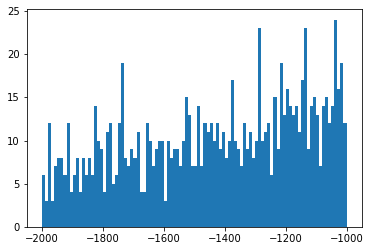

In [72]:
sigma=np.array(sigma)
plt.hist(sigma, bins=100, range=(-2000, -1000))

In [59]:
M=np.max(sigma)

In [60]:
m=np.min(sigma)

In [61]:
nrm_wghts = np.exp(sigma-M)/np.sum(np.exp(sigma-M))

In [62]:
np.nonzero(nrm_wghts)[0].shape

(4554,)

In [63]:
print(np.mean(nrm_wghts))
print(np.std(nrm_wghts))

0.0001
0.001854946970085943


In [64]:
print(np.percentile(nrm_wghts, 25))
print(np.percentile(nrm_wghts, 50))
print(np.percentile(nrm_wghts, 75))

0.0
0.0
4.492802117233025e-92
